In [7]:
import os
import json
import pandas as pd
from collections import defaultdict
import matplotlib.pyplot as plt
import matplotlib.font_manager as fm



In [9]:
def read_json(folder_path):
    temp = []
    for root, dirs, files in os.walk(folder_path):
        for file in sorted(files):
            if file.endswith(".json"):
                full_path = os.path.join(root, file)
                with open(full_path, 'r', encoding='utf-8') as f:
                    data = json.load(f)
                    temp.append(data)
    return temp


def Find_DiseaseAndType(filepath):
    dict = defaultdict(lambda: defaultdict(list))
    for root, dirs, files in os.walk(filepath):
        files = [f for f in files if f.endswith('json')]
        if files:
            disease_name = os.path.basename(os.path.dirname(root))
            type_name = os.path.basename(root)
            dict[disease_name][type_name].append(len(files))
    return dict

In [11]:
ans = []
ques = []
ques = read_json("/Users/basamg/textmining_team_project/Data/Training/02.라벨링데이터/TL/1.질문")
ans = read_json("/Users/basamg/textmining_team_project/Data/Training/02.라벨링데이터/TL/2.답변")

ques_disease = defaultdict(list)
ans_disease = defaultdict(list)

# disease 명 별로 dict 생성
for q in ques:
    d = q.get("disease_name", {}).get("kor")
    ques_disease[d].append(q)

for a in ans:
    d = a.get("disease_name", {}).get("kor")
    ans_disease[d].append(a)

In [12]:
merged_data = []

for disease in ques_disease:
    q_list = ques_disease[disease]
    a_list = ans_disease.get(disease, [])
    # zip 사용, 더 갯수가 적은 쪽 기준으로 병합이 이루어짐 → 일부 질문/답변이 손실될 수 있다는 문제 있음
    # zip_longest 를 이용할지 고민 필요
    for q, a in zip(q_list, a_list):
        merged_data.append({
            "question_id": q.get("fileName"),
            "answer_id": a.get("fileName"),
            "disease": disease,
            "disease_department": a.get("department"),
            "disease_category": q.get("disease_category"),
            "intention": q.get("intention"),
            "question_text": q.get("question"),
            "answer_intro": a.get("answer", {}).get("intro"),
            "answer_body": a.get("answer", {}).get("body"),
            "answer_conclusion": a.get("answer", {}).get("conclusion")
        })

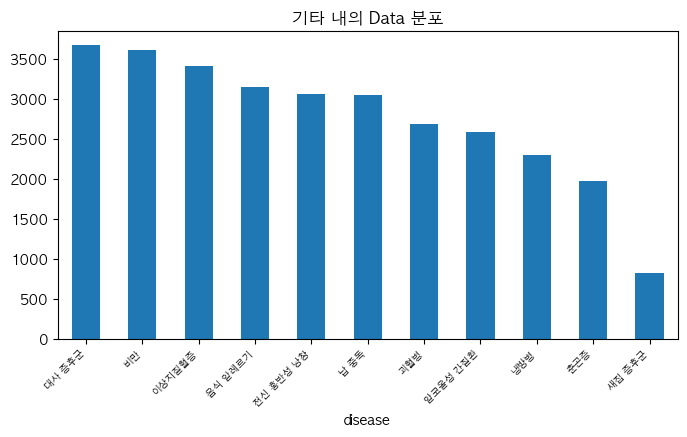

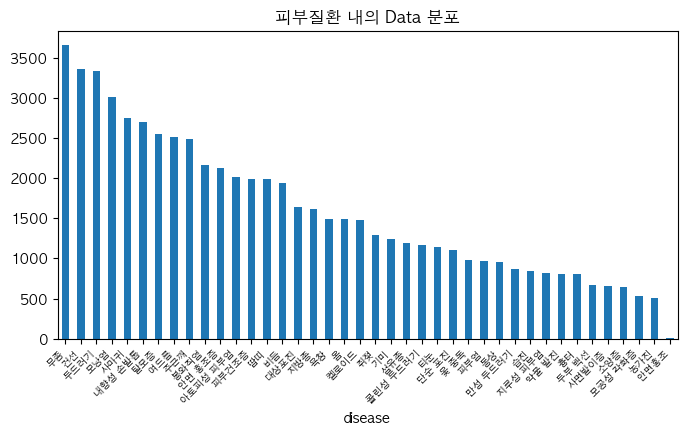

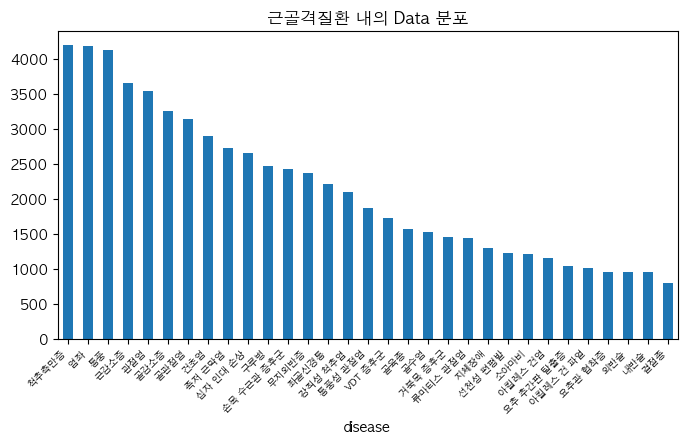

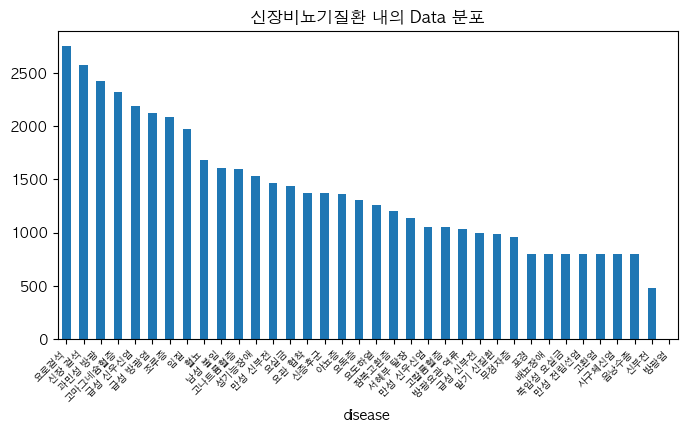

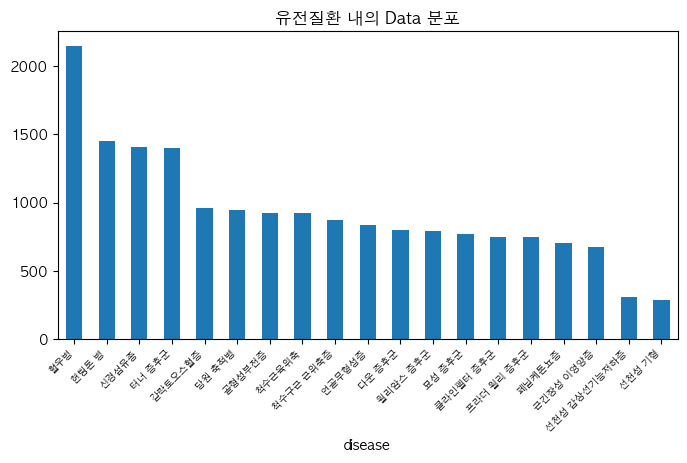

...

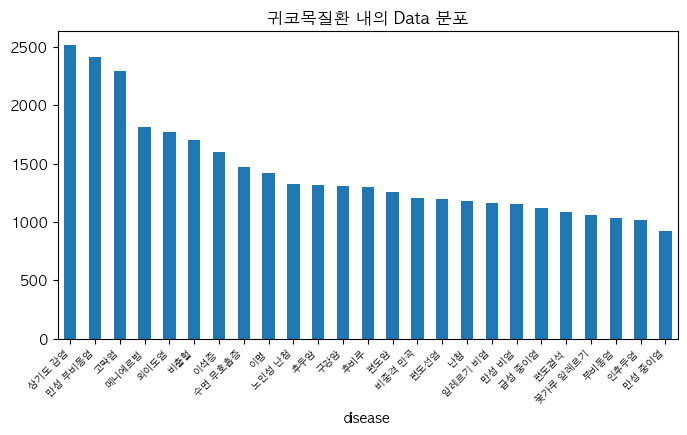

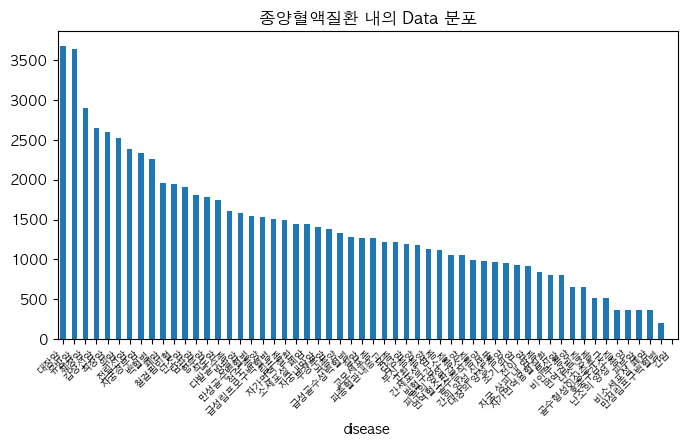

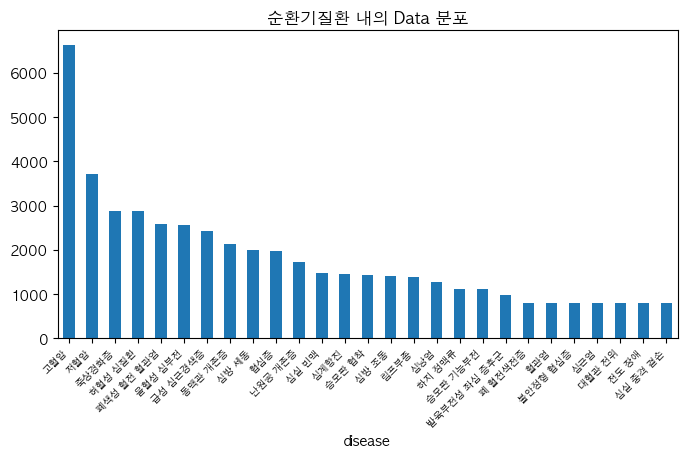

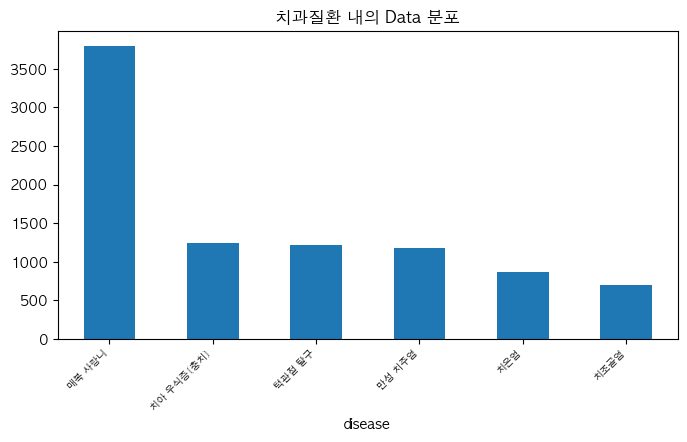

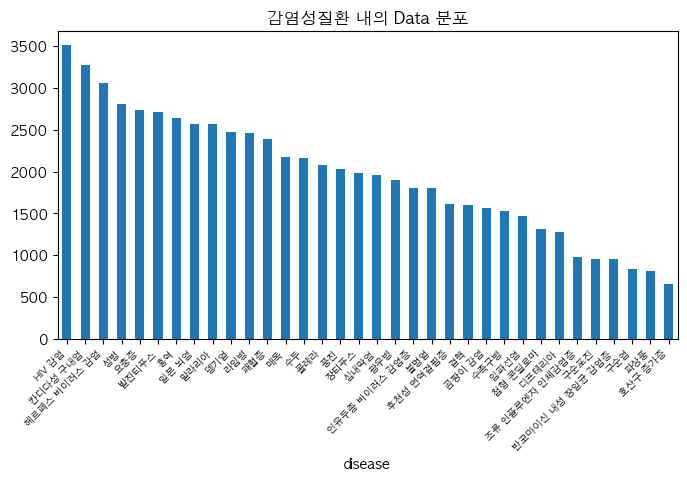

In [26]:
df = pd.DataFrame(merged_data)
font_path = "/System/Library/Fonts/Supplemental/AppleGothic.ttf"
fontprop = fm.FontProperties(fname=font_path, size=12)
plt.rc('font', family=fontprop.get_name())

for category in df['disease_category'].dropna().unique():
    subset = df[df['disease_category']==category]
    plt.figure(figsize=(8,4))
    subset['disease'].value_counts().plot(kind='bar')
    plt.title(f"{category} 내의 Data 분포")
    plt.xticks(rotation=45,ha='right',fontsize=7)
    plt.show()

In [461]:
df

,question_id,answer_id,disease,disease_department,disease_category,intention,question_text,answer_intro,answer_body,answer_conclusion,answer_full
0,HC-Q-0831244,HC-A-02536338,대사 증후군,[가정의학과],기타,검진,대사 증후군을 확인하기 위해 어떤 검사를 받아야 하나요?,대사증후군의 검진은 여러가지 지표를 측정하여 진행됩니다.,"의사는 환자의 병력, 신체 측정 결과, 혈당 수치, 혈압 수치 등을 종합적으로 판단...",정기적인 대사증후군 검진은 신체 상태를 평가하고 적절한 치료 방법을 결정하는데 중요...,"대사증후군의 검진은 여러가지 지표를 측정하여 진행됩니다.의사는 환자의 병력, 신체 ..."
1,HC-Q-0831245,HC-A-02536343,대사 증후군,[가정의학과],기타,검진,대사 증후군 진단을 위해 어떤 검사를 받아야 하는지 알고 싶습니다.,"대사증후군의 검진 방법은 다양하지만, 가장 일반적인 방법은 대사증후군 진단 기준을 ...","체질량지수(BMI), 혈압, 공복 혈당, 허리 및 엉덩이 둘레, 중성지방, HDL ...","따라서, 대사증후군을 진단하기 위해서는 의사와의 상담과 검사를 통해 진단 기준을 충...","대사증후군의 검진 방법은 다양하지만, 가장 일반적인 방법은 대사증후군 진단 기준을 ..."
2,HC-Q-0831246,HC-A-02536347,대사 증후군,[가정의학과],기타,검진,대사 증후군을 조기에 발견하기 위해 어떤 검진을 받아야 할까요?,대사증후군을 진단하기 위해 복부 비만뿐만 아니라 다른 건강 위험 요인을 평가합니다.,"복부 비만을 확인하기 위해 허리둘레, 혈압, 혈당, 콜레스테롤 등의 신체적인 평가가...",이러한 정보를 종합하여 대사증후군의 위험을 평가하고 관리할 수 있습니다.,대사증후군을 진단하기 위해 복부 비만뿐만 아니라 다른 건강 위험 요인을 평가합니다....
3,HC-Q-0831247,HC-A-02536359,대사 증후군,[가정의학과],기타,검진,대사 증후군을 진단하기 위해 어떤 종류의 검사가 일반적으로 시행되나요?,대사 증후군을 진단하는 과정은 복잡하고 다양한 절차를 포함하고 있습니다.,"복부 비만과 고혈압, 고혈당, 그리고 중성지방 등을 확인하기 위해 허리둘레를 측정합...","따라서 대사 증후군은 비만과 고혈압, 고혈당, 중성지방의 조합으로 특징지어지며, 정...",대사 증후군을 진단하는 과정은 복잡하고 다양한 절차를 포함하고 있습니다.복부 비만과...
4,HC-Q-0831248,HC-A-02536360,대사 증후군,[가정의학과],기타,검진,대사 증후군 검진을 받을 수 있는 곳은 어디인가요?,대사 증후군은 다양한 건강 위험을 가진 만성 질환입니다. 이를 검진하기 위해서는 여...,"검진은 주로 혈압, 체중, 허리둘레, 중성지방, HDL 콜레스테롤 등을 측정하여 위...","또한, 흡연과 고혈압과의 연관성을 파악하기 위해 흡연 이력을 알아보고, 가족력이 있...",대사 증후군은 다양한 건강 위험을 가진 만성 질환입니다. 이를 검진하기 위해서는 여...
...,...,...,...,...,...,...,...,...,...,...,...
874154,HC-Q-1089243,HC-A-06894259,수족구병,[소아청소년과],감염성질환,치료,가정 요법으로 수족구병을 치료하는 데에 어떤 가정 요법이 효과적인지 알려주세요.,"수족구병은 바이러스에 의해 입 안과 손, 발에 국한된 급성 바이러스성 감염 질환입니다.",주로 콕사키 바이러스 A16 및 엔테로 바이러스 71과 같은 바이러스에 의해 발생합...,"수족구병은 주로 바이러스로 인해 발생하며, 주로 입안의 점막이나 손, 발에 영향을 ...","수족구병은 바이러스에 의해 입 안과 손, 발에 국한된 급성 바이러스성 감염 질환입니..."
874155,HC-Q-1089245,HC-A-06966944,수족구병,[소아청소년과],감염성질환,치료,"수족구병 치료에 있어서, 일반적으로 어떤 약물이 사용되는지 알고 싶어요.","수족구병은 흔히 볼거리라고도 불리는 질병이며, 입 안, 손, 발에 나타나는 발진, ...","수족구병의 주요 증상은 고열, 두통, 피로감, 식욕 감소 등이며, 구토, 설사 등의...","수족구병의 예방은 매우 중요합니다. 손을 자주 씻고, 감염된 사람과의 직접 접촉을 ...","수족구병은 흔히 볼거리라고도 불리는 질병이며, 입 안, 손, 발에 나타나는 발진, ..."
874156,HC-Q-1089246,HC-A-06970207,수족구병,[소아청소년과],감염성질환,치료,수족구병 치료에 있어서 어떤 치료 방법이 일반적으로 사용되나요?,"수족구병은 다양한 바이러스나 세균으로 인해 발생하는 질병이며, 주로 어린이들에게 흔...","수족구병은 주로 여름과 가을에 발생하며, 손과 발에 발진과 궤양을 일으키는 바이러스...","따라서, 수족구병의 전파를 줄이기 위해서는 개인 위생 관리가 매우 중요하다. 적절한...","수족구병은 다양한 바이러스나 세균으로 인해 발생하는 질병이며, 주로 어린이들에게 흔..."
874157,HC-Q-1089247,HC-A-06993433,수족구병,[소아청소년과],감염성질환,치료,"아이들이 수족구병에 걸렸을 때, 어떤 치료법이 효과적일까요? 알려주세요.","수족구병은 바이러스 감염으로 인한 감염병으로, 주로 어린이에게서 발생합니다.",수족구병은 콕사키 바이러스 A16이나 엔테로바이러스 71형에 의해 전파됩니다. 이 ...,"수족구병은 콕사키 바이러스 A16이나 엔테로 바이러스 71형에 의해 전파되며, 대부...","수족구병은 바이러스 감염으로 인한 감염병으로, 주로 어린이에게서 발생합니다.수족구병..."


In [27]:
import unicodedata
# 내부 인코딩 형태가 달라서 정규화 필요함

dict = defaultdict(lambda: defaultdict(list))
for root, dirs, files in os.walk('/Users/basamg/textmining_team_project/Data/Training/02.라벨링데이터/TL'):
        files = [f for f in files if f.endswith('json')]        
        if files:
            disease_name = unicodedata.normalize('NFC',os.path.basename(os.path.dirname(root)))
            type_name = unicodedata.normalize('NFC',os.path.basename(root))
            dict[disease_name][type_name].append(len(files))
dict.keys()

dict_keys(['대사 증후군', '괴혈병', '알코올성 간질환', '전신 홍반성 낭창', '춘곤증', '음식 알레르기', '이상지질혈증', '냉방병', '새집 증후군', '비만', '납 중독', '비듬', '기저귀 피부염', '약물 발진', '여드름', '오타 모반', '농가진', '사면발이증', '옻 중독', '모공성 각화증', '콜린성 두드러기', '내향성 손발톱', '무모증', '사마귀', '선천성 색소결핍증', '섬유종', '수부 습진', '두부 백선', '건선', '모반', '아토피성 피부염', '안면 홍조증', '표피낭종', '옴', '기미', '안면홍조', '탈모증', '땀띠', '피부건조증', '광선 각화증', '돌발성 발진', '티눈', '백반증', '대상포진', '간찰성 홍반', '두드러기', '소양증', '주근깨', '피부염', '스티븐 존슨 증후군', '켈로이드', '피부근육염', '국소 다한증', '동전모양 습진', '다모증', '대상포진 후 신경통', '화염상 모반', '피부섬유육종', '동상', '탈락 피부염', '베체트 병', '탄저병', '봉와직염', '지방종', '피부 농양', '단순 포진', '만성 두드러기', '한포진', '태열', '비립종', '쥐젖', '욕창', '슈도모나스 감염', '단독', '흉터', '무좀', '한랭 두드러기', '어린선', '어루러기', '지루성 피부염', '한센병', '편평 태선', '습진', '만성 단순 태선', '모낭염', '접촉성 피부염', '아킬레스 건 파열', '건초염', '관절염', '결절종', '염좌', '십자 인대 손상', '지체장애', '통풍', '요추 추간판 탈출증', '강직성 척추염', '결정종', '외반슬', '선천성 편평발', '아킬레스 건염', '골관절염', '류마티스 관절염', '내반슬', '무지외반증', '구루병', '근감소증', '통풍성 관절염', '요추관 협착증', '소아마비', '족저 근막염', '골감소증', '좌골신경통', '골수염', '골육종', '척추측

In [30]:
for i in dict:
    print(f"질병 : {i}")
    for j in dict[i]:
        print(f"{j} 카테고리 : 질문 {dict[i][j][0]}, 답변 {dict[i][j][1]}")
    print()

질병 : 대사 증후군
검진 카테고리 : 질문 1281, 답변 307
약물 카테고리 : 질문 1243, 답변 348
예방 카테고리 : 질문 1487, 답변 381
진단 카테고리 : 질문 1463, 답변 323
치료 카테고리 : 질문 1301, 답변 350
운동 카테고리 : 질문 1332, 답변 526
식이, 생활 카테고리 : 질문 1898, 답변 488
증상 카테고리 : 질문 1421, 답변 279
원인 카테고리 : 질문 482, 답변 259
정의 카테고리 : 질문 1375, 답변 413

질병 : 괴혈병
약물 카테고리 : 질문 258, 답변 425
예방 카테고리 : 질문 573, 답변 308
진단 카테고리 : 질문 574, 답변 324
치료 카테고리 : 질문 160, 답변 328
식이, 생활 카테고리 : 질문 316, 답변 496
증상 카테고리 : 질문 160, 답변 260
원인 카테고리 : 질문 492, 답변 321
정의 카테고리 : 질문 160, 답변 484

질병 : 알코올성 간질환
검진 카테고리 : 질문 1228, 답변 434
약물 카테고리 : 질문 1248, 답변 312
진단 카테고리 : 질문 160, 답변 355
치료 카테고리 : 질문 160, 답변 327
식이, 생활 카테고리 : 질문 160, 답변 428
증상 카테고리 : 질문 160, 답변 193
원인 카테고리 : 질문 160, 답변 180
정의 카테고리 : 질문 160, 답변 356

질병 : 전신 홍반성 낭창
검진 카테고리 : 질문 160, 답변 239
약물 카테고리 : 질문 160, 답변 259
예방 카테고리 : 질문 160, 답변 332
진단 카테고리 : 질문 160, 답변 309
치료 카테고리 : 질문 973, 답변 344
운동 카테고리 : 질문 16, 답변 243
식이, 생활 카테고리 : 질문 160, 답변 346
증상 카테고리 : 질문 160, 답변 339
원인 카테고리 : 질문 1459, 답변 374
정의 카테고리 : 질문 1476, 답변 273

질병 : 춘곤증
예방 카테고리 :

IndexError: list index out of range

In [635]:
records = []

for disease in dict:
    for category in dict[disease]:
        # 질문, 답변 둘중 하나라도 empty 인 경우는 continue
        if len(dict[disease][category]) < 2:
            #print(disease, category)
            continue
        question_count = dict[disease][category][0]
        answer_count = dict[disease][category][1]
        records.append({
            '질병': disease,
            '카테고리': category,
            '질문 수': question_count,
            '답변 수': answer_count
        })

df_count = pd.DataFrame(records)
df_count

,질병,카테고리,질문 수,답변 수
0,대사 증후군,검진,1281,307
1,대사 증후군,약물,1243,348
2,대사 증후군,예방,1487,381
3,대사 증후군,진단,1463,323
4,대사 증후군,치료,1301,350
...,...,...,...,...
4012,수족구병,치료,160,420
4013,수족구병,"식이, 생활",16,253
4014,수족구병,증상,160,471
4015,수족구병,원인,192,362


In [34]:
print(f"질문 수 : {df_count['질문 수'].sum()}")
print(f"답변 수: {df_count['답변 수'].sum()}")

질문 수 : 1942436
답변 수: 1133820


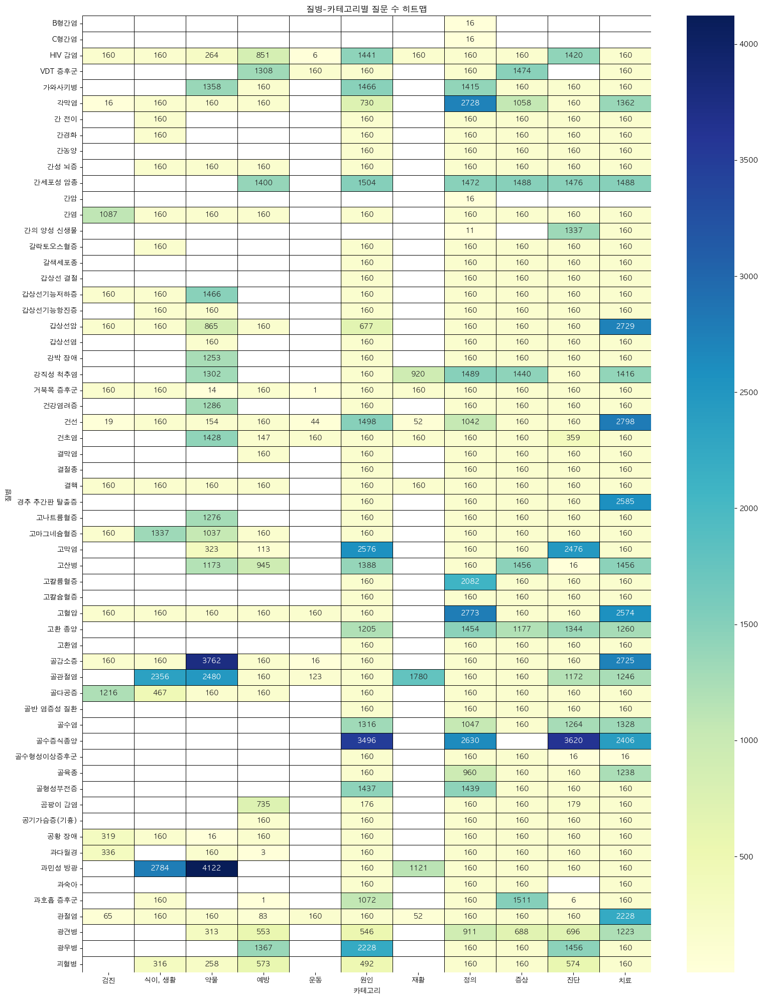

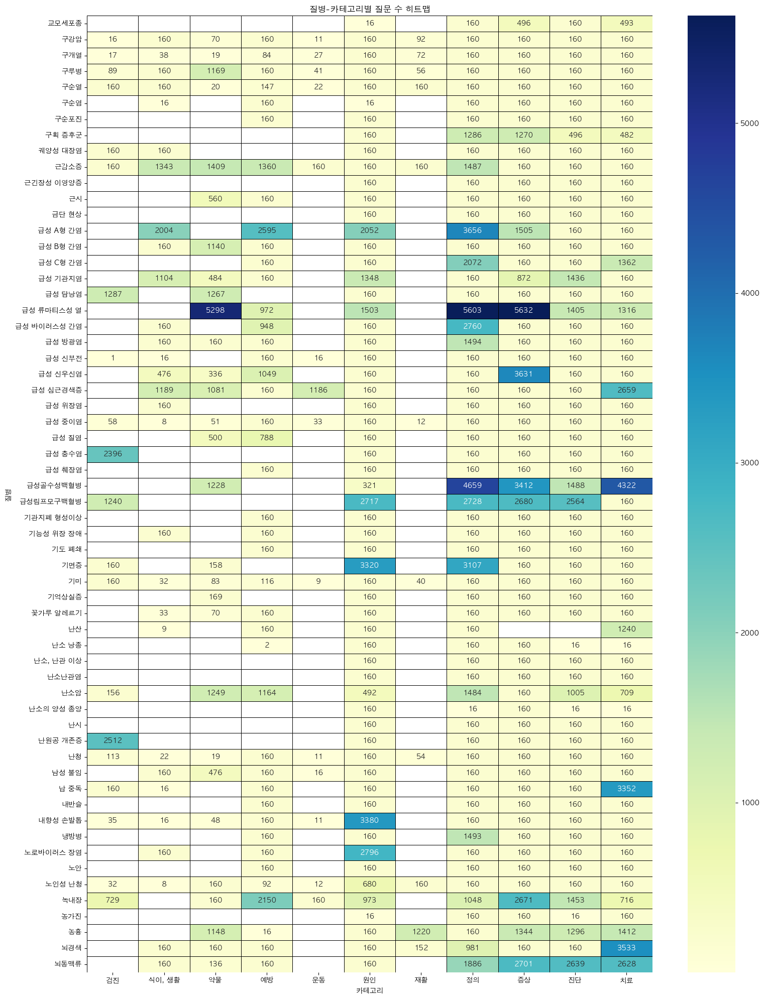

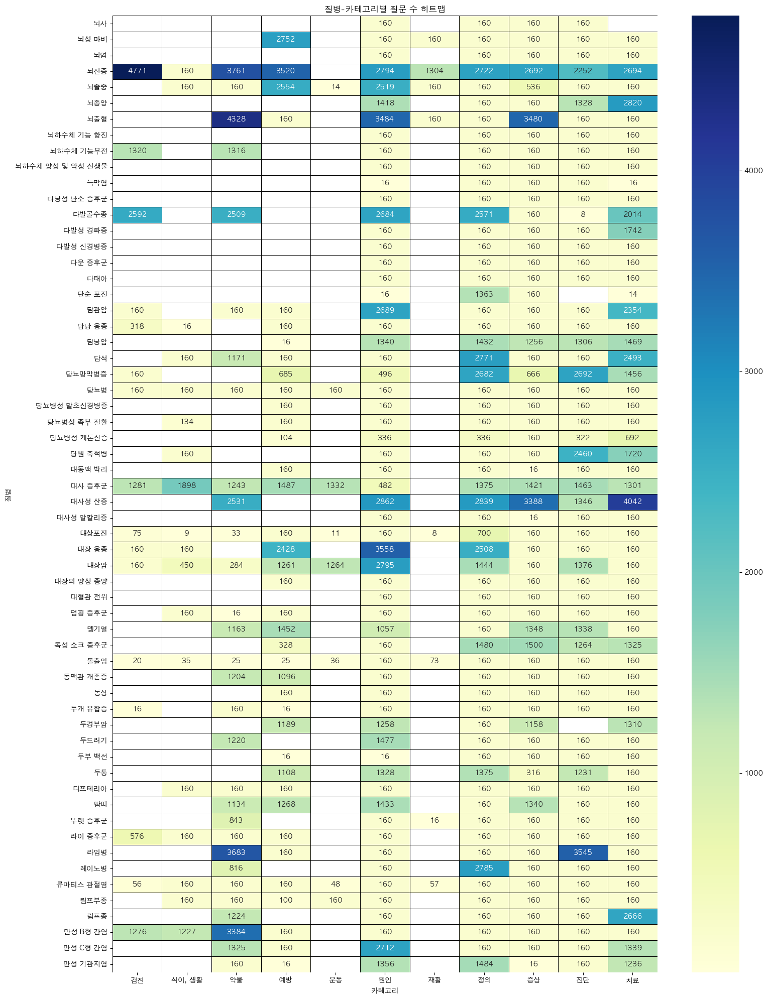

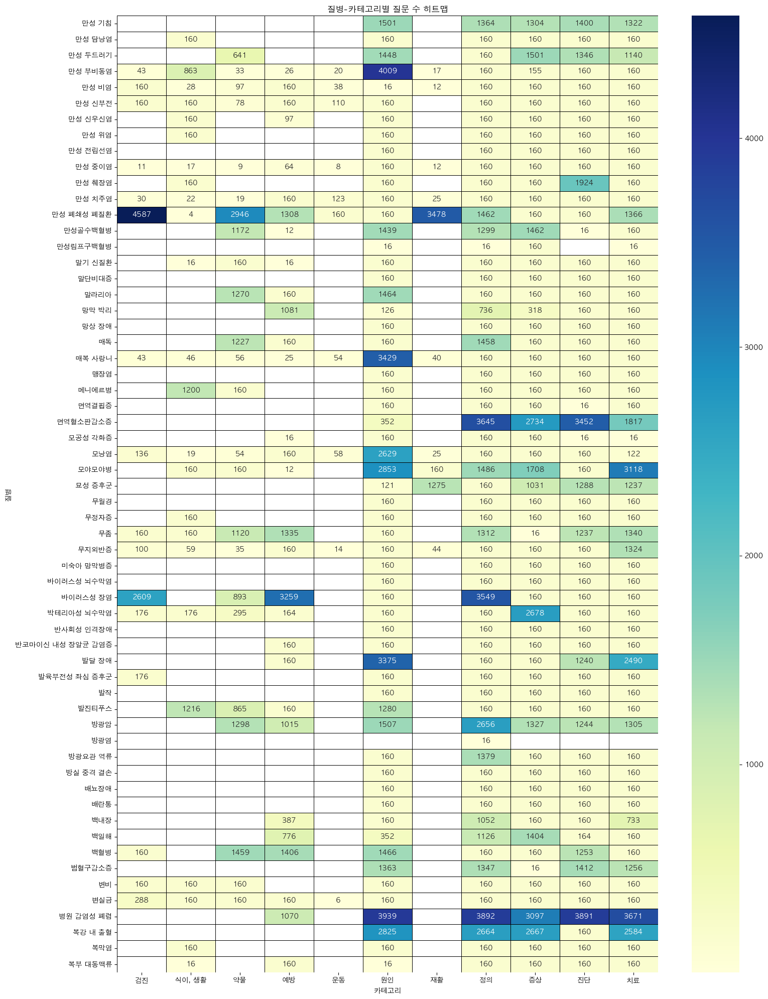

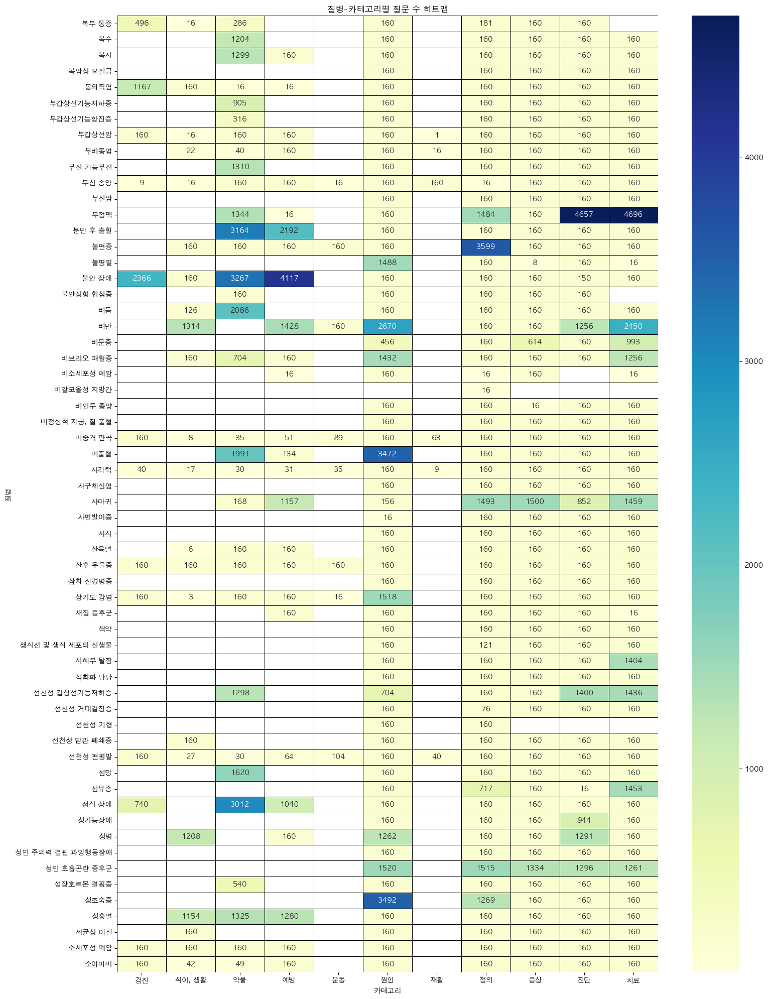

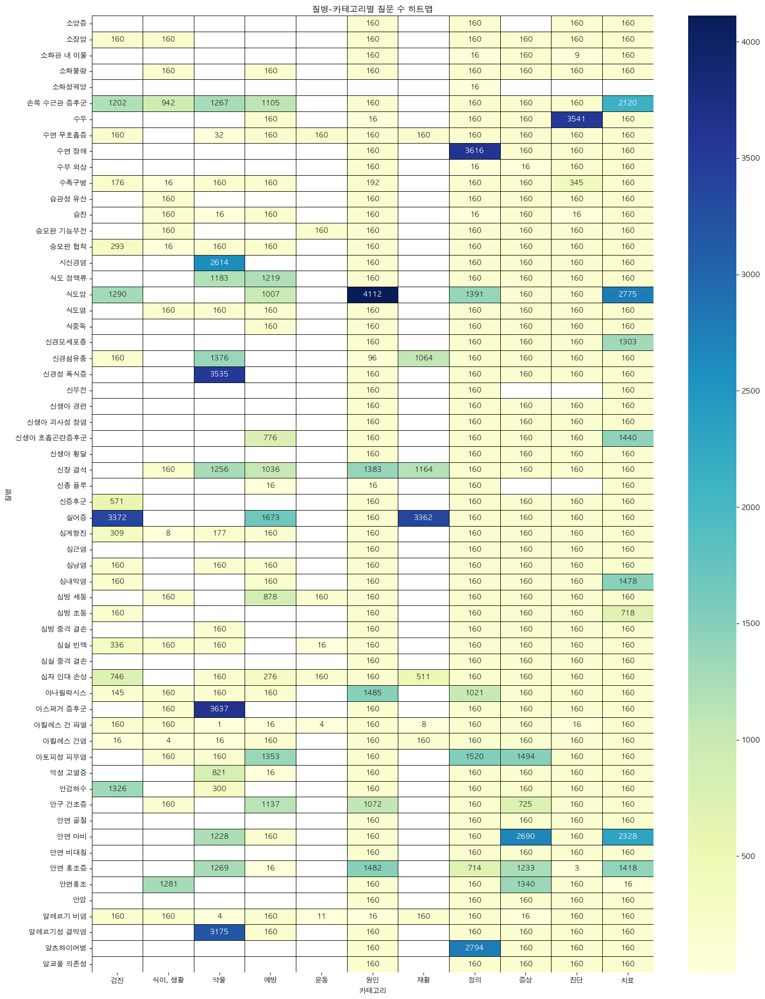

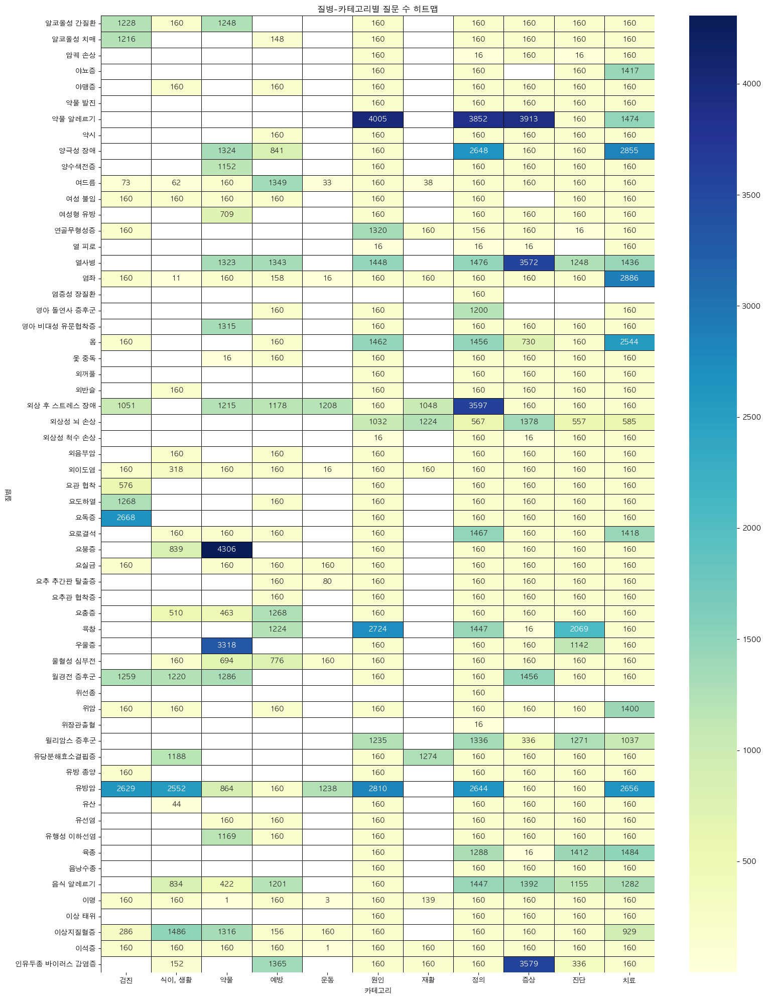

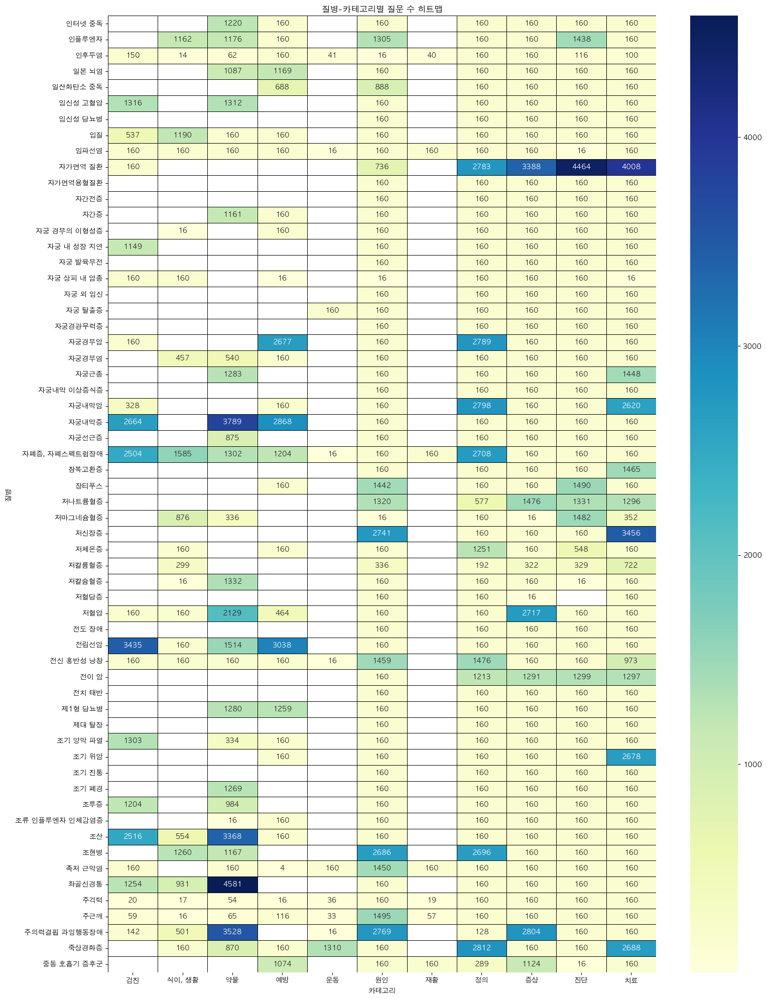

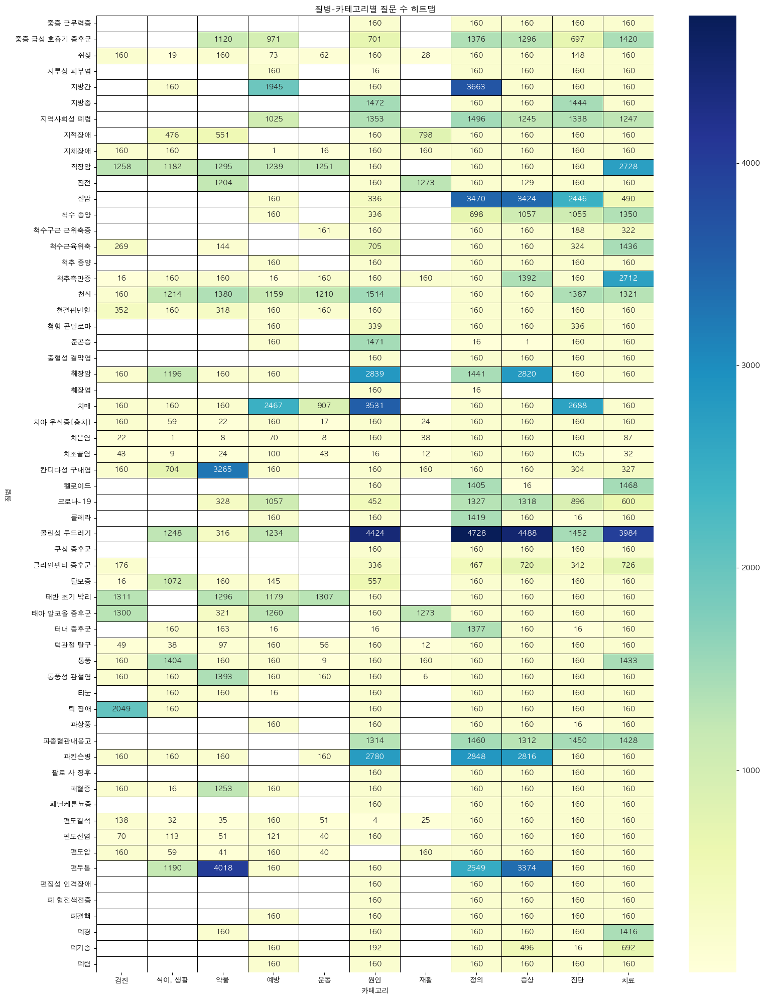

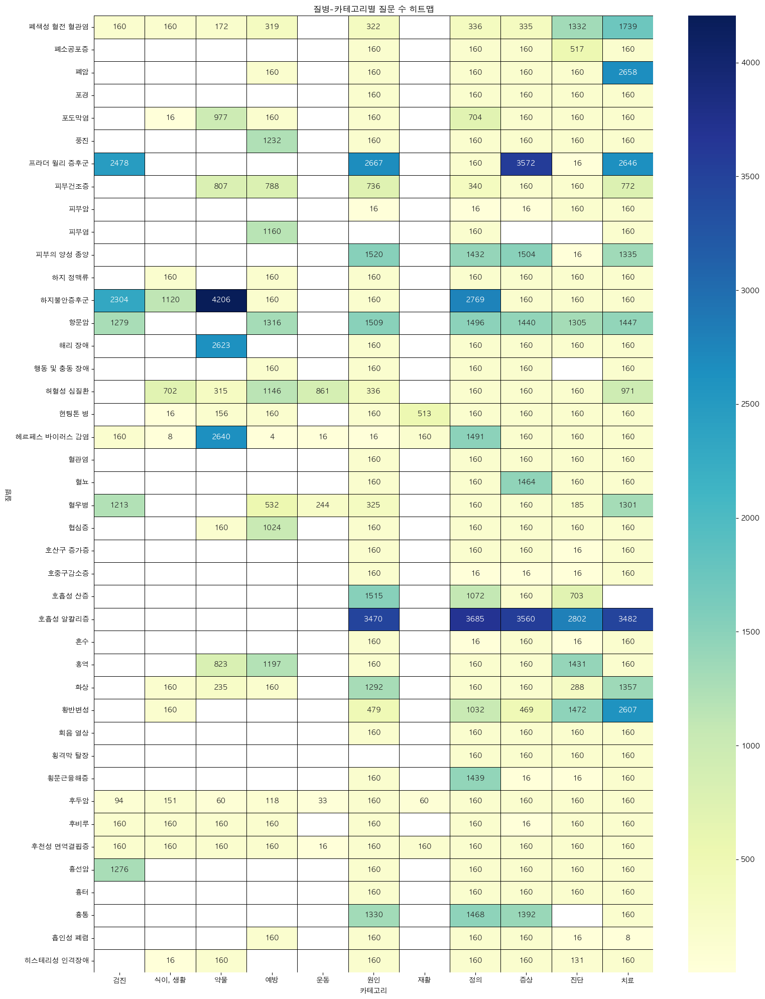

In [36]:
import seaborn as sns

pivot_df = df_count.pivot_table(index='질병', columns='카테고리', values='질문 수')
chunk_size = 60
disease_list = pivot_df.index.tolist()
for i in range(0, len(disease_list), chunk_size):
    chunk = disease_list[i:i+chunk_size]
    pivot_chunk = pivot_df.loc[chunk]

    # 히트맵 그리기
    plt.figure(figsize=(16,20))
    sns.heatmap(pivot_chunk, annot=True, fmt='.0f', cmap='YlGnBu', linewidth=0.5, linecolor='black')
    plt.title("질병-카테고리별 질문 수 히트맵")
    plt.ylabel("질병")
    plt.xlabel("카테고리")
    plt.tight_layout()
    plt.show()


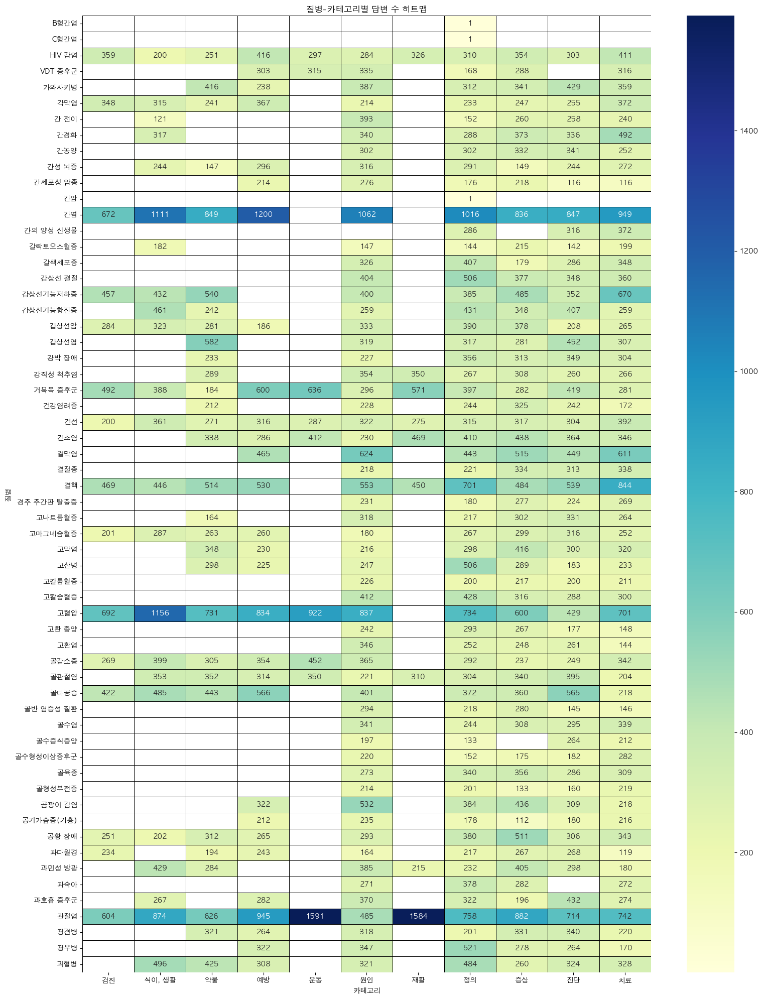

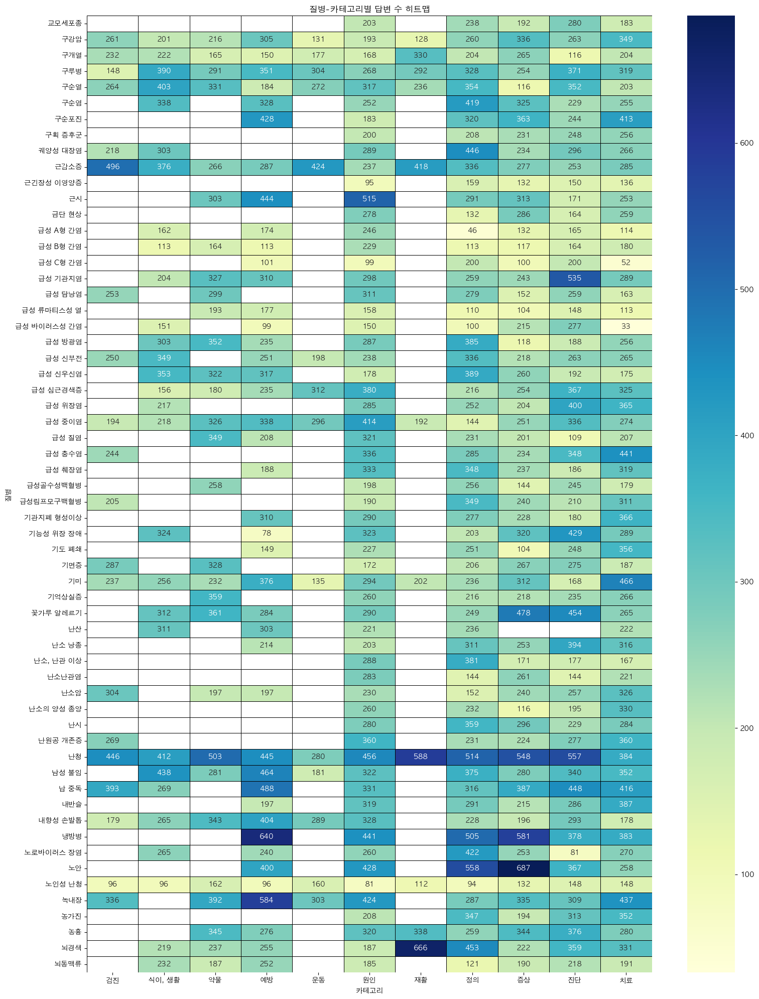

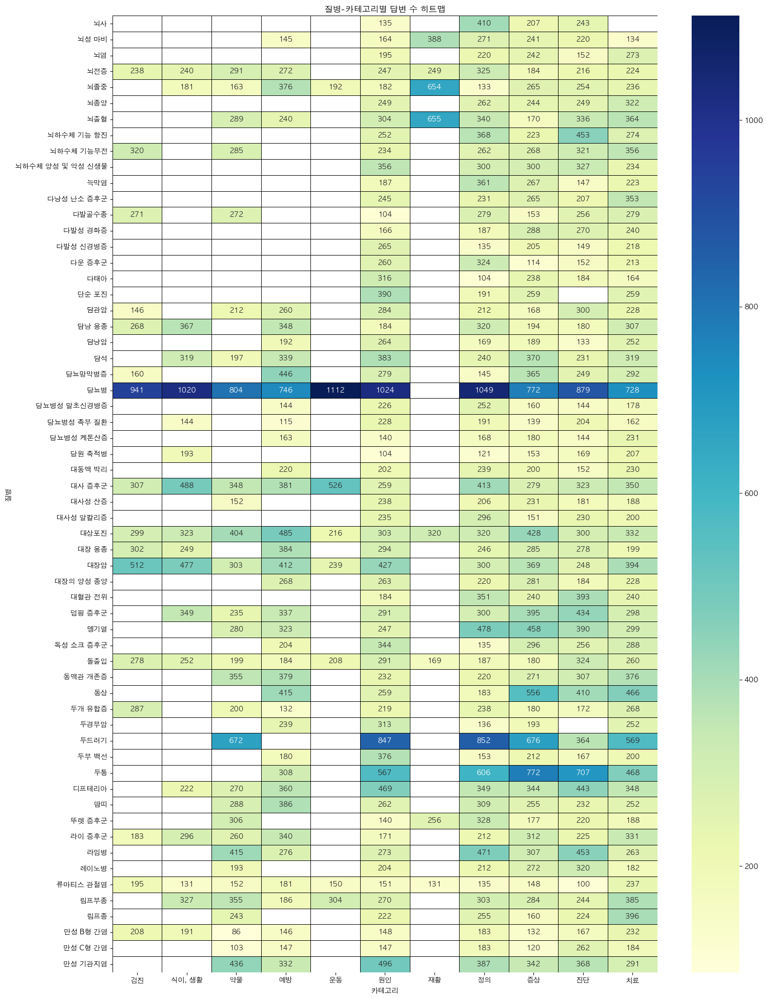

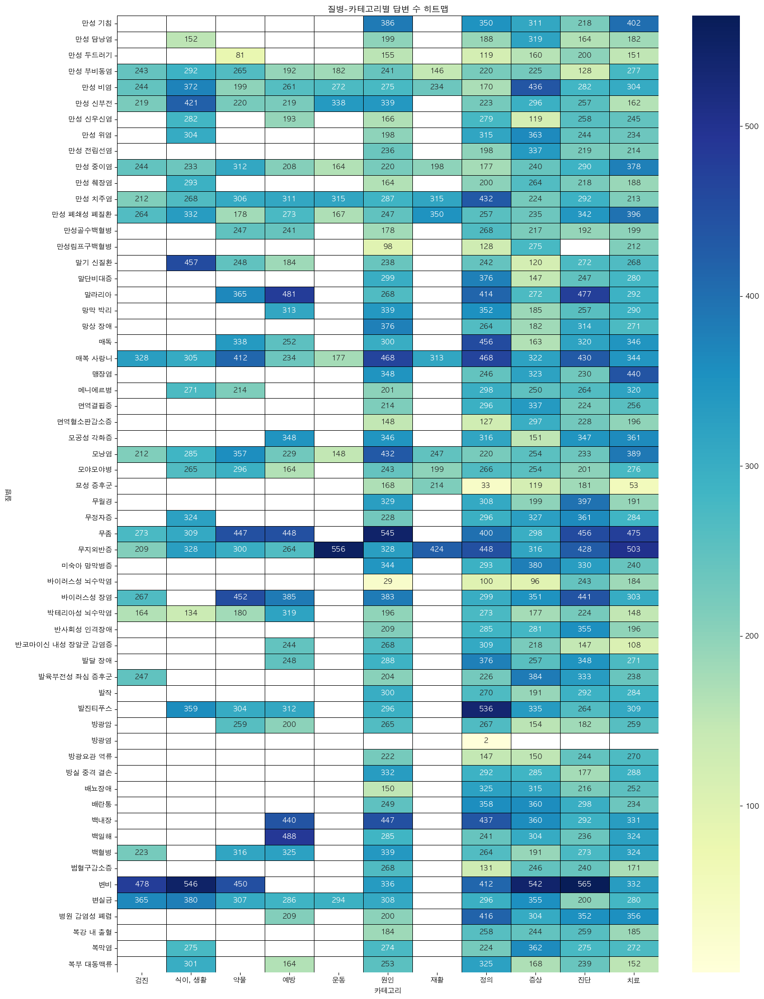

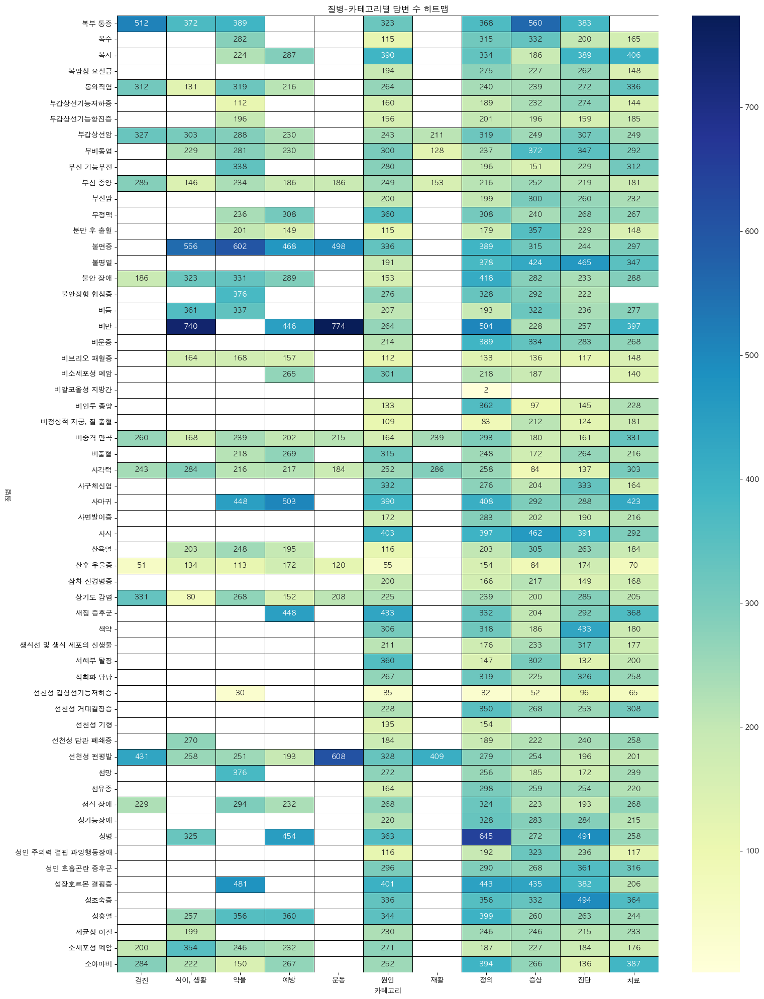

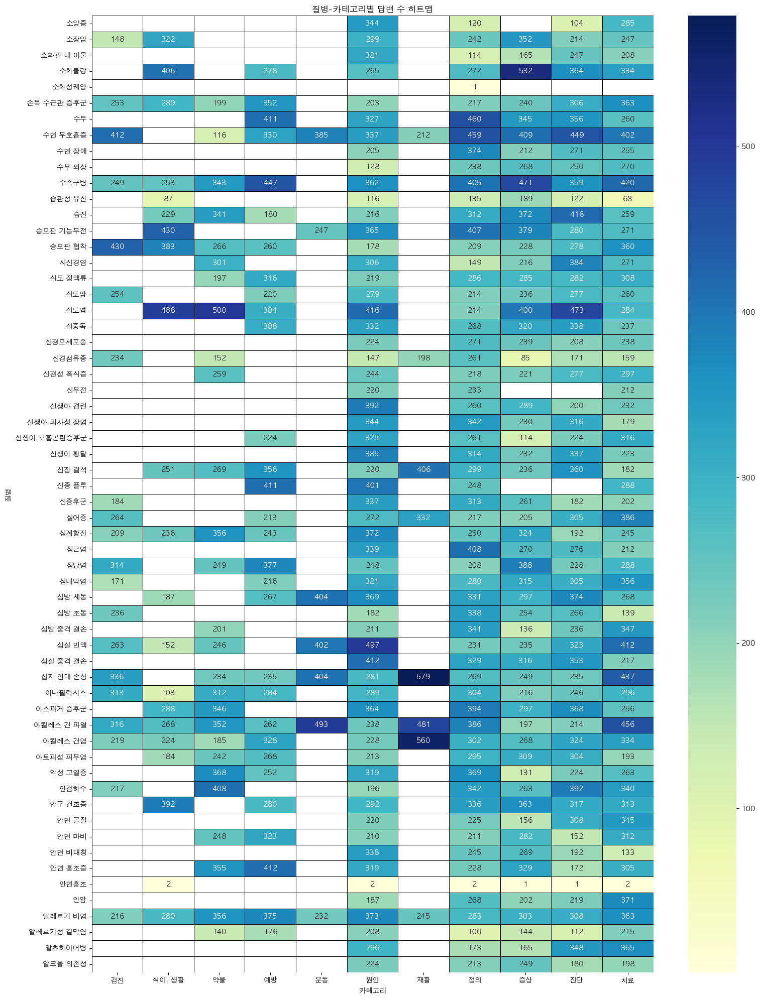

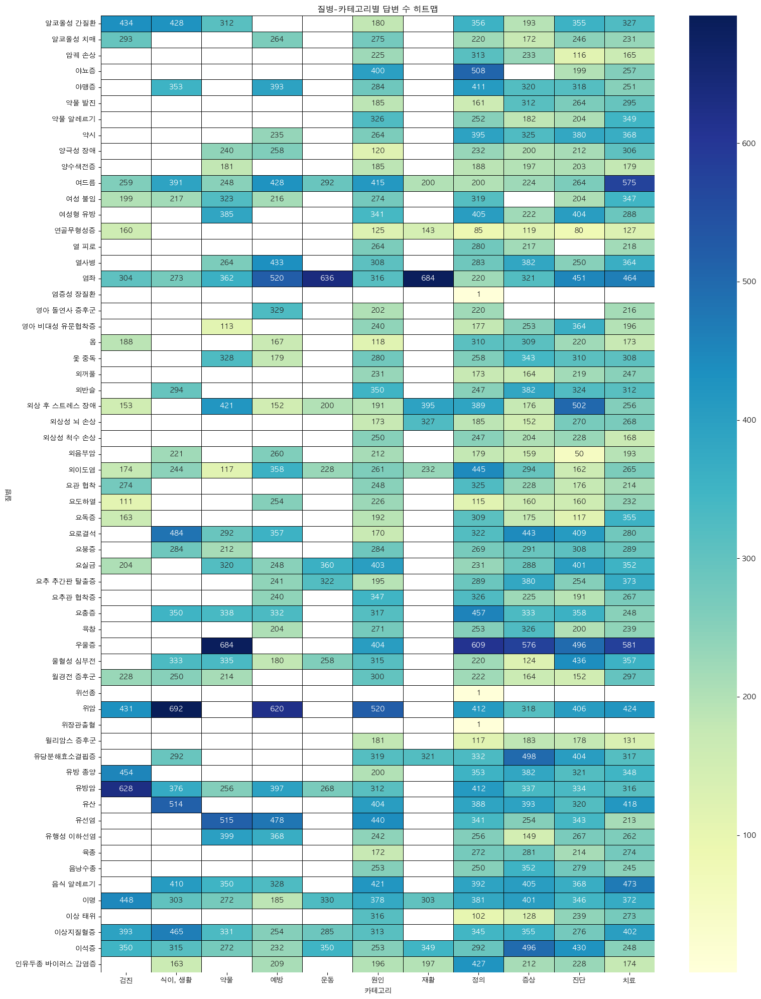

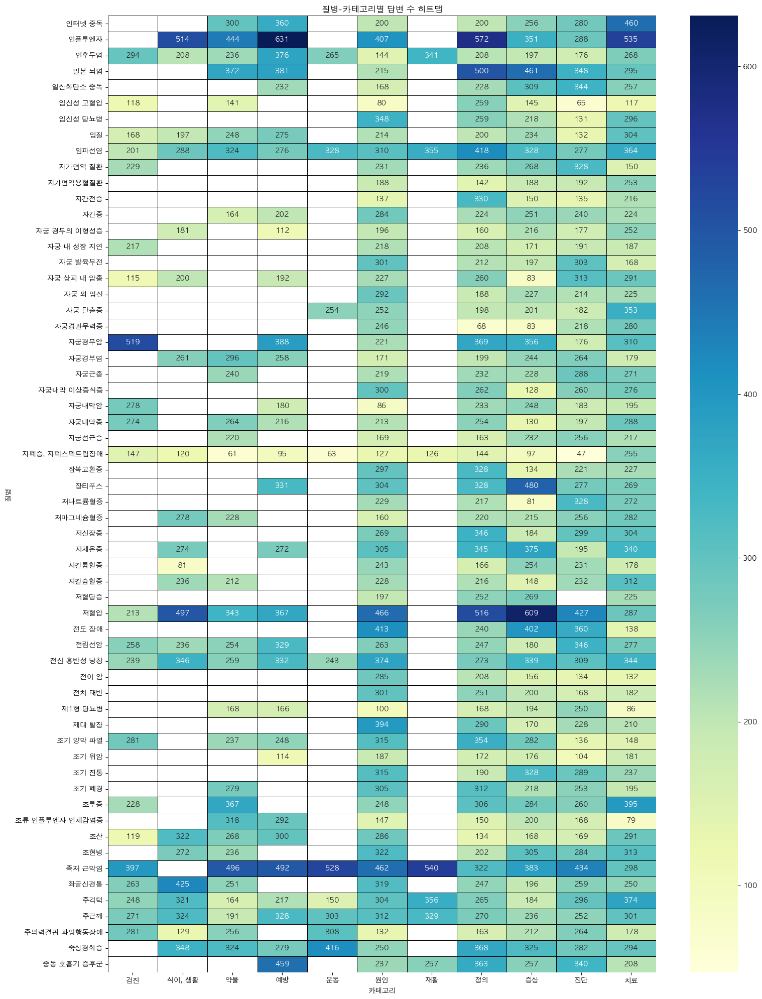

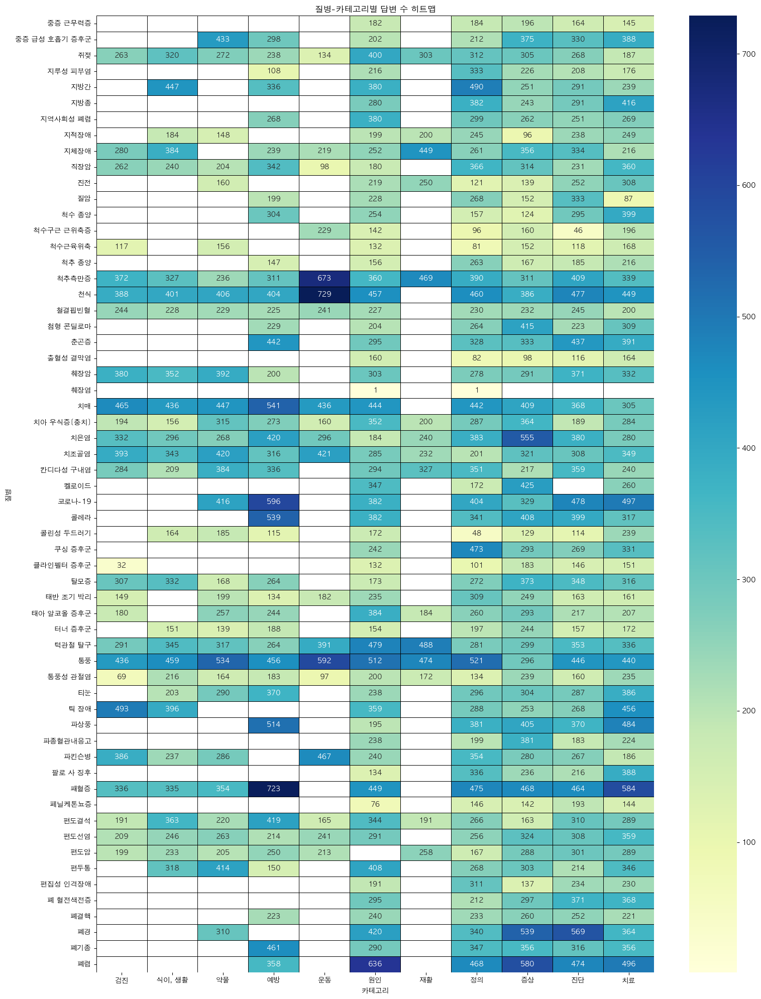

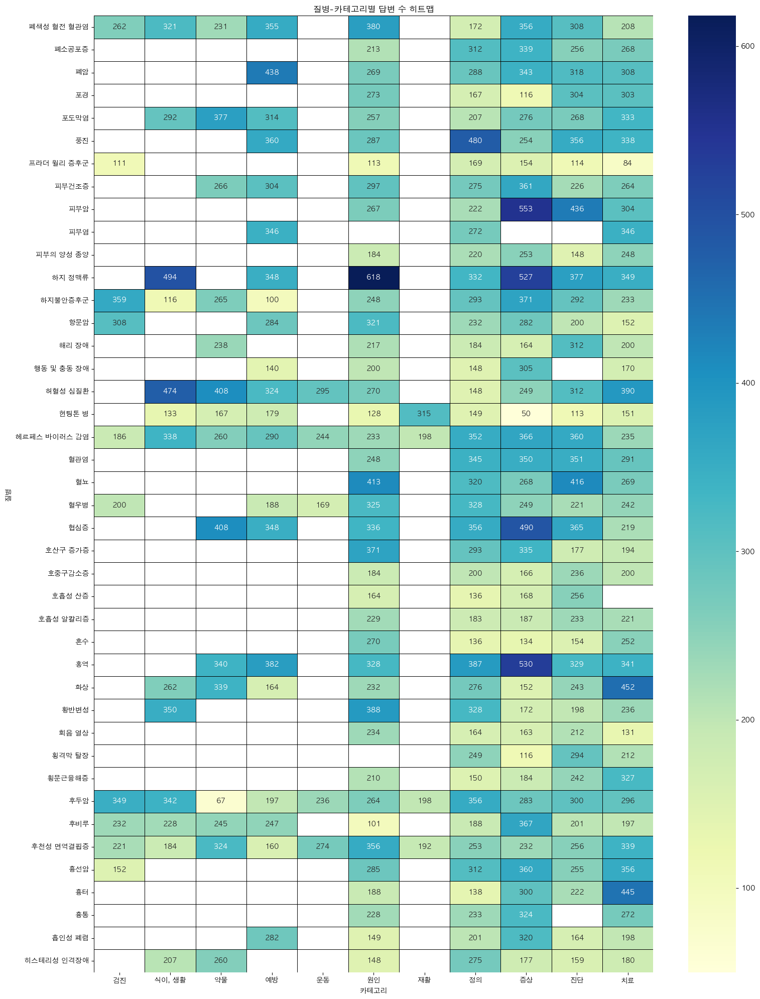

In [37]:
pivot_df = df_count.pivot_table(index='질병', columns='카테고리', values='답변 수')
chunk_size = 60
disease_list = pivot_df.index.tolist()
for i in range(0, len(disease_list), chunk_size):
    chunk = disease_list[i:i+chunk_size]
    pivot_chunk = pivot_df.loc[chunk]

    # 히트맵 그리기
    plt.figure(figsize=(16,20))
    sns.heatmap(pivot_chunk, annot=True, fmt='.0f', cmap='YlGnBu', linewidth=0.5, linecolor='black')
    plt.title("질병-카테고리별 답변 수 히트맵")
    plt.ylabel("질병")
    plt.xlabel("카테고리")
    plt.tight_layout()
    plt.show()


In [463]:
df['answer_full'] = df['answer_intro']+df['answer_body']+df['answer_conclusion']
# answer_conclusion 부분만 사용할지, intro body conclusion 을 합쳐서 사용할지도 고민 필요
df

,question_id,answer_id,disease,disease_department,disease_category,intention,question_text,answer_intro,answer_body,answer_conclusion,answer_full
0,HC-Q-0831244,HC-A-02536338,대사 증후군,[가정의학과],기타,검진,대사 증후군을 확인하기 위해 어떤 검사를 받아야 하나요?,대사증후군의 검진은 여러가지 지표를 측정하여 진행됩니다.,"의사는 환자의 병력, 신체 측정 결과, 혈당 수치, 혈압 수치 등을 종합적으로 판단...",정기적인 대사증후군 검진은 신체 상태를 평가하고 적절한 치료 방법을 결정하는데 중요...,"대사증후군의 검진은 여러가지 지표를 측정하여 진행됩니다.의사는 환자의 병력, 신체 ..."
1,HC-Q-0831245,HC-A-02536343,대사 증후군,[가정의학과],기타,검진,대사 증후군 진단을 위해 어떤 검사를 받아야 하는지 알고 싶습니다.,"대사증후군의 검진 방법은 다양하지만, 가장 일반적인 방법은 대사증후군 진단 기준을 ...","체질량지수(BMI), 혈압, 공복 혈당, 허리 및 엉덩이 둘레, 중성지방, HDL ...","따라서, 대사증후군을 진단하기 위해서는 의사와의 상담과 검사를 통해 진단 기준을 충...","대사증후군의 검진 방법은 다양하지만, 가장 일반적인 방법은 대사증후군 진단 기준을 ..."
2,HC-Q-0831246,HC-A-02536347,대사 증후군,[가정의학과],기타,검진,대사 증후군을 조기에 발견하기 위해 어떤 검진을 받아야 할까요?,대사증후군을 진단하기 위해 복부 비만뿐만 아니라 다른 건강 위험 요인을 평가합니다.,"복부 비만을 확인하기 위해 허리둘레, 혈압, 혈당, 콜레스테롤 등의 신체적인 평가가...",이러한 정보를 종합하여 대사증후군의 위험을 평가하고 관리할 수 있습니다.,대사증후군을 진단하기 위해 복부 비만뿐만 아니라 다른 건강 위험 요인을 평가합니다....
3,HC-Q-0831247,HC-A-02536359,대사 증후군,[가정의학과],기타,검진,대사 증후군을 진단하기 위해 어떤 종류의 검사가 일반적으로 시행되나요?,대사 증후군을 진단하는 과정은 복잡하고 다양한 절차를 포함하고 있습니다.,"복부 비만과 고혈압, 고혈당, 그리고 중성지방 등을 확인하기 위해 허리둘레를 측정합...","따라서 대사 증후군은 비만과 고혈압, 고혈당, 중성지방의 조합으로 특징지어지며, 정...",대사 증후군을 진단하는 과정은 복잡하고 다양한 절차를 포함하고 있습니다.복부 비만과...
4,HC-Q-0831248,HC-A-02536360,대사 증후군,[가정의학과],기타,검진,대사 증후군 검진을 받을 수 있는 곳은 어디인가요?,대사 증후군은 다양한 건강 위험을 가진 만성 질환입니다. 이를 검진하기 위해서는 여...,"검진은 주로 혈압, 체중, 허리둘레, 중성지방, HDL 콜레스테롤 등을 측정하여 위...","또한, 흡연과 고혈압과의 연관성을 파악하기 위해 흡연 이력을 알아보고, 가족력이 있...",대사 증후군은 다양한 건강 위험을 가진 만성 질환입니다. 이를 검진하기 위해서는 여...
...,...,...,...,...,...,...,...,...,...,...,...
874154,HC-Q-1089243,HC-A-06894259,수족구병,[소아청소년과],감염성질환,치료,가정 요법으로 수족구병을 치료하는 데에 어떤 가정 요법이 효과적인지 알려주세요.,"수족구병은 바이러스에 의해 입 안과 손, 발에 국한된 급성 바이러스성 감염 질환입니다.",주로 콕사키 바이러스 A16 및 엔테로 바이러스 71과 같은 바이러스에 의해 발생합...,"수족구병은 주로 바이러스로 인해 발생하며, 주로 입안의 점막이나 손, 발에 영향을 ...","수족구병은 바이러스에 의해 입 안과 손, 발에 국한된 급성 바이러스성 감염 질환입니..."
874155,HC-Q-1089245,HC-A-06966944,수족구병,[소아청소년과],감염성질환,치료,"수족구병 치료에 있어서, 일반적으로 어떤 약물이 사용되는지 알고 싶어요.","수족구병은 흔히 볼거리라고도 불리는 질병이며, 입 안, 손, 발에 나타나는 발진, ...","수족구병의 주요 증상은 고열, 두통, 피로감, 식욕 감소 등이며, 구토, 설사 등의...","수족구병의 예방은 매우 중요합니다. 손을 자주 씻고, 감염된 사람과의 직접 접촉을 ...","수족구병은 흔히 볼거리라고도 불리는 질병이며, 입 안, 손, 발에 나타나는 발진, ..."
874156,HC-Q-1089246,HC-A-06970207,수족구병,[소아청소년과],감염성질환,치료,수족구병 치료에 있어서 어떤 치료 방법이 일반적으로 사용되나요?,"수족구병은 다양한 바이러스나 세균으로 인해 발생하는 질병이며, 주로 어린이들에게 흔...","수족구병은 주로 여름과 가을에 발생하며, 손과 발에 발진과 궤양을 일으키는 바이러스...","따라서, 수족구병의 전파를 줄이기 위해서는 개인 위생 관리가 매우 중요하다. 적절한...","수족구병은 다양한 바이러스나 세균으로 인해 발생하는 질병이며, 주로 어린이들에게 흔..."
874157,HC-Q-1089247,HC-A-06993433,수족구병,[소아청소년과],감염성질환,치료,"아이들이 수족구병에 걸렸을 때, 어떤 치료법이 효과적일까요? 알려주세요.","수족구병은 바이러스 감염으로 인한 감염병으로, 주로 어린이에게서 발생합니다.",수족구병은 콕사키 바이러스 A16이나 엔테로바이러스 71형에 의해 전파됩니다. 이 ...,"수족구병은 콕사키 바이러스 A16이나 엔테로 바이러스 71형에 의해 전파되며, 대부...","수족구병은 바이러스 감염으로 인한 감염병으로, 주로 어린이에게서 발생합니다.수족구병..."


In [39]:
df_count

,질병,카테고리,질문 수,답변 수
0,대사 증후군,검진,1281,307
1,대사 증후군,약물,1243,348
2,대사 증후군,예방,1487,381
3,대사 증후군,진단,1463,323
4,대사 증후군,치료,1301,350
...,...,...,...,...
4012,수족구병,치료,160,420
4013,수족구병,"식이, 생활",16,253
4014,수족구병,증상,160,471
4015,수족구병,원인,192,362


/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


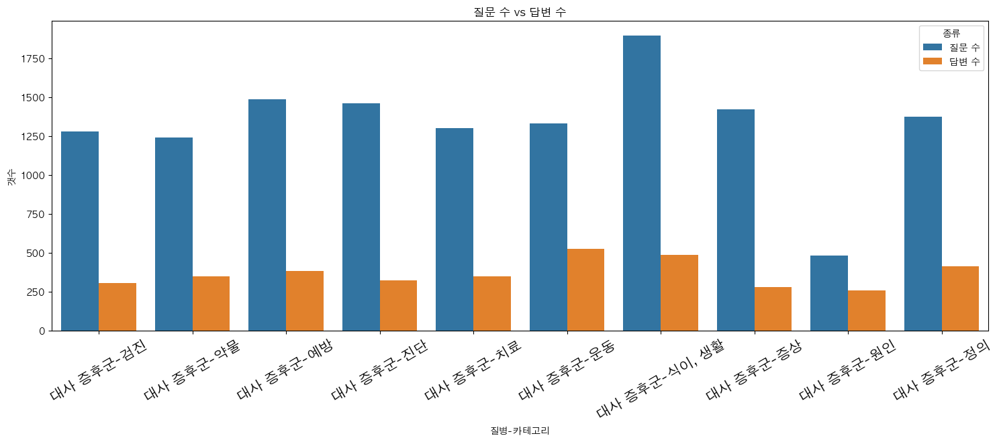

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


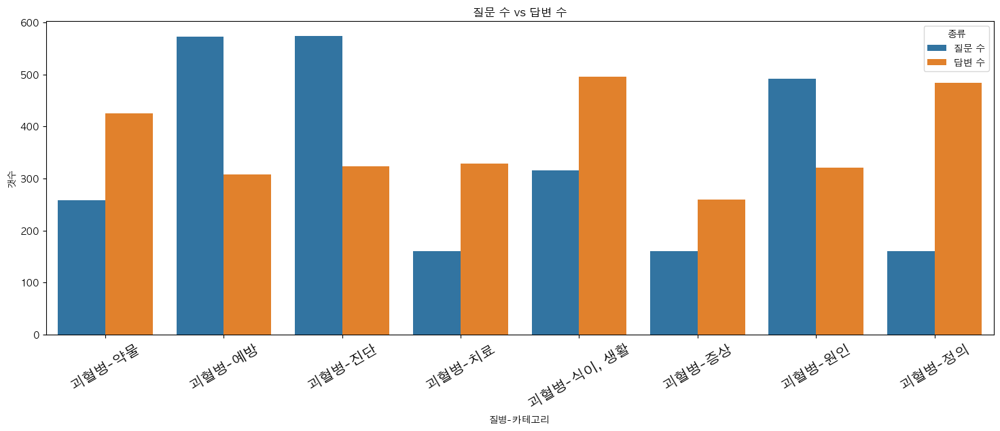

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


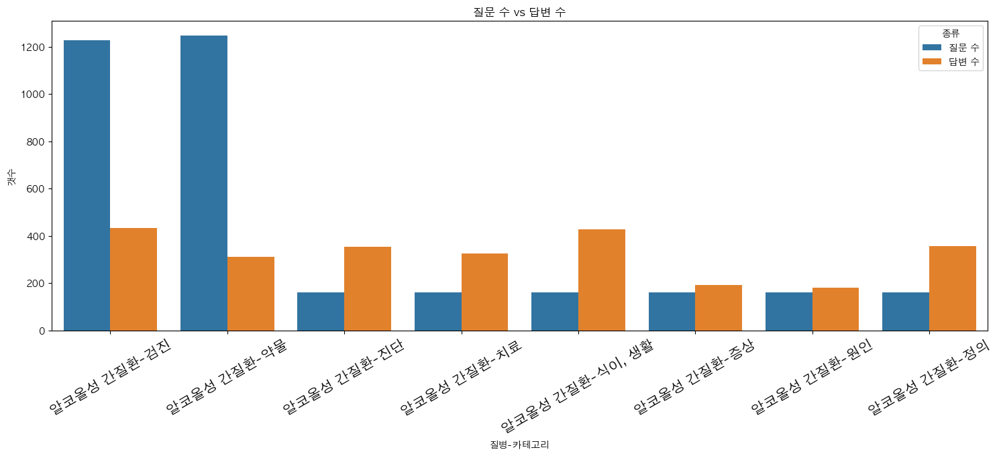

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


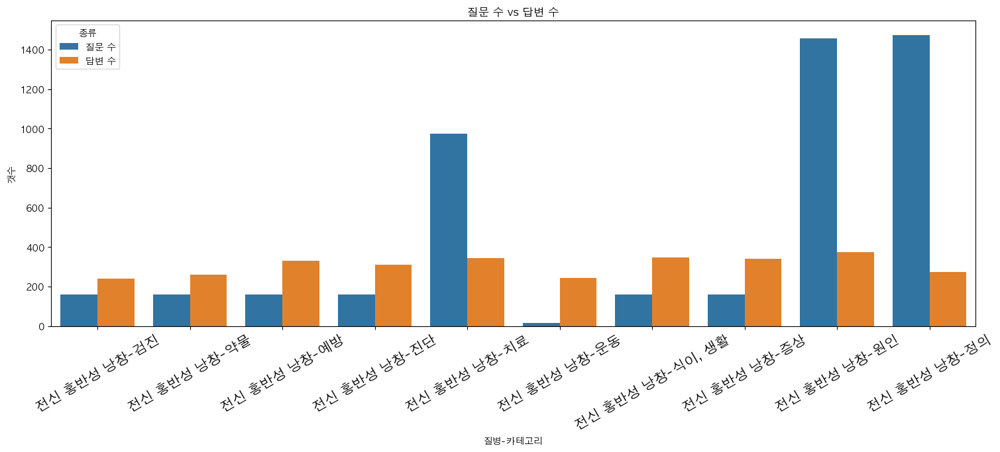

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


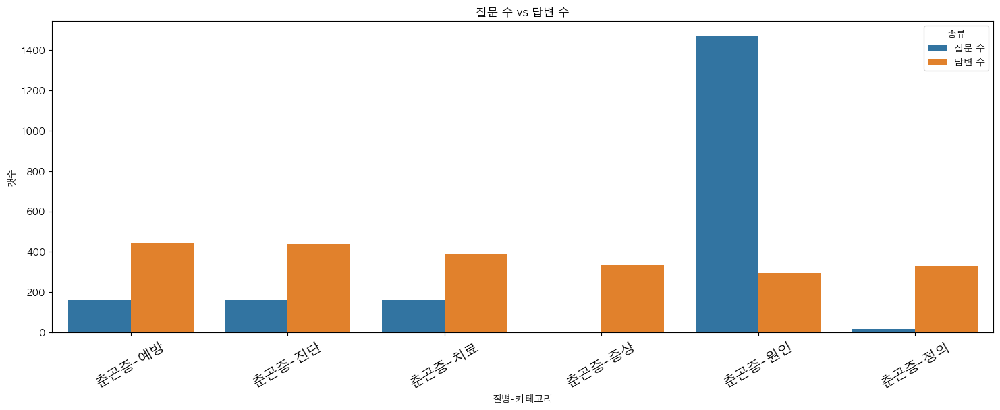

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


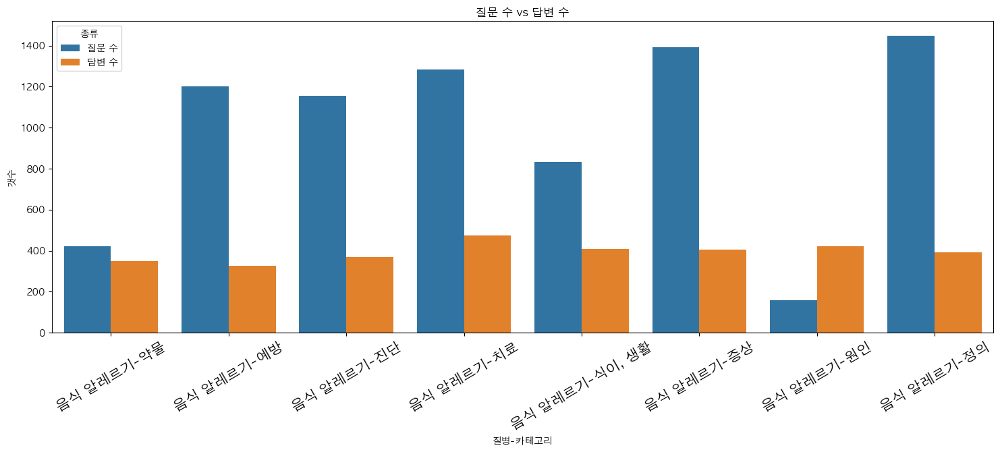

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


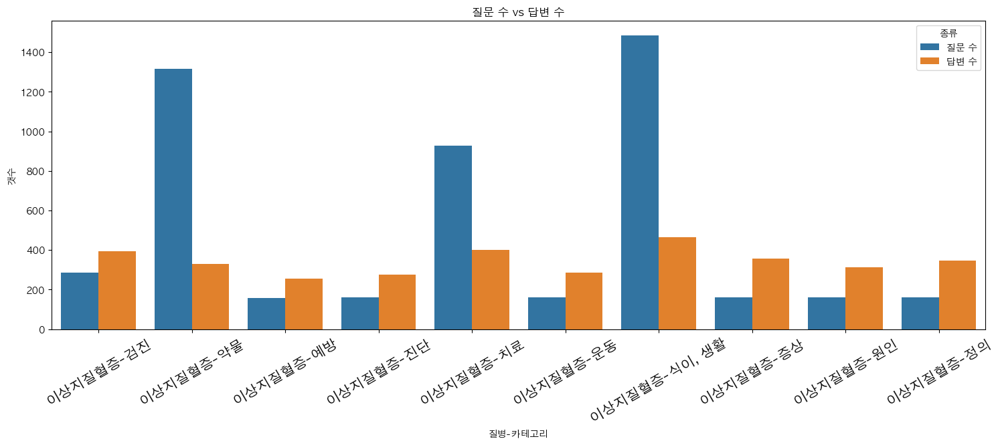

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


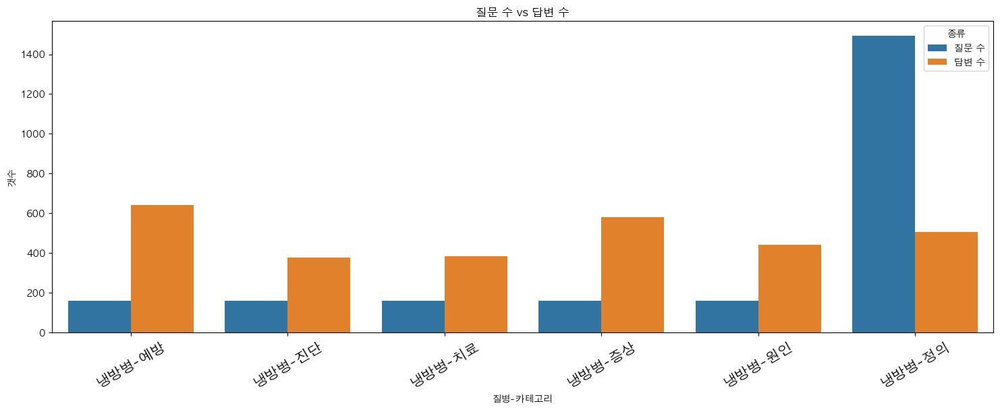

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


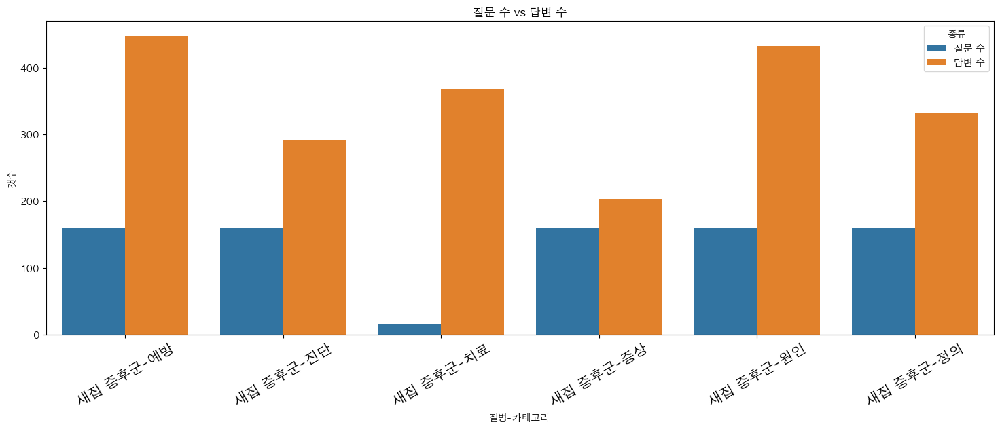

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


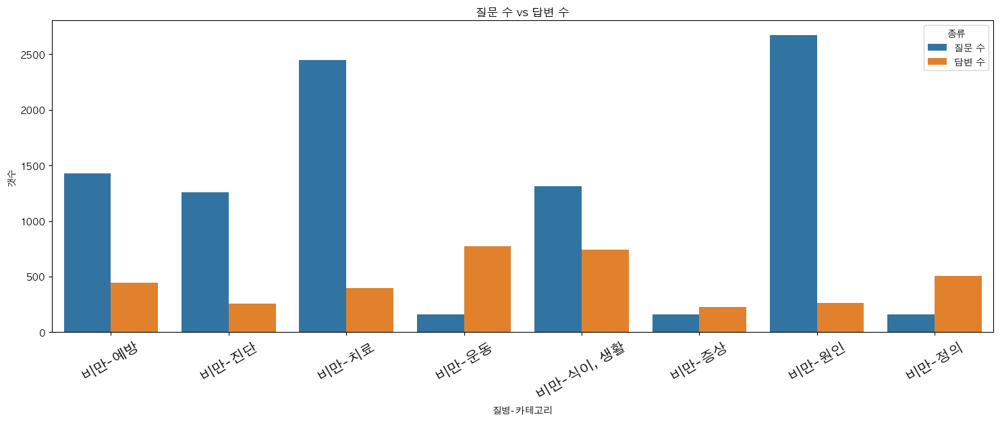

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


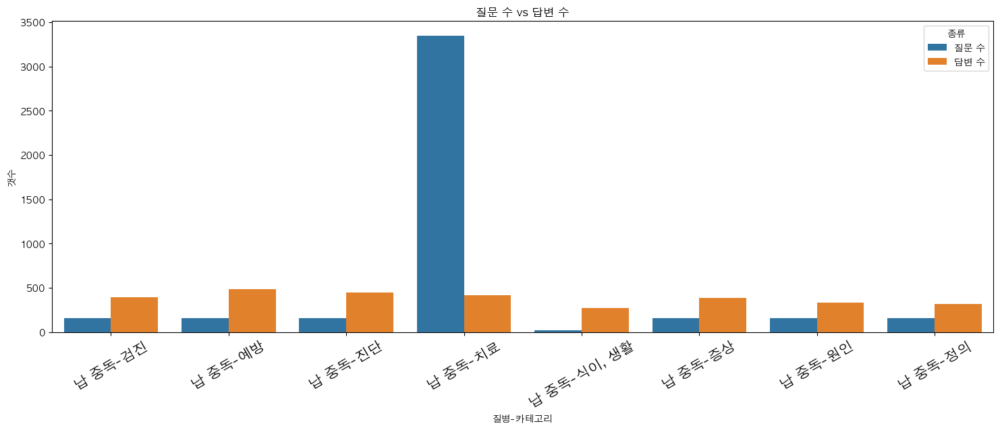

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


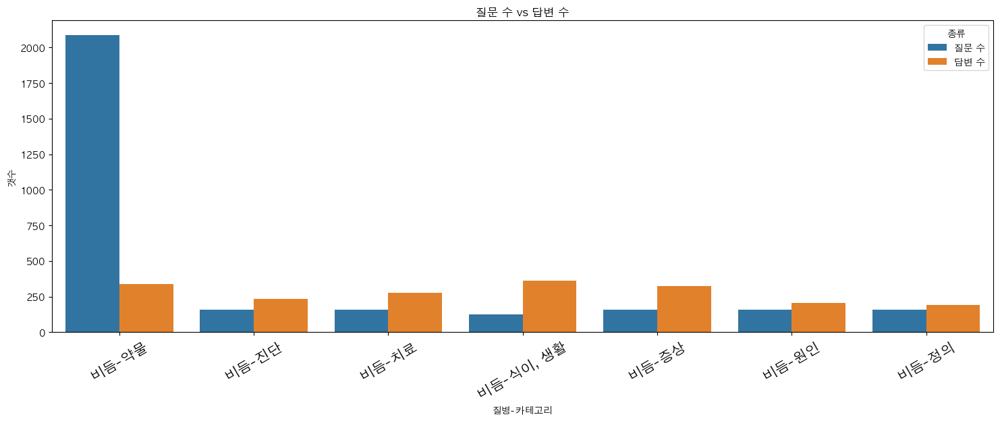

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


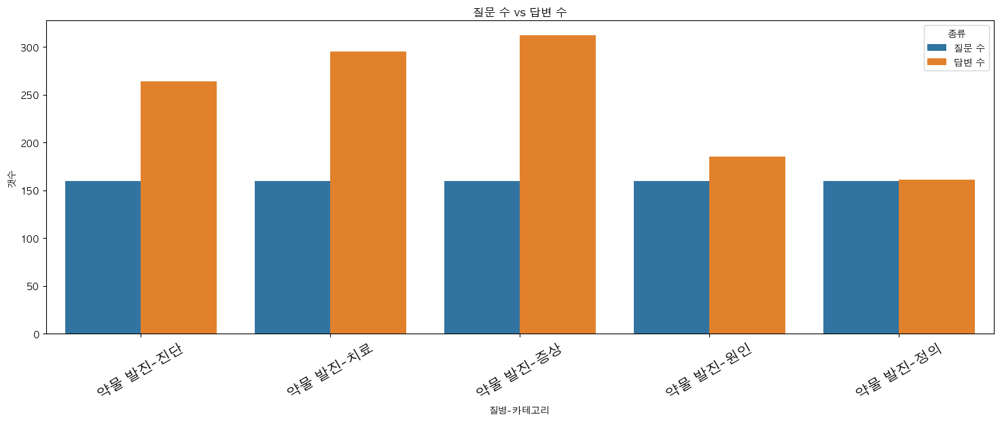

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


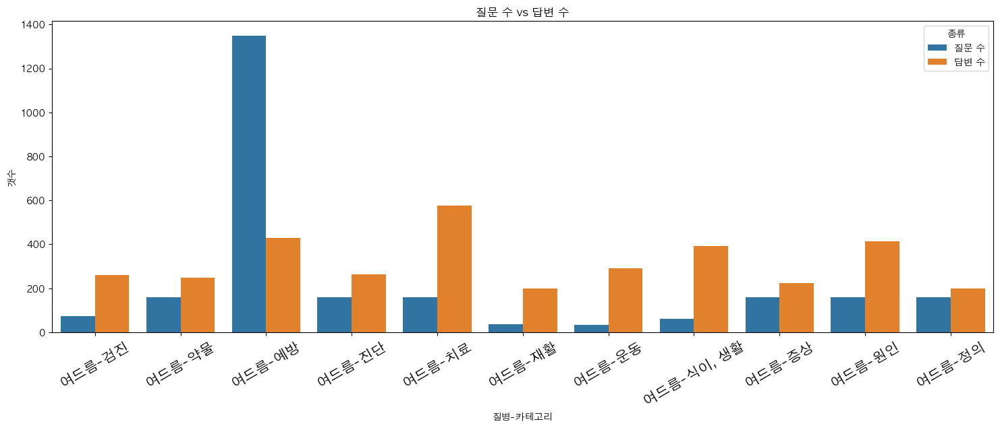

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


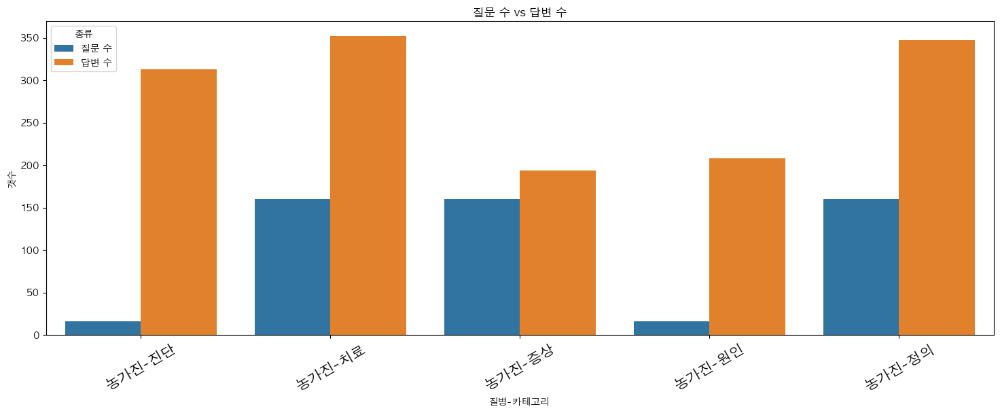

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


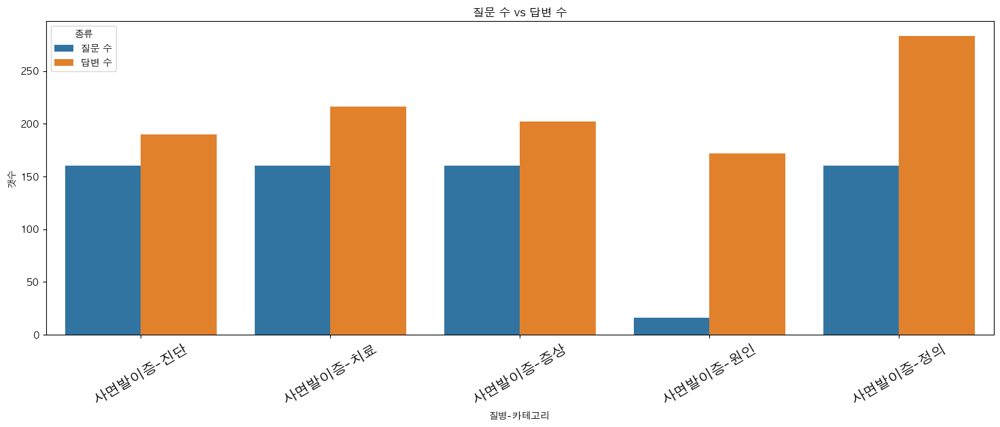

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


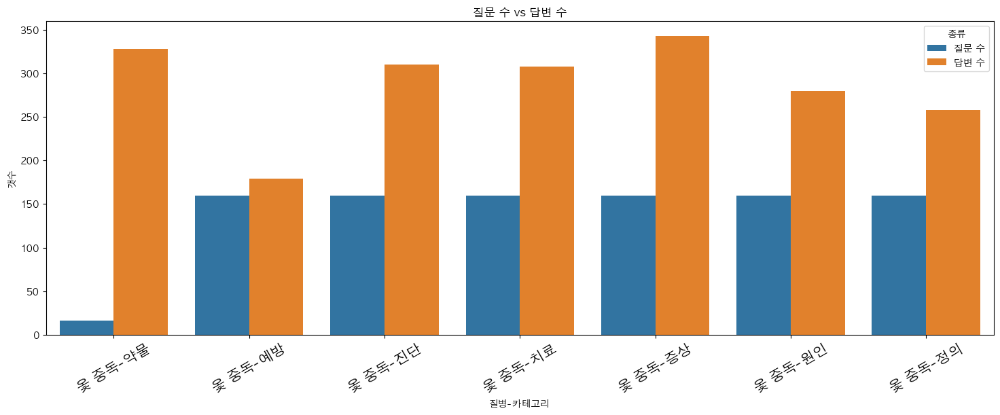

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


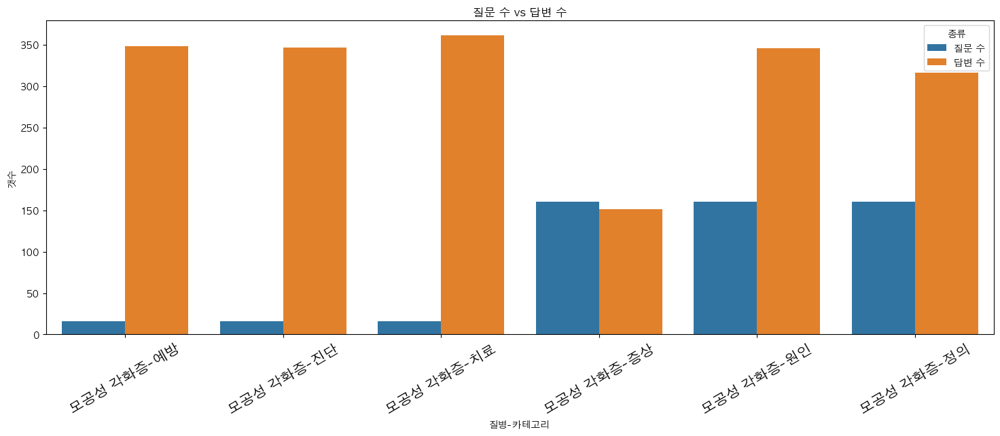

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


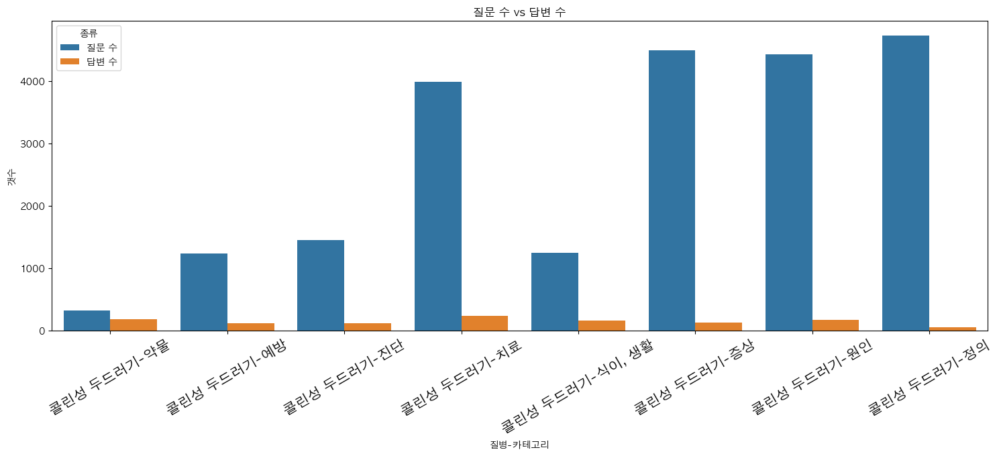

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


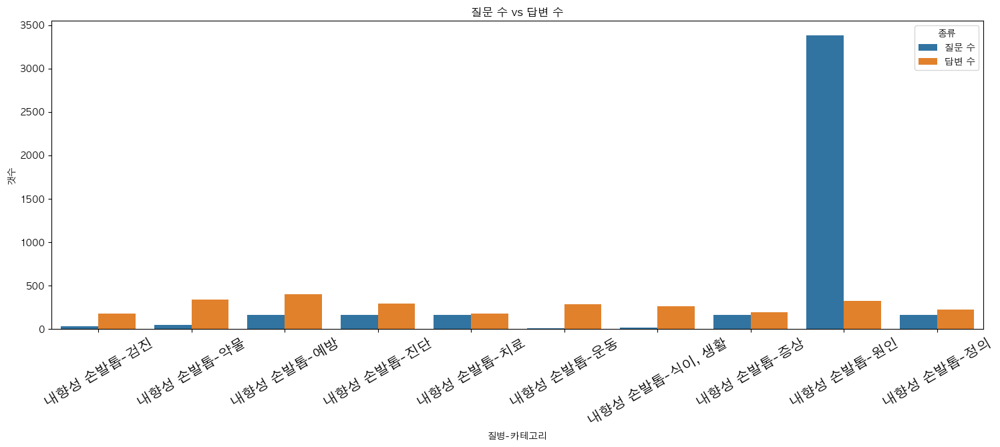

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


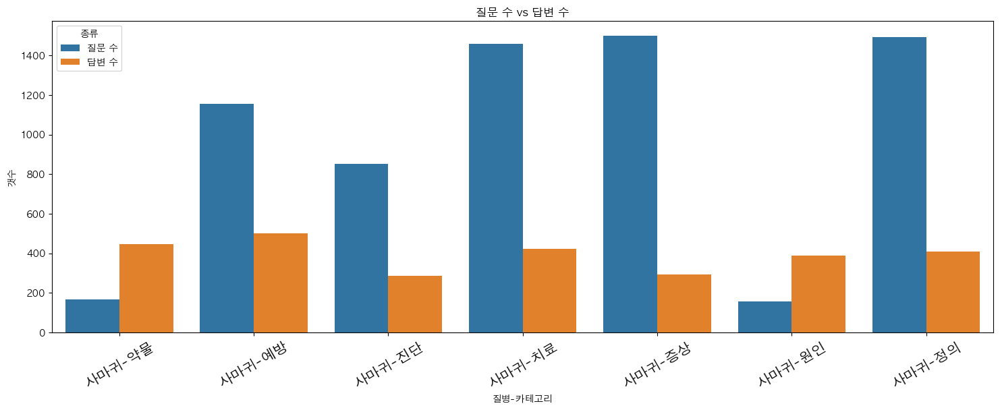

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


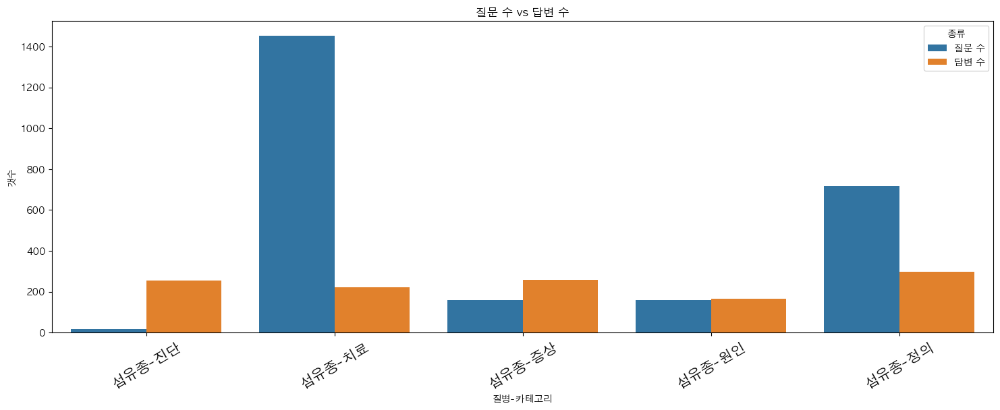

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


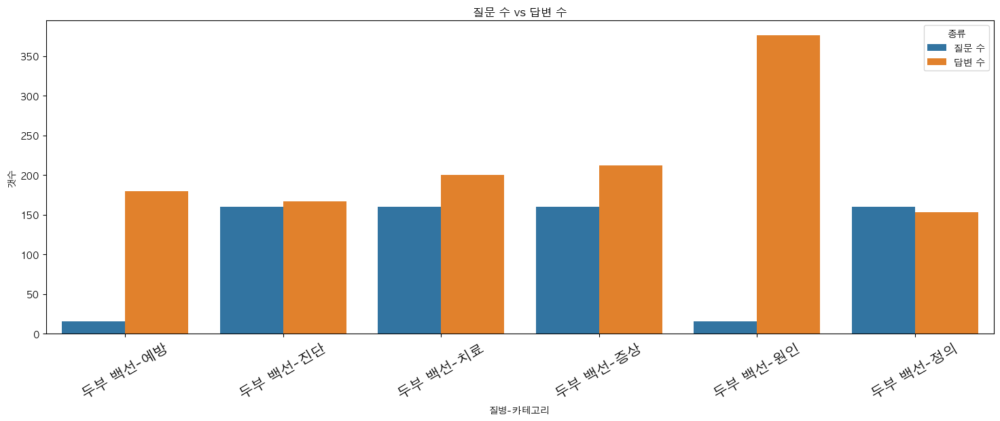

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


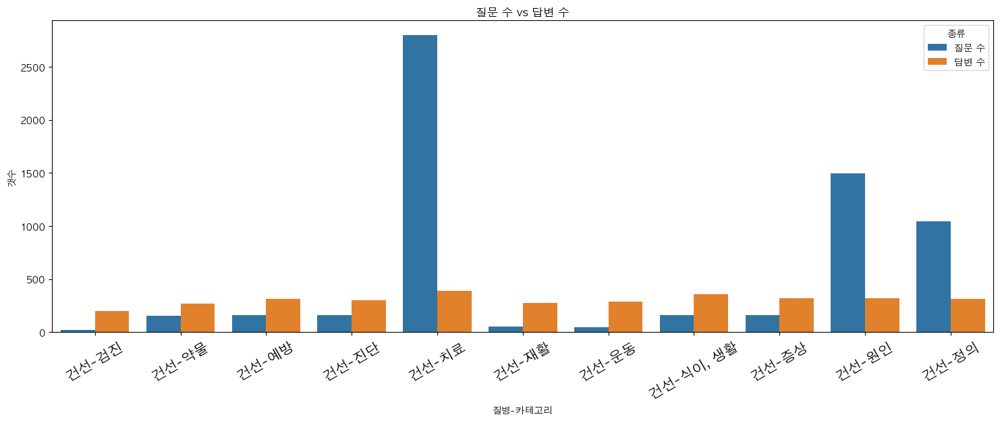

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


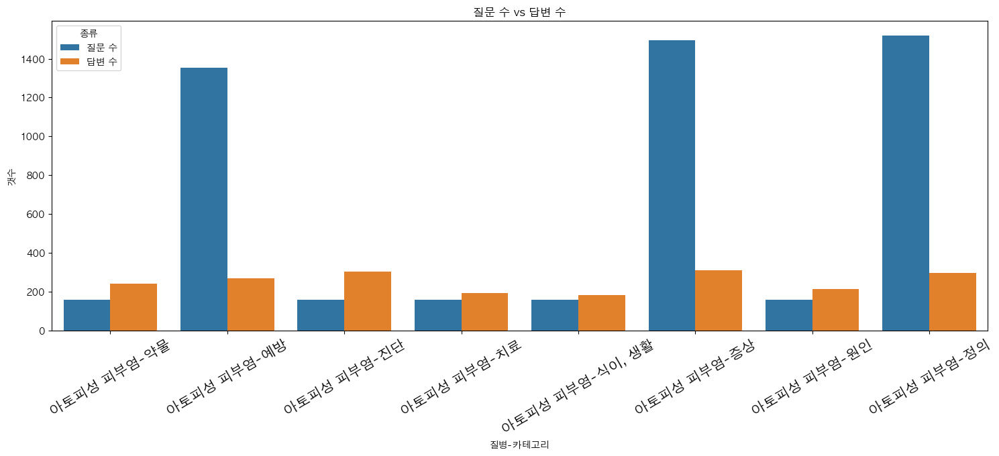

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


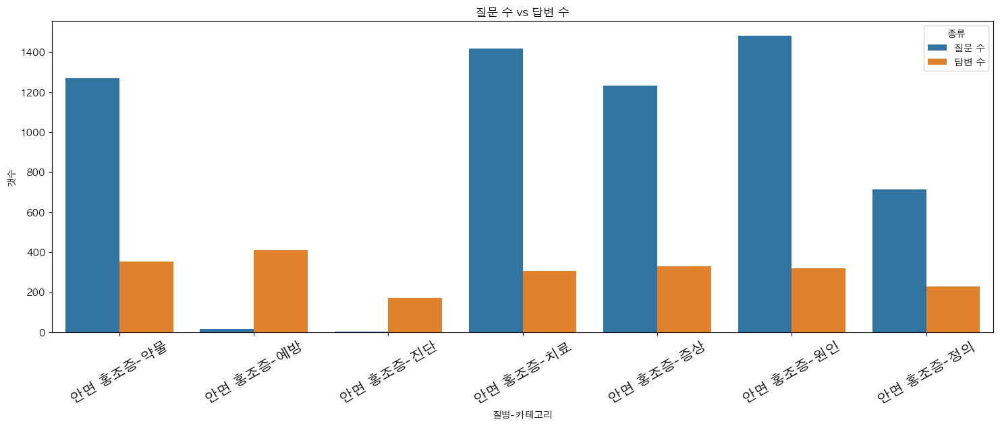

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


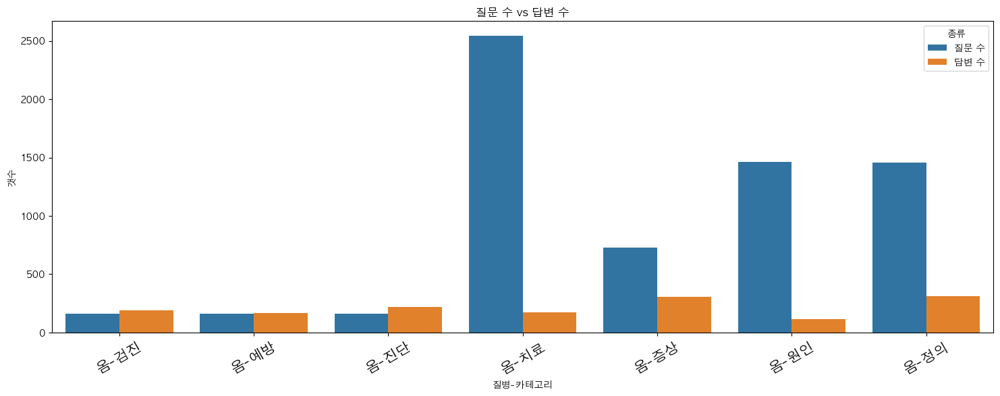

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


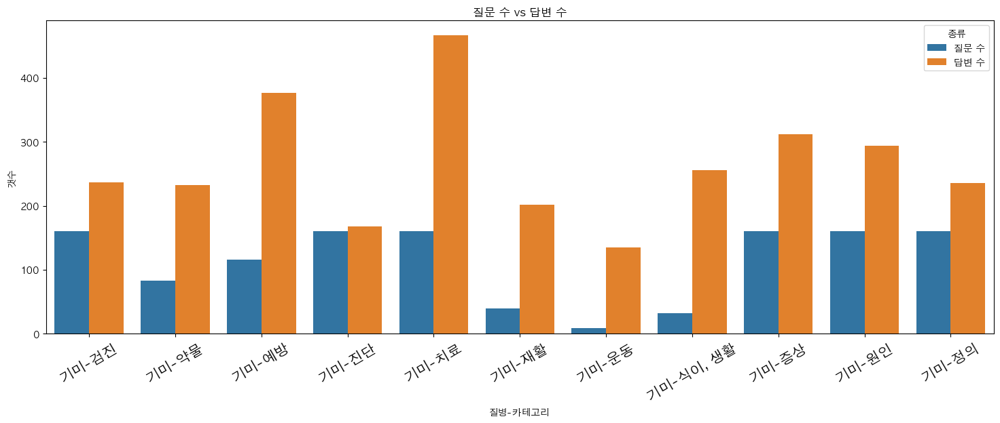

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


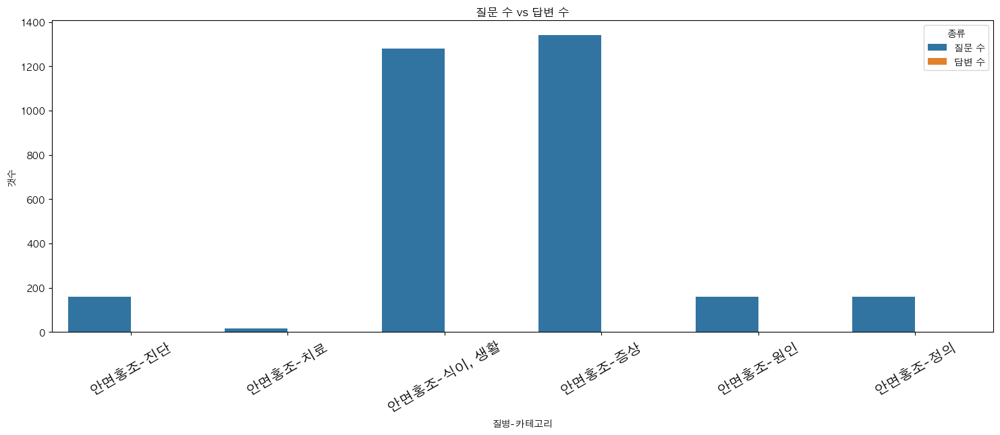

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


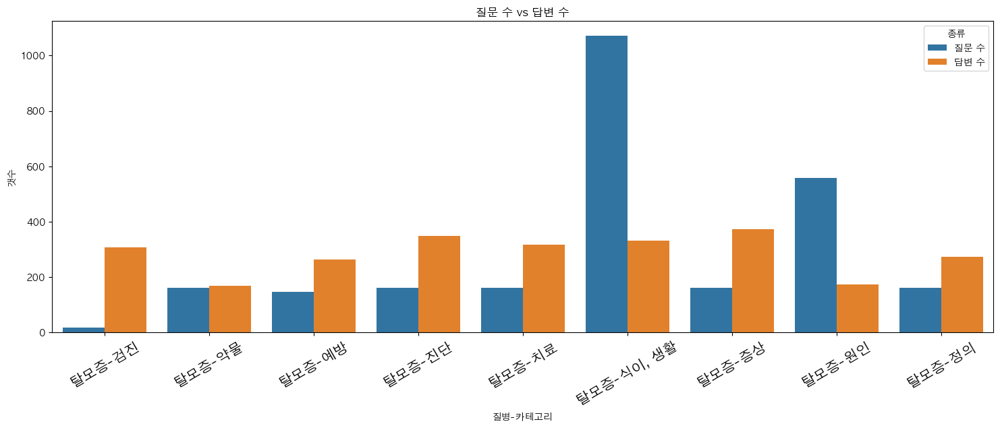

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


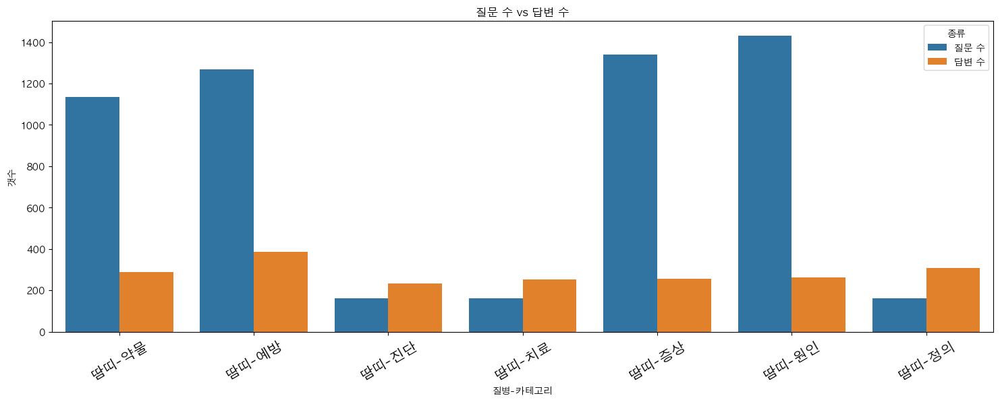

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


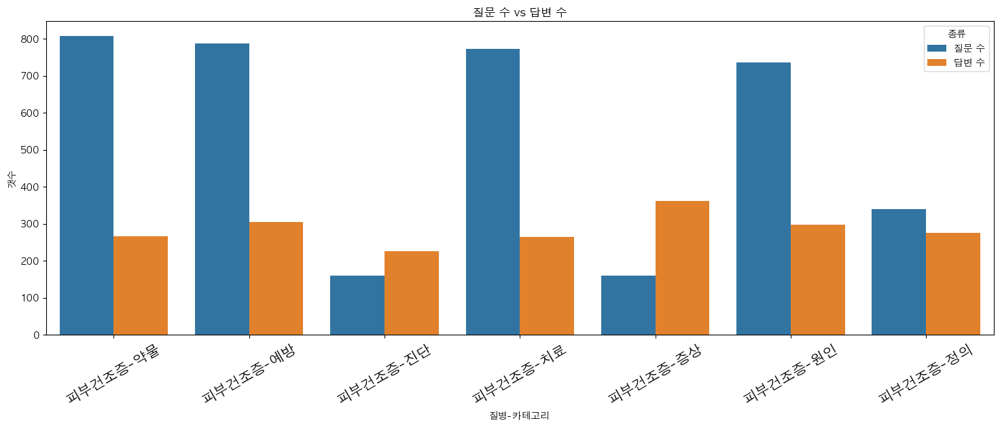

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


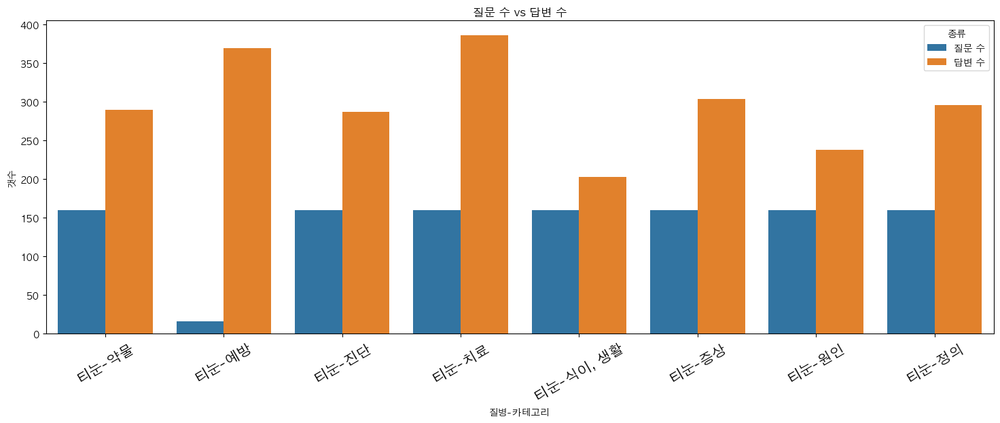

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


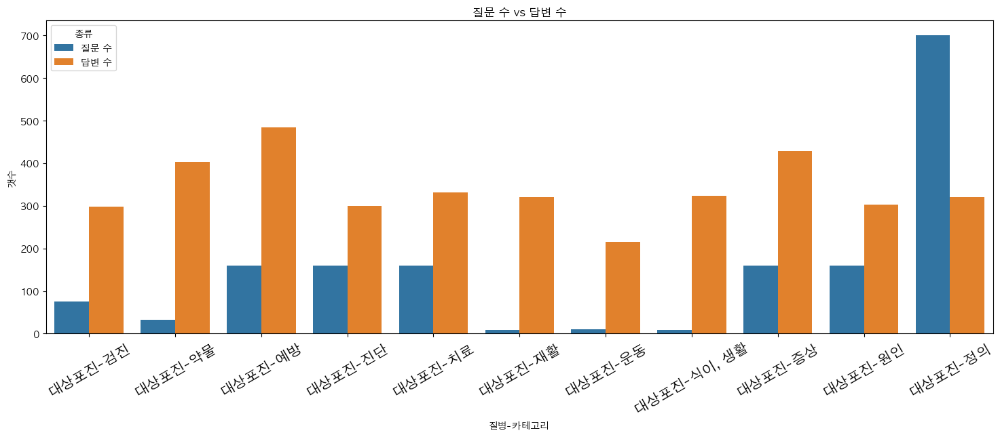

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


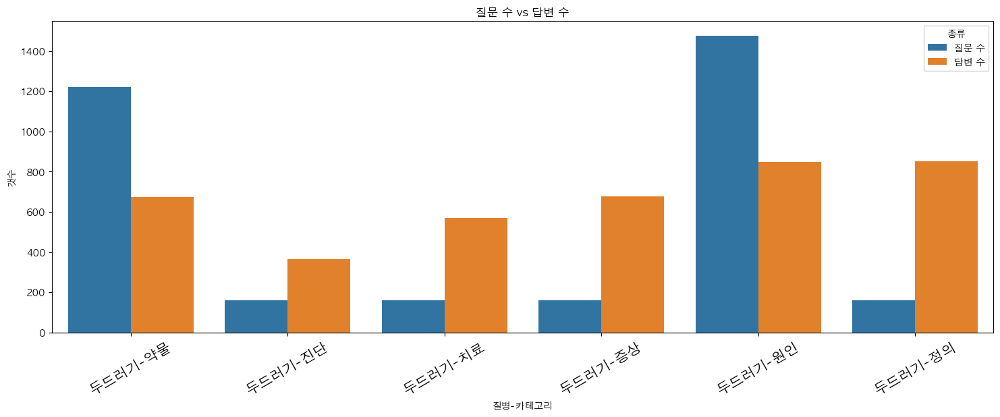

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


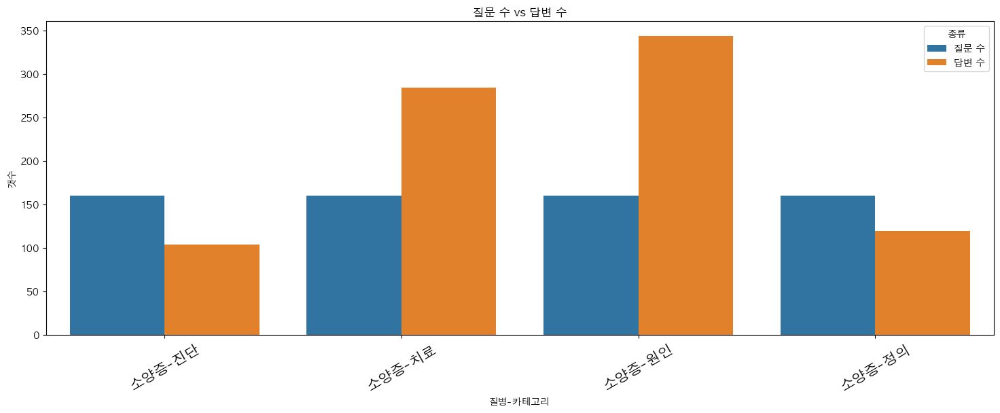

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


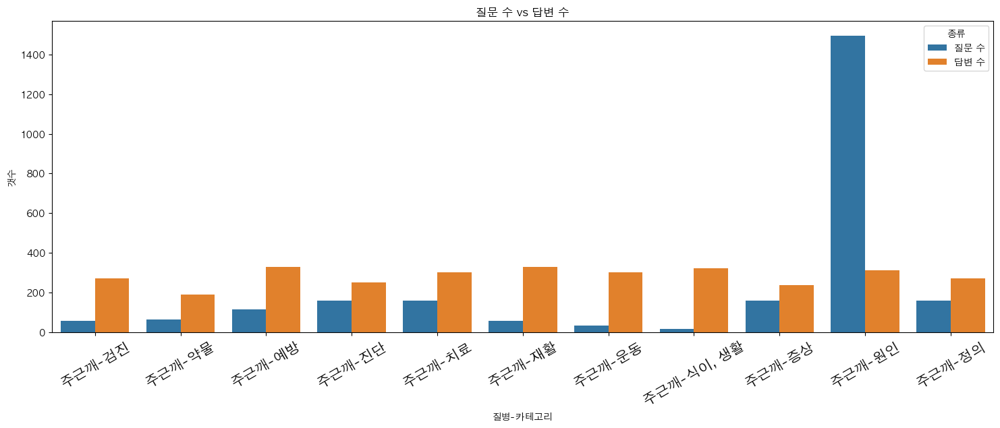

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


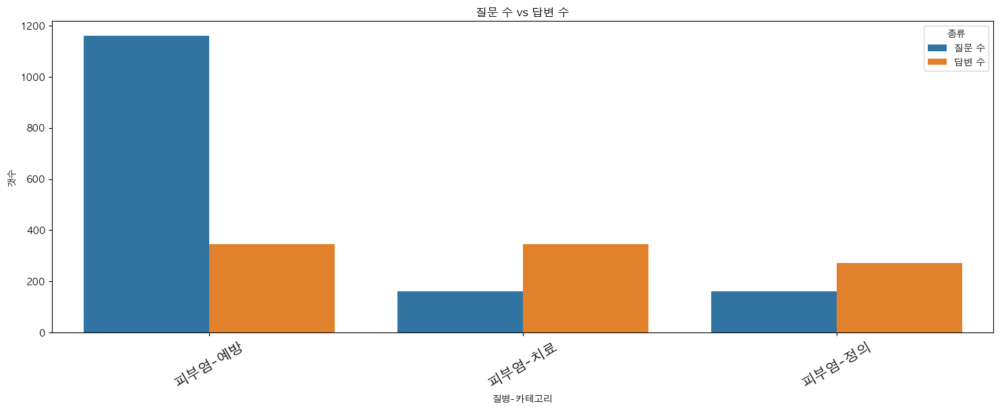

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


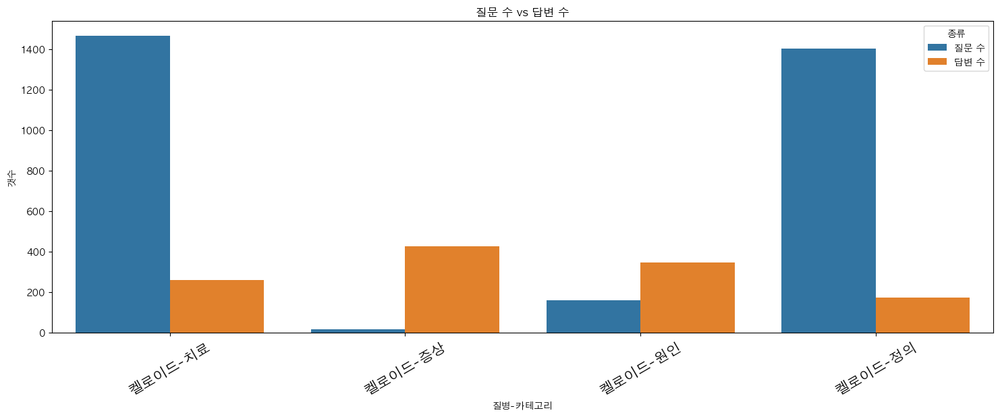

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


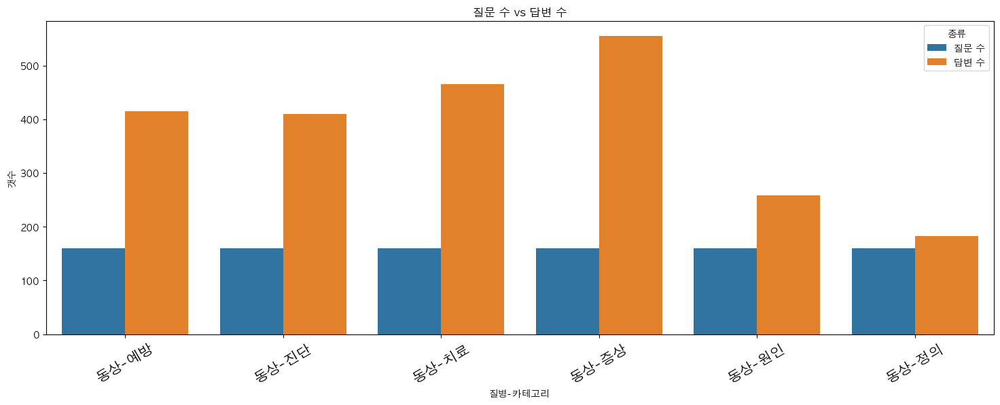

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


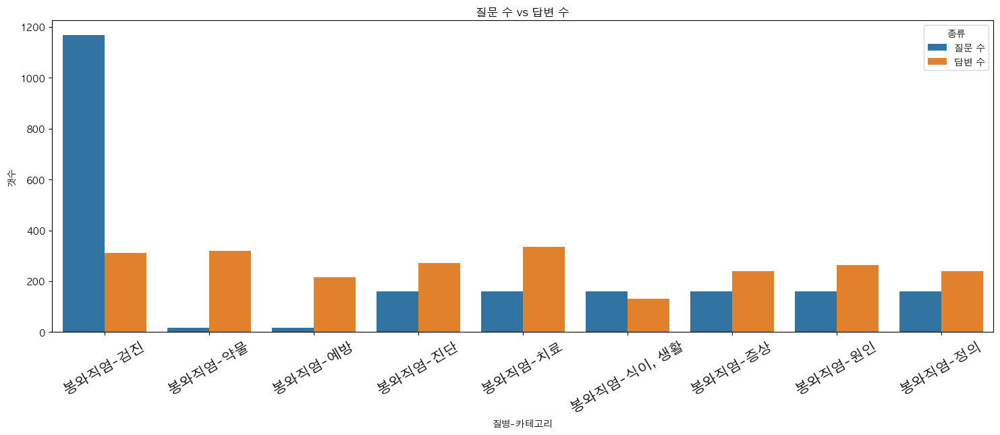

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


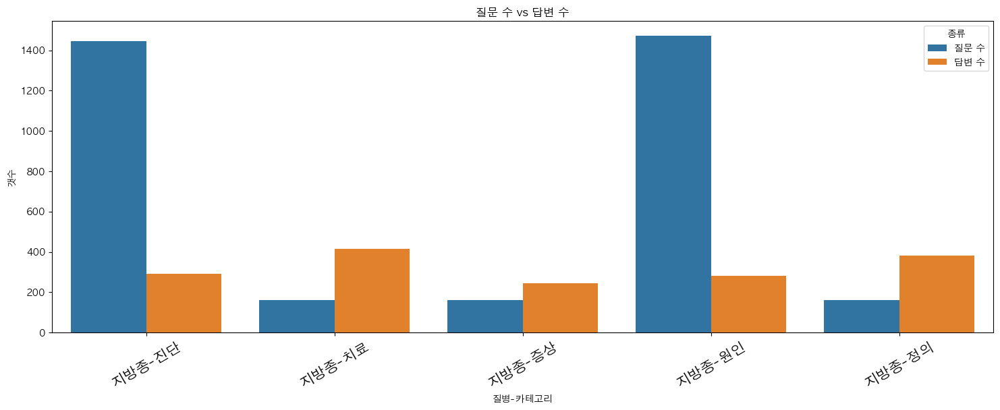

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


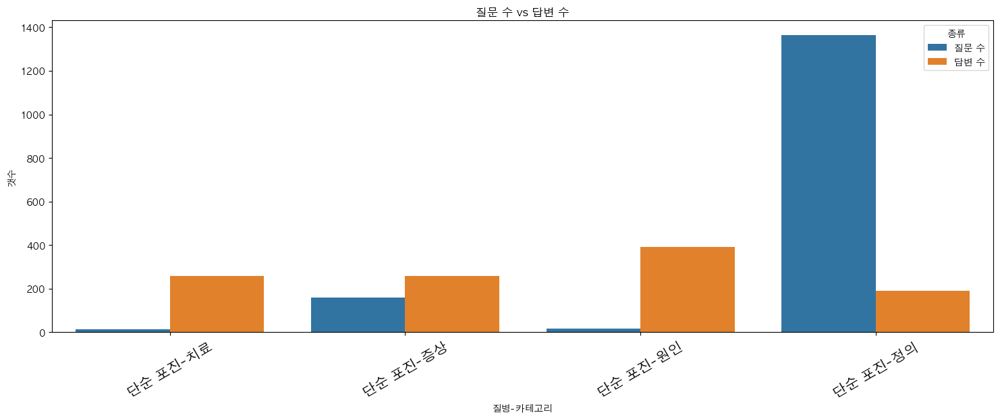

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


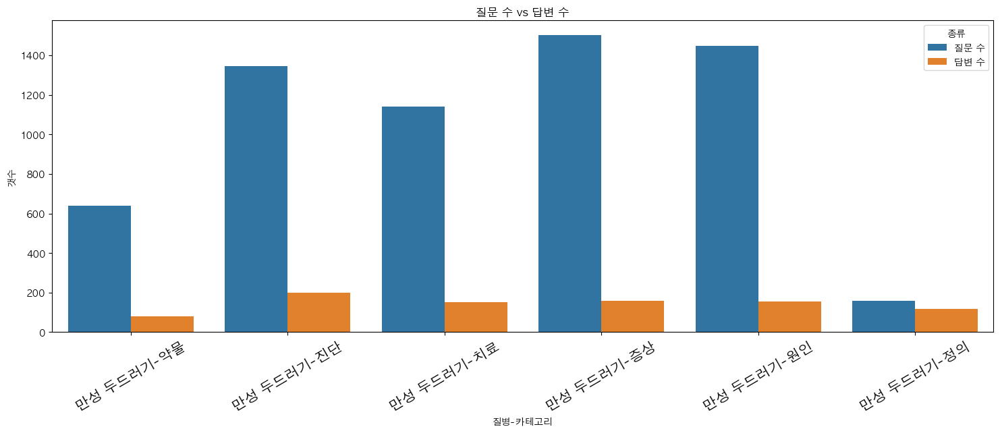

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


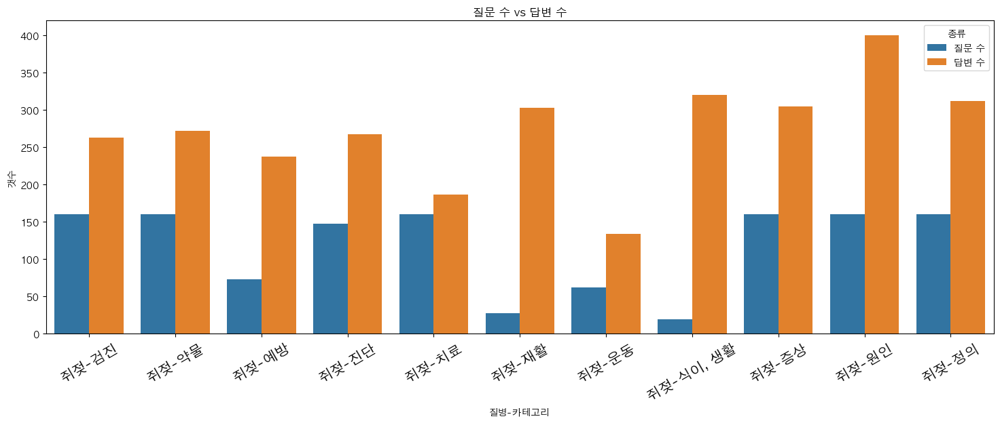

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


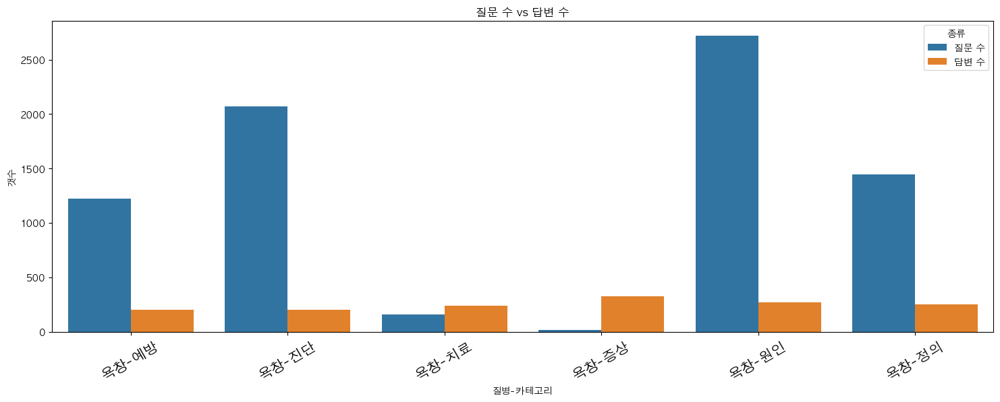

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


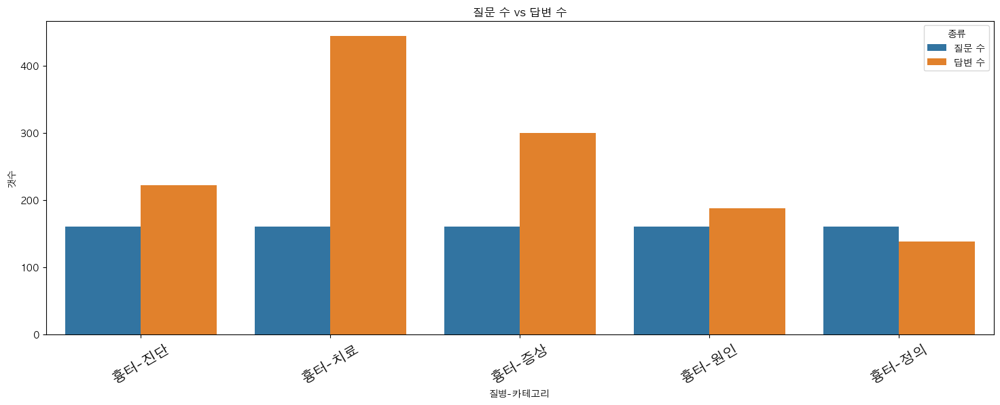

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


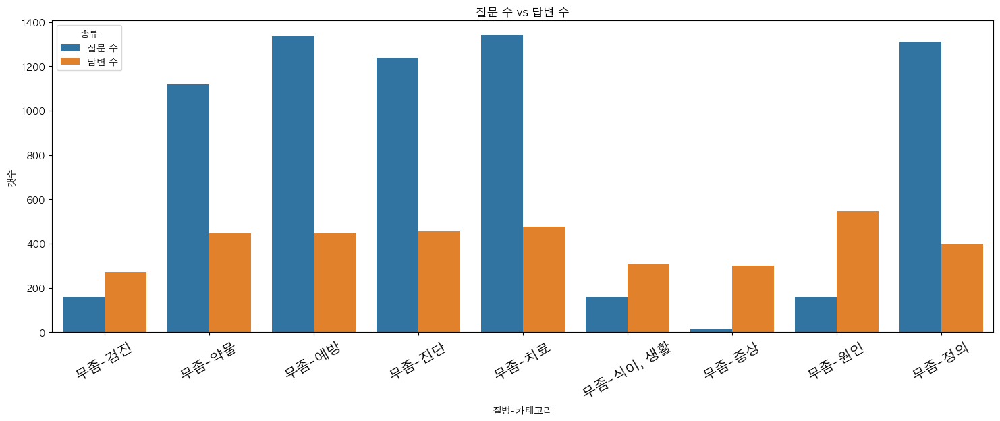

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


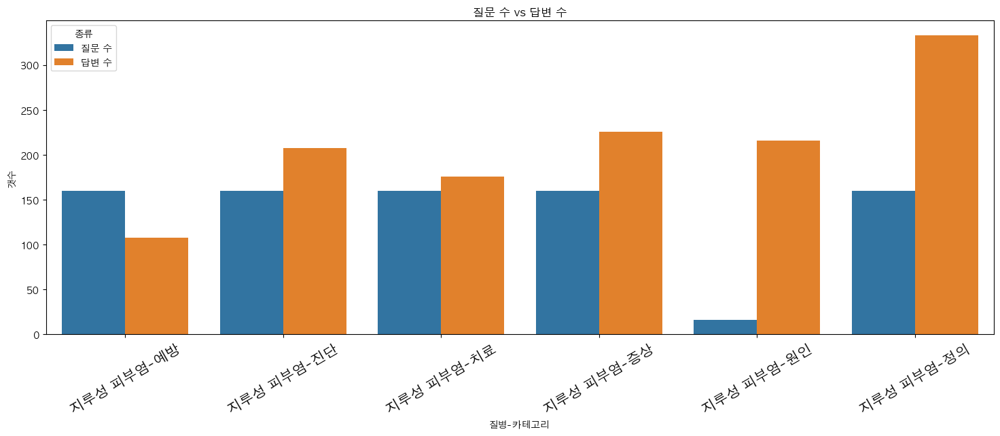

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


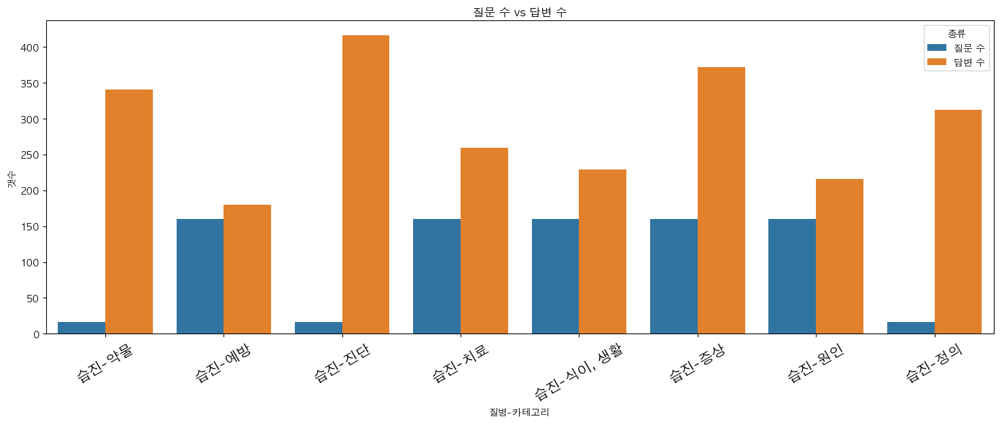

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


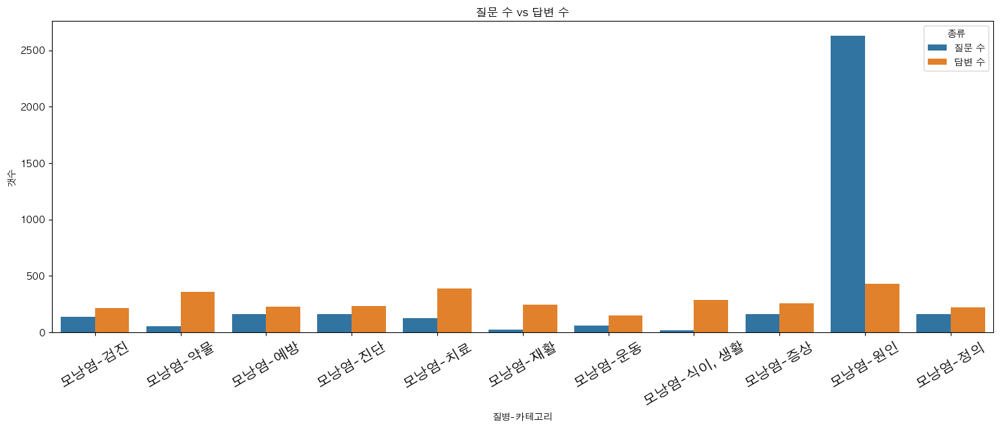

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


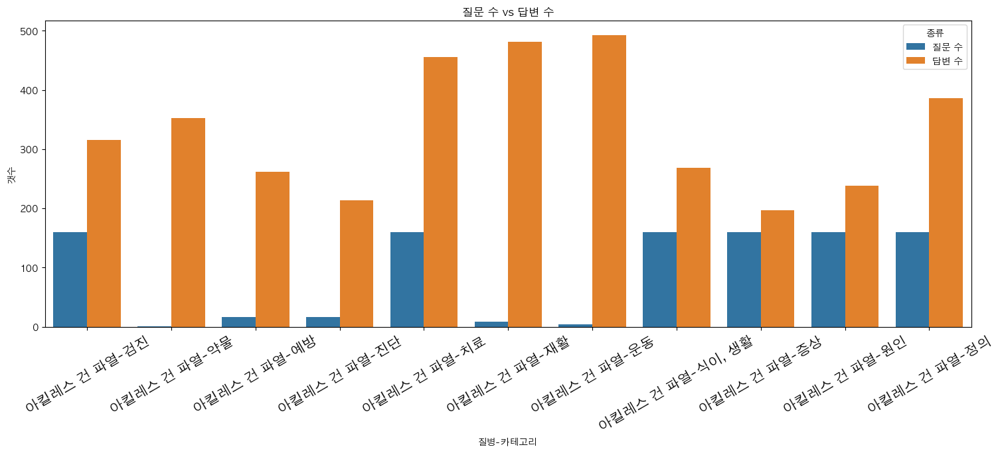

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


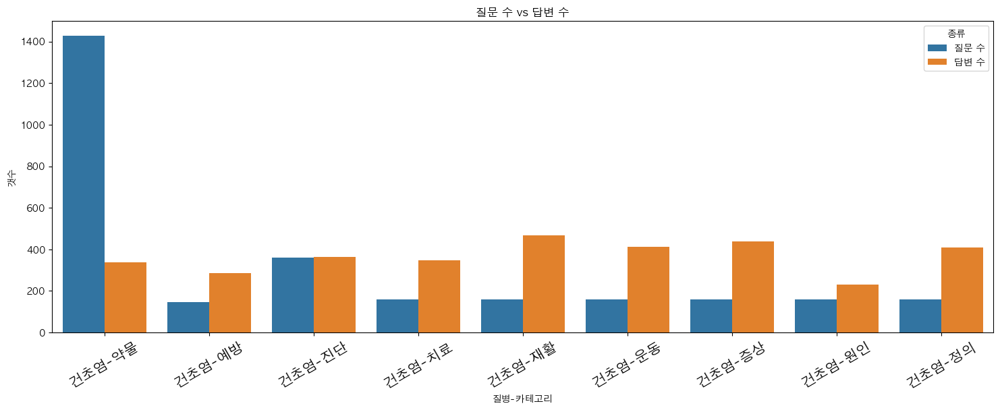

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


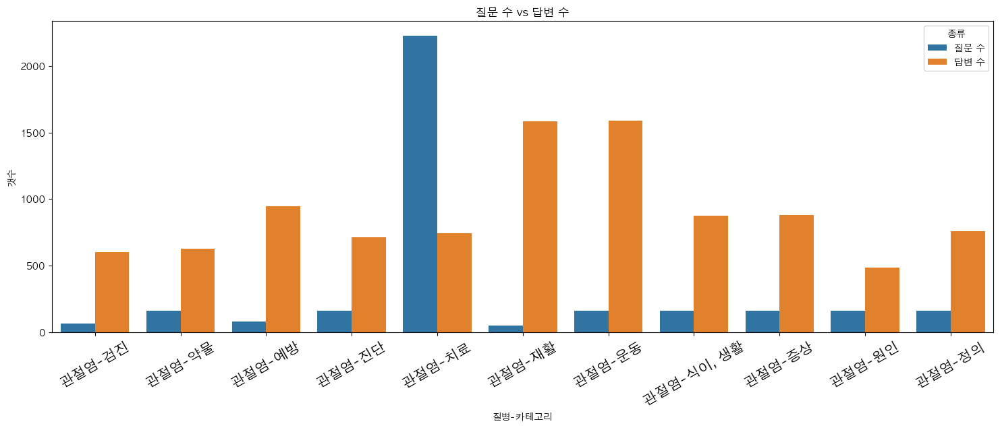

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


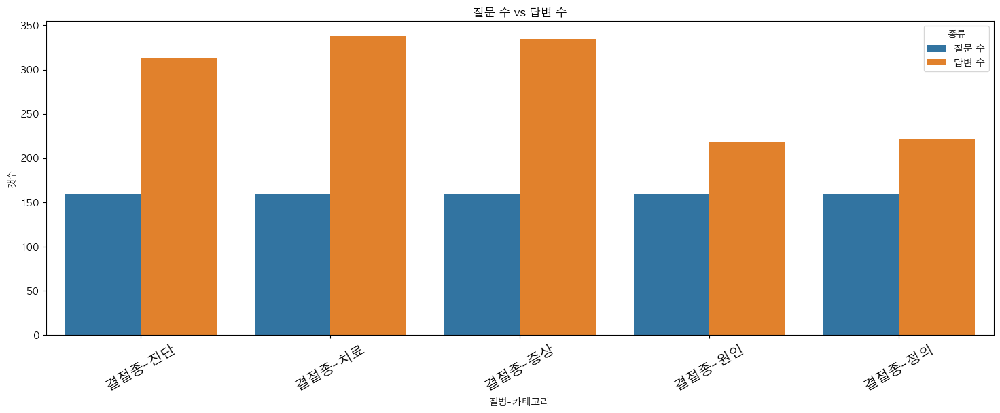

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


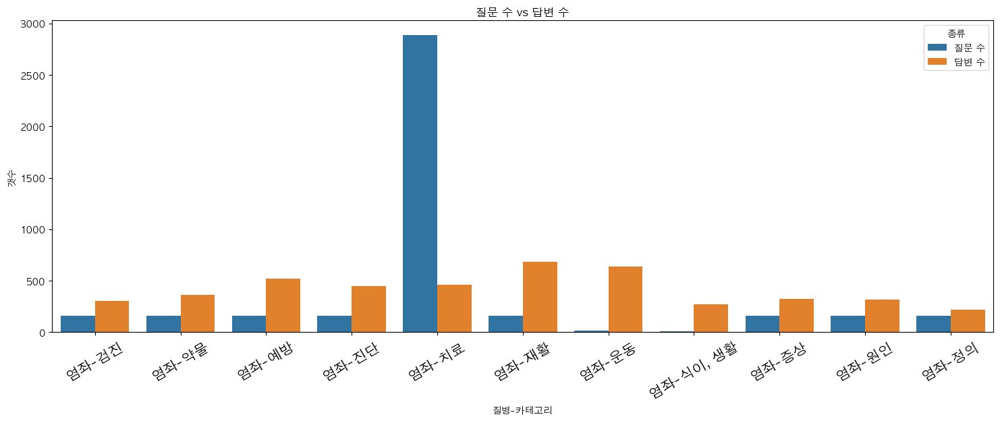

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


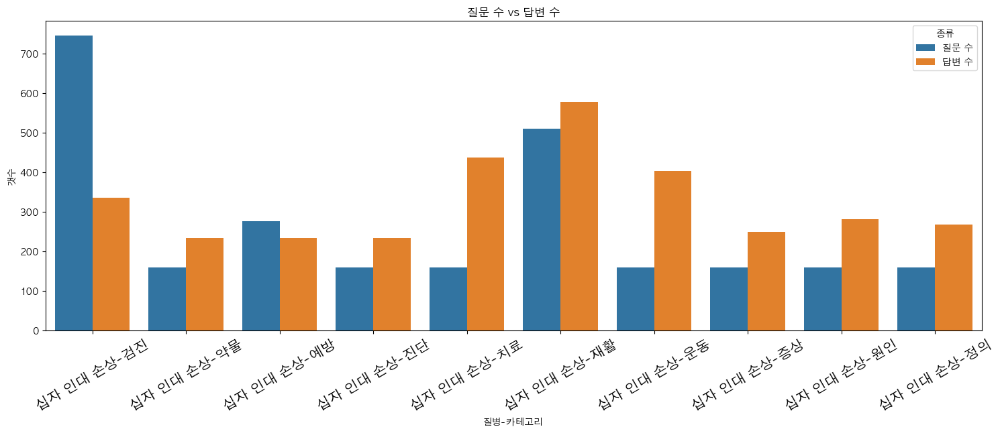

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


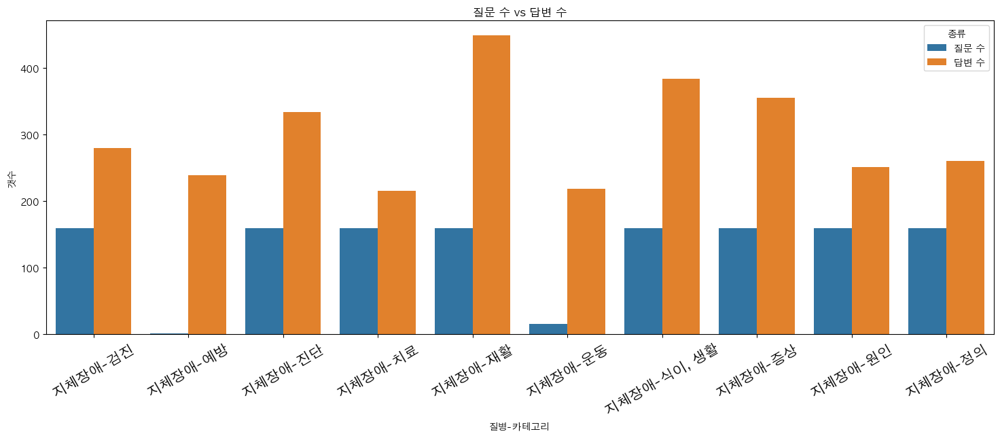

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


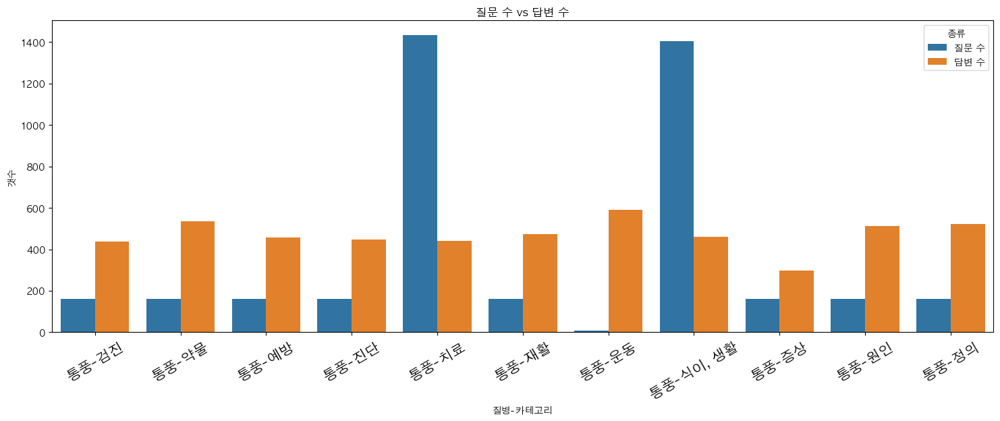

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


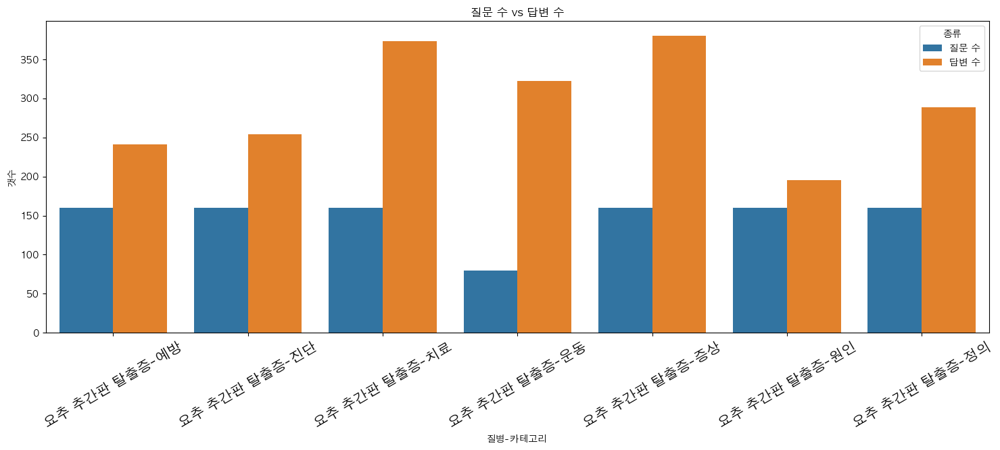

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


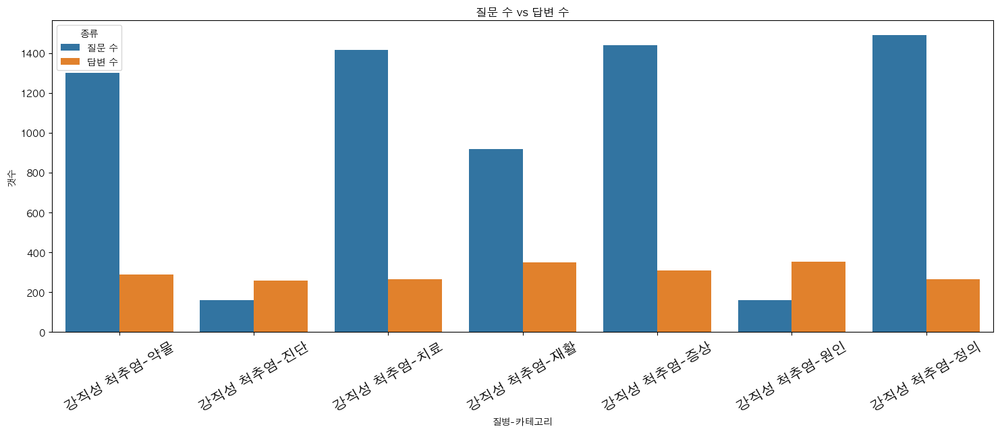

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


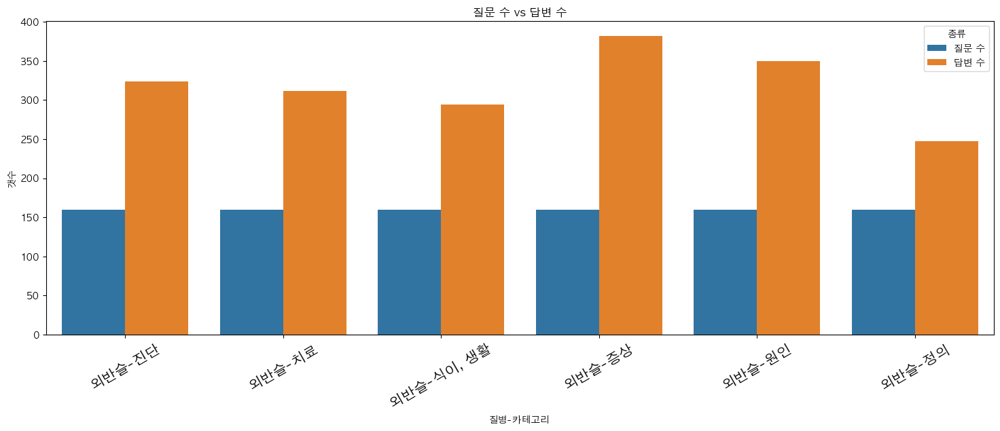

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


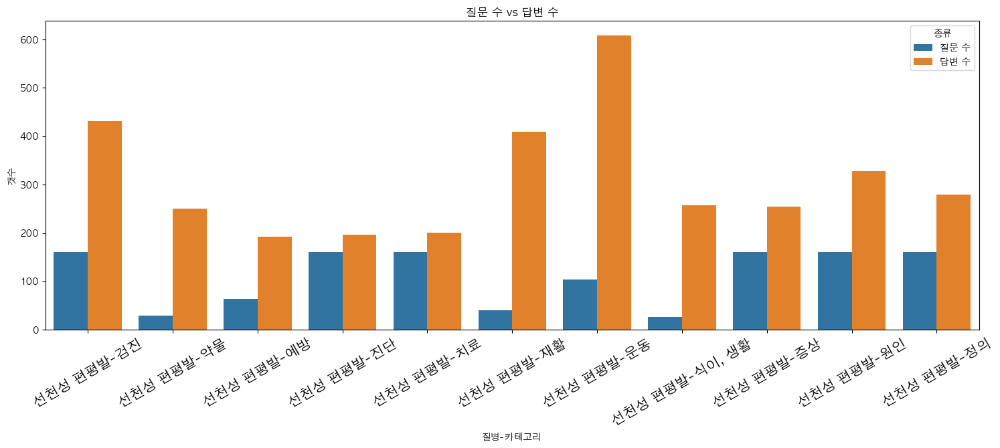

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


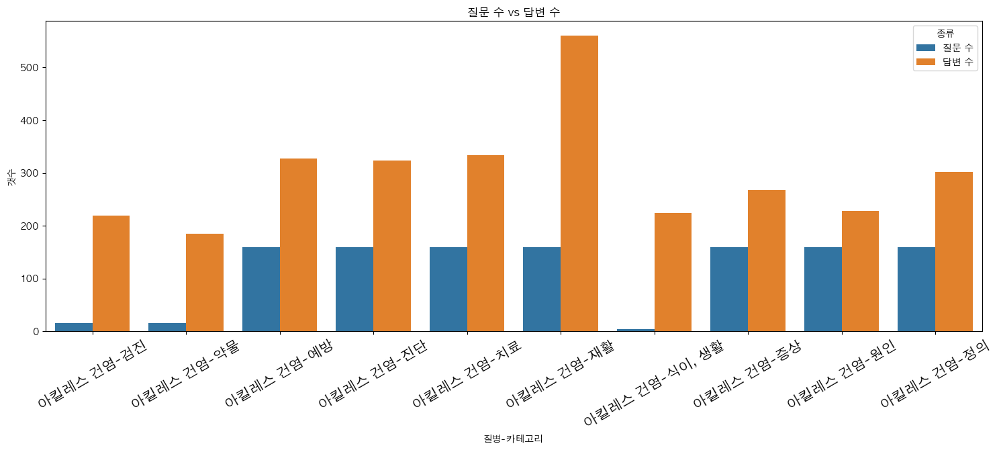

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


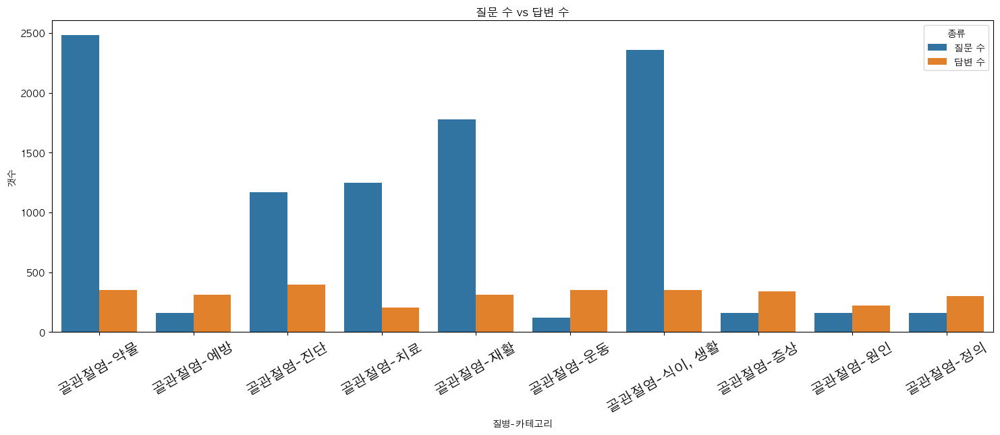

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


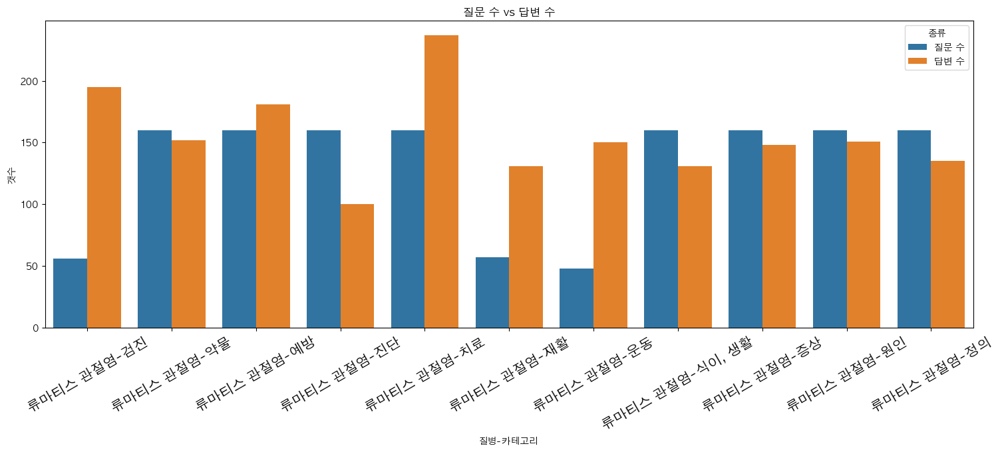

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


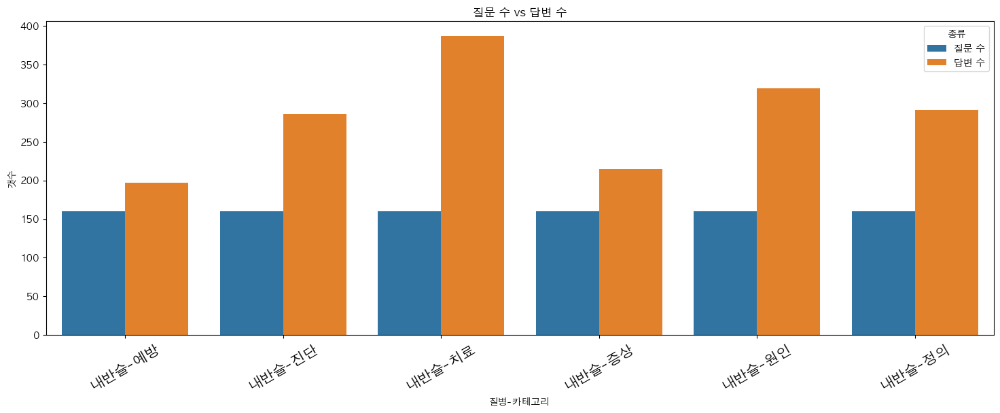

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


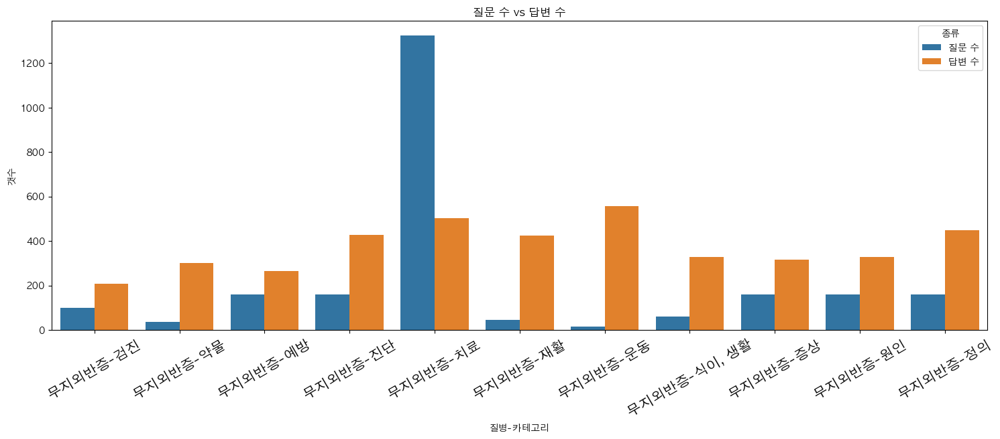

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


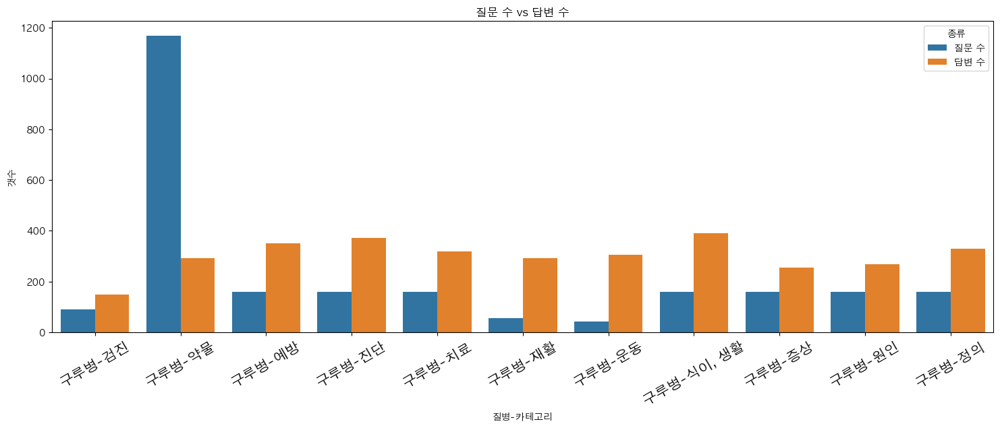

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


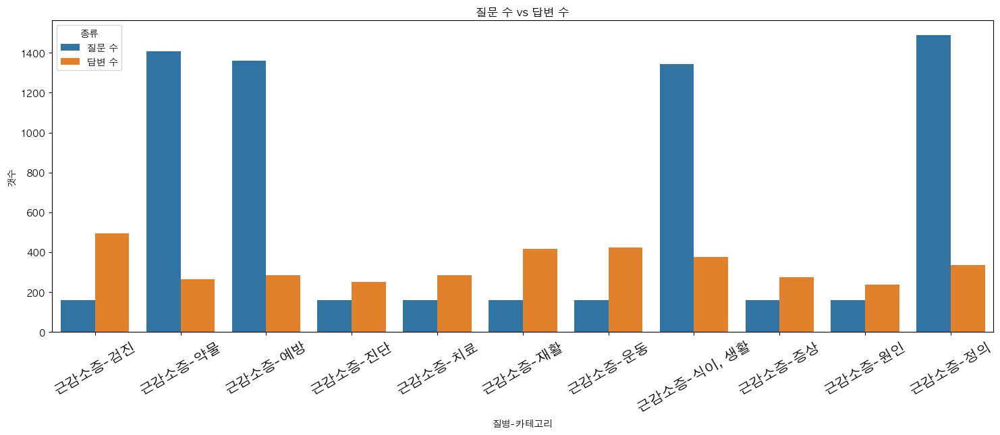

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


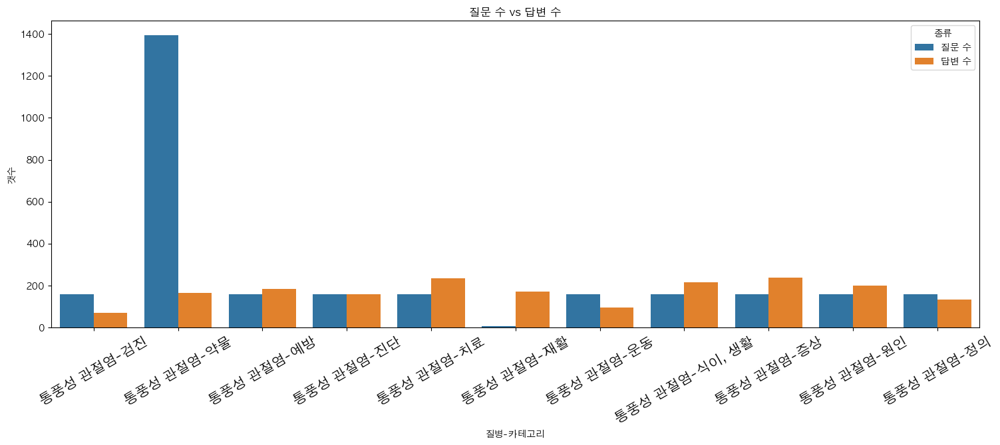

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


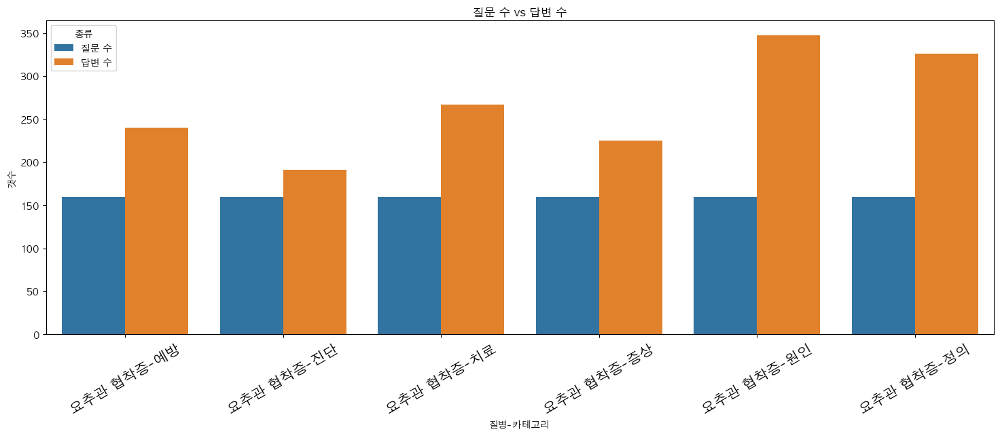

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


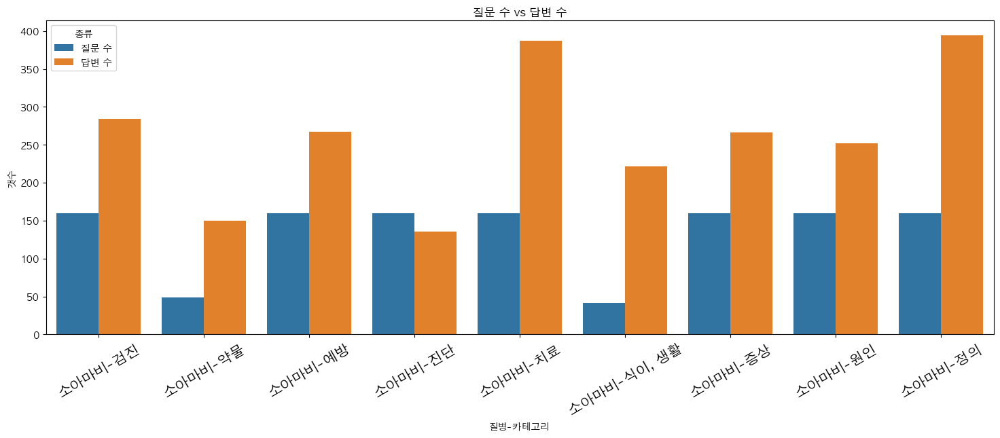

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


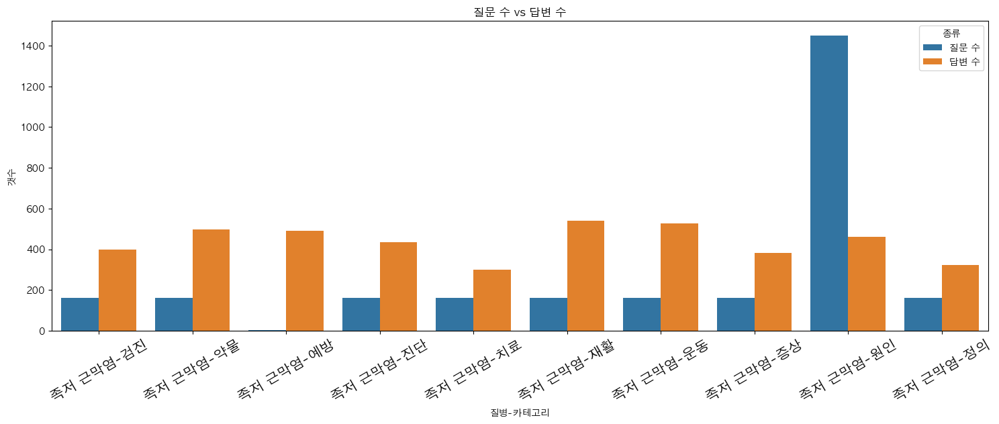

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


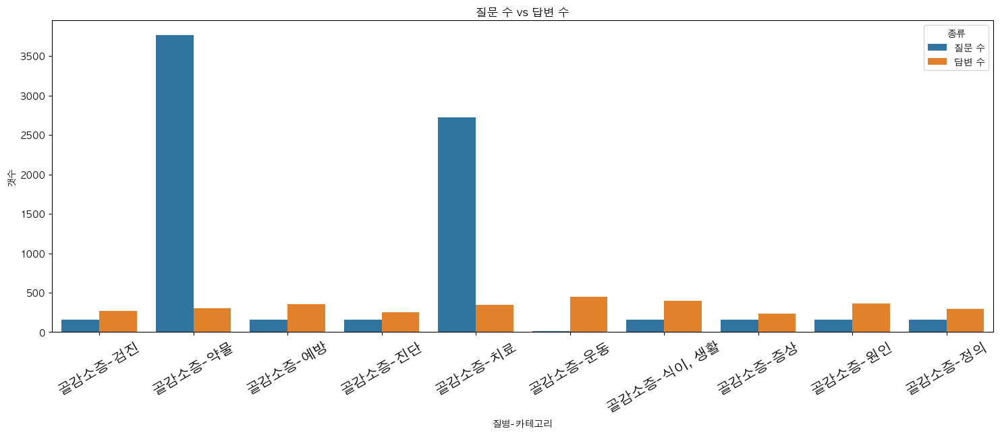

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


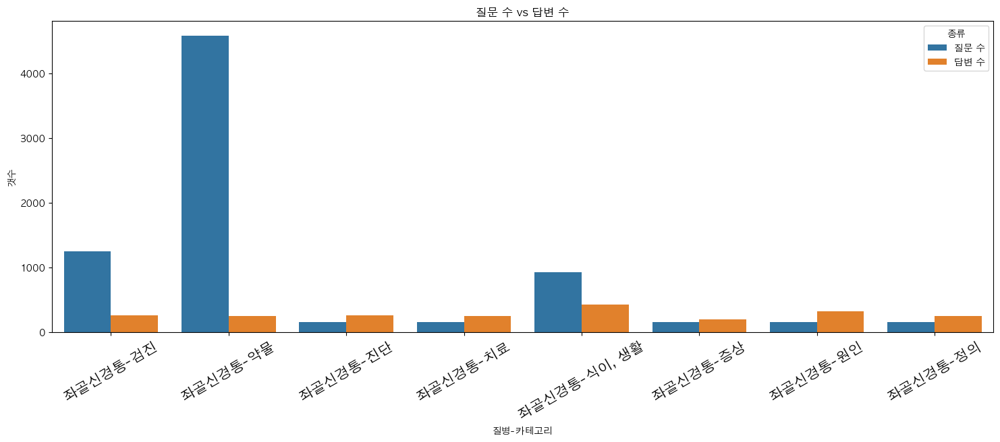

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


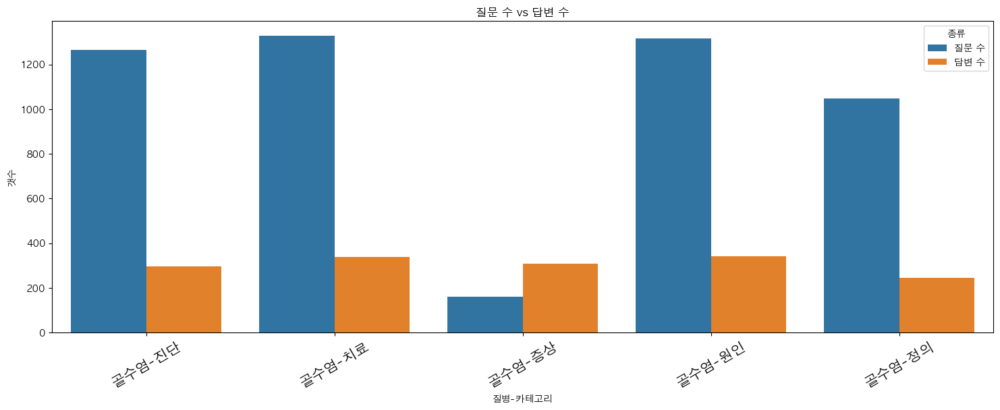

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


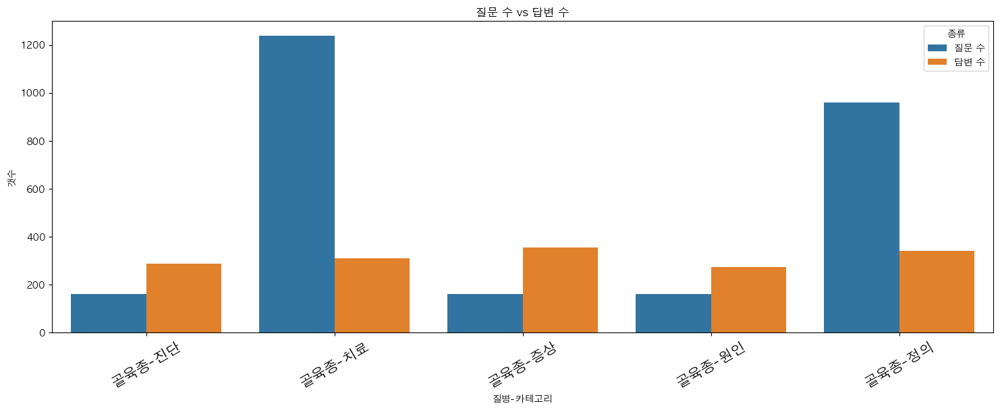

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


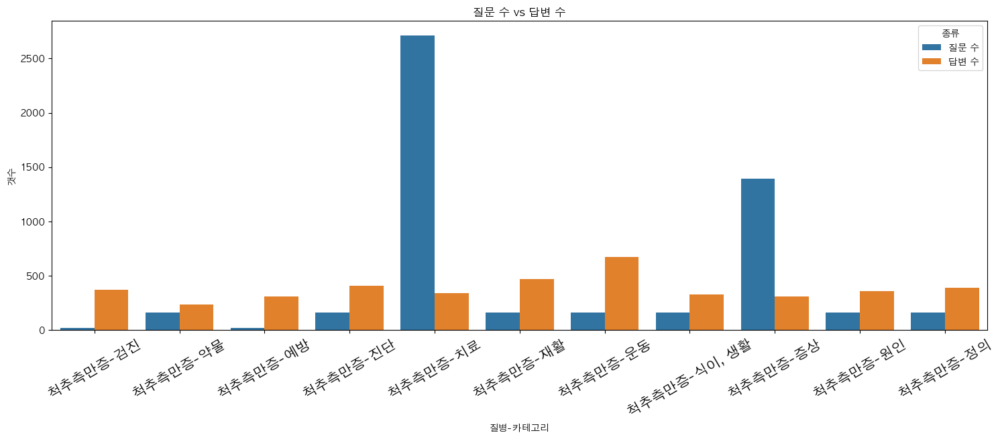

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


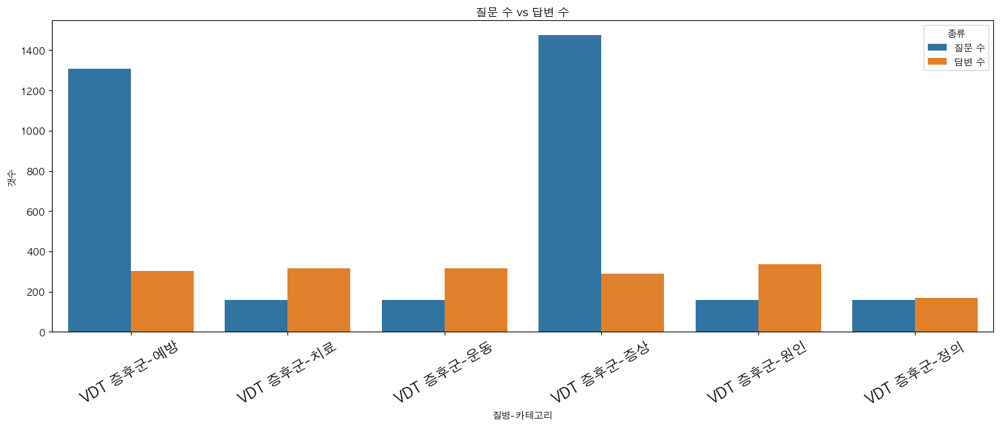

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


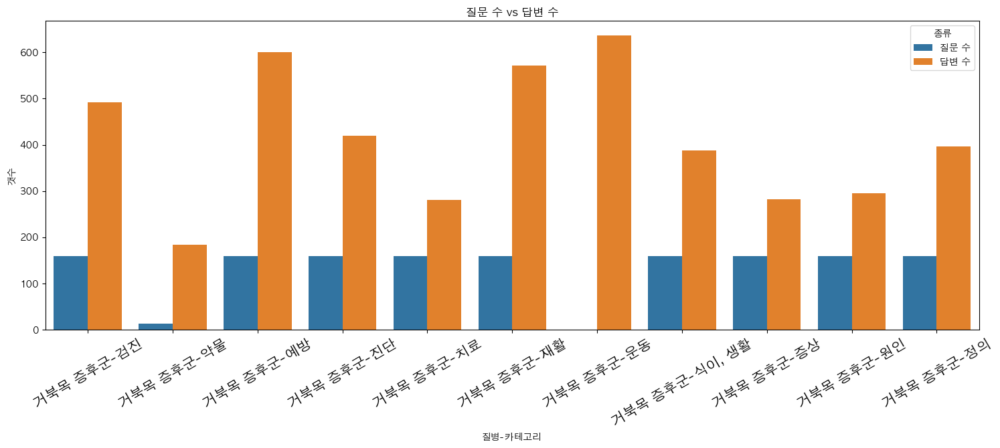

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


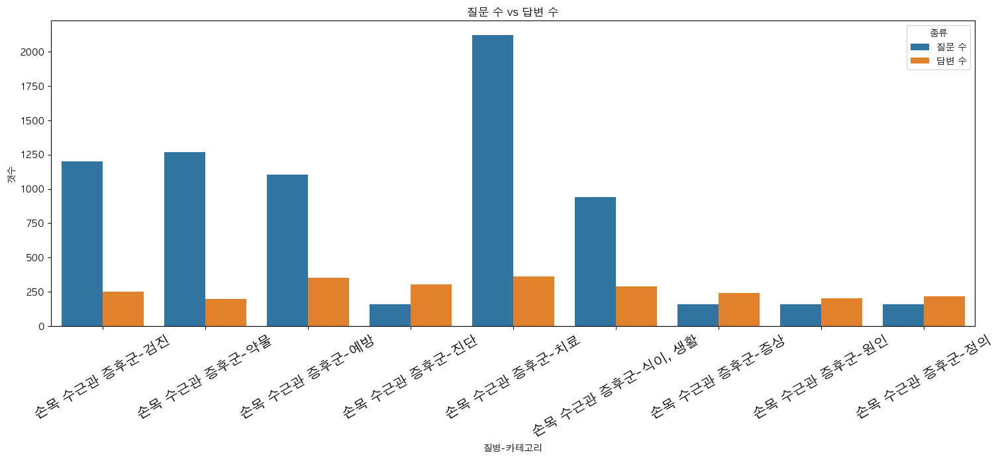

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


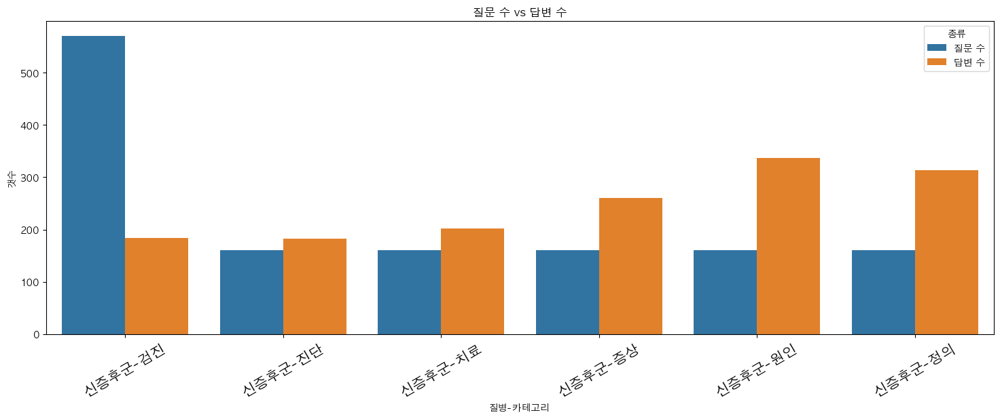

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


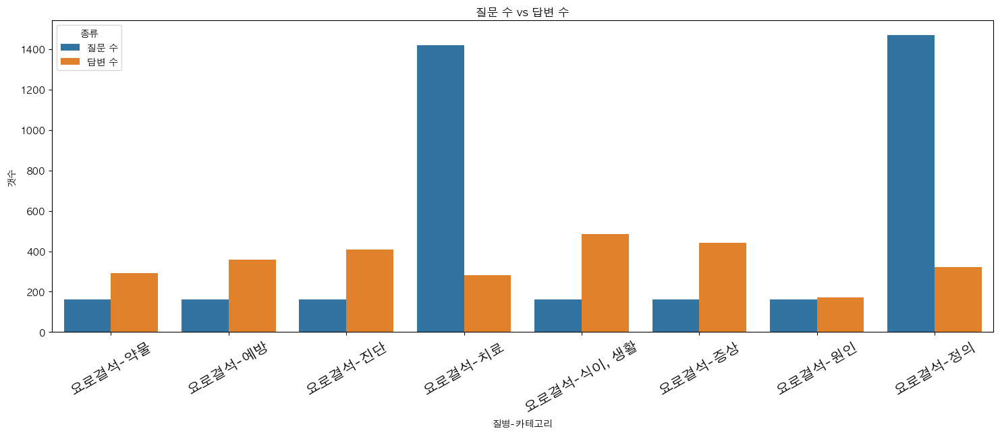

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


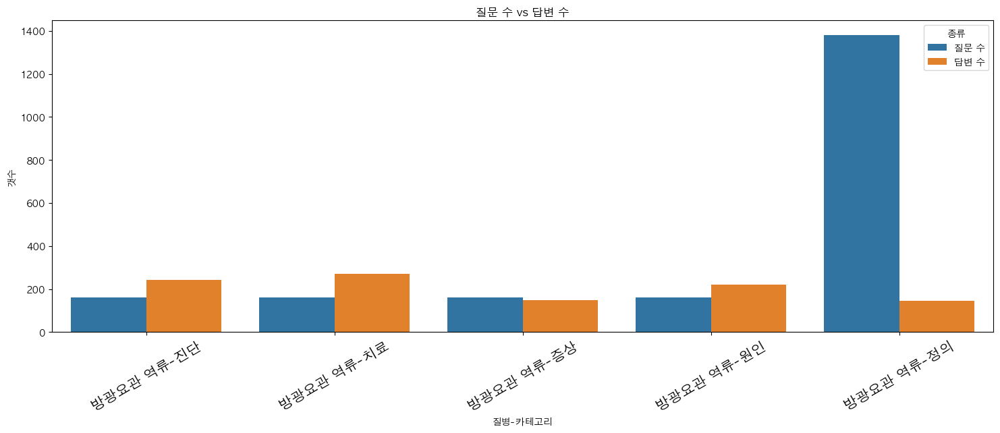

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


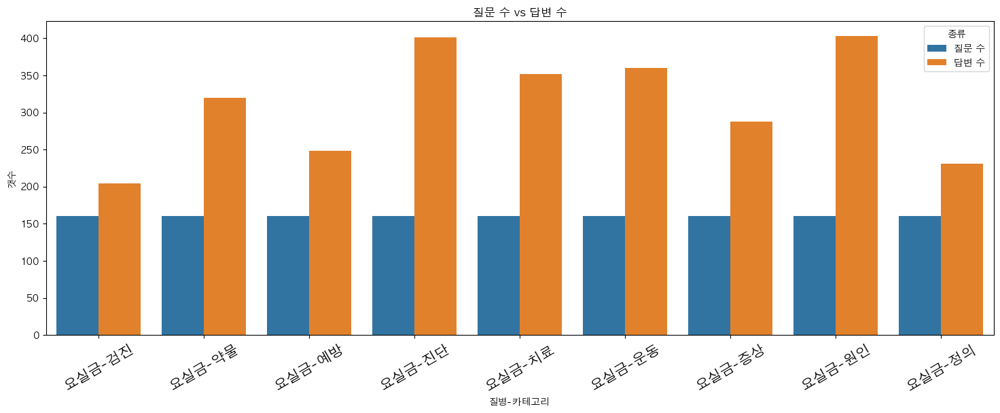

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


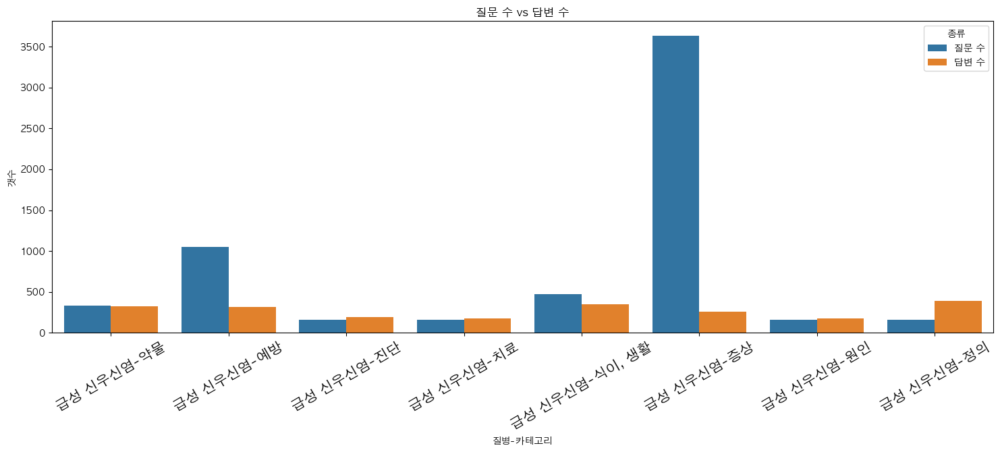

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


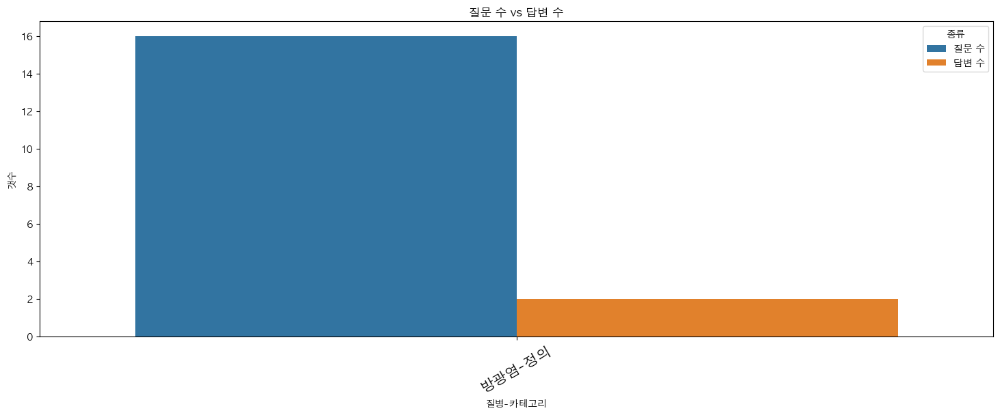

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


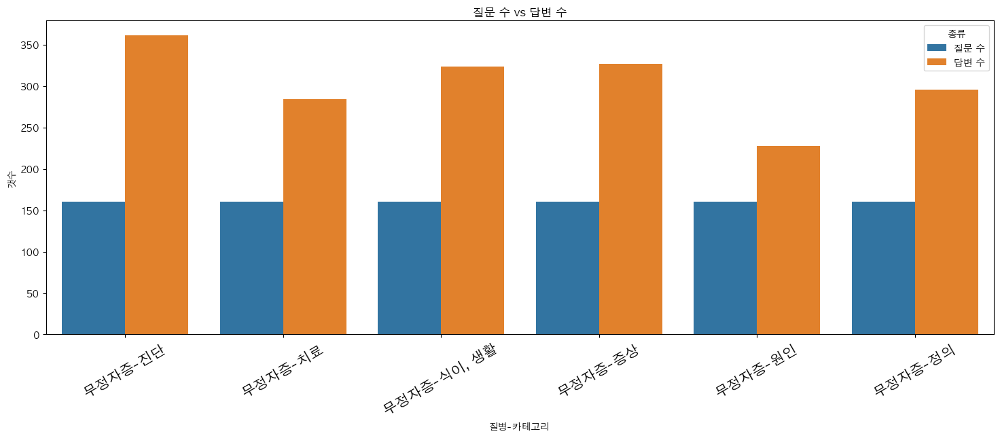

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


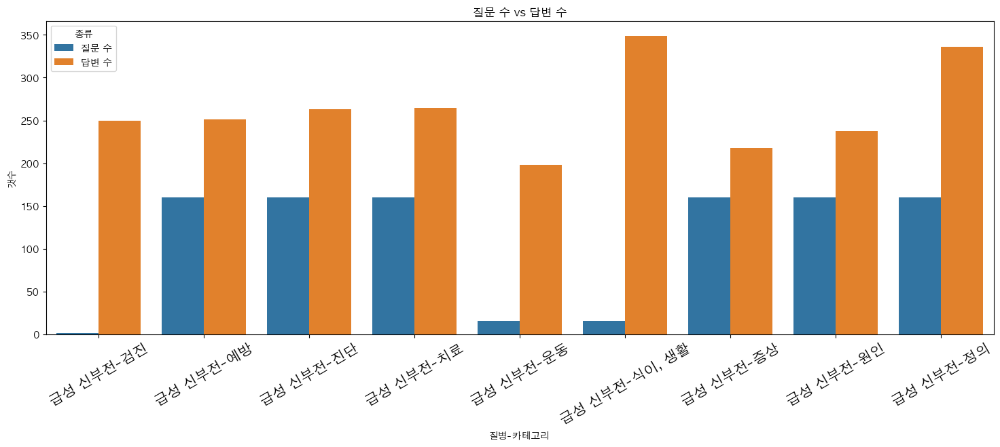

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


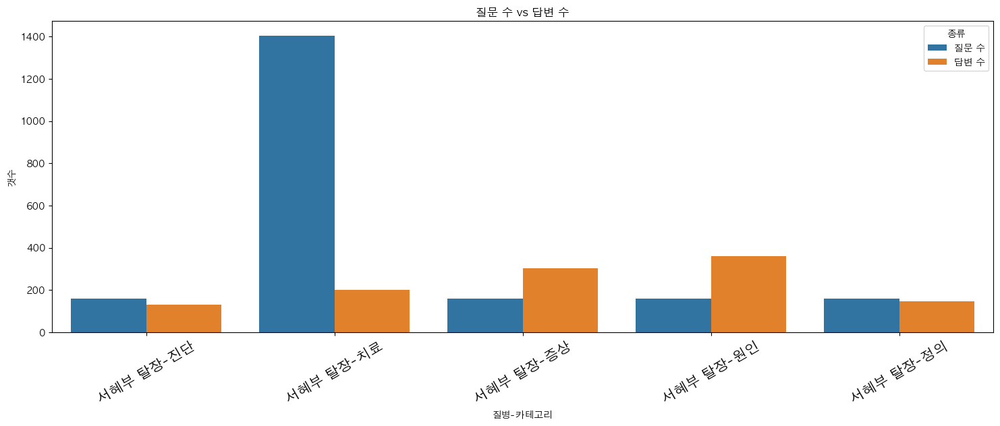

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


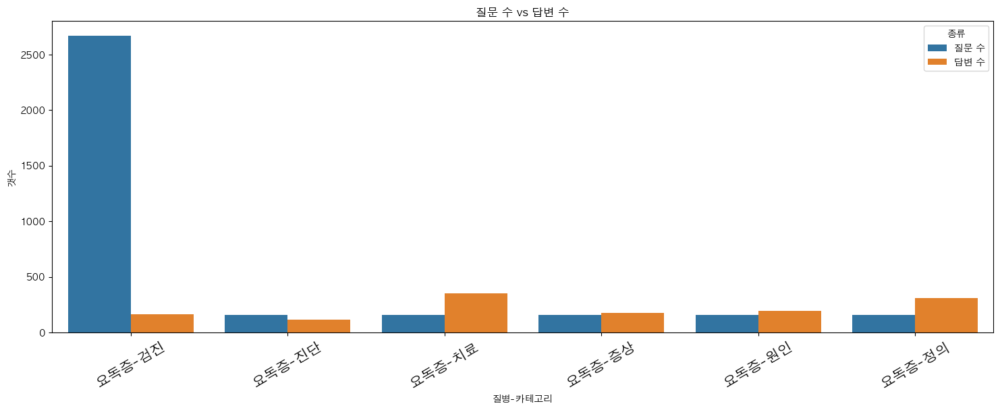

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


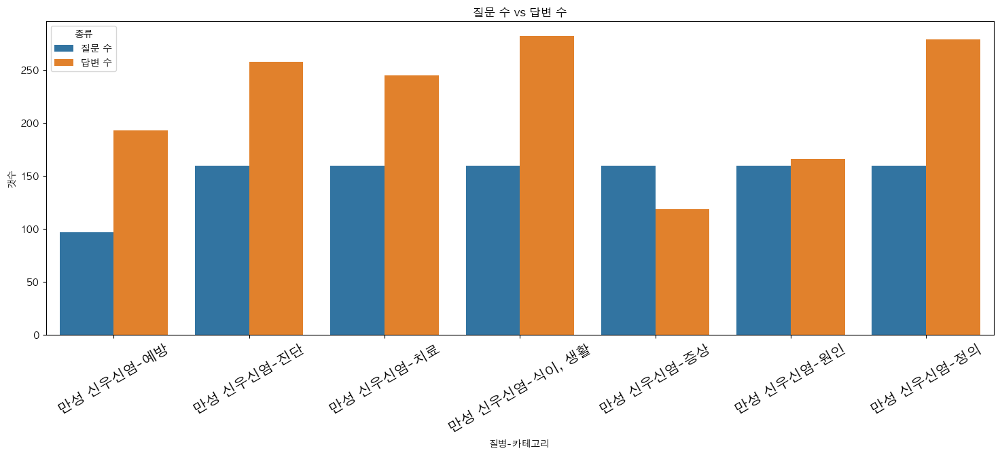

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


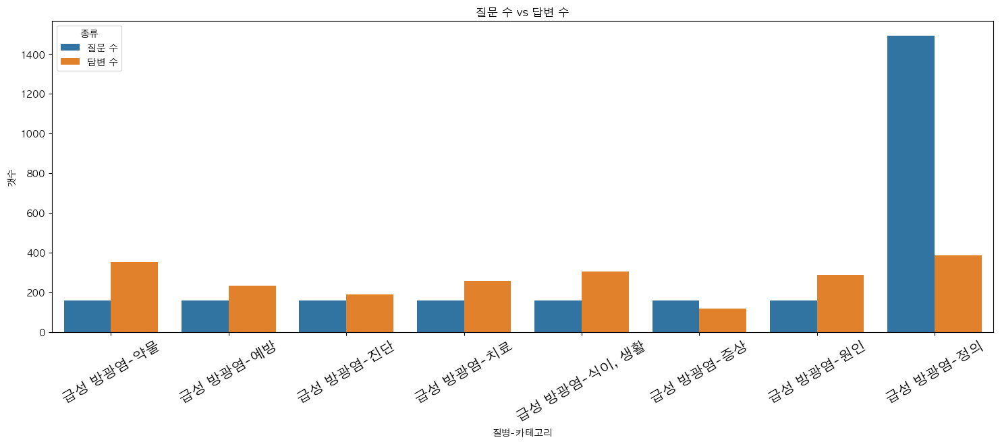

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


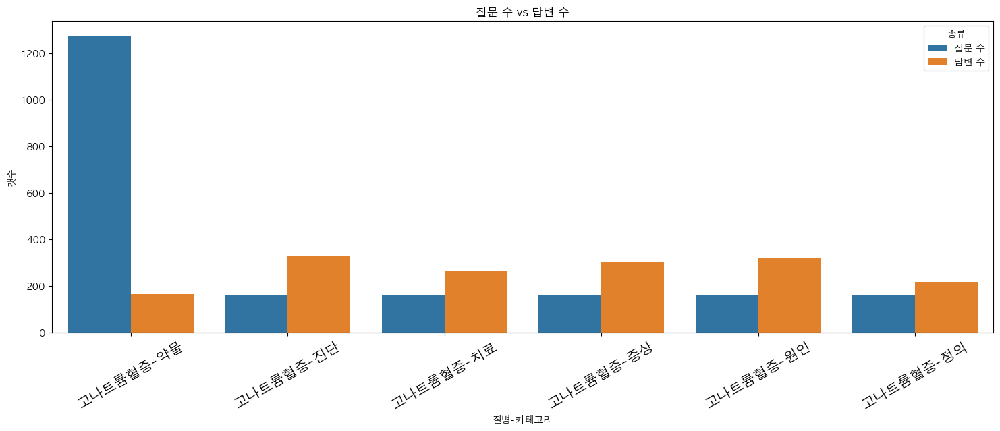

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


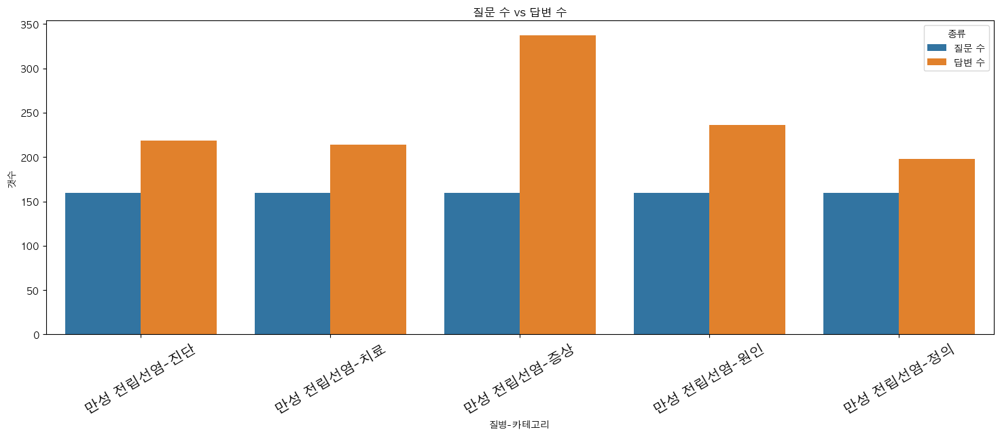

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


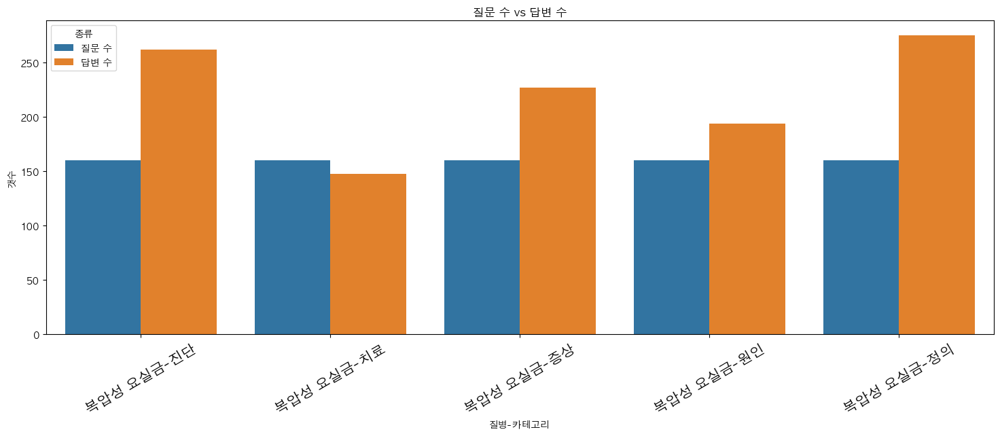

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


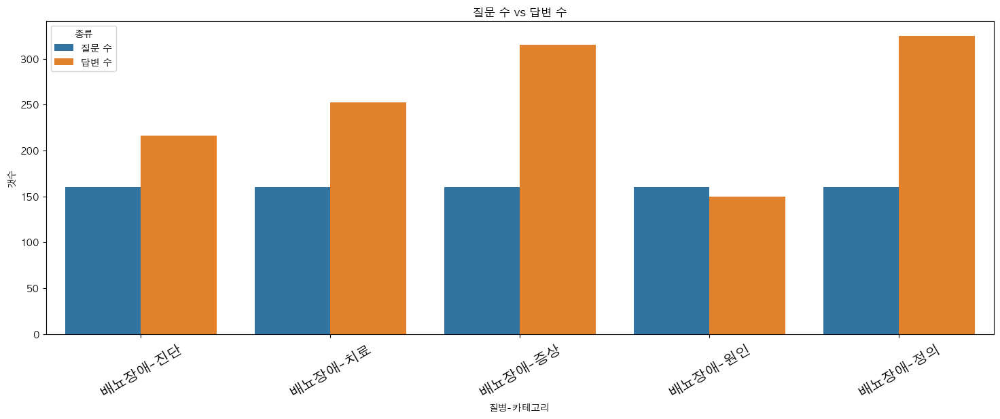

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


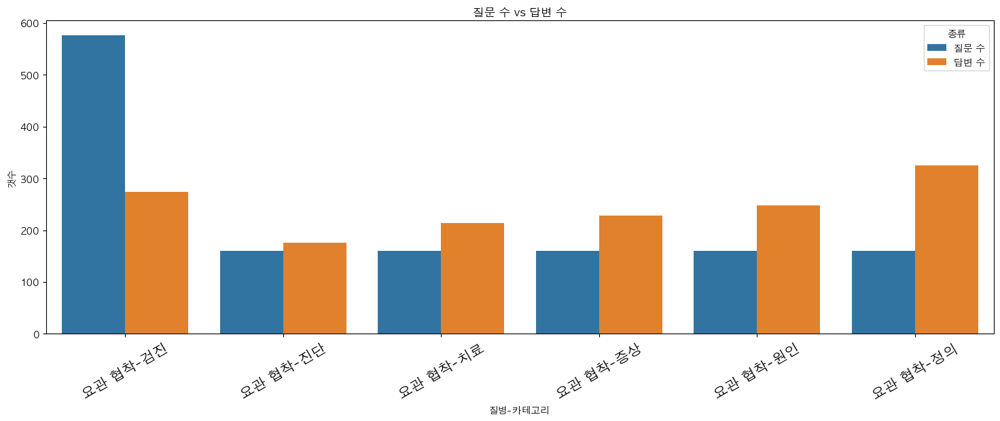

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


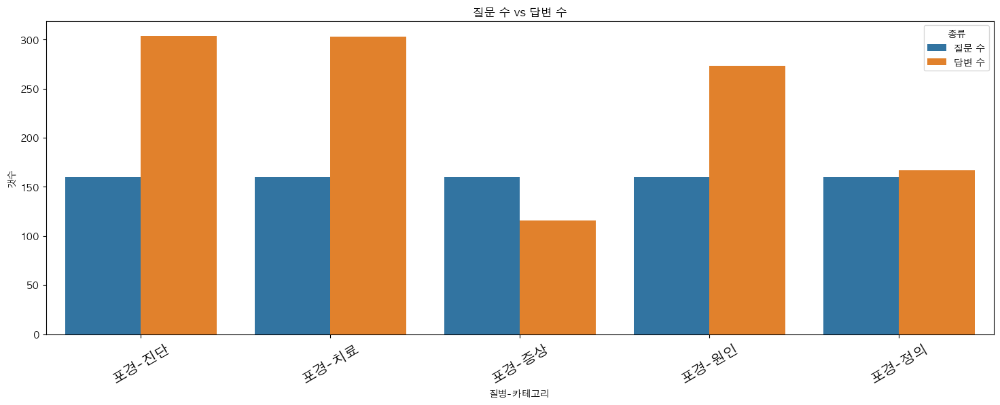

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


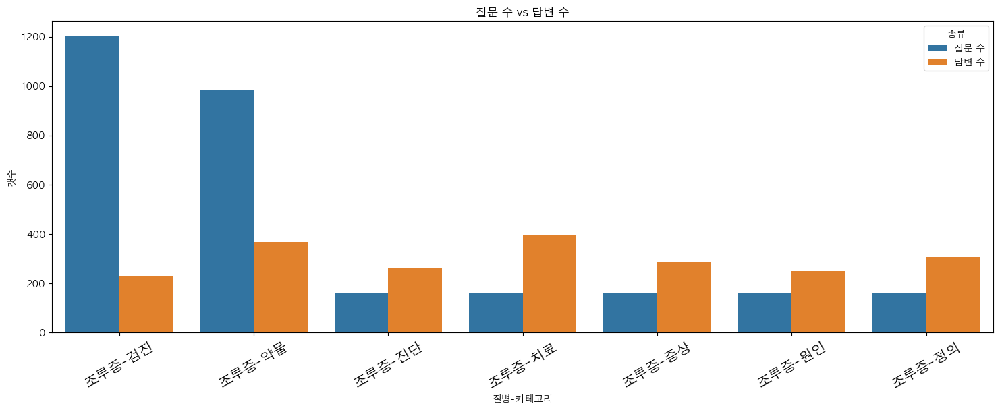

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


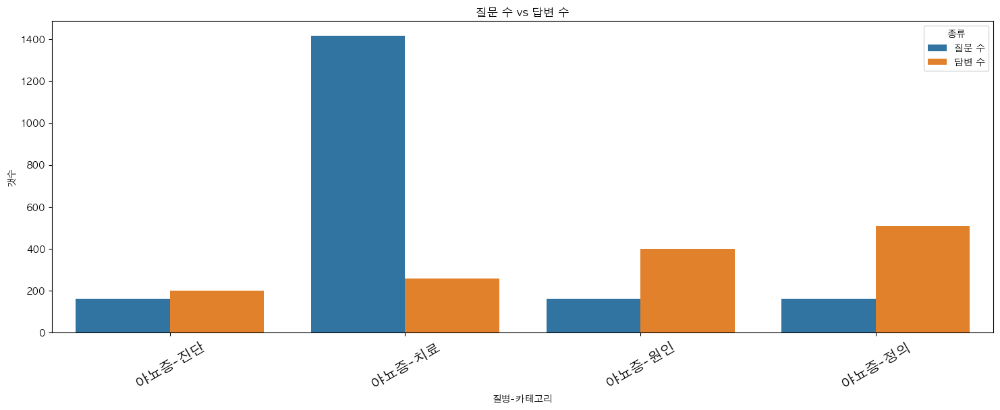

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


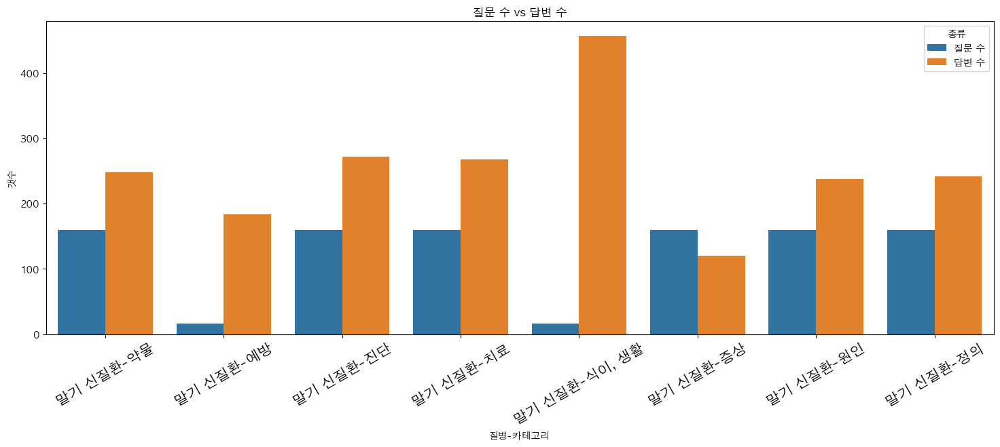

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


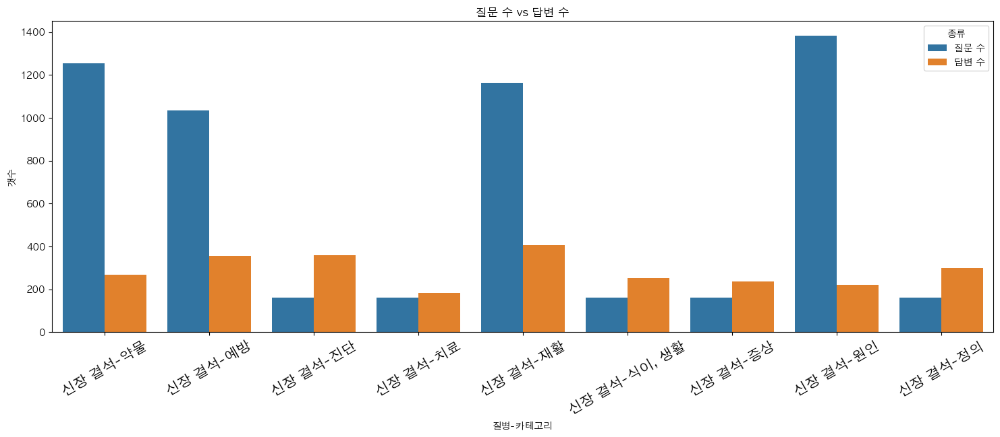

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


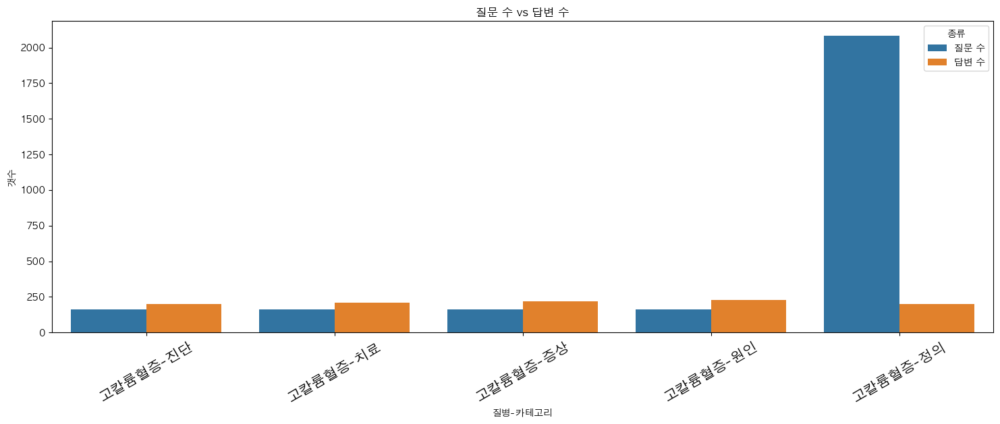

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


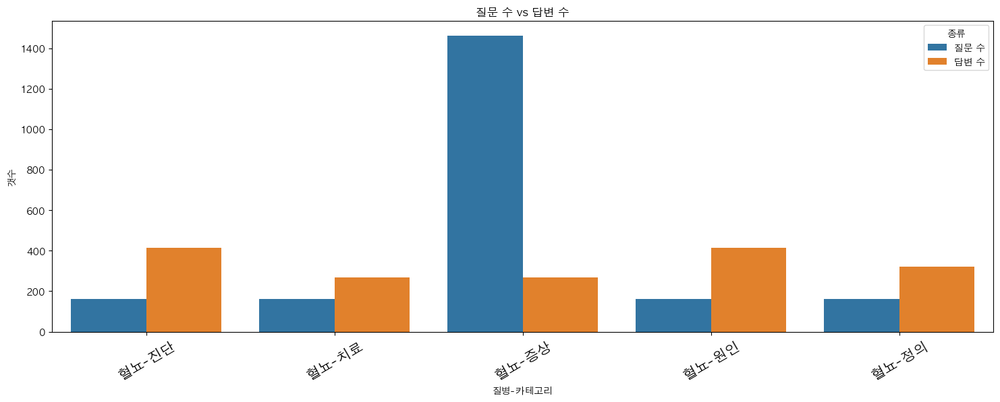

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


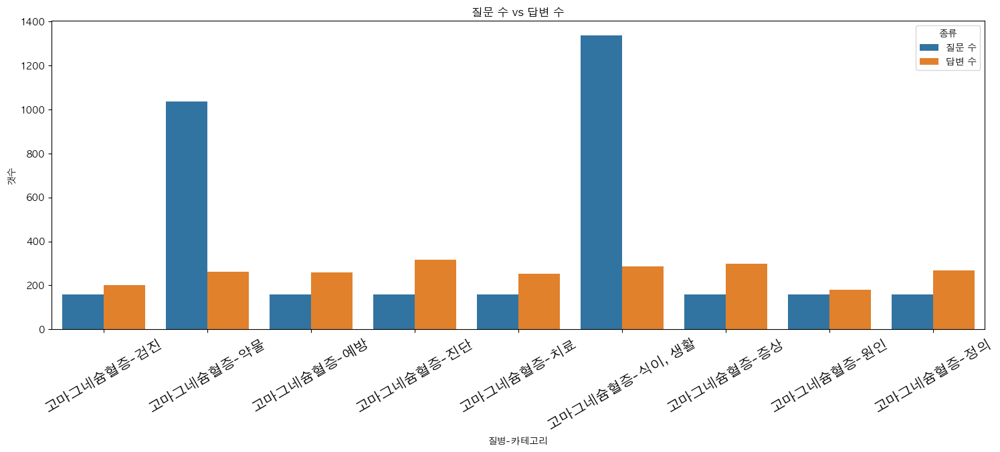

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


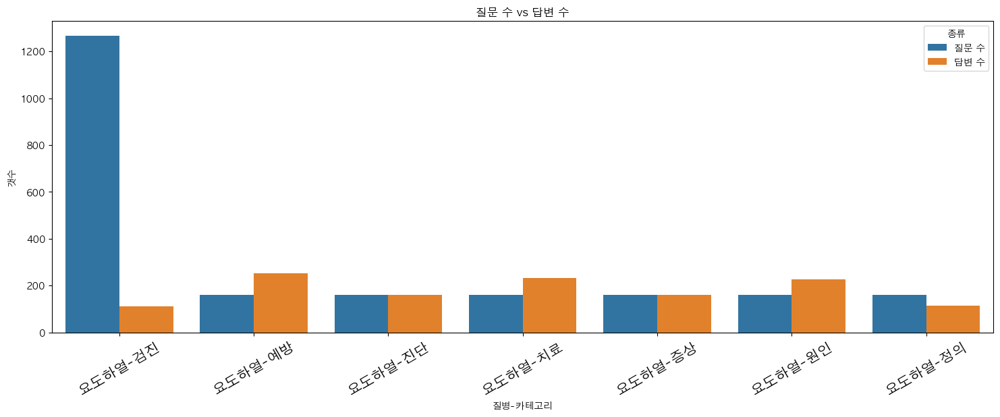

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


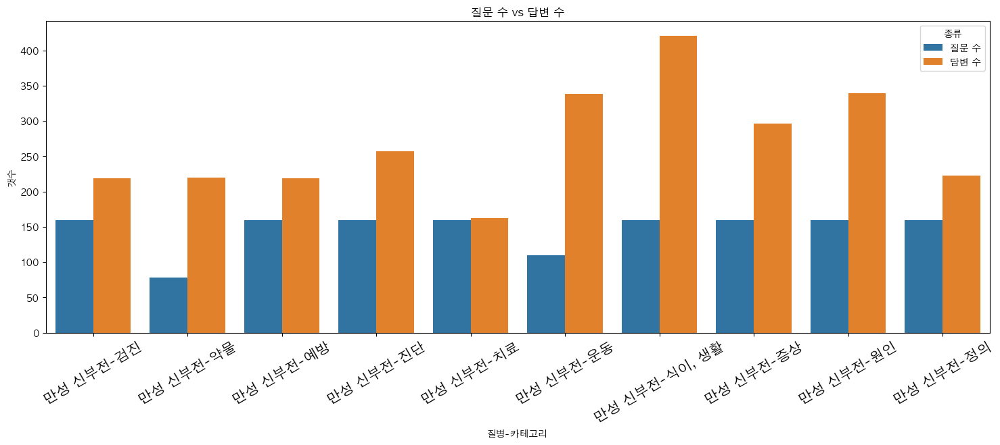

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


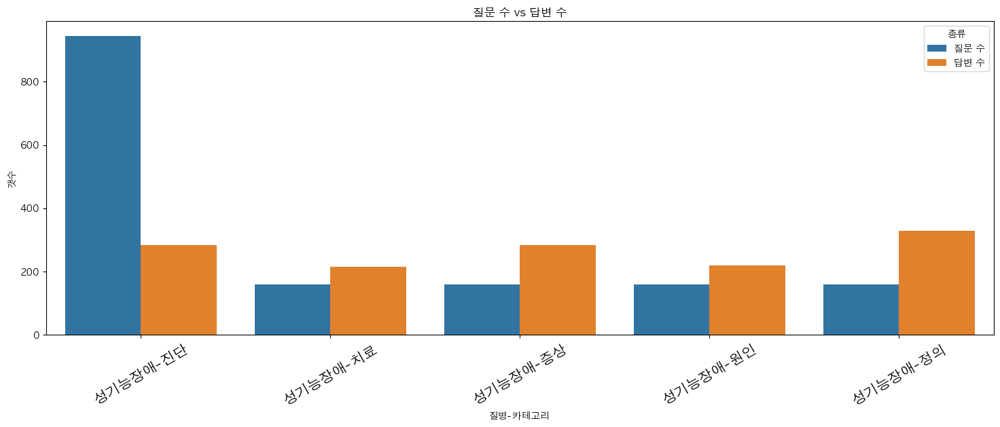

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


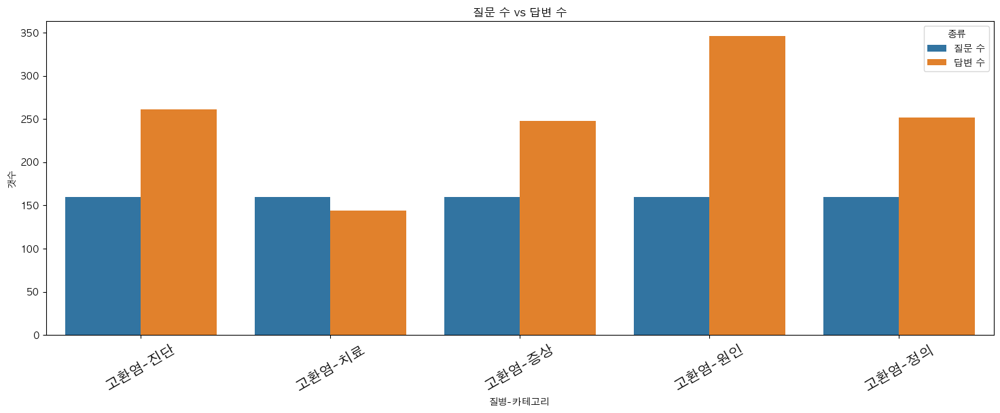

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


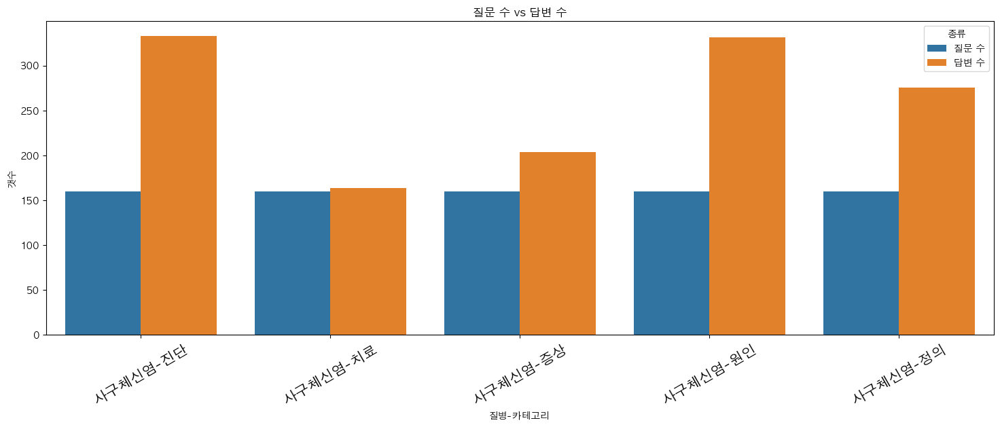

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


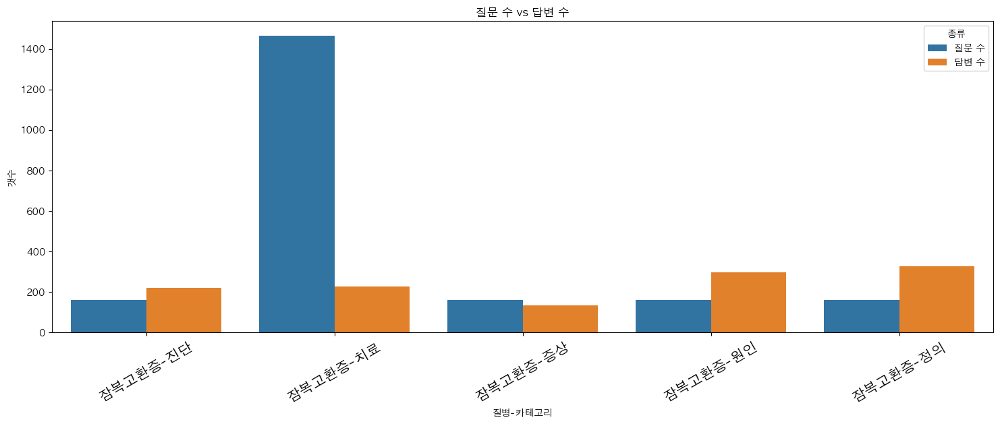

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


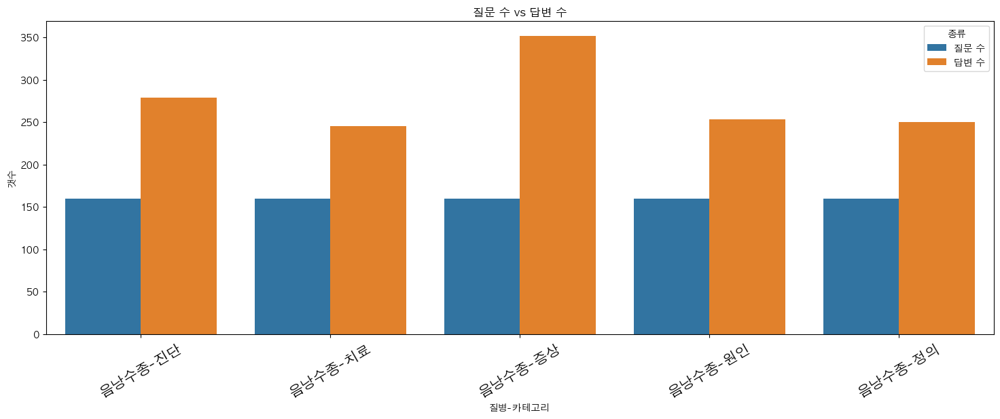

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


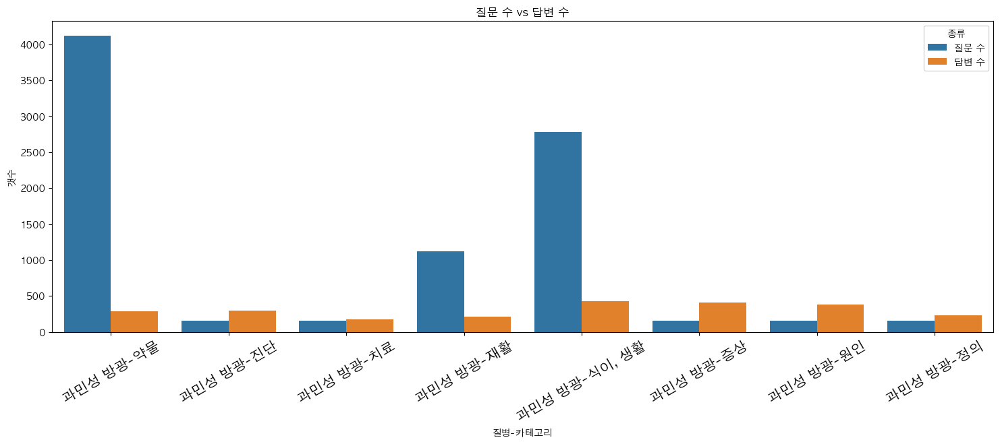

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


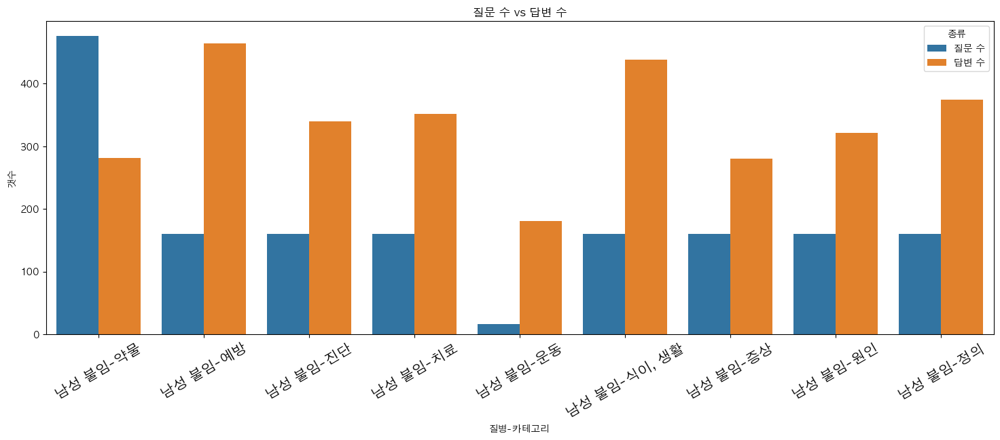

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


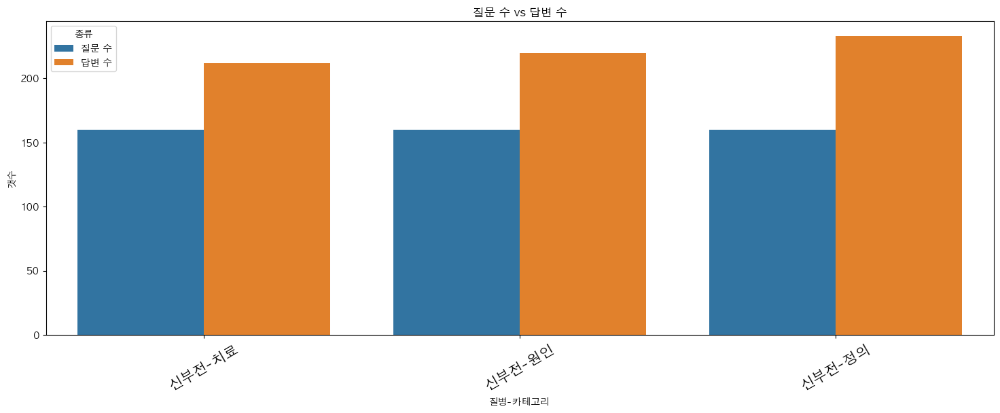

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


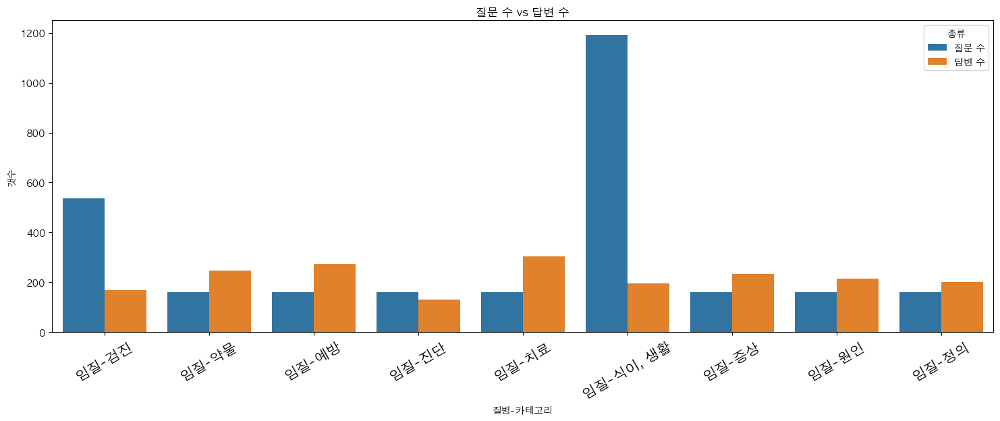

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


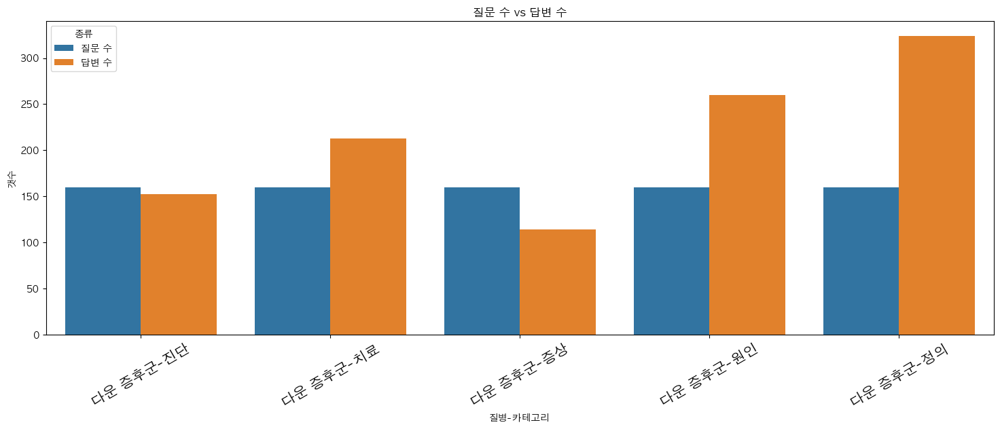

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


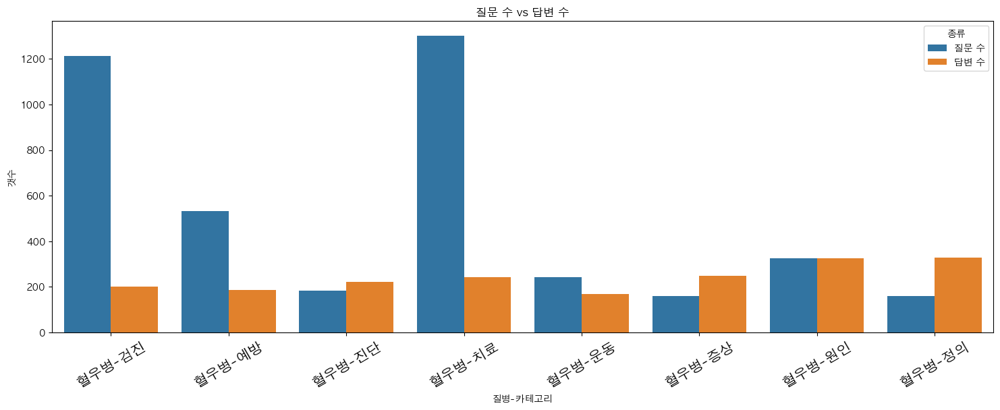

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


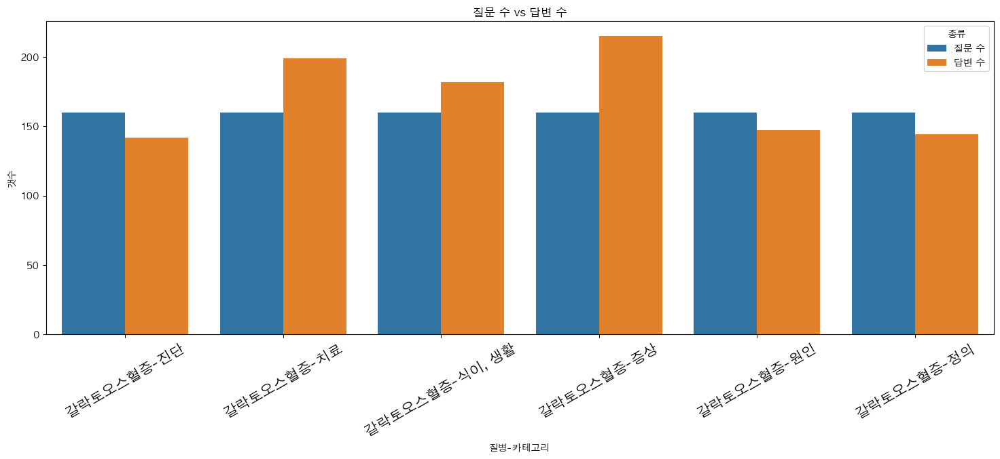

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


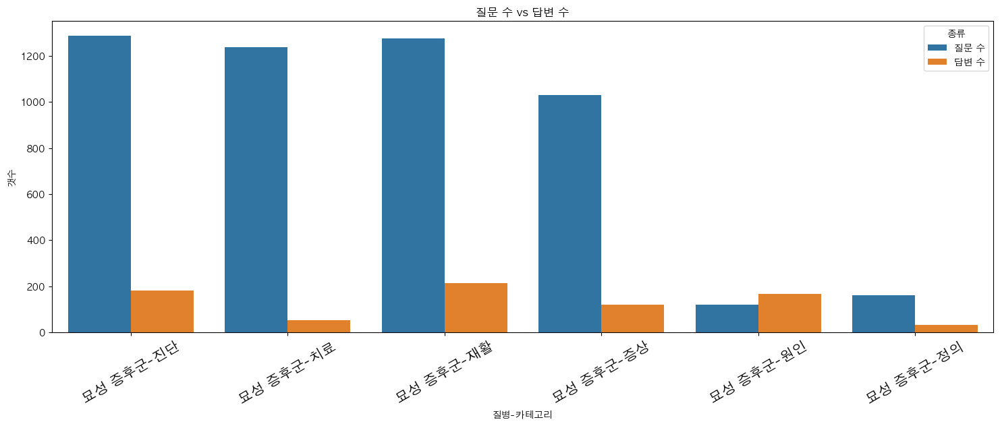

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


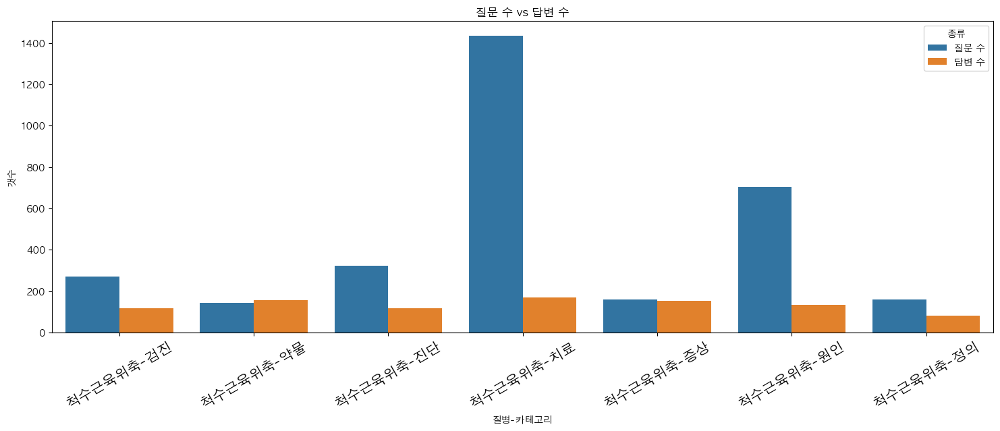

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


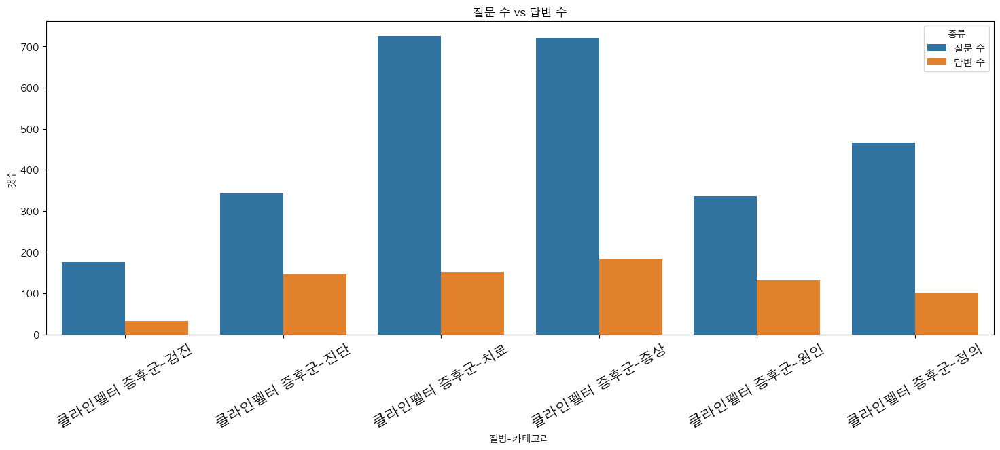

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


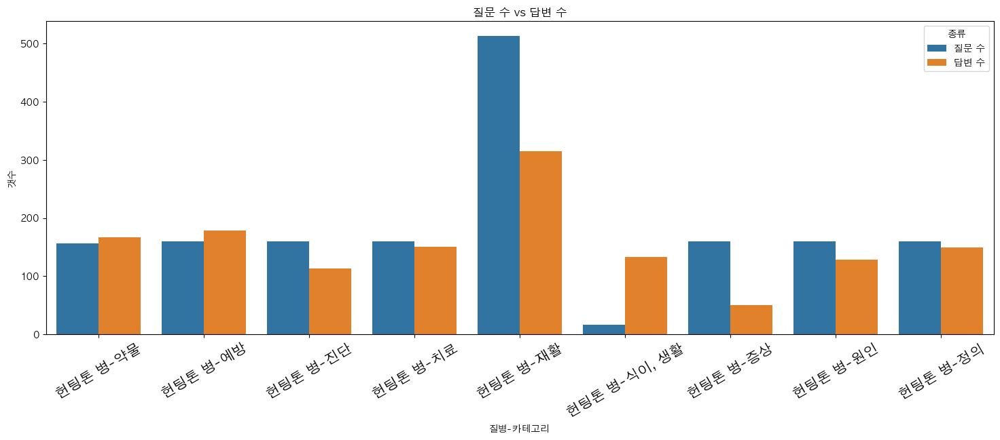

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


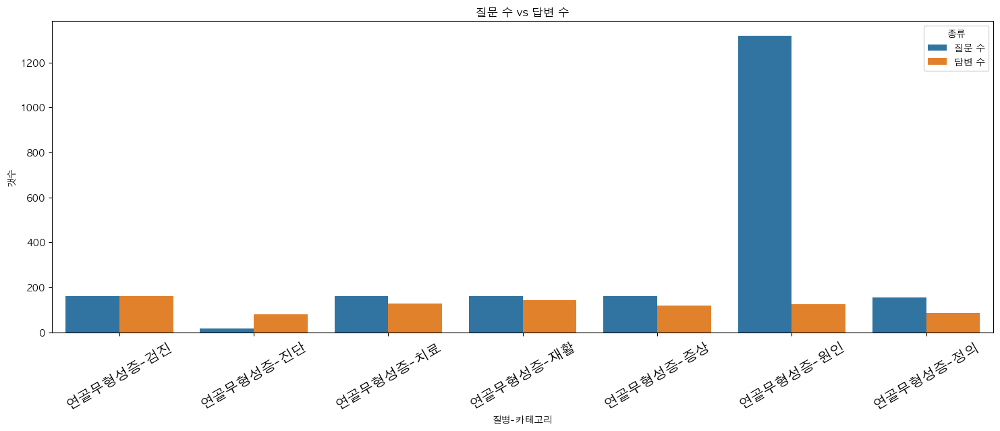

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


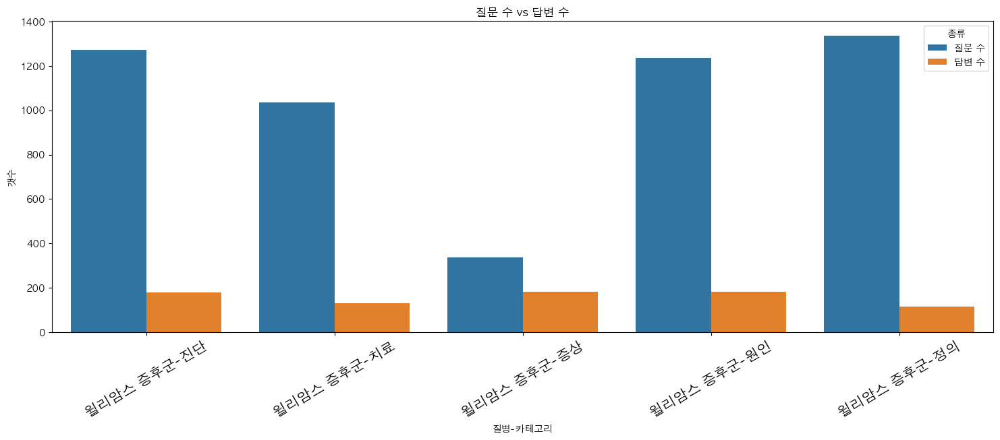

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


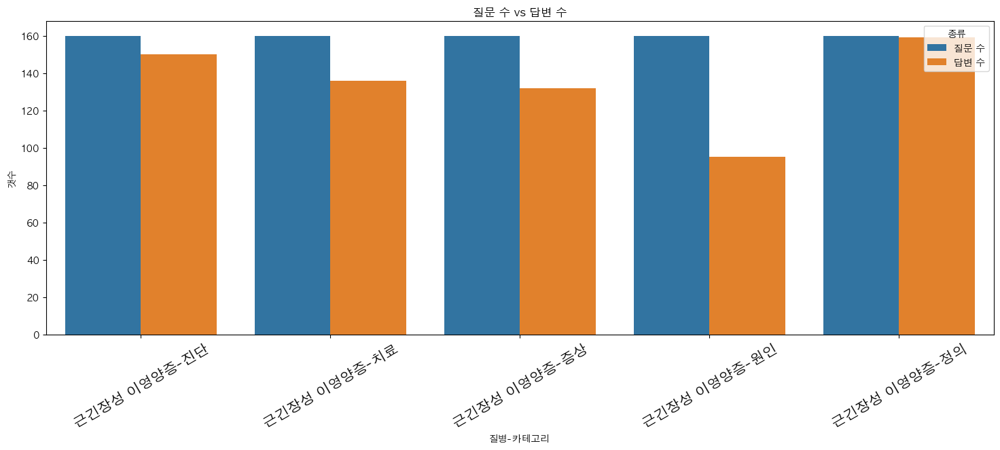

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


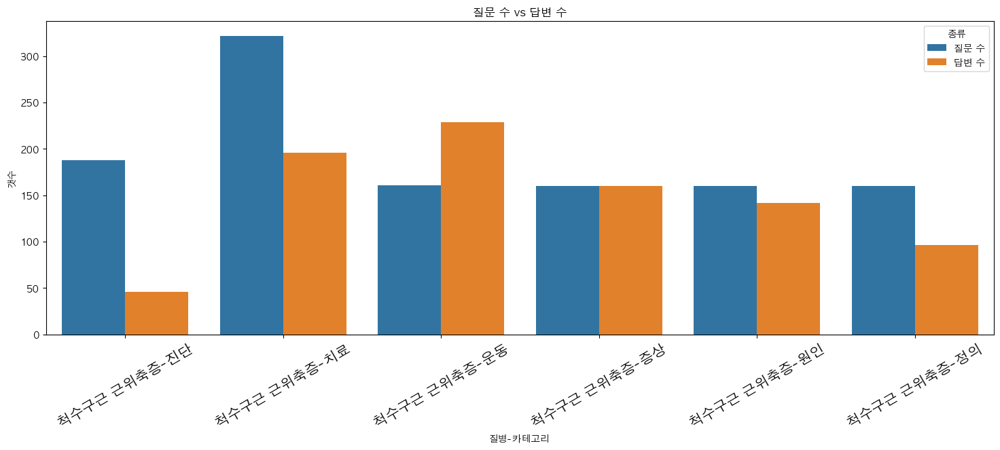

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


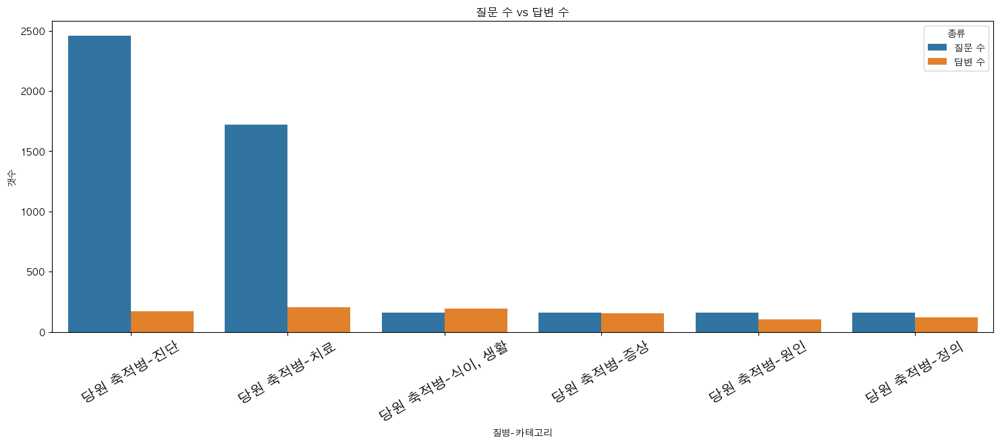

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


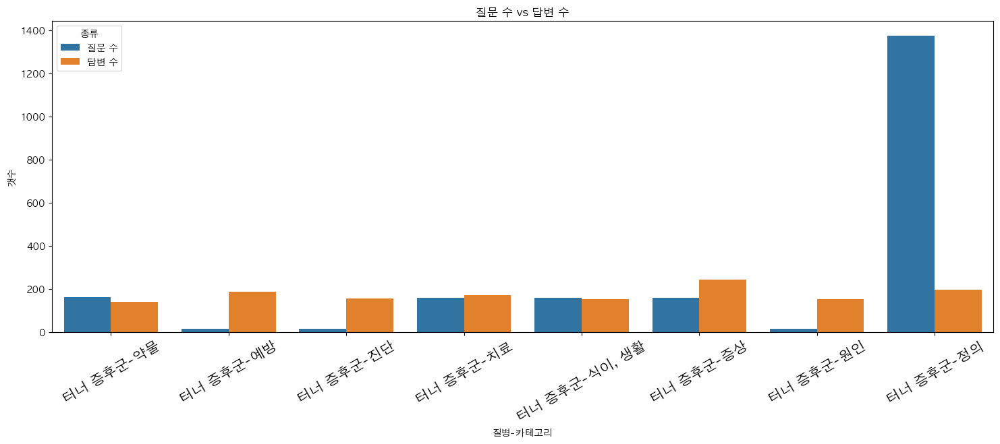

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


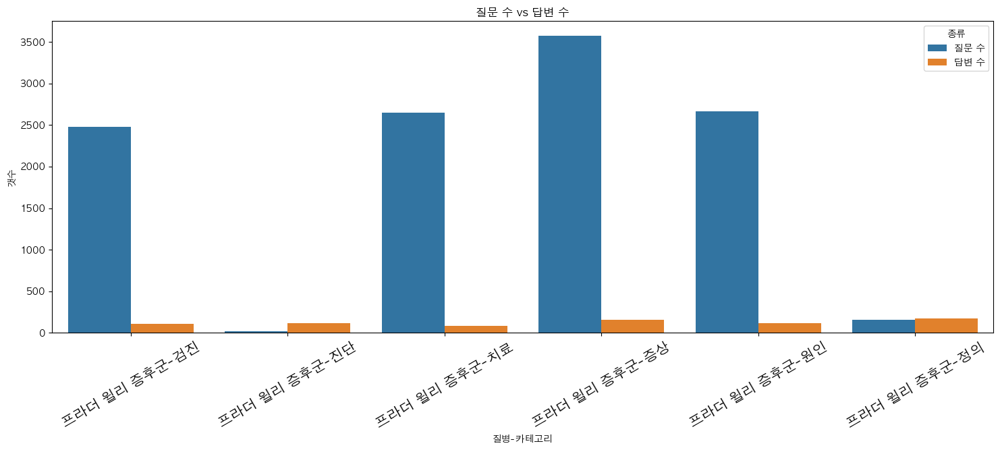

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


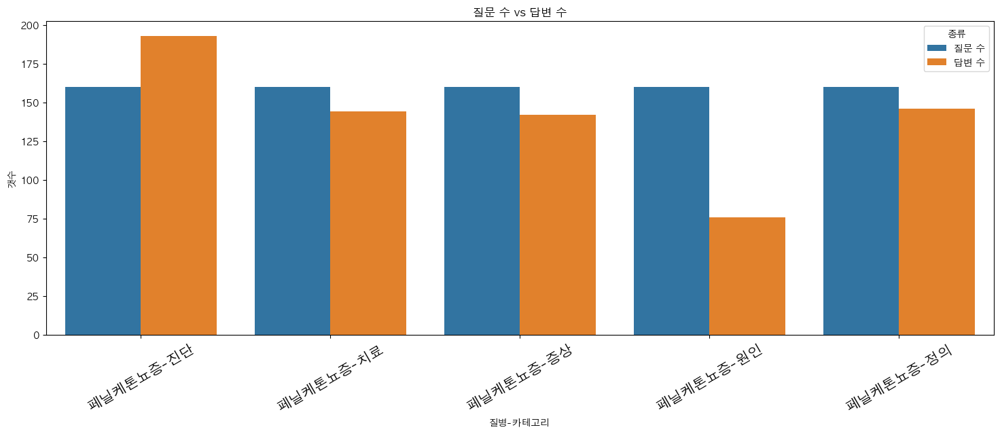

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


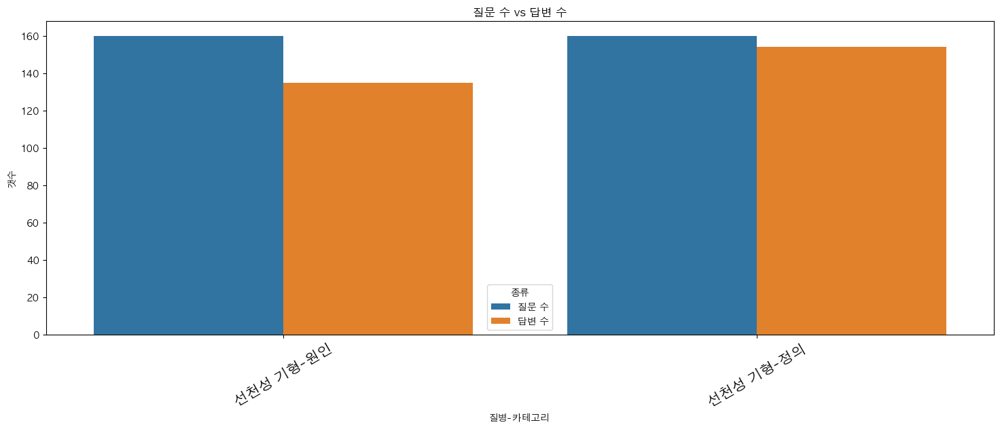

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


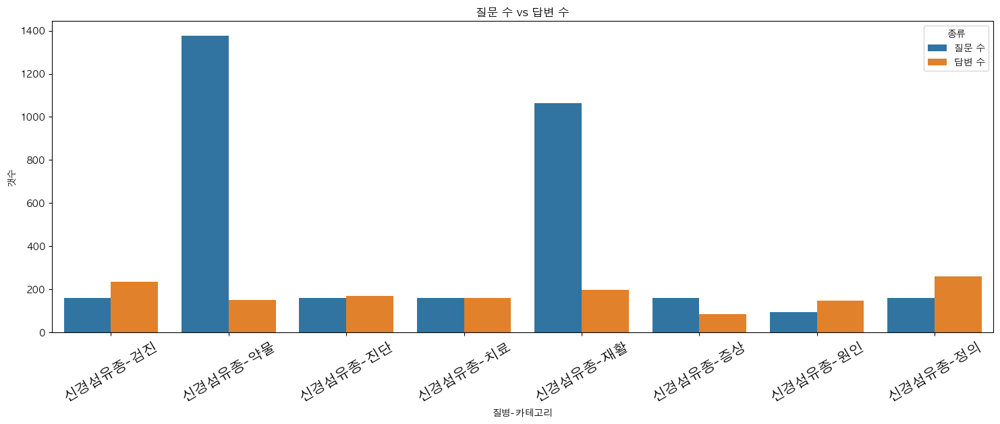

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


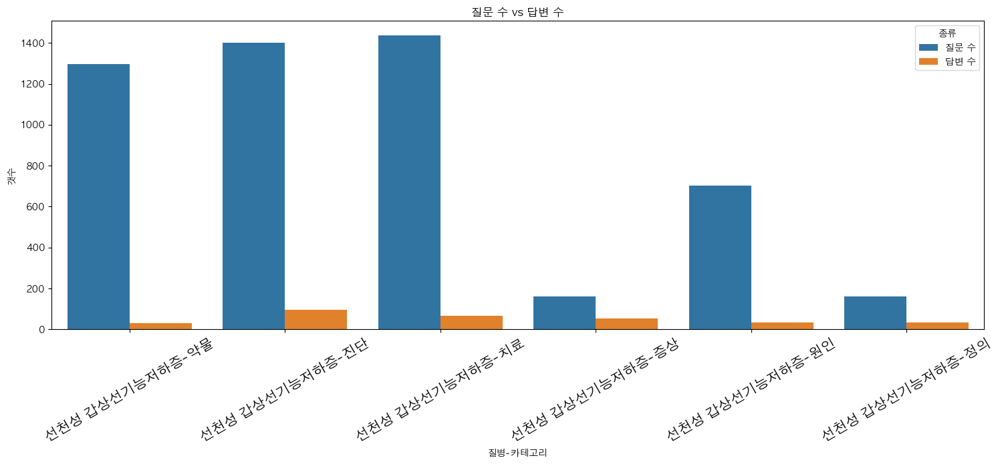

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


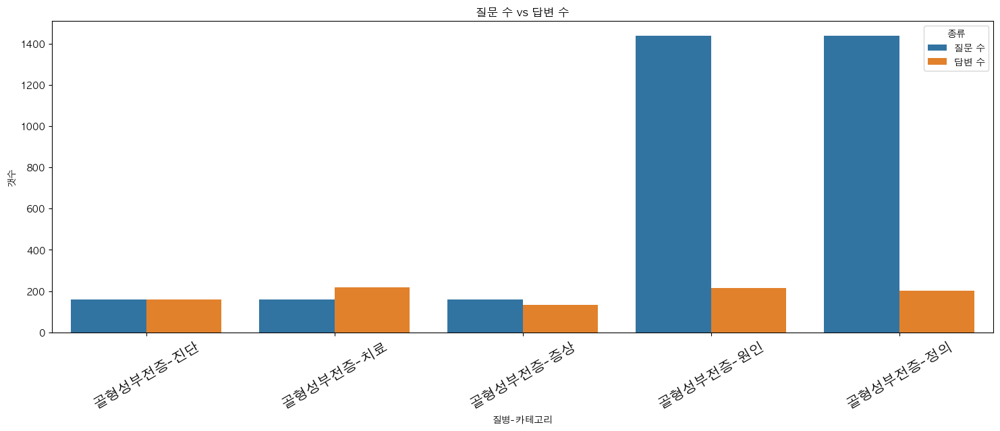

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


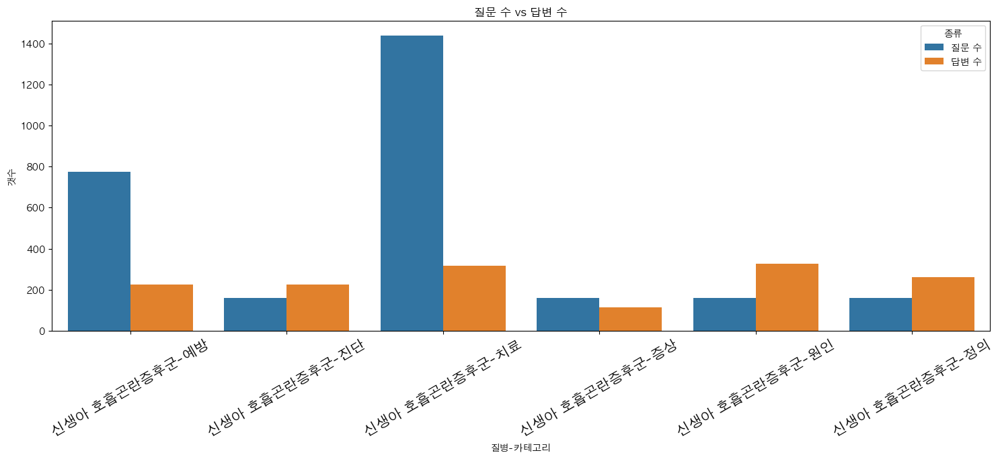

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


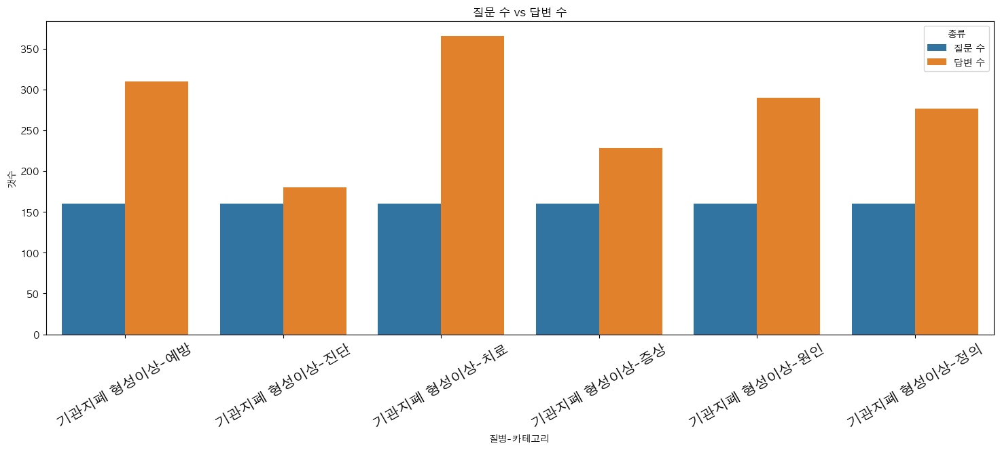

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


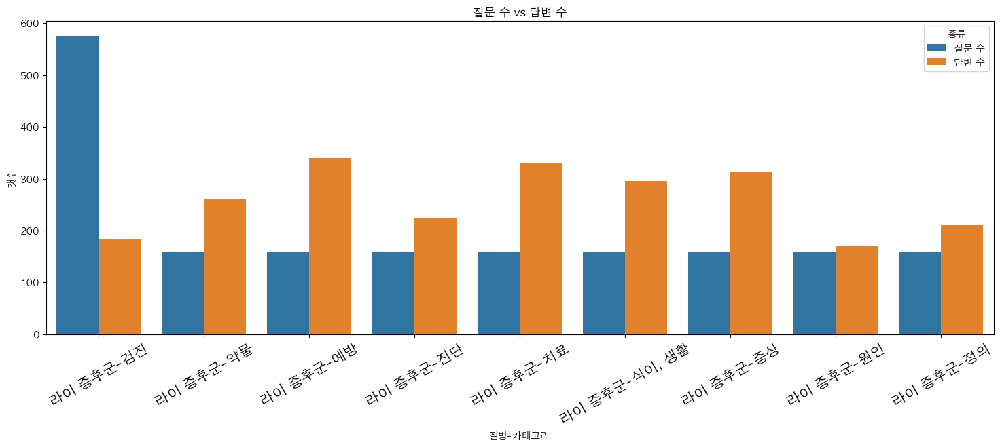

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


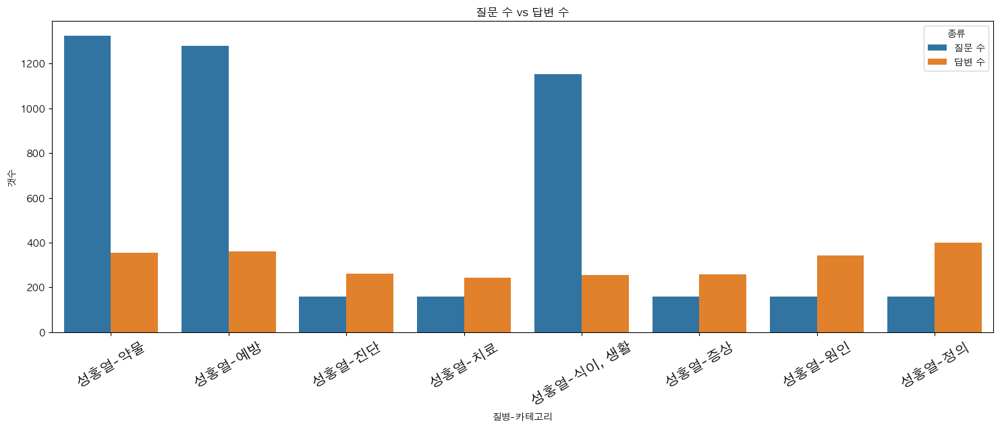

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


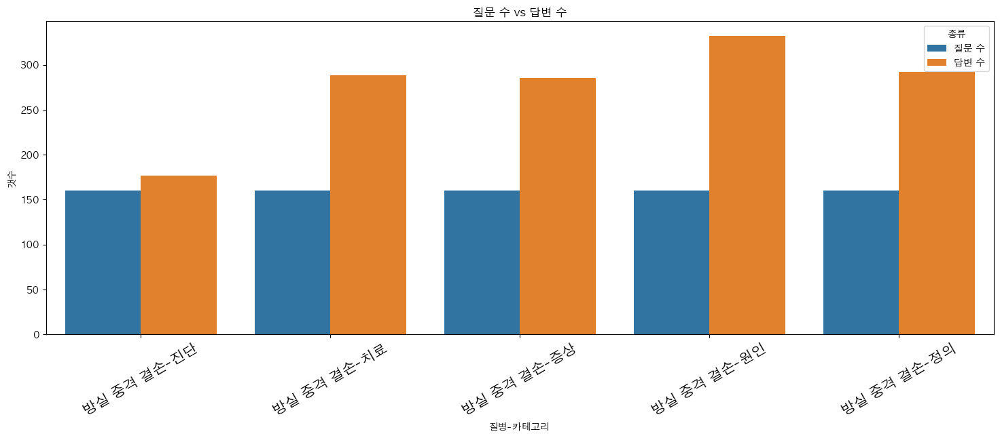

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


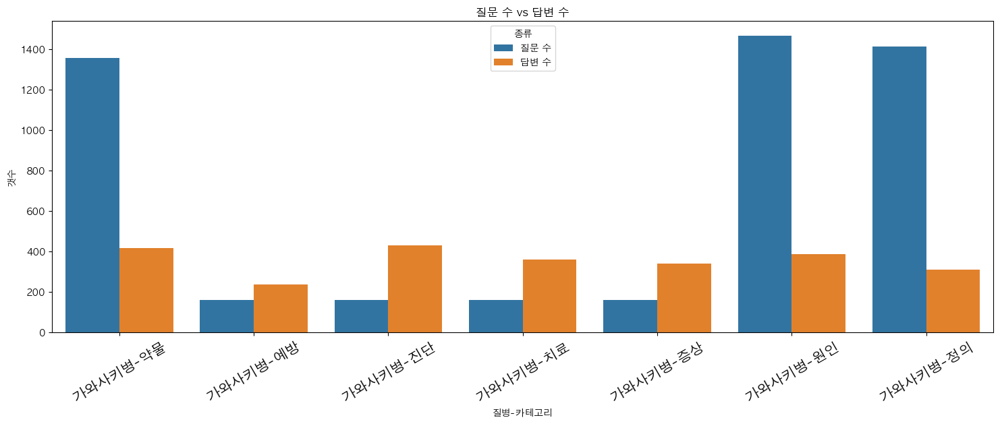

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


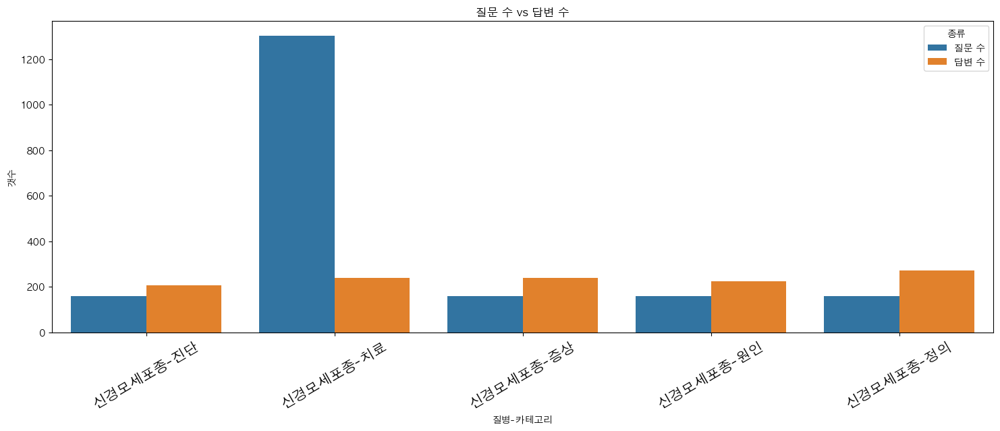

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


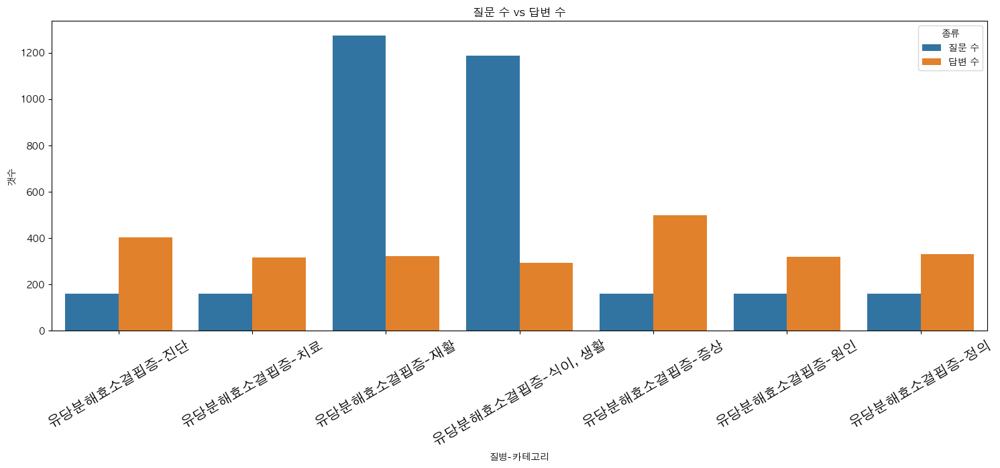

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


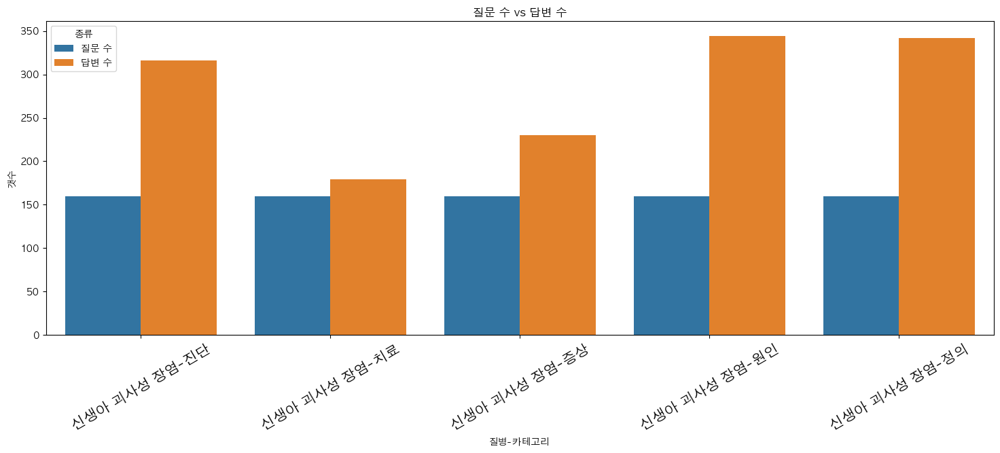

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


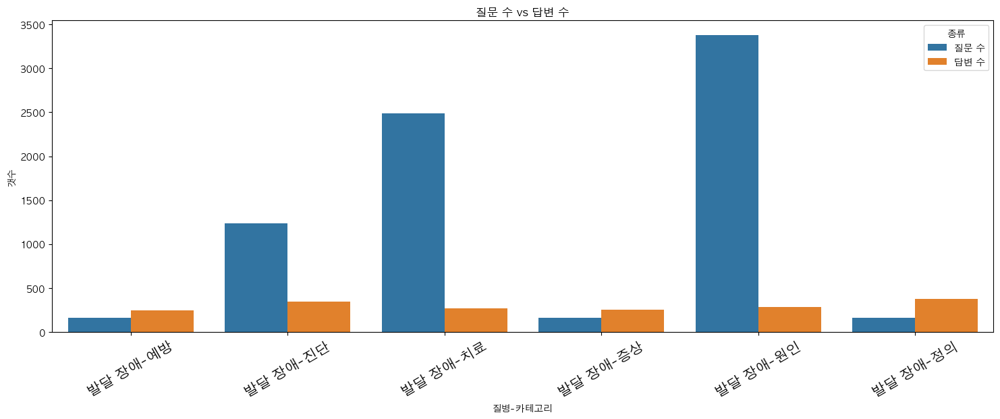

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


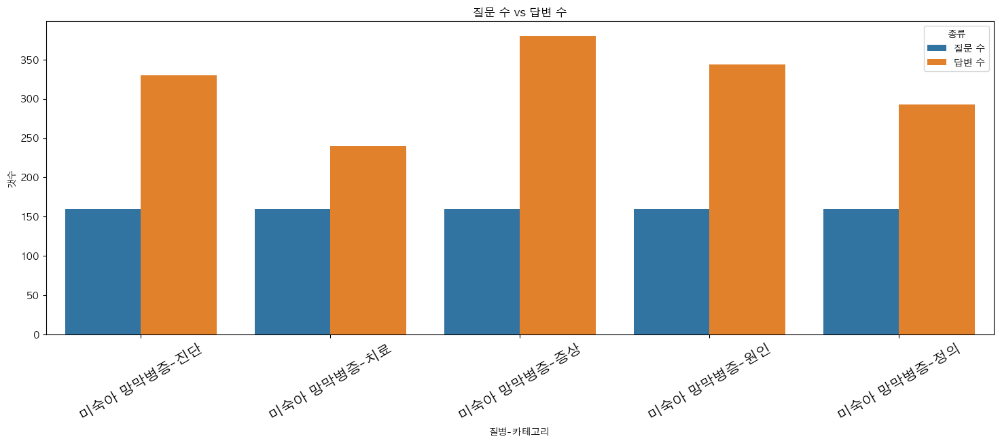

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


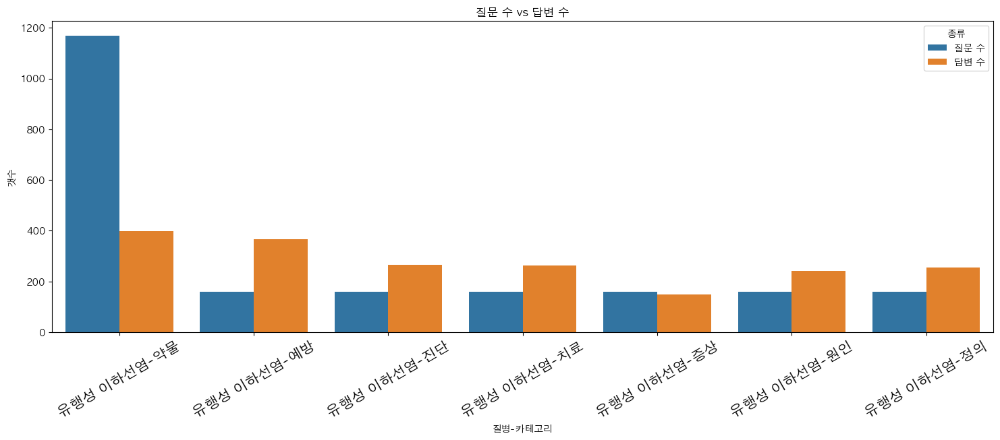

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


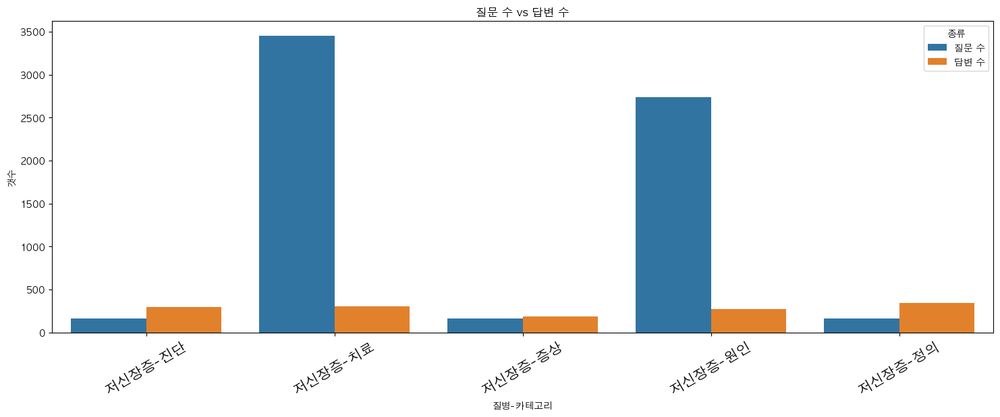

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


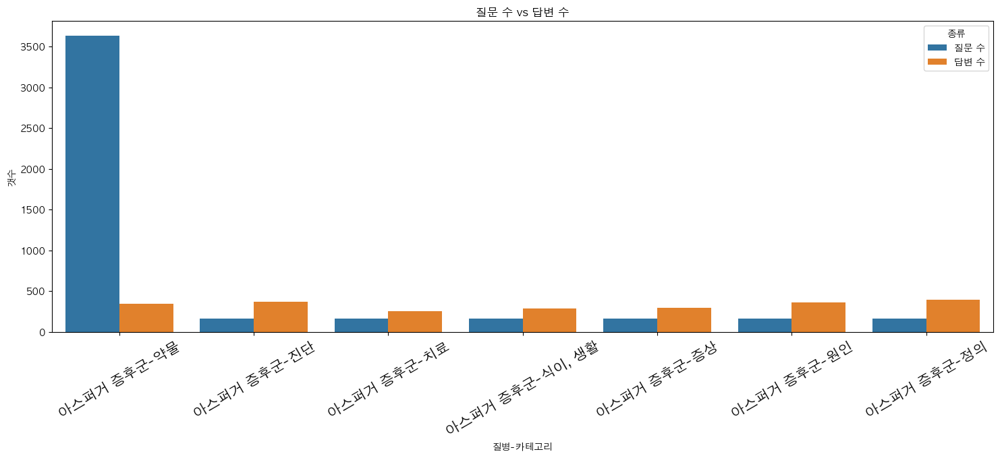

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


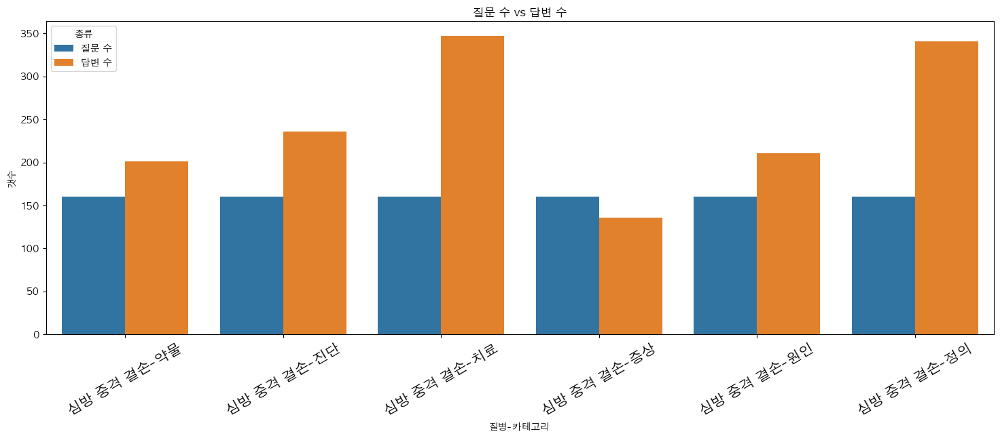

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


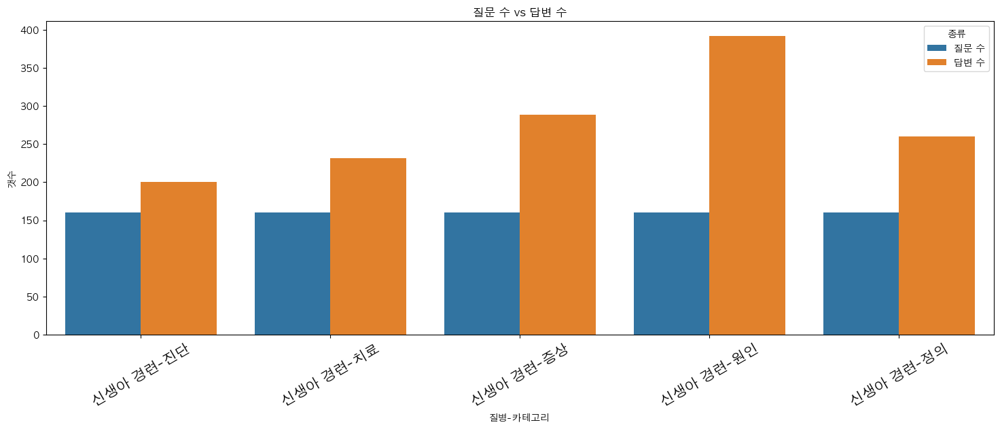

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


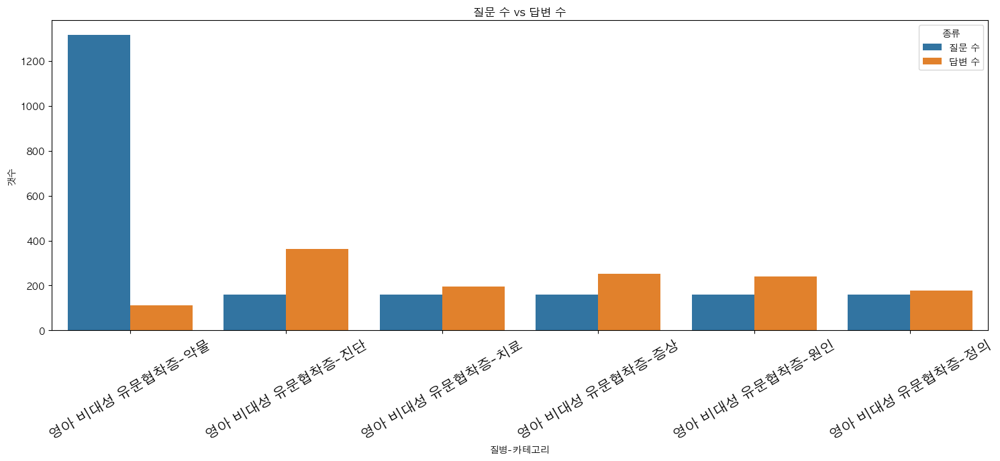

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


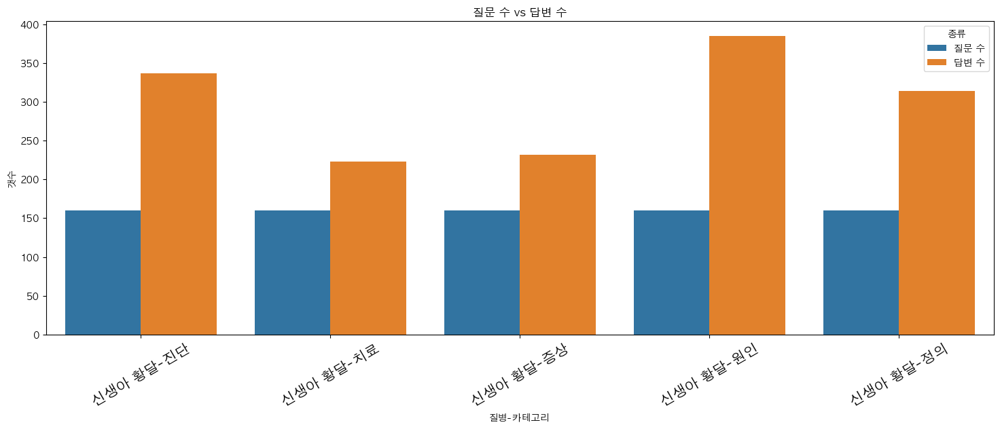

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


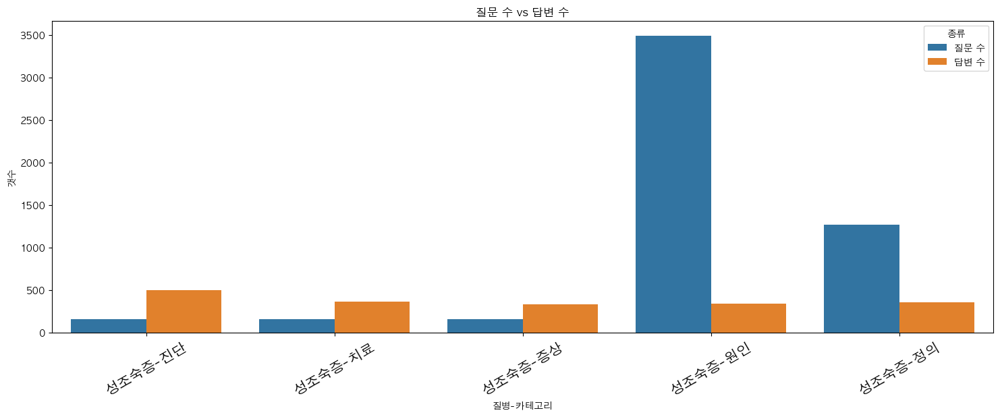

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


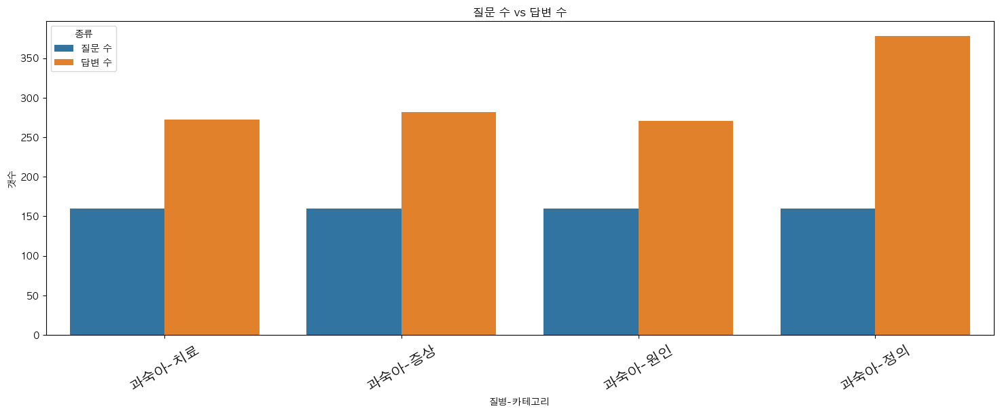

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


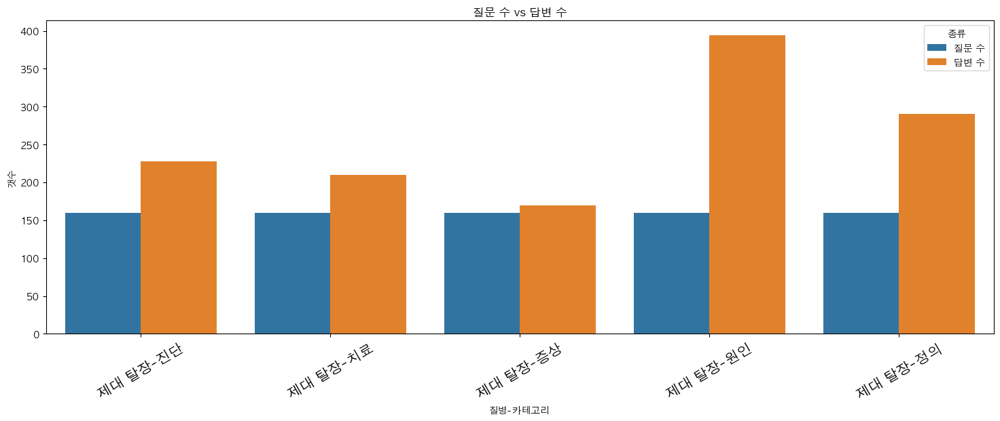

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


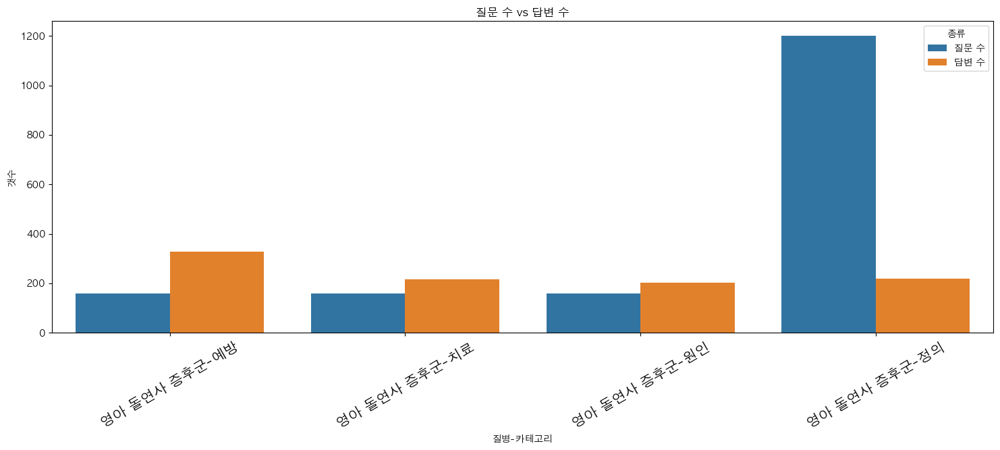

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


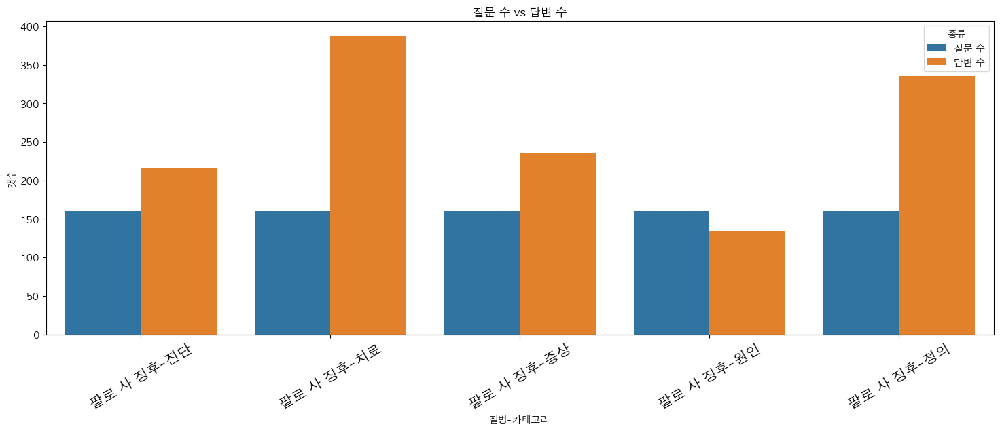

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


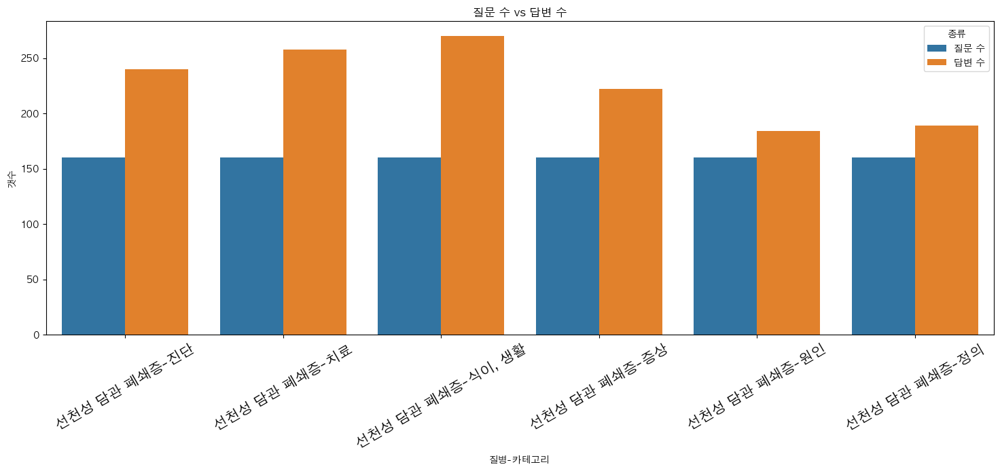

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


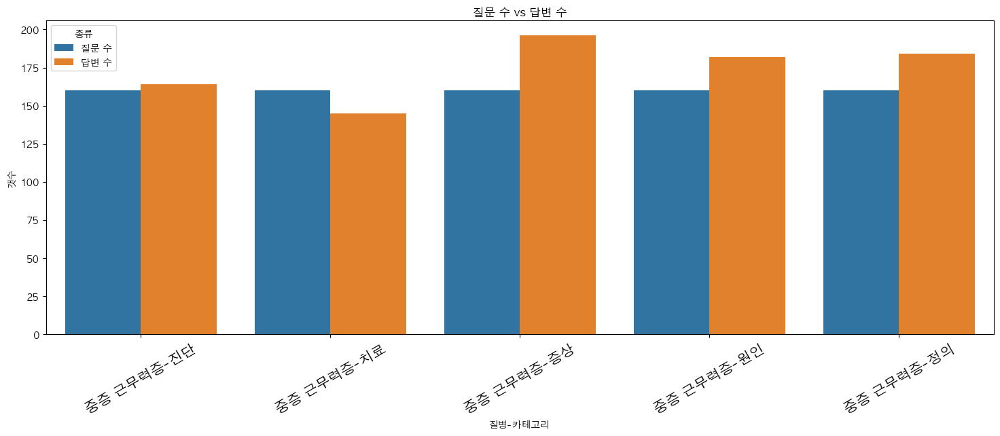

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


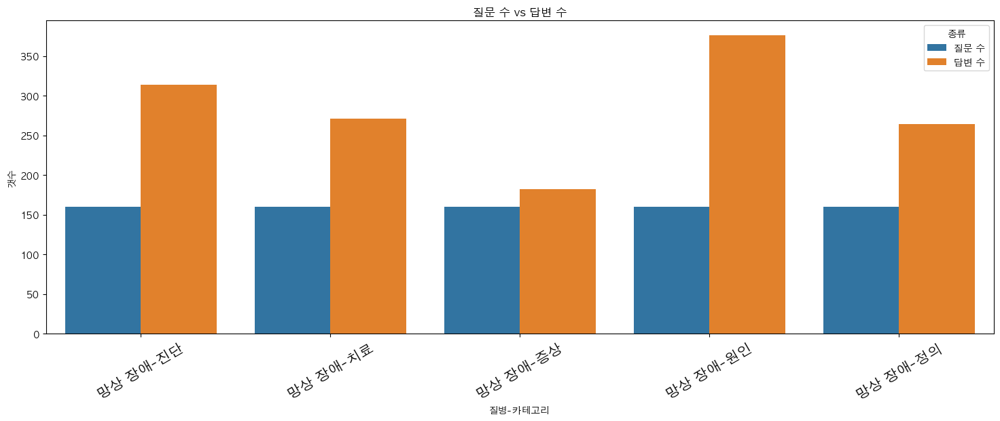

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


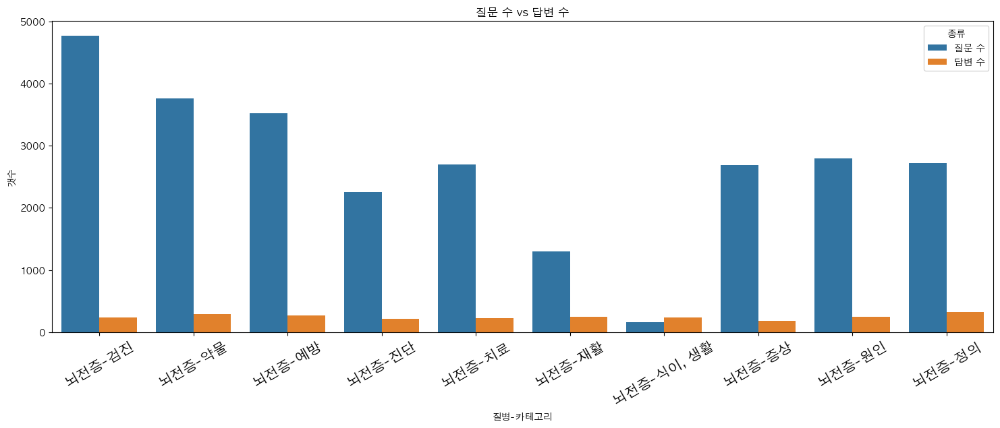

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


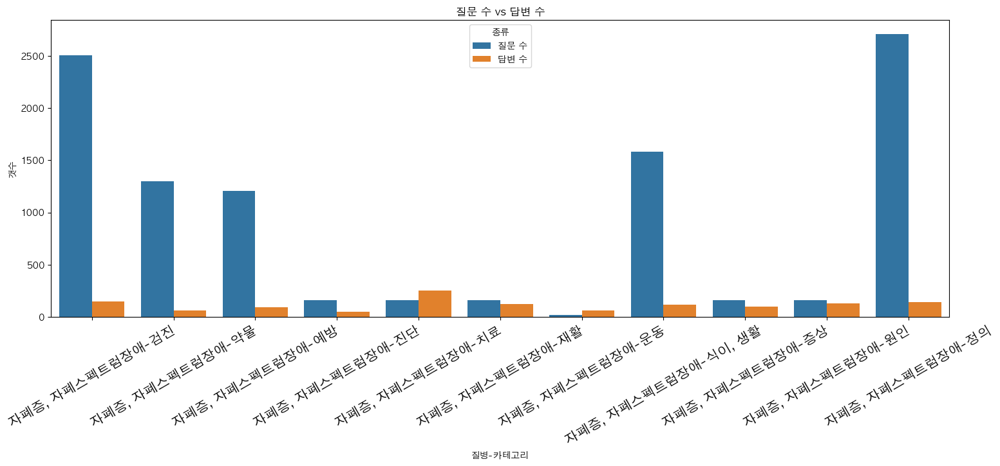

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


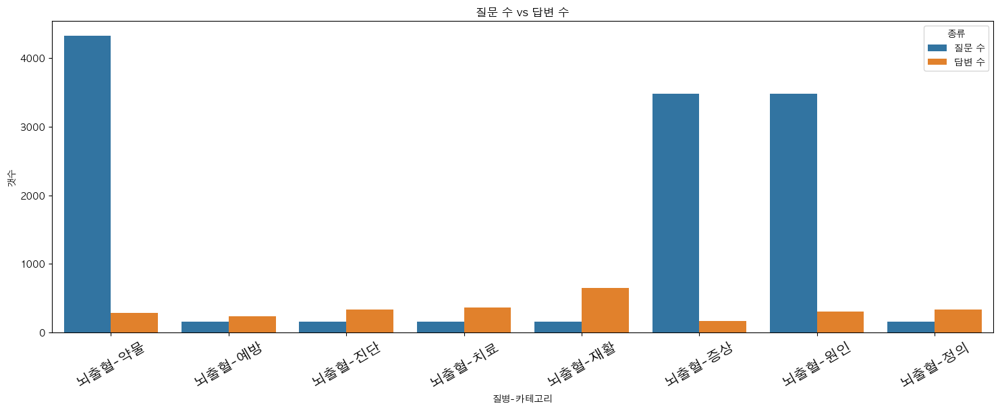

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


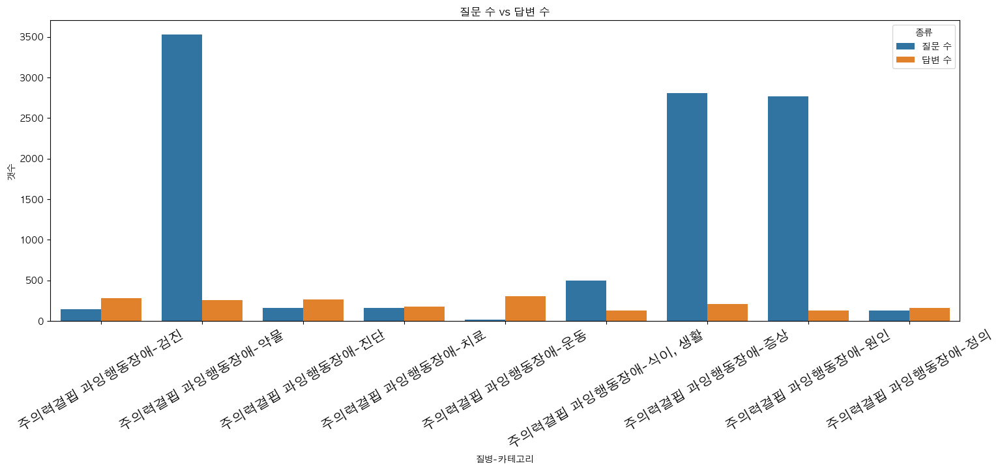

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


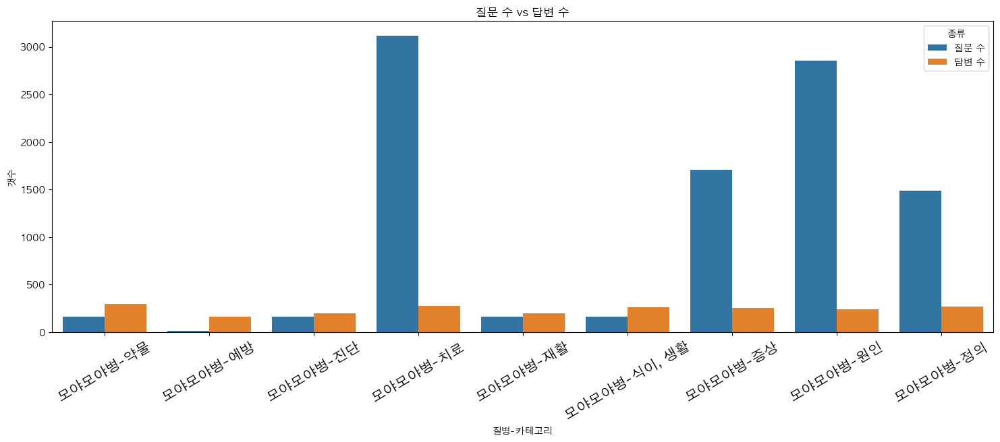

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


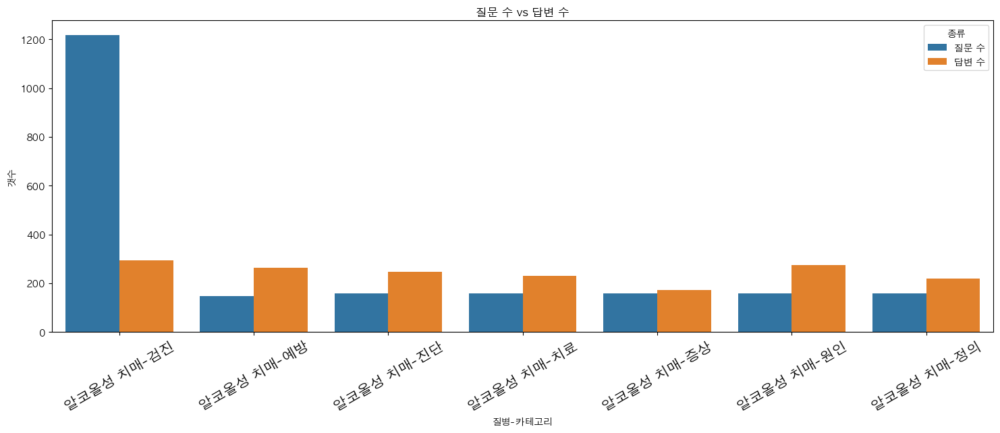

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


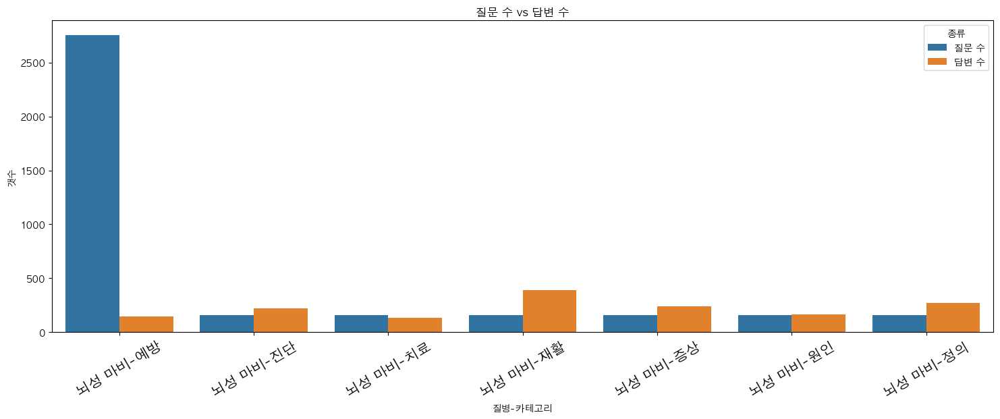

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


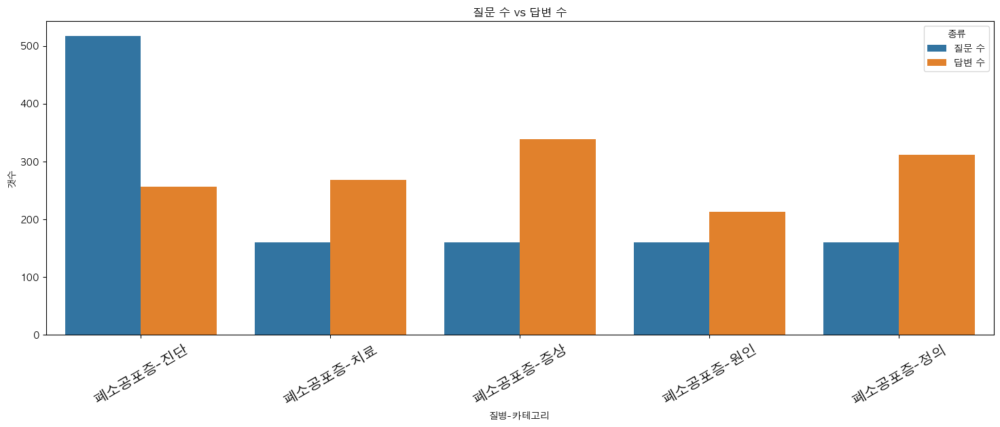

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


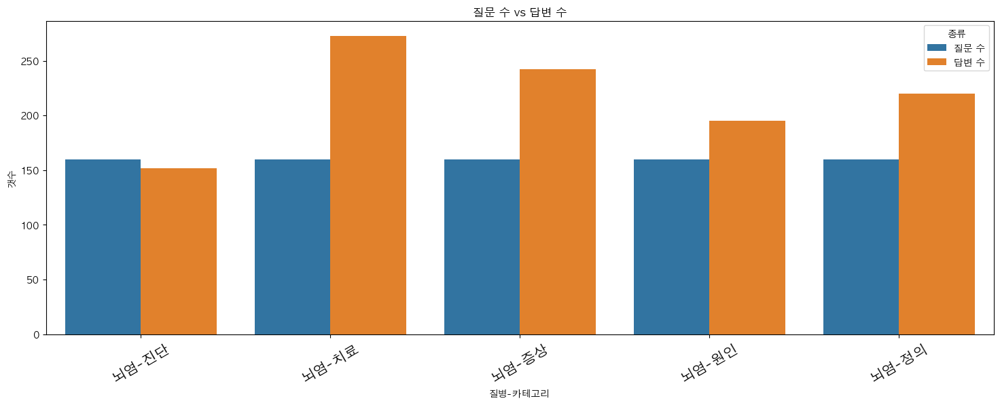

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


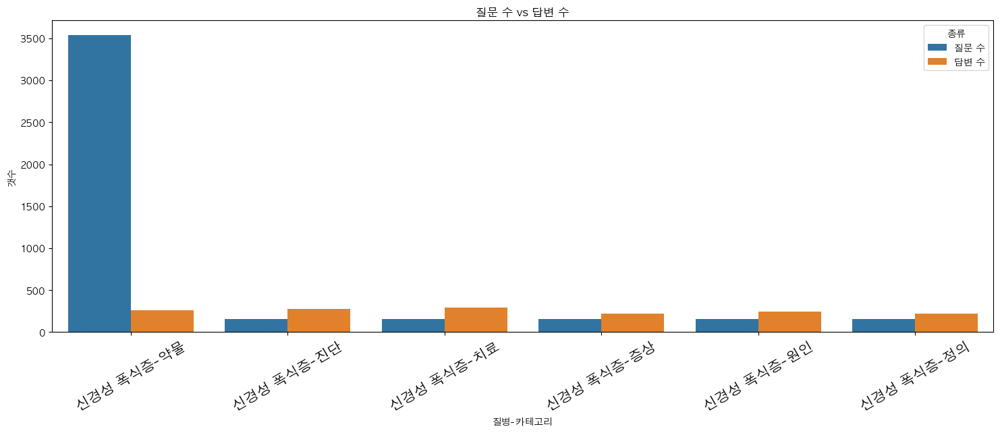

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


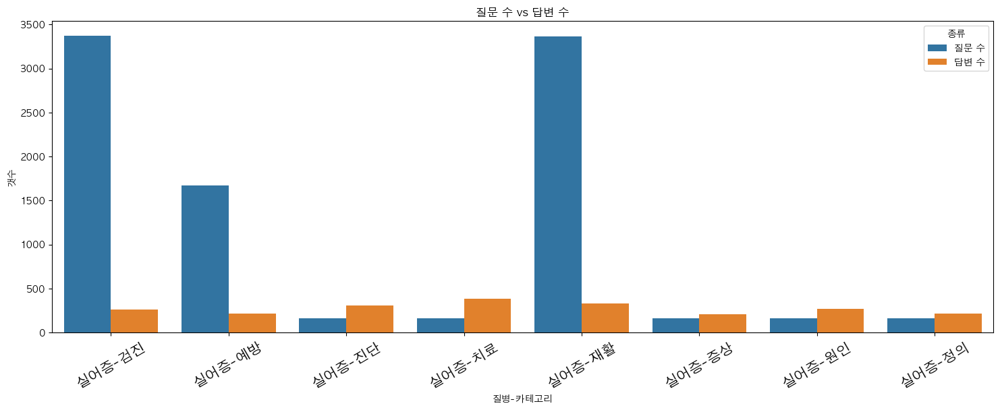

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


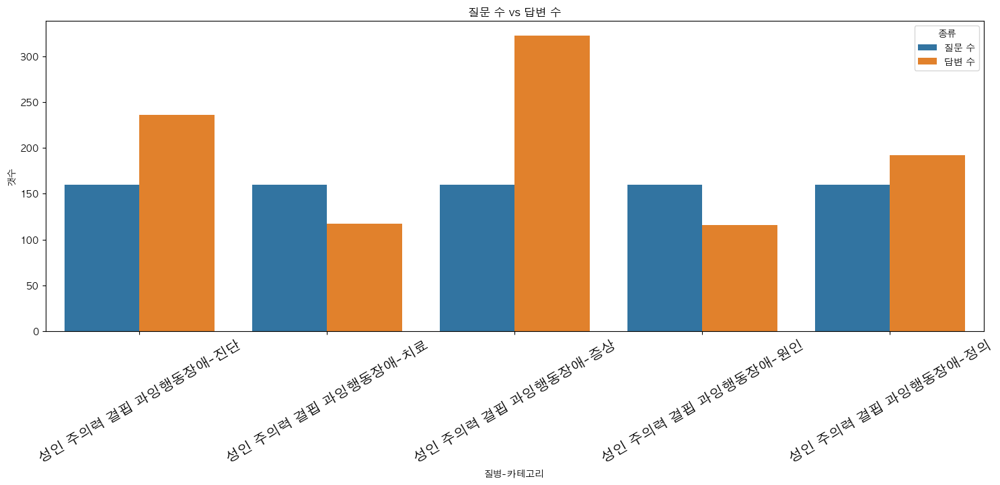

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


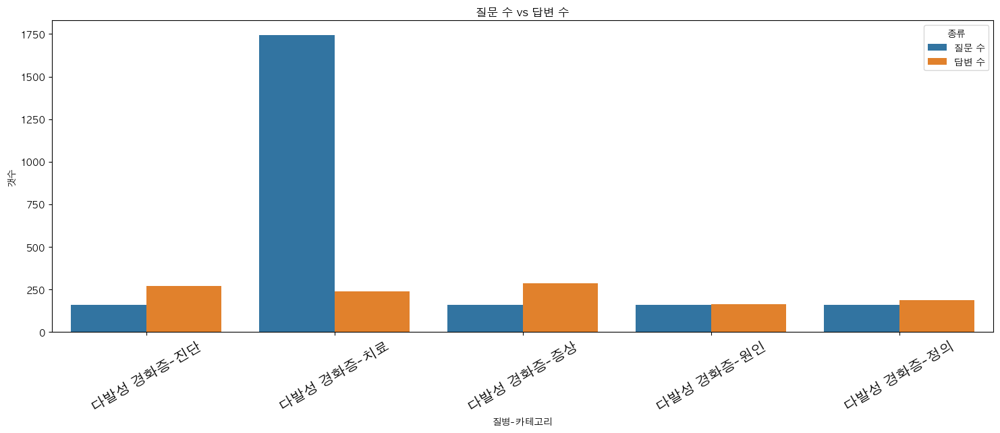

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


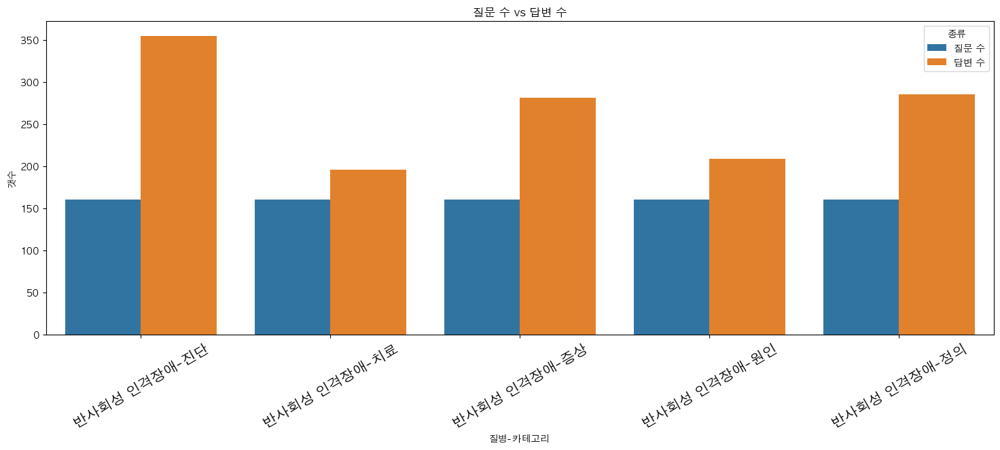

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


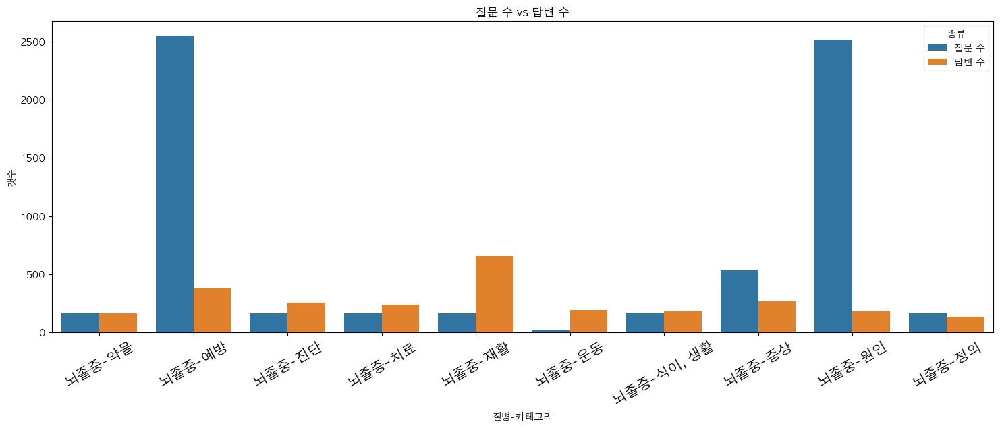

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


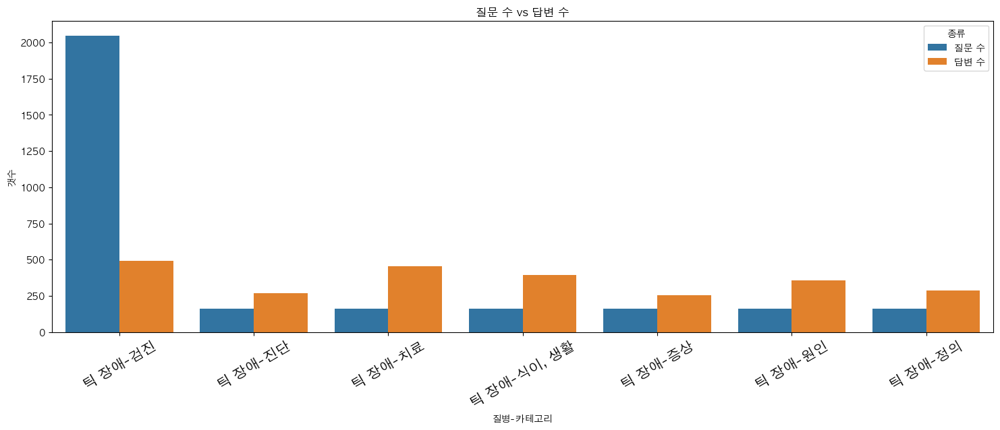

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


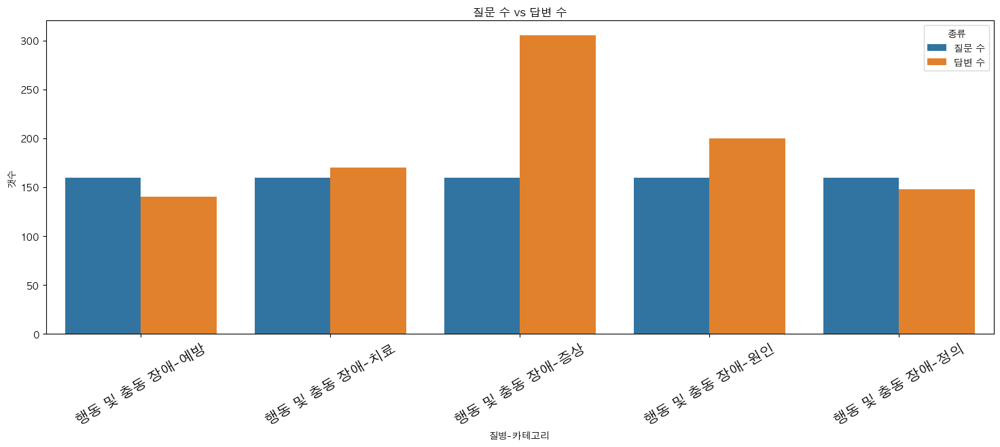

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


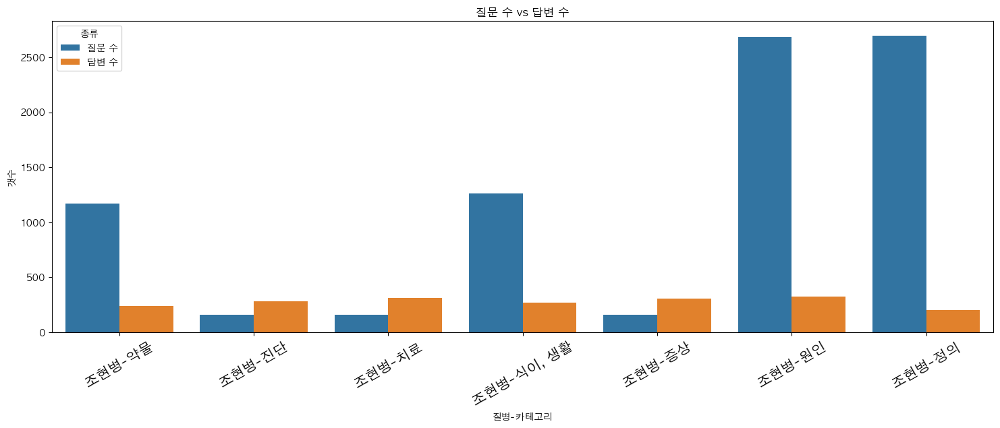

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


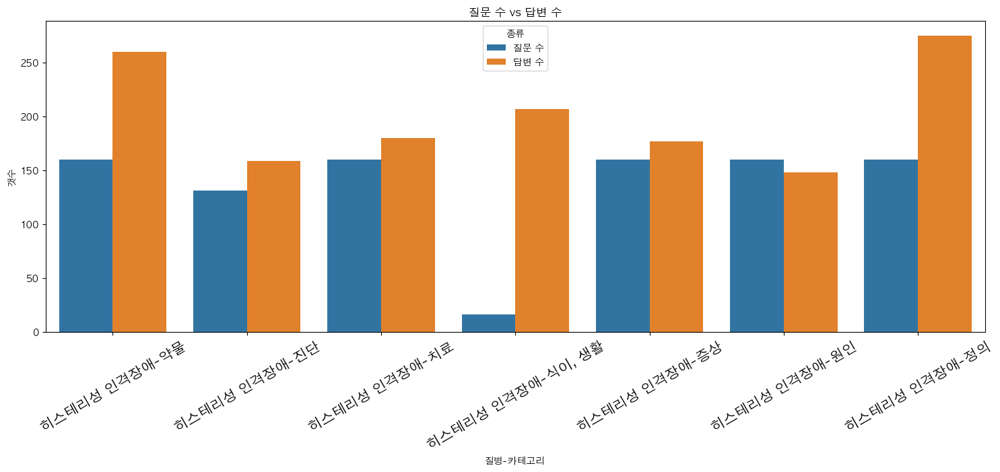

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


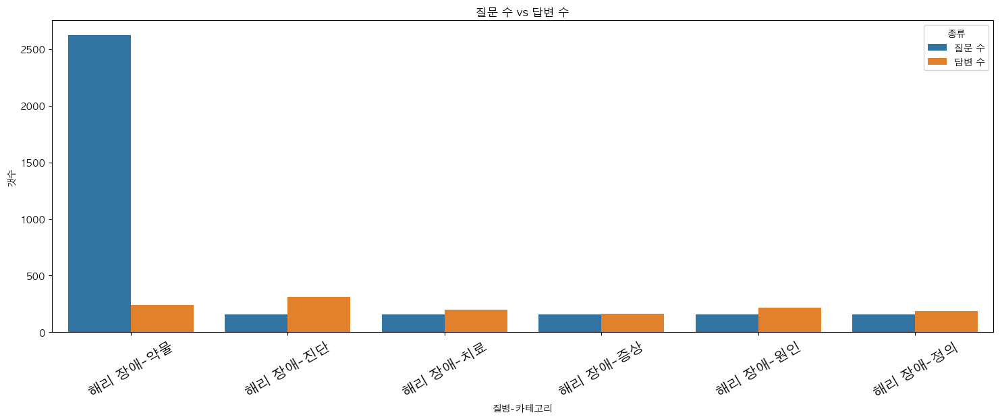

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


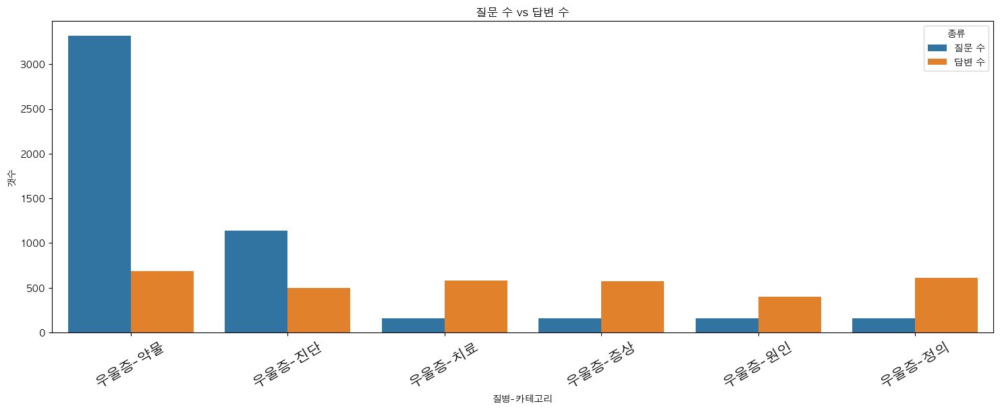

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


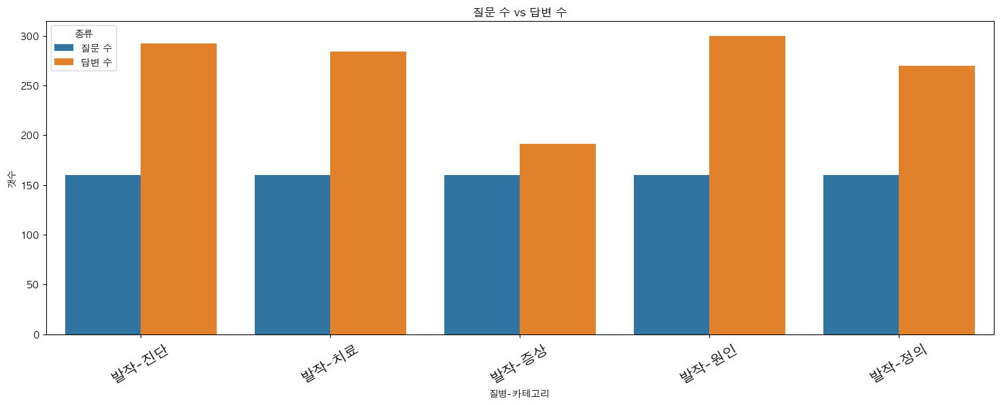

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


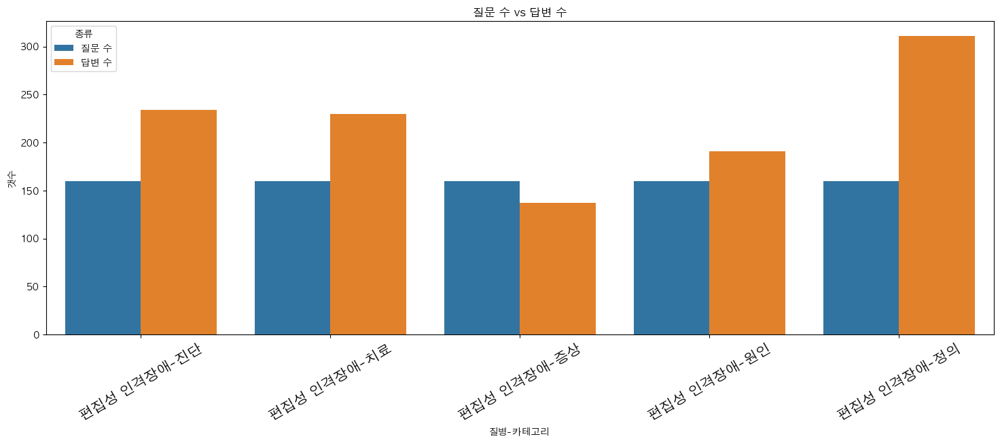

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


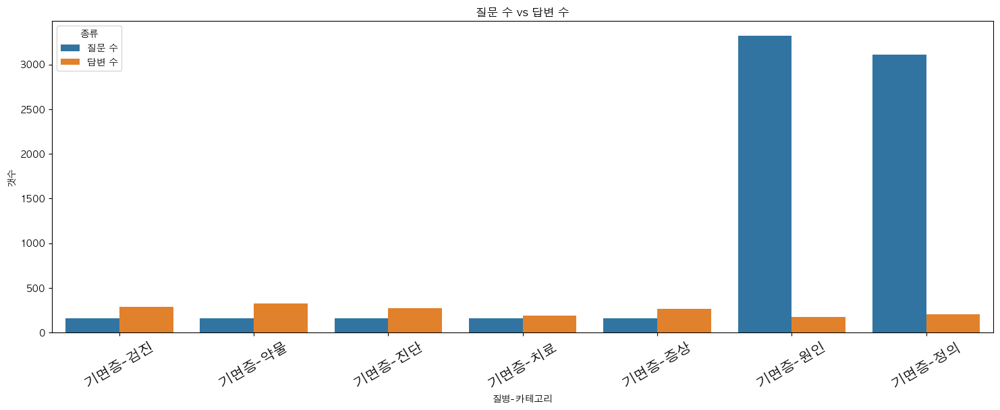

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


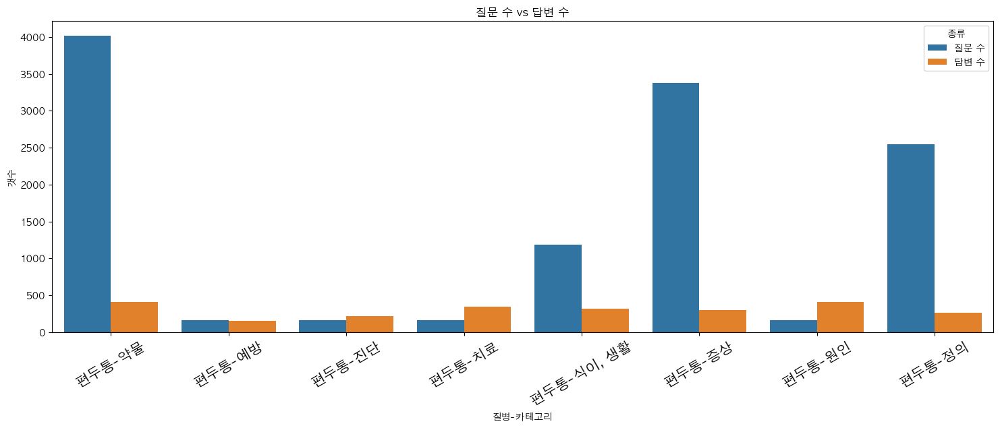

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


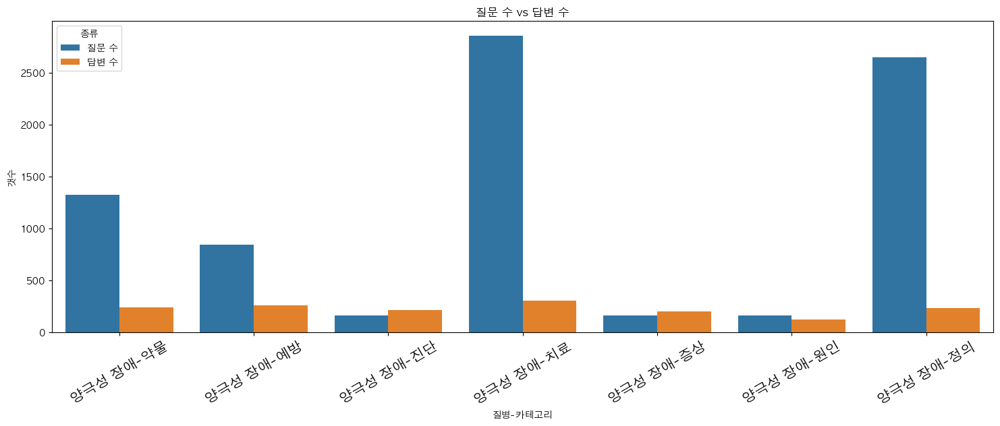

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


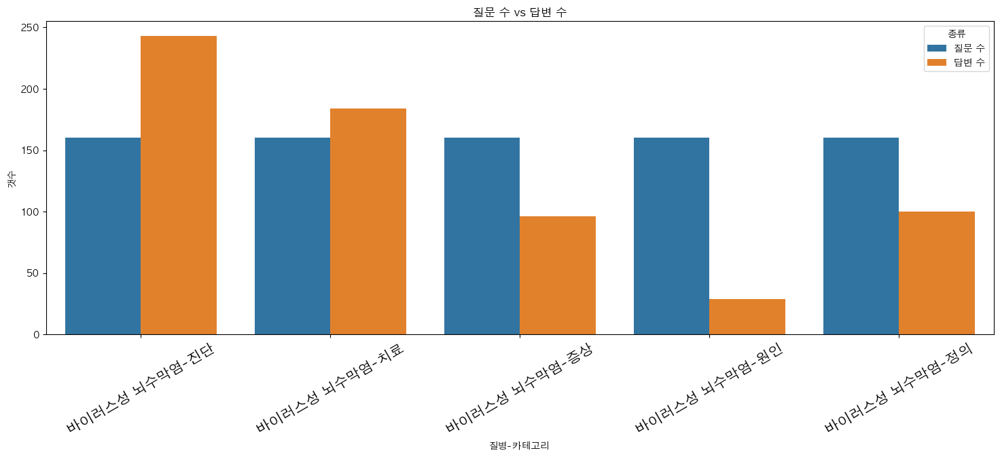

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


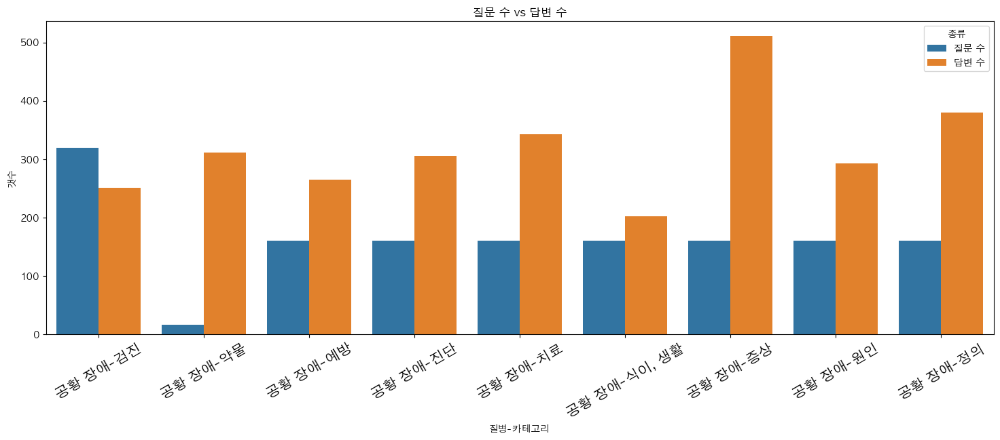

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


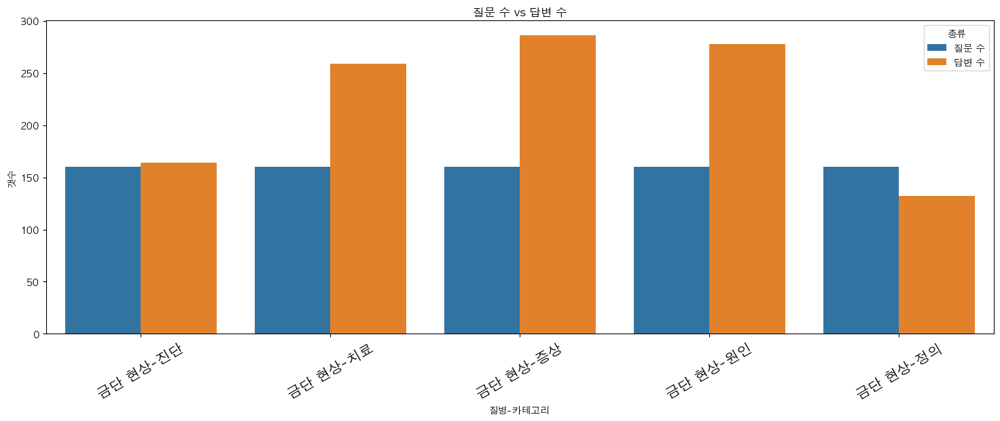

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


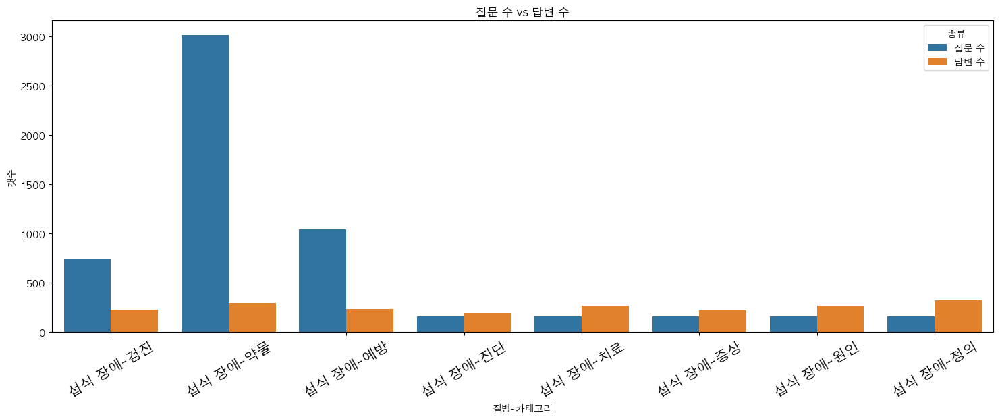

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


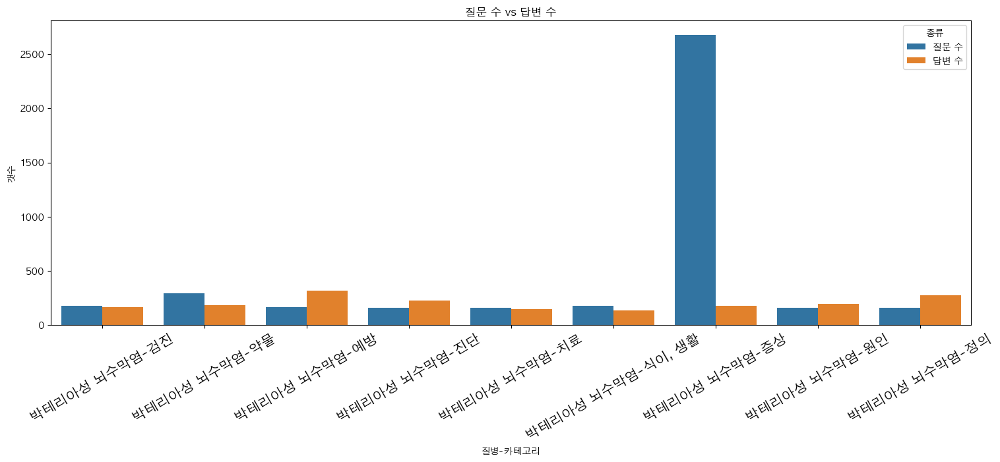

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


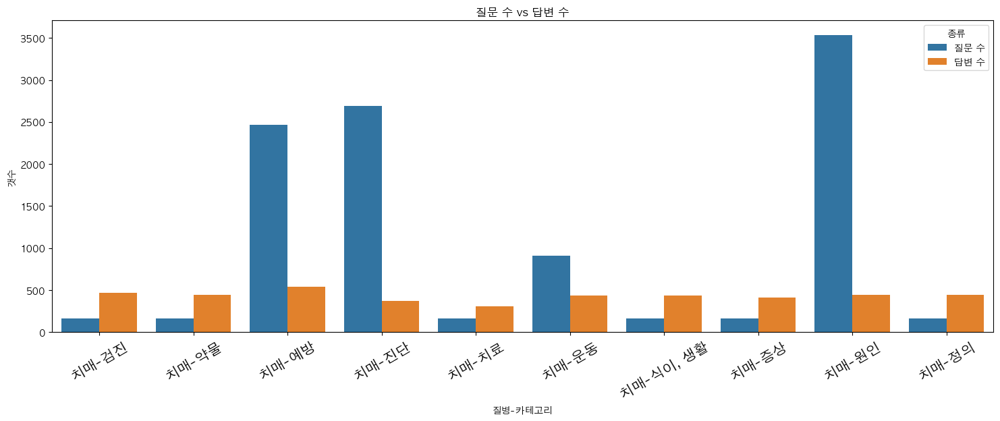

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


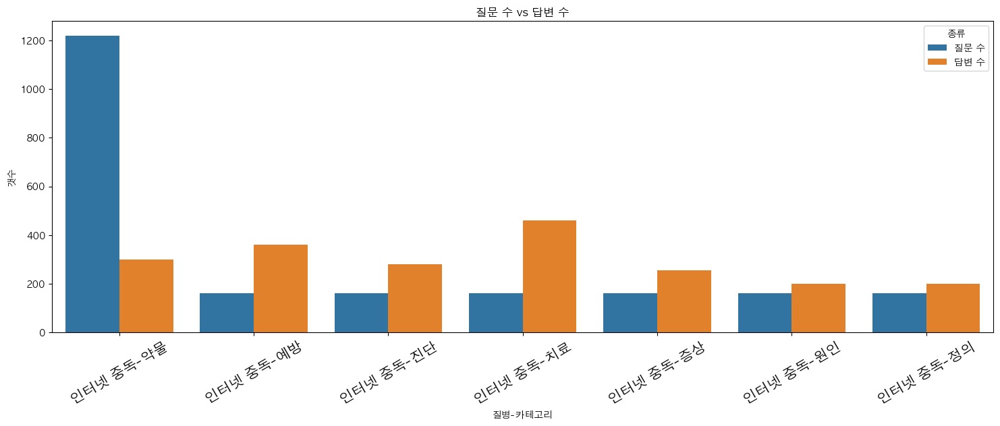

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


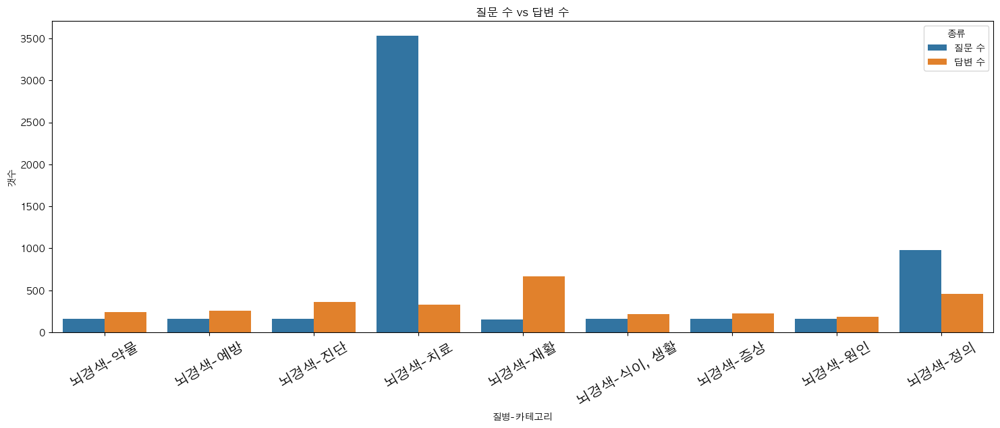

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


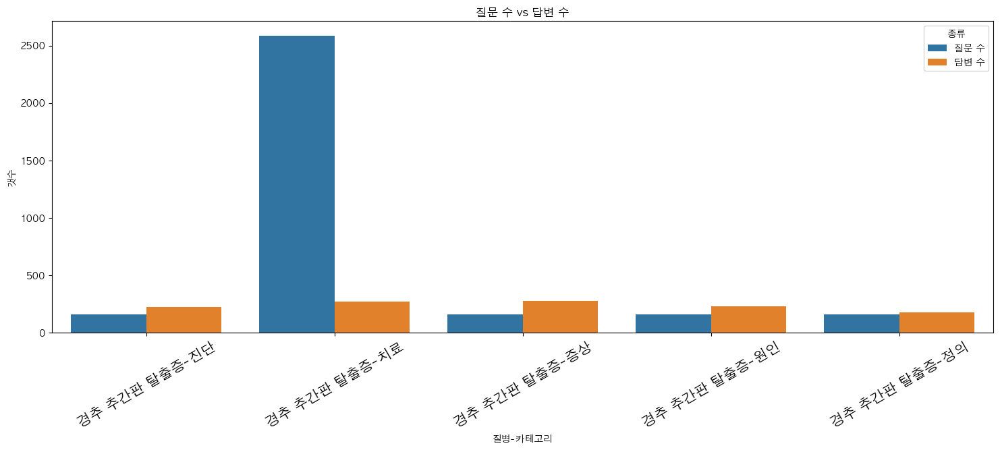

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


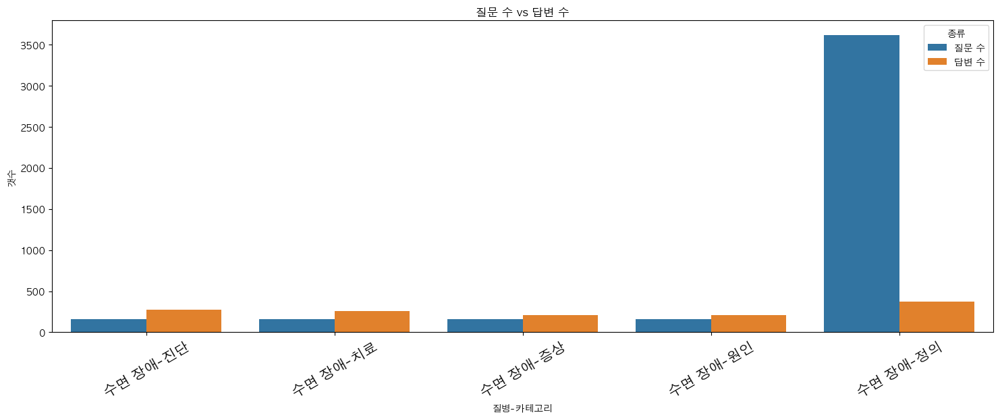

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


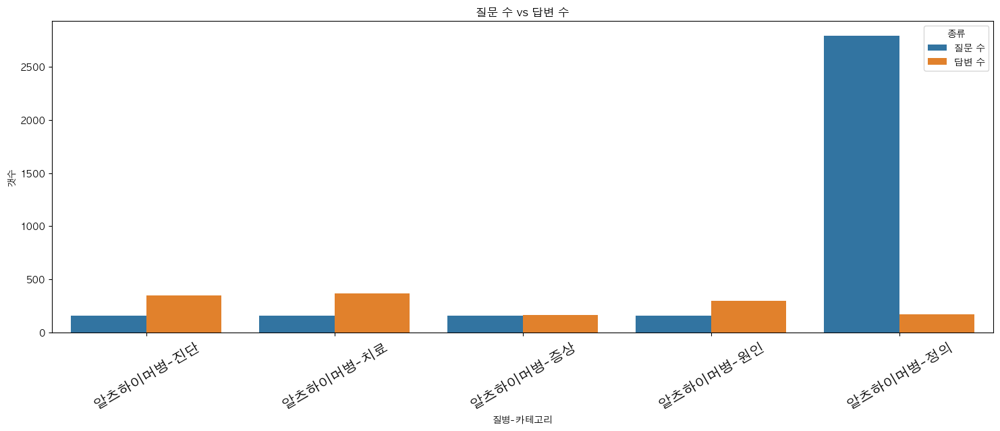

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


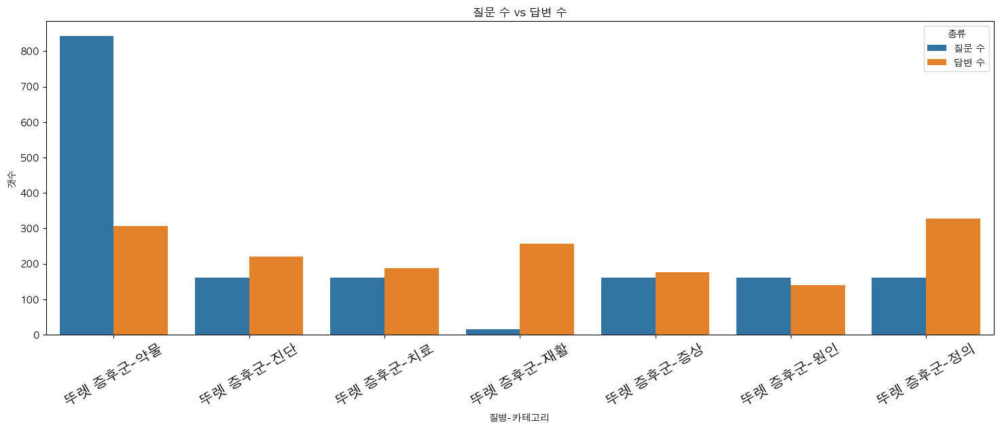

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


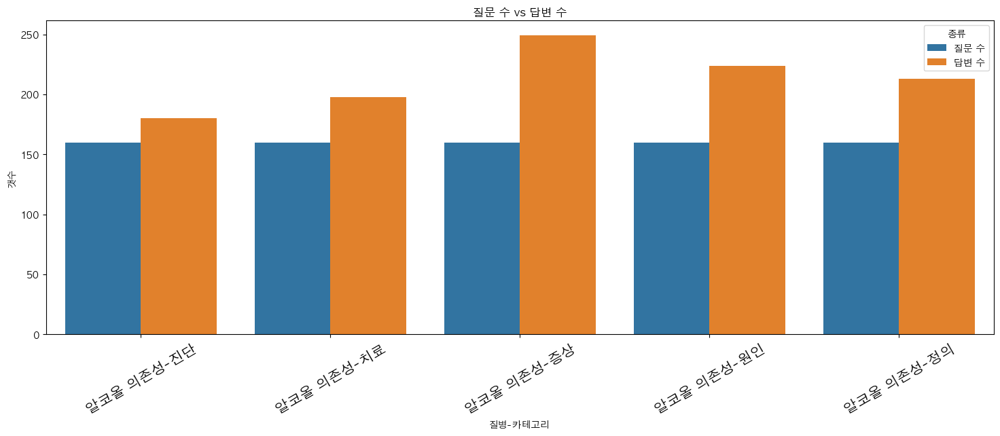

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


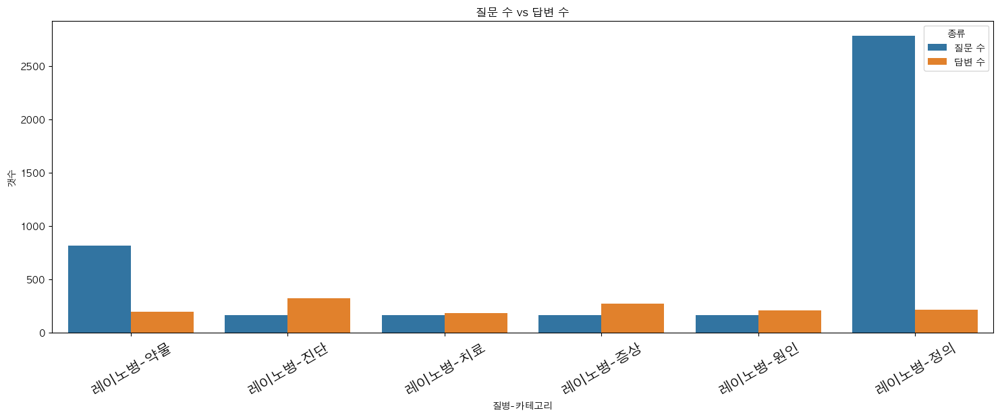

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


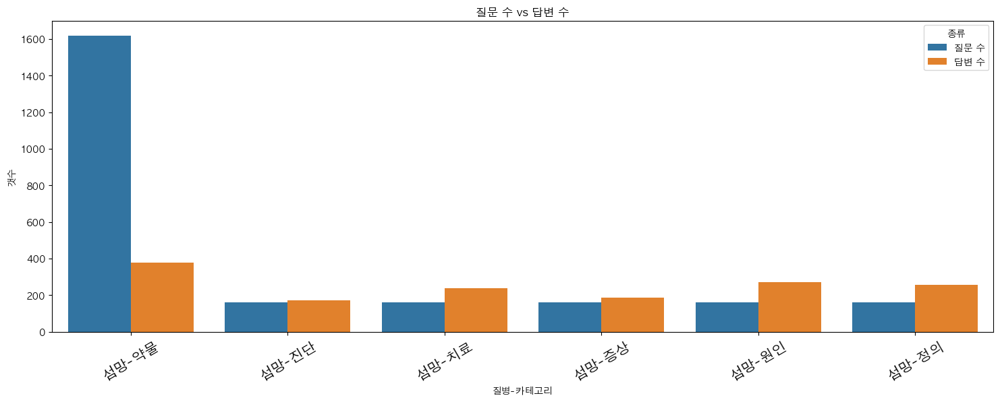

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


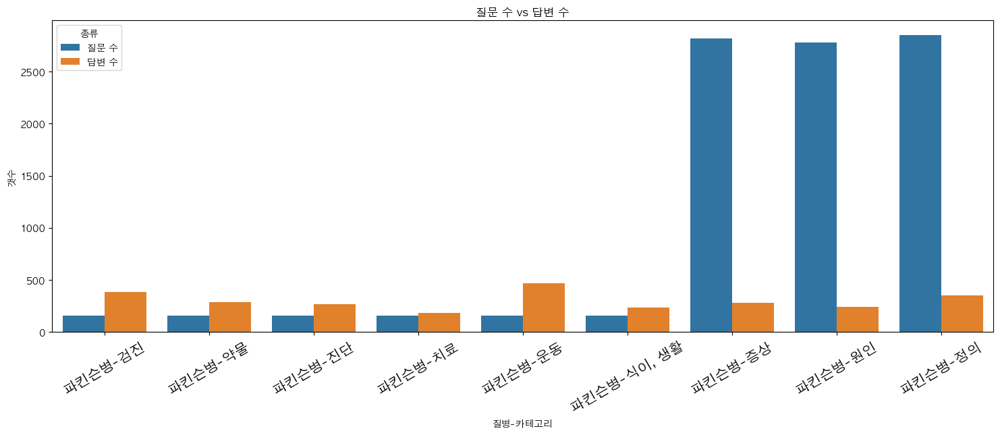

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


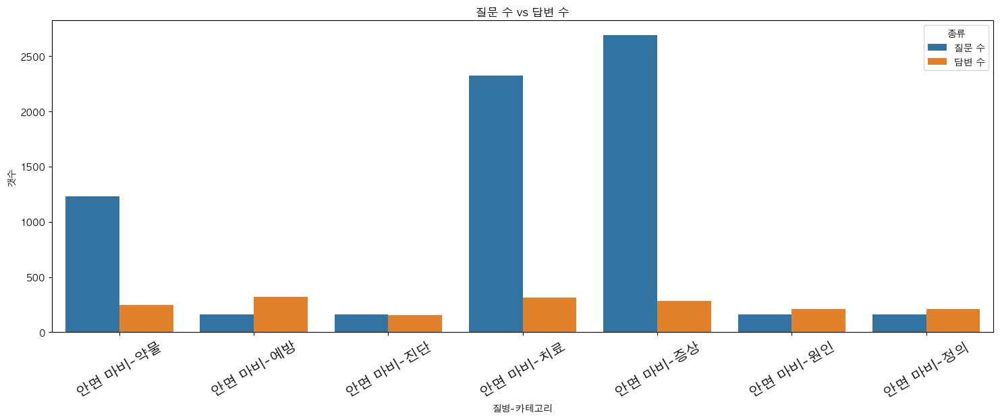

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


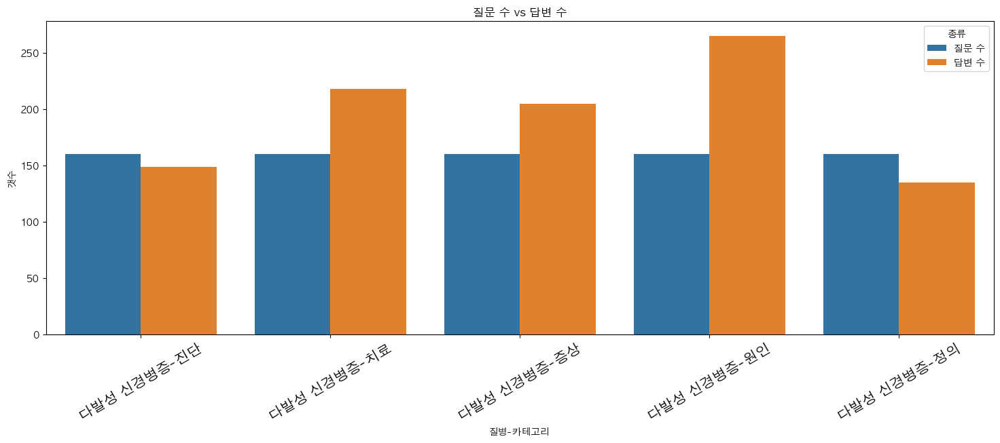

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


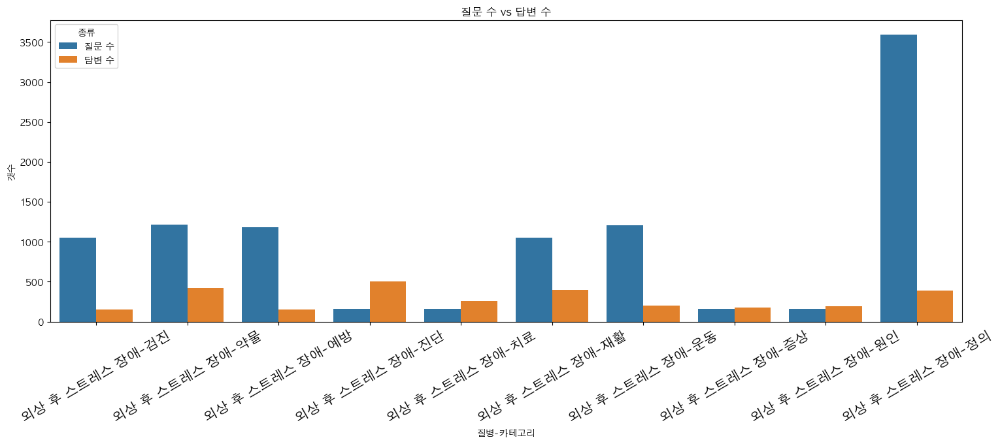

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


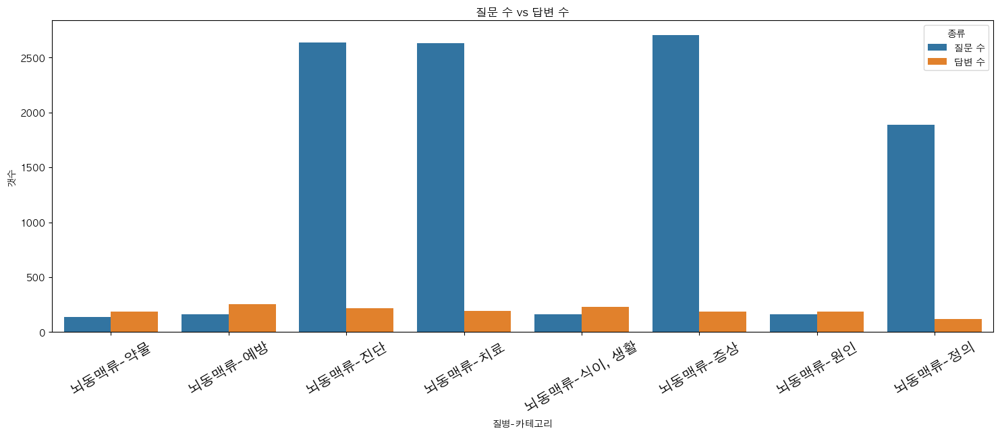

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


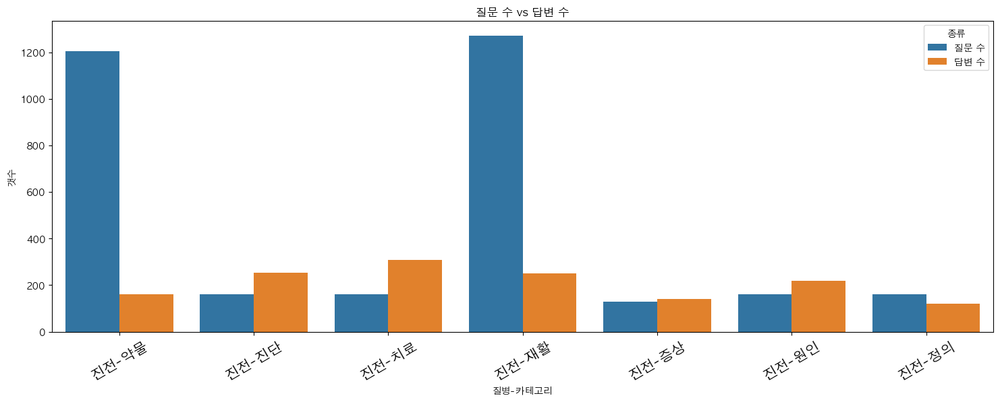

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


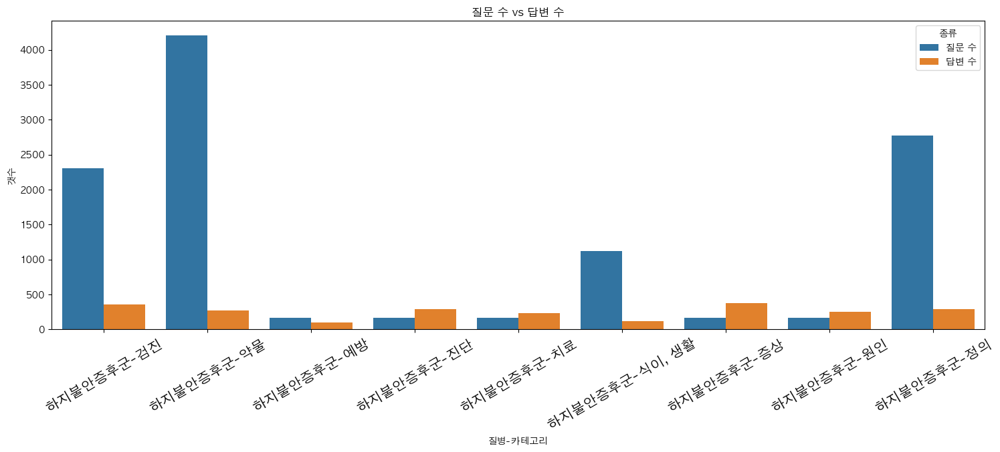

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


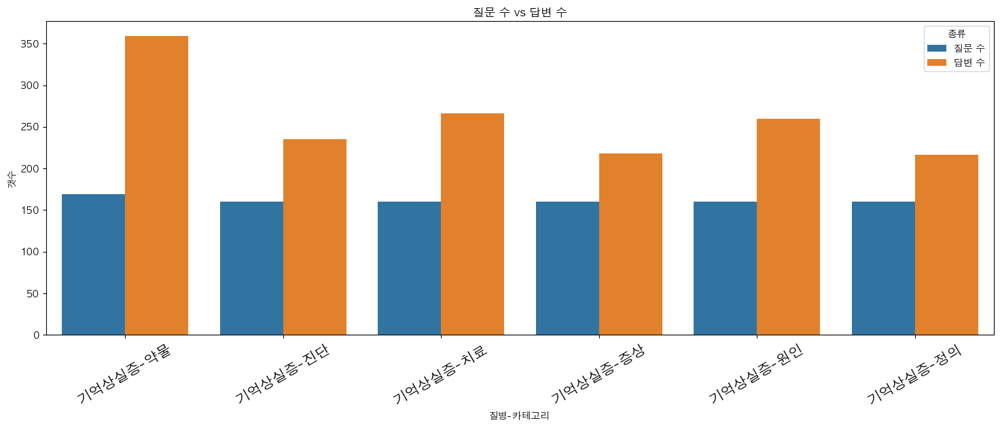

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


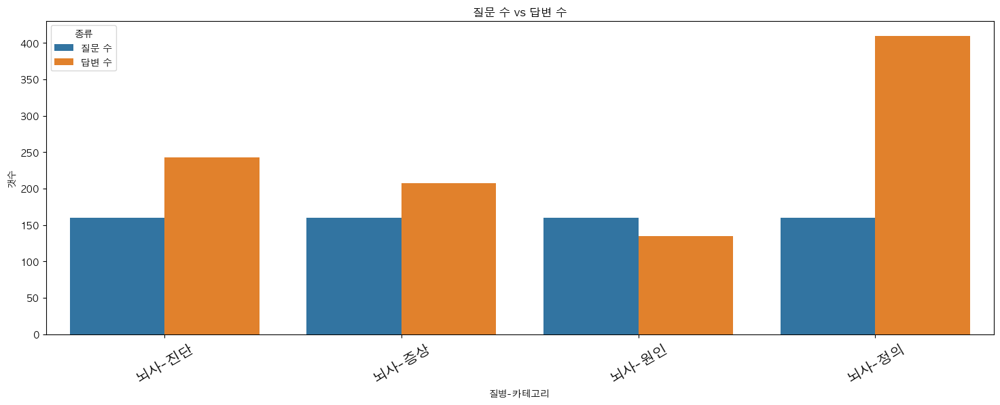

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


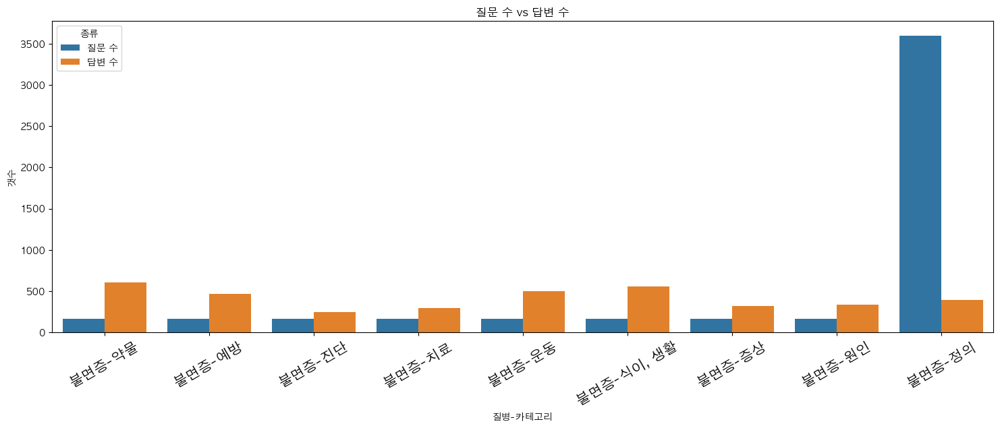

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


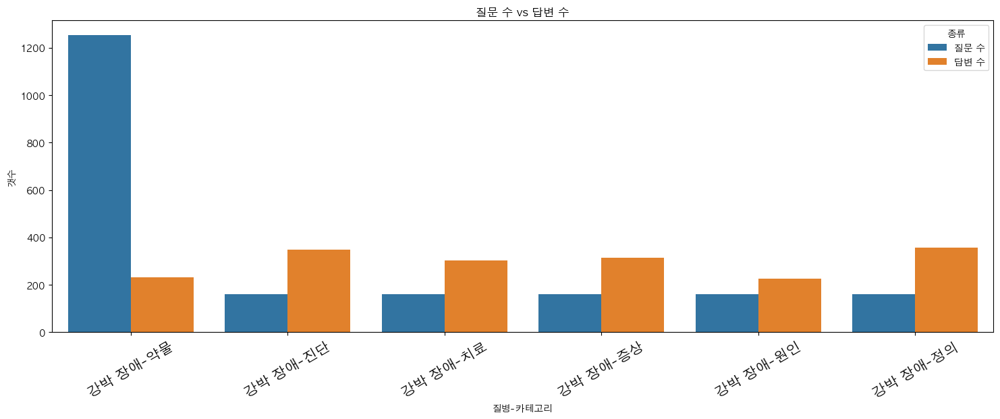

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


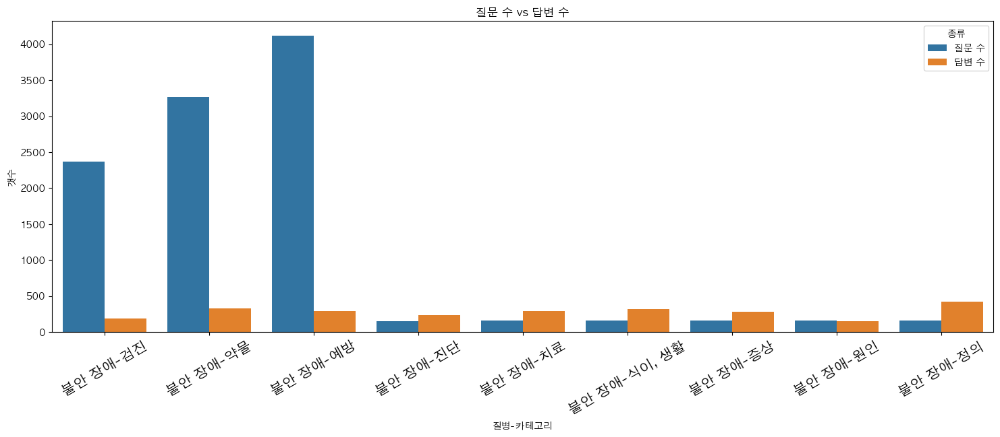

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


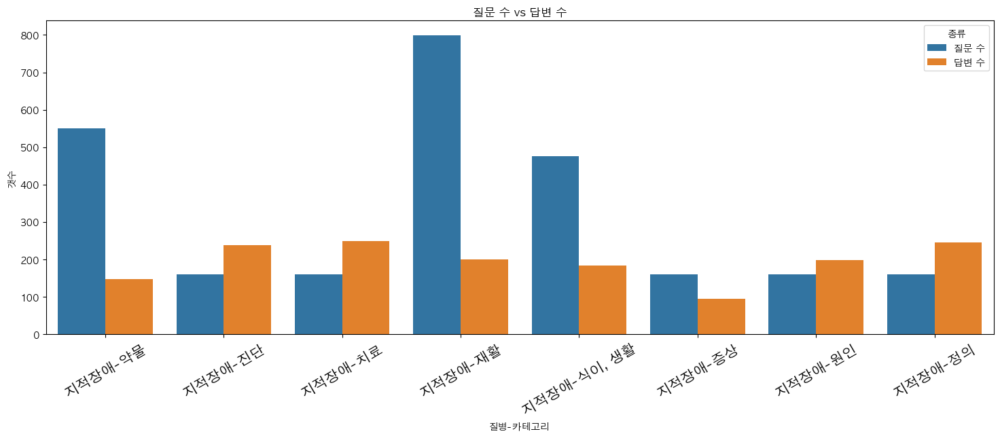

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


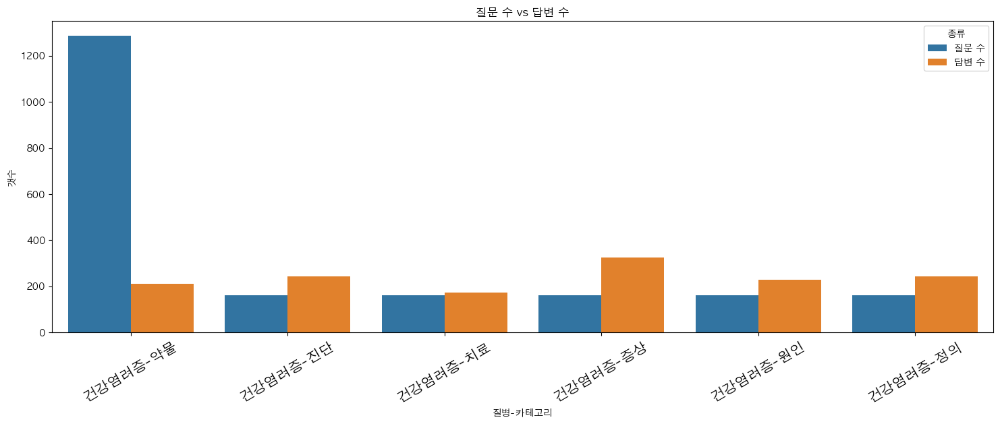

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


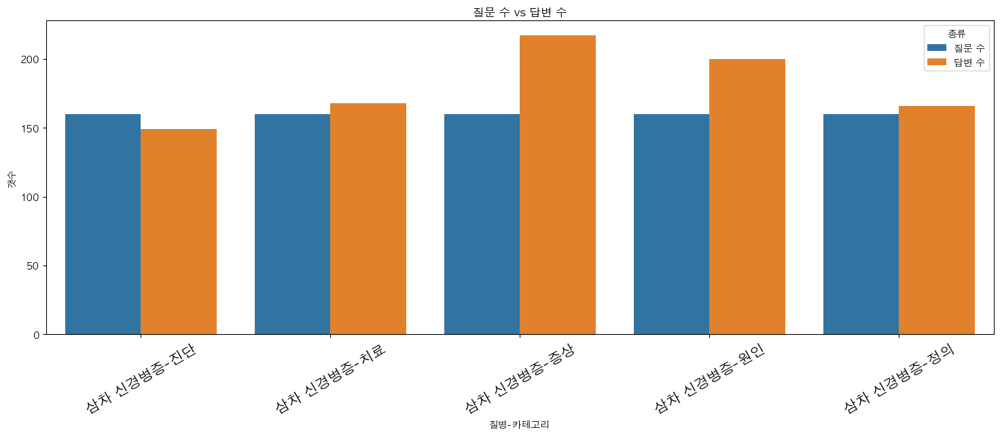

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


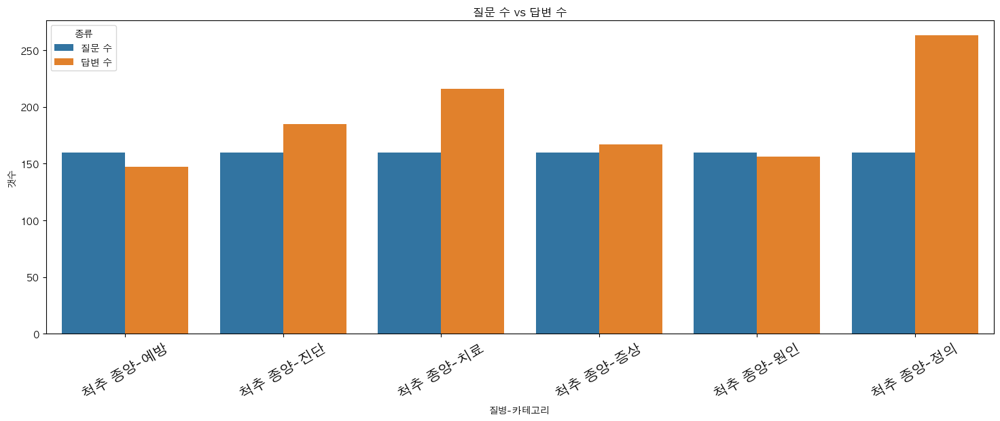

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


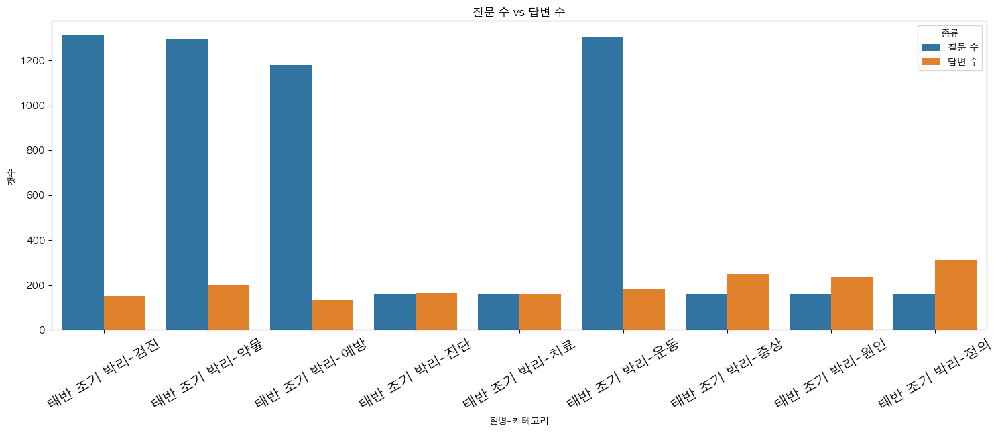

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


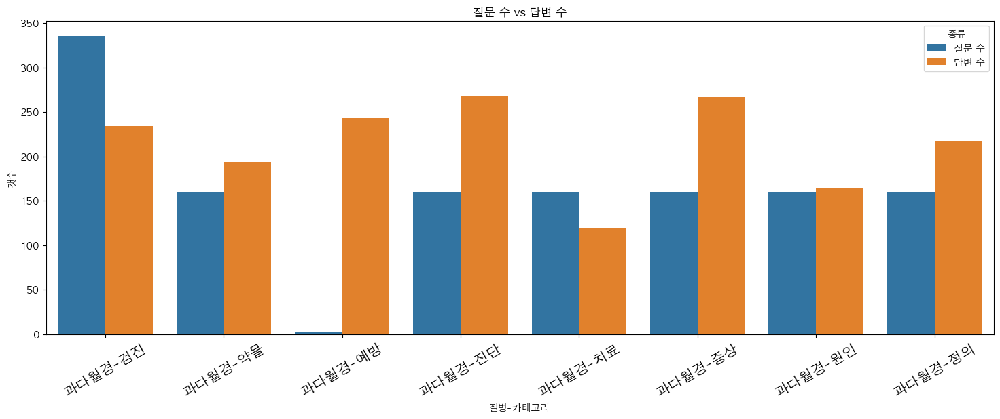

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


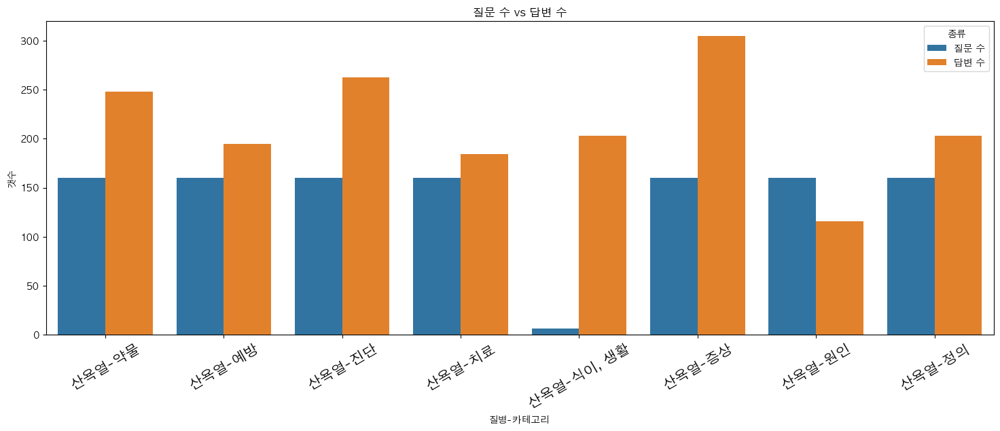

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


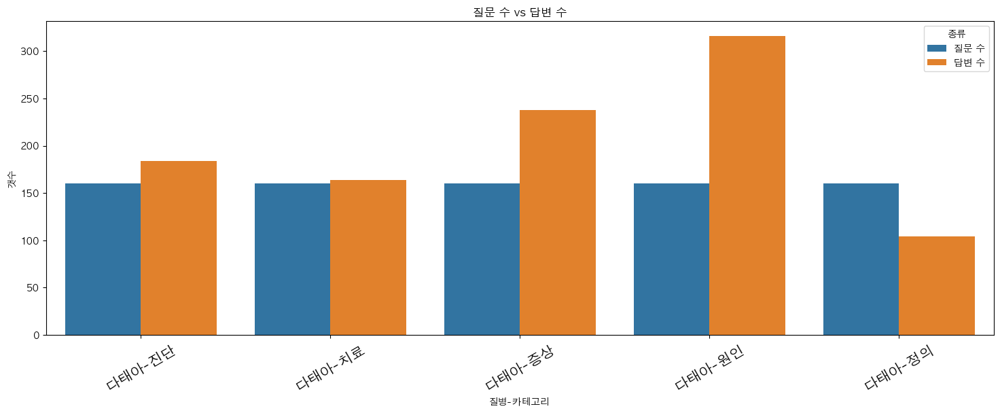

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


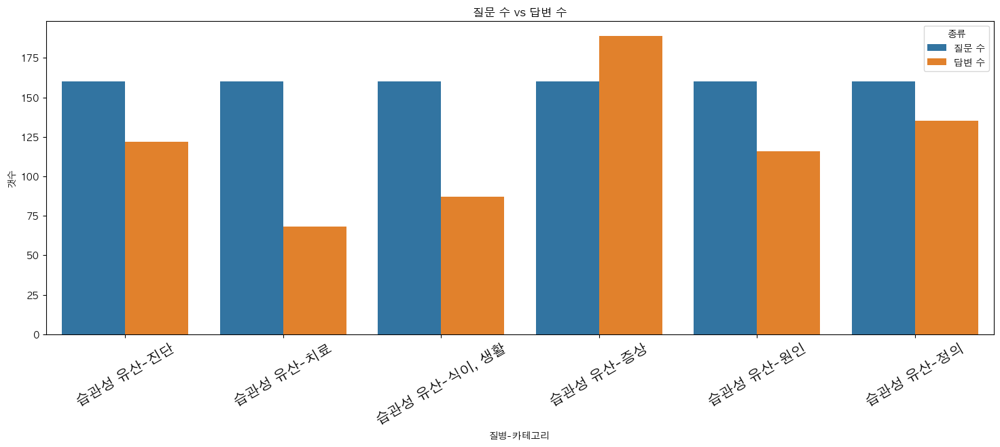

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


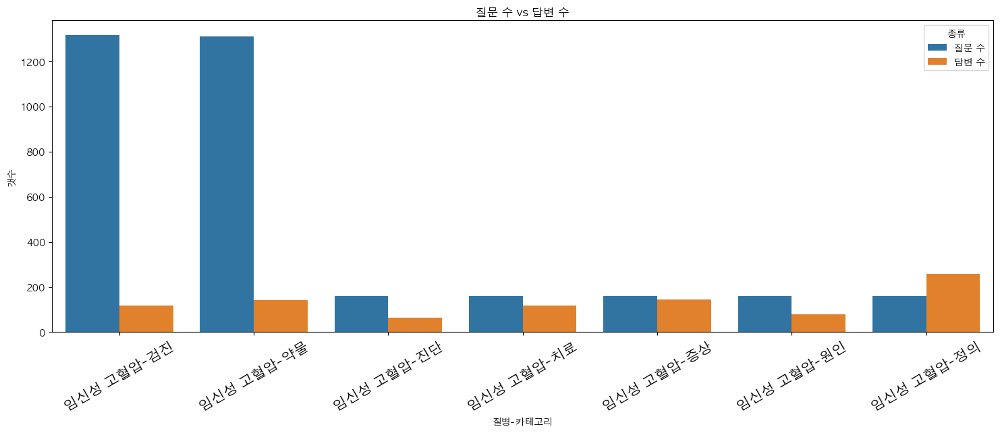

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


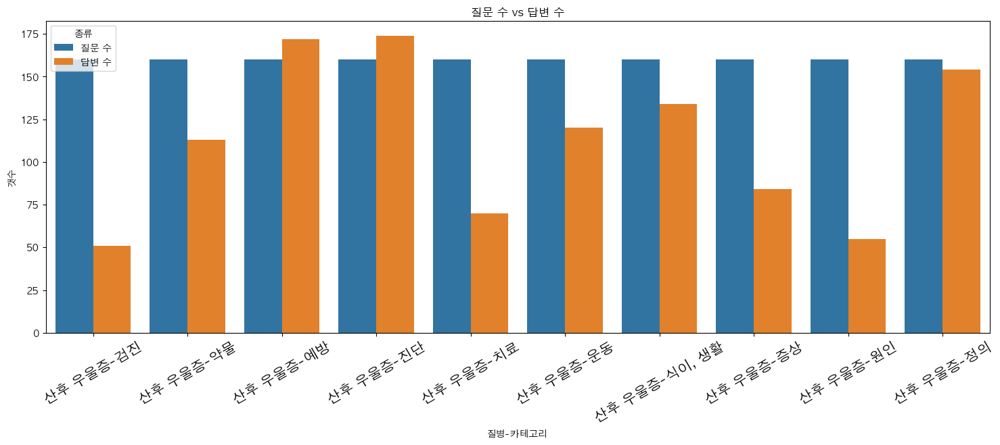

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


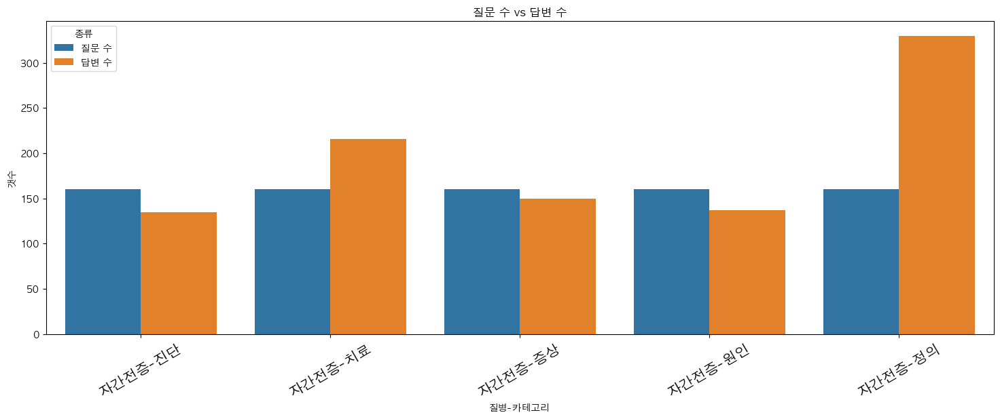

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


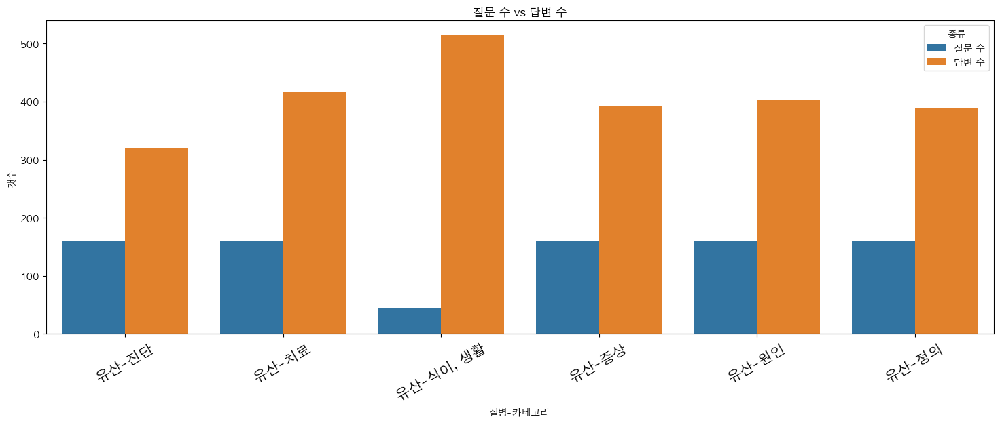

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


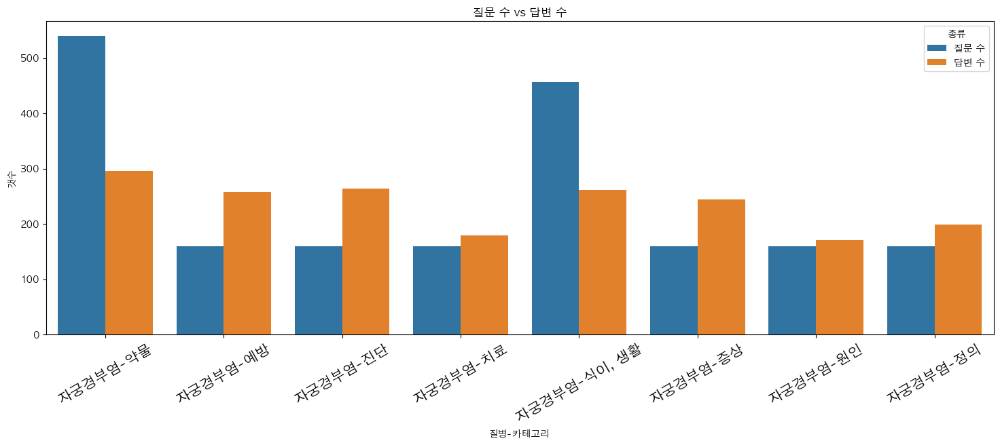

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


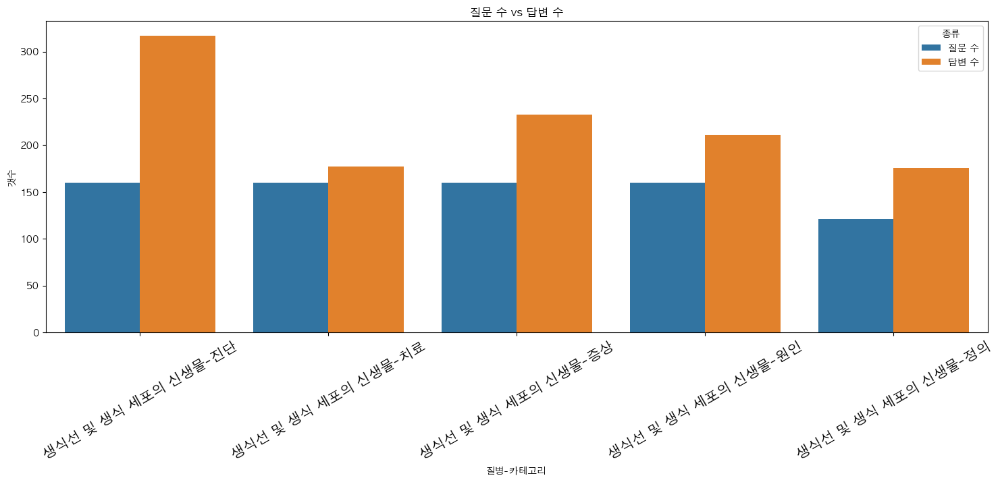

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


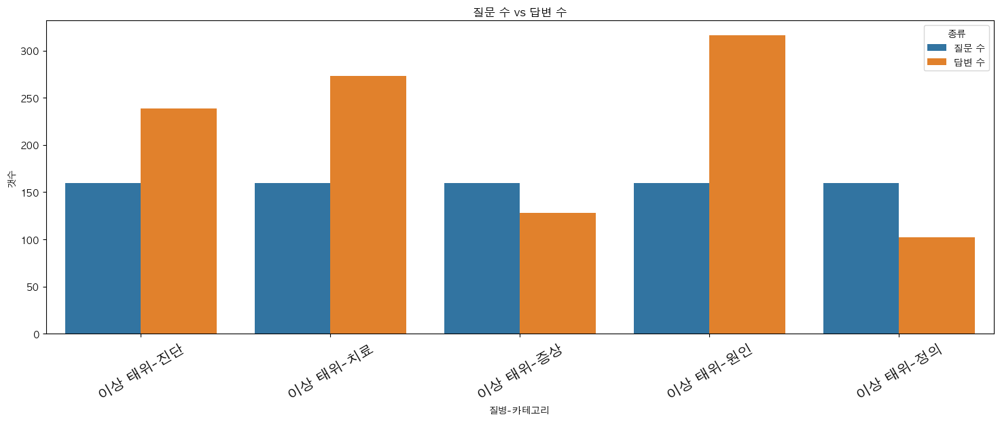

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


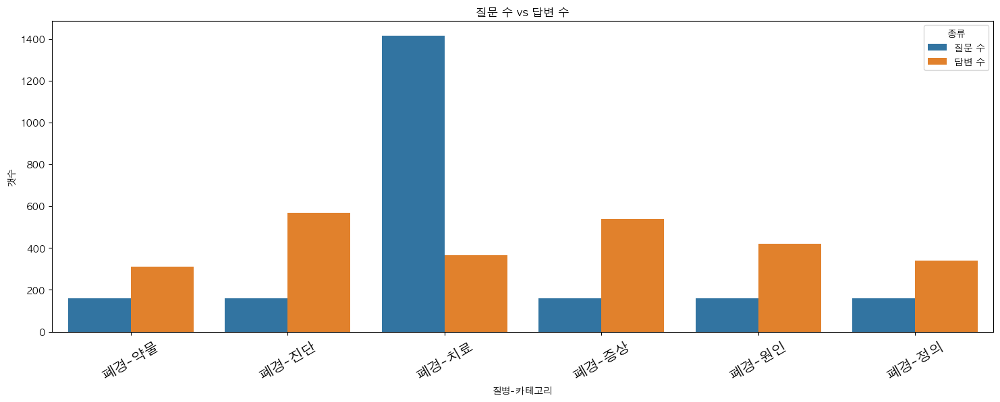

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


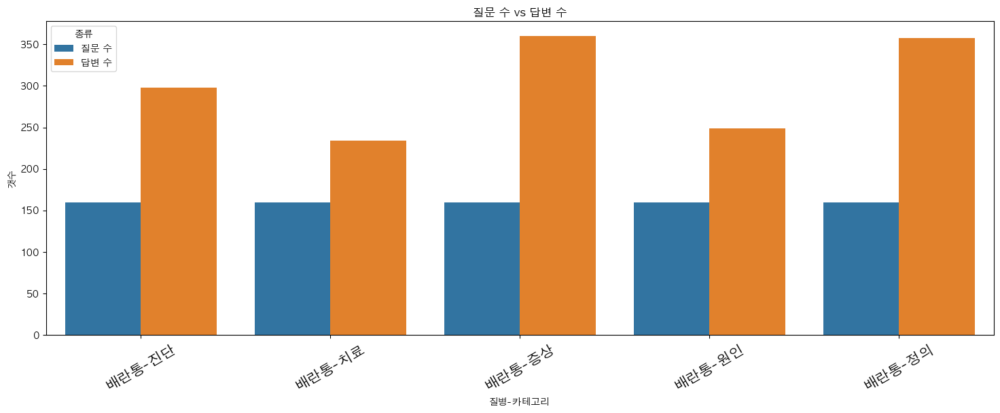

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


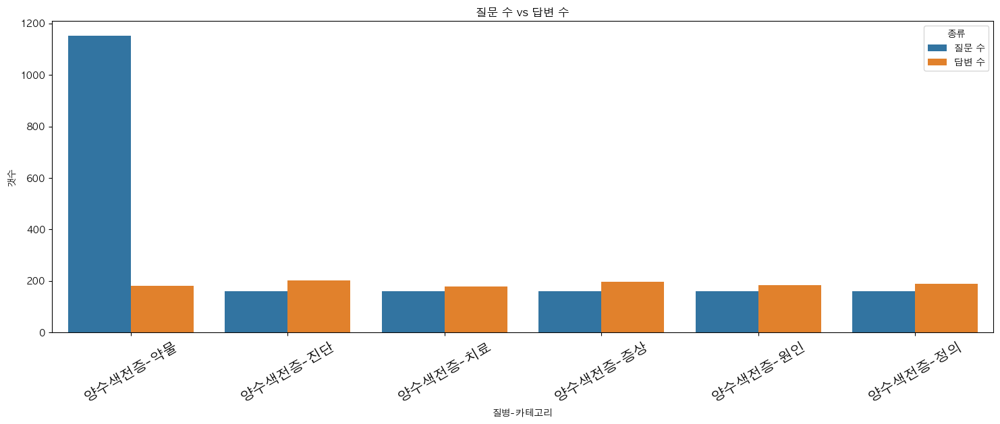

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


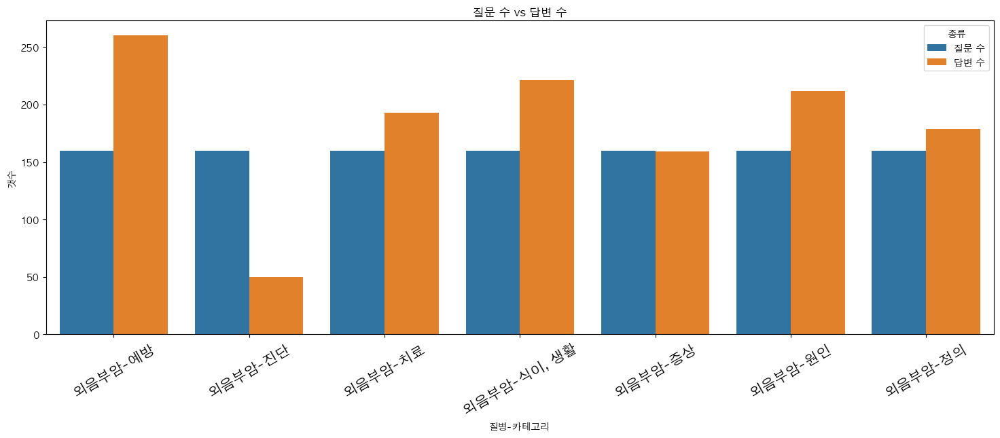

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


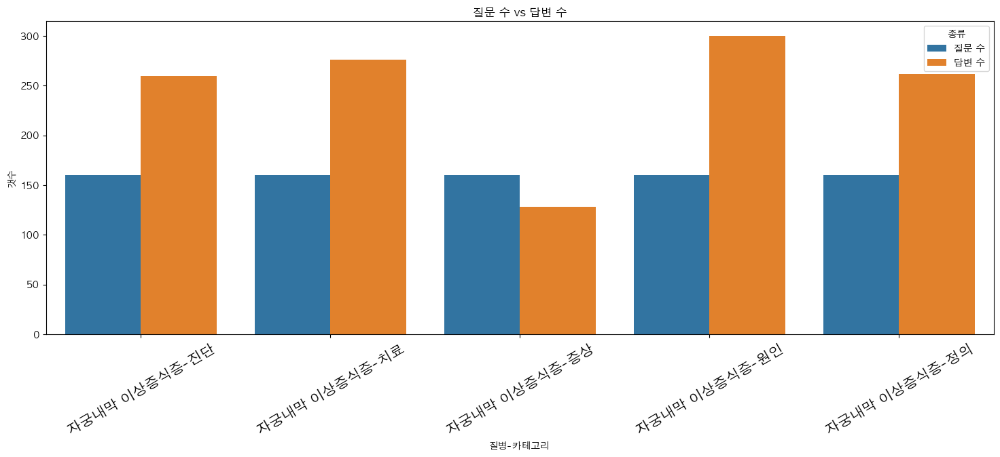

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


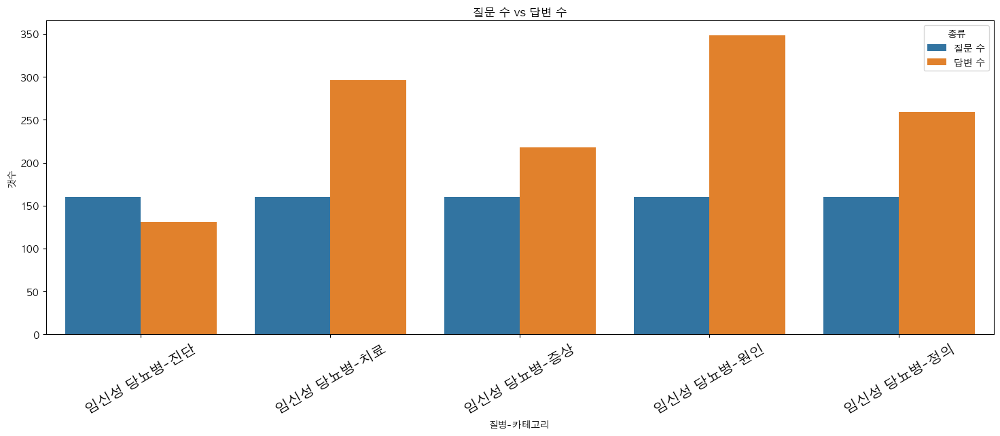

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


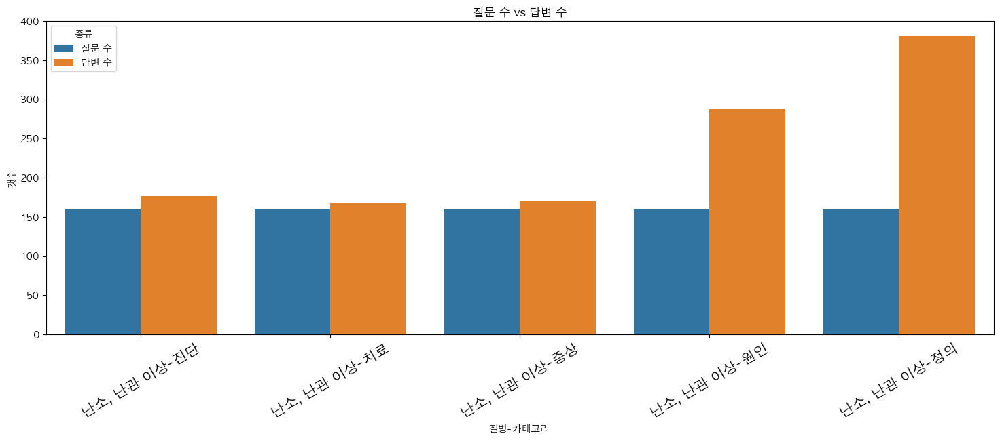

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


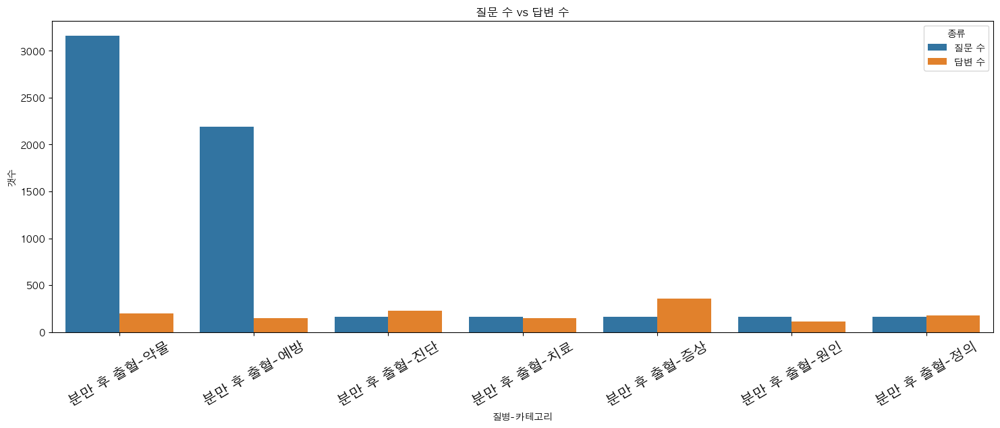

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


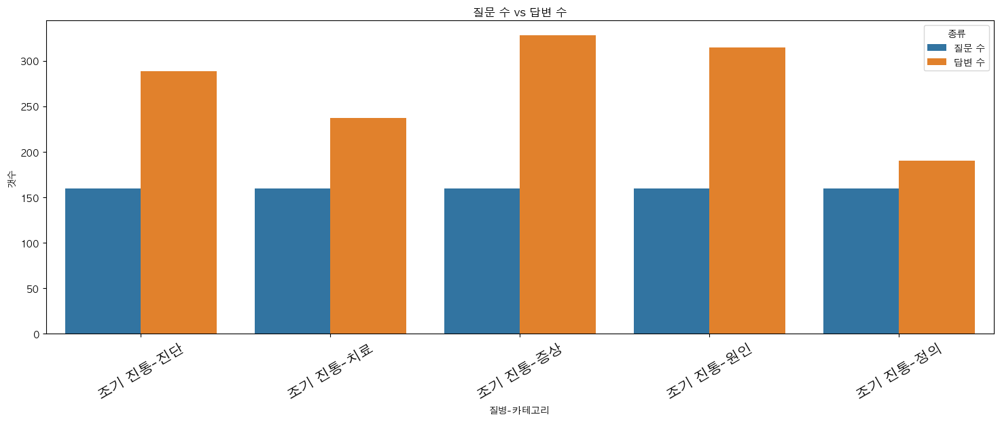

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


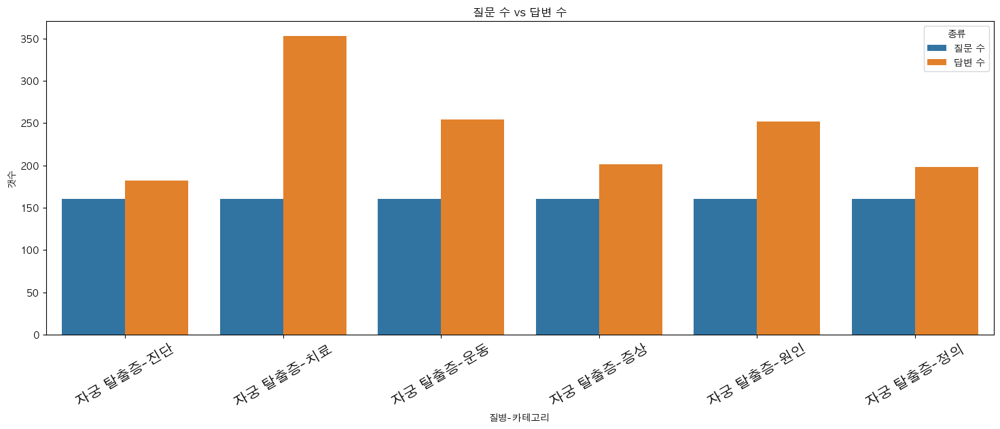

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


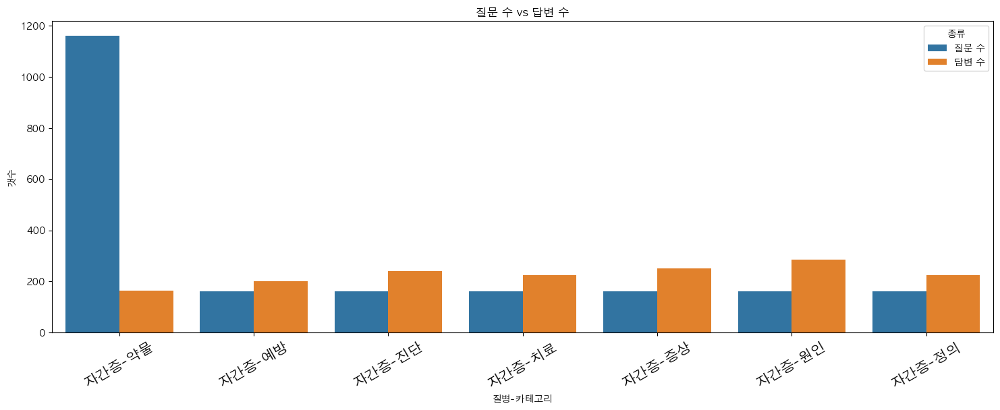

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


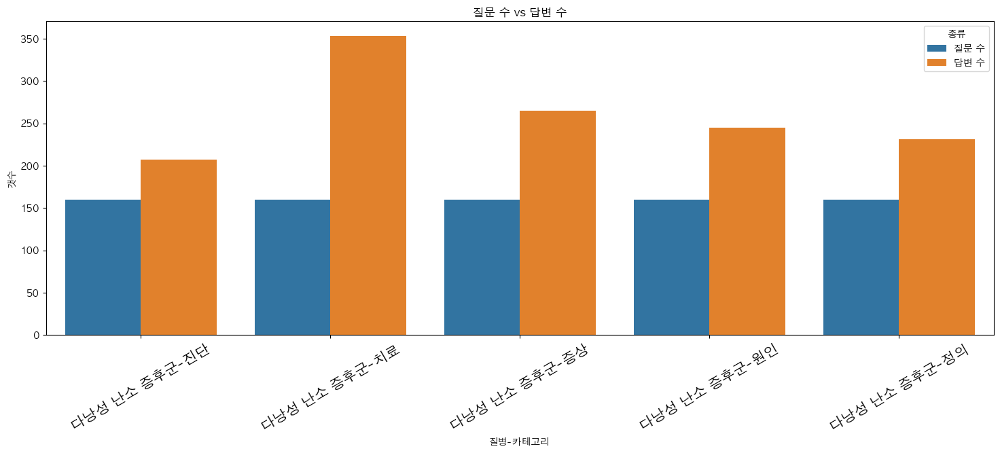

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


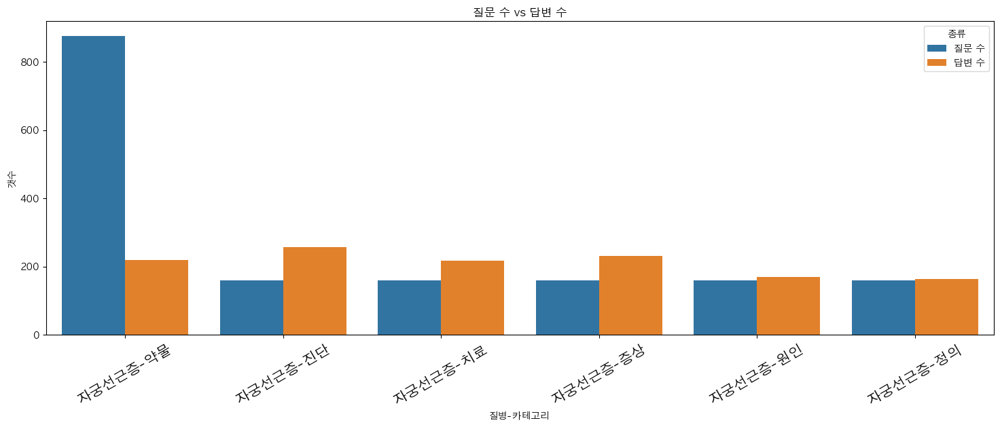

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


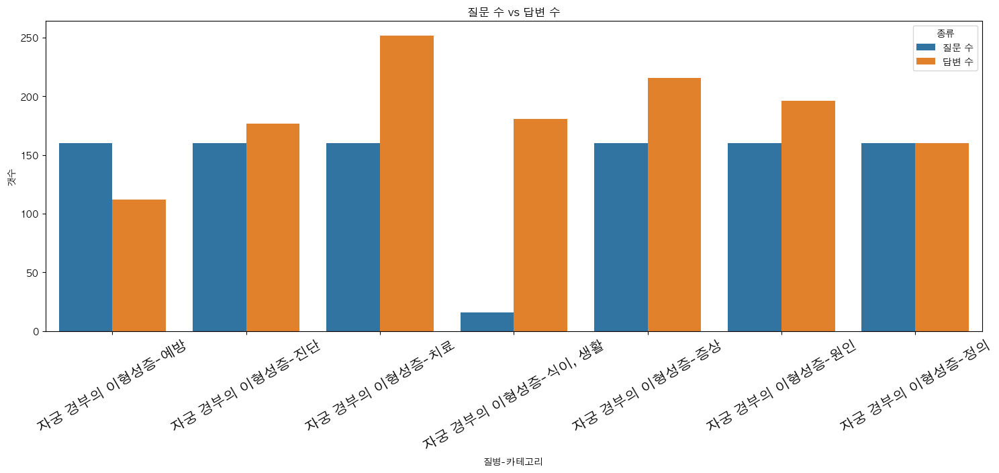

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


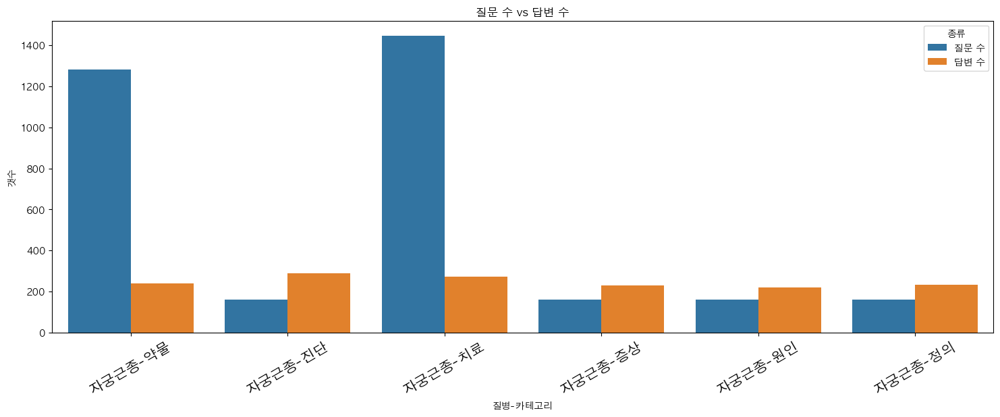

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


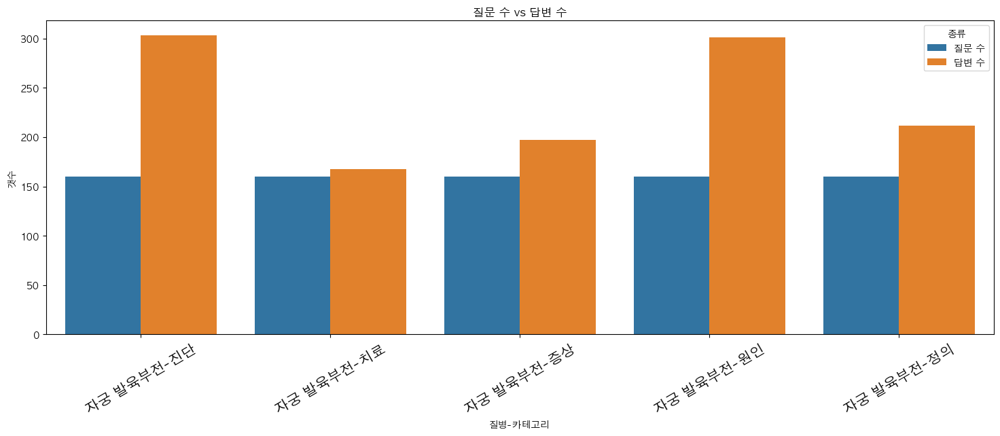

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


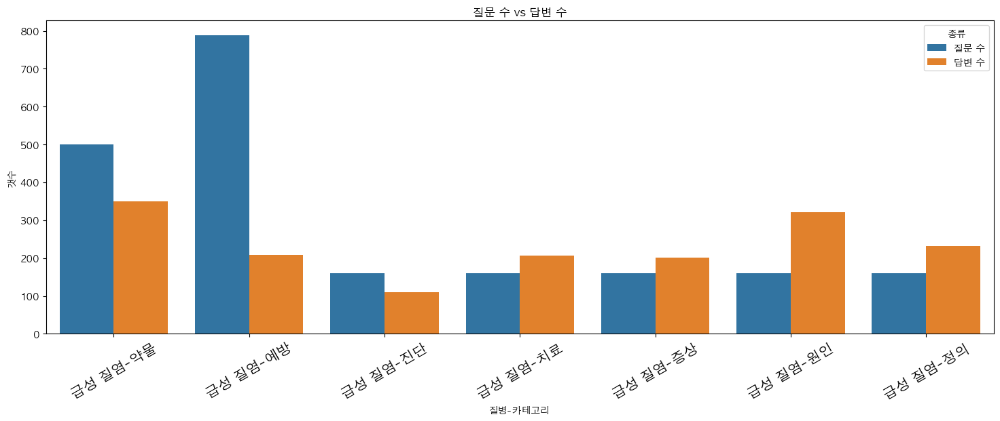

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


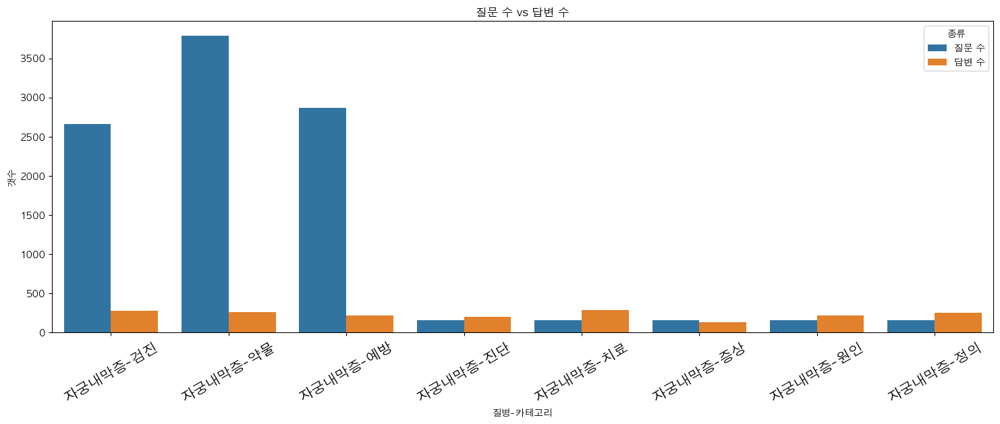

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


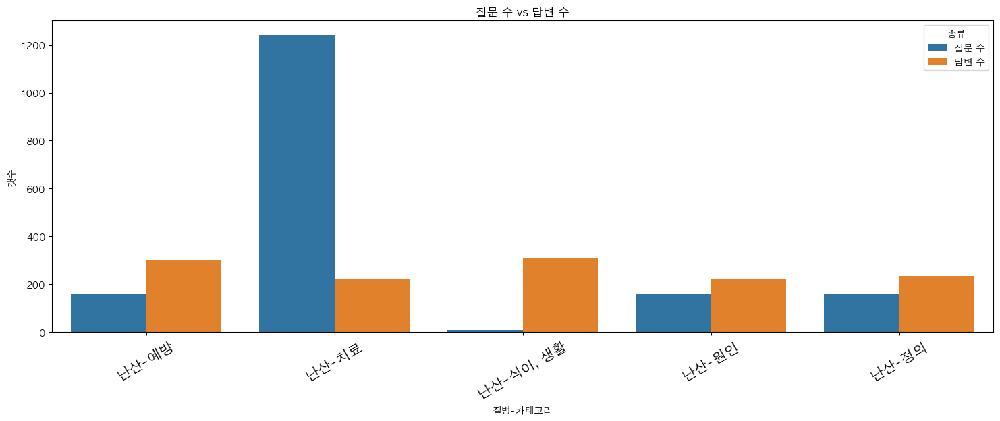

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


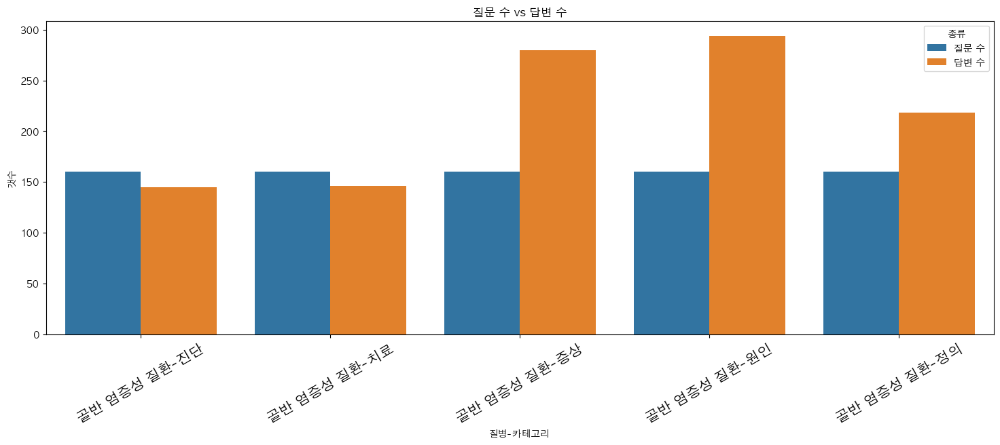

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


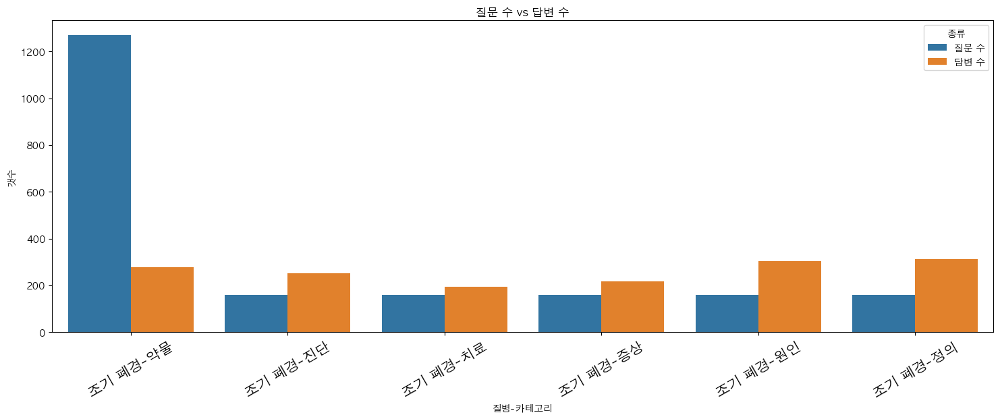

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


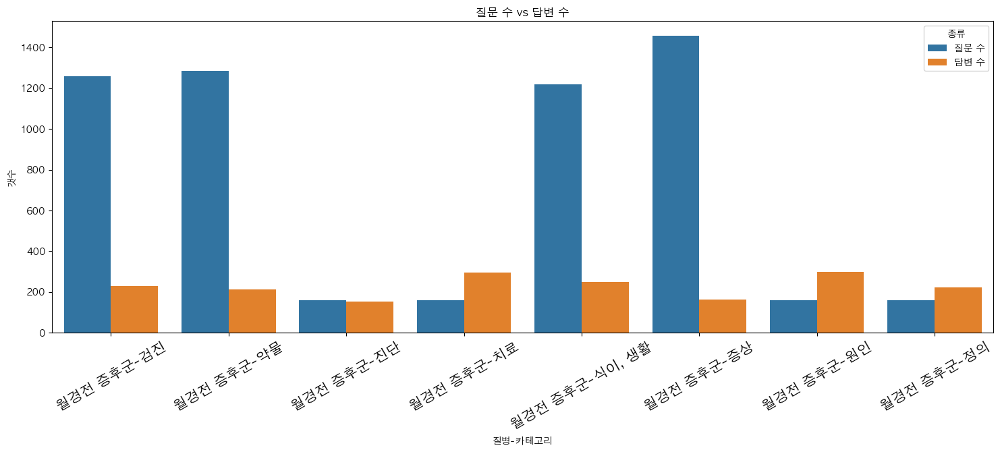

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


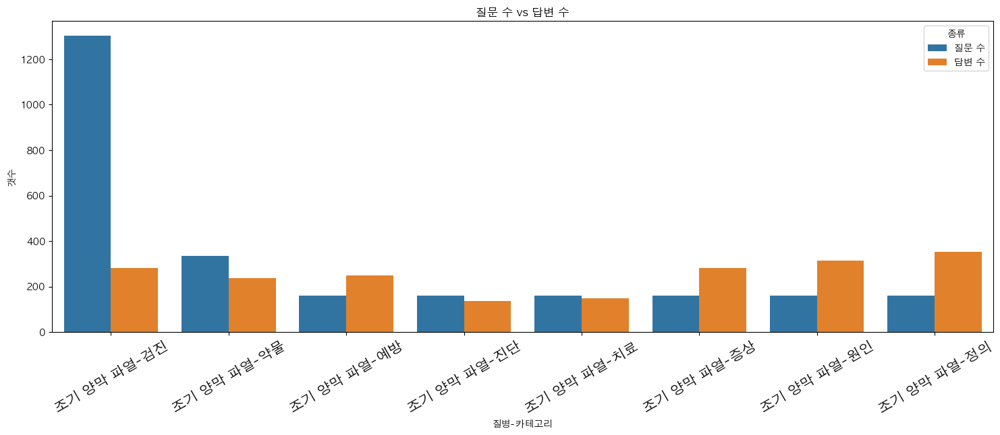

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


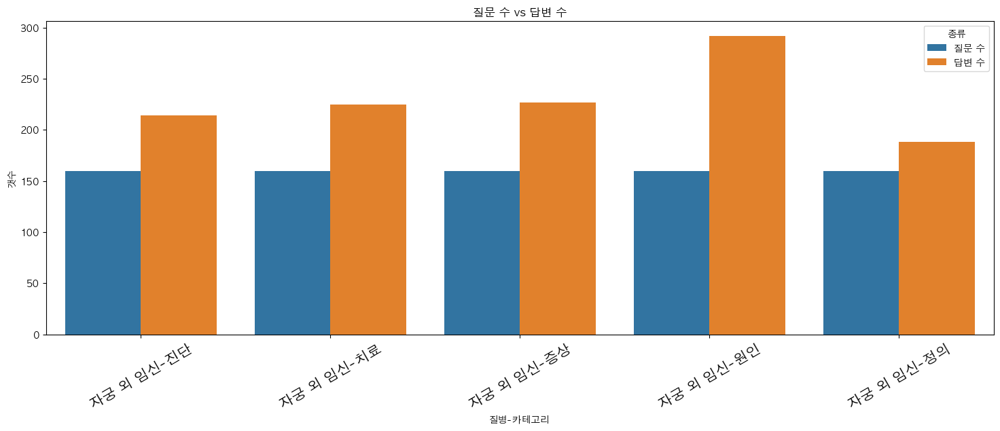

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


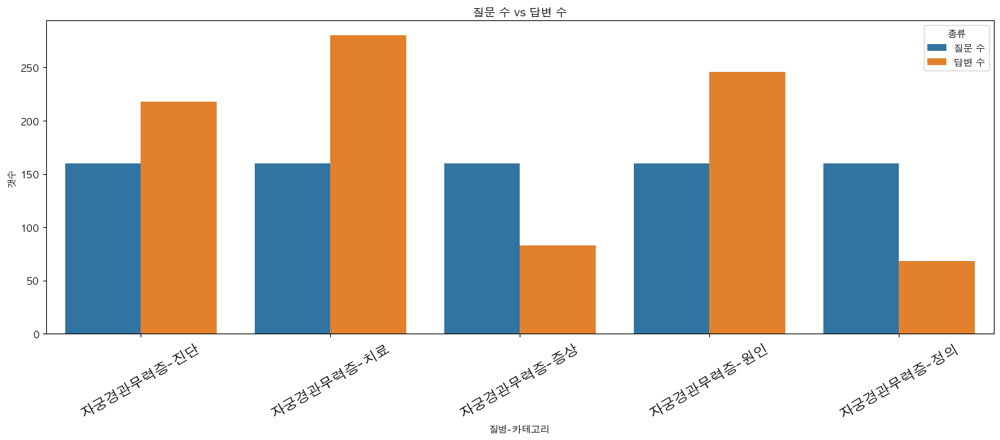

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


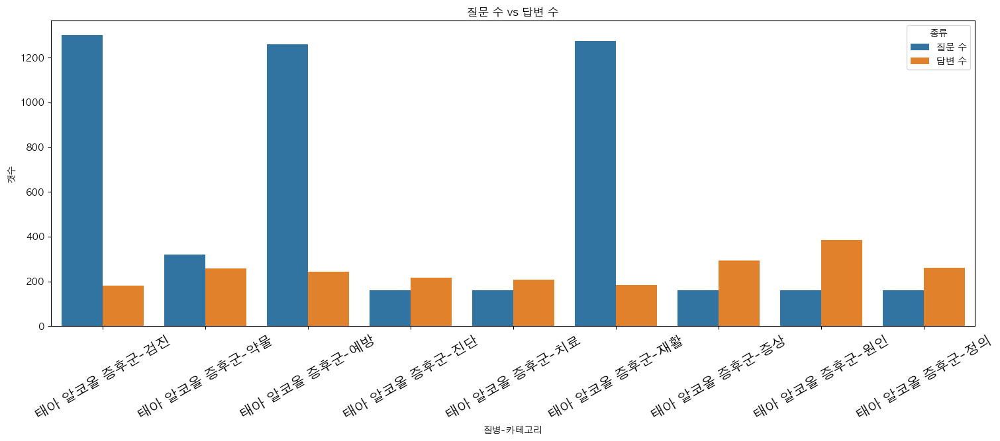

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


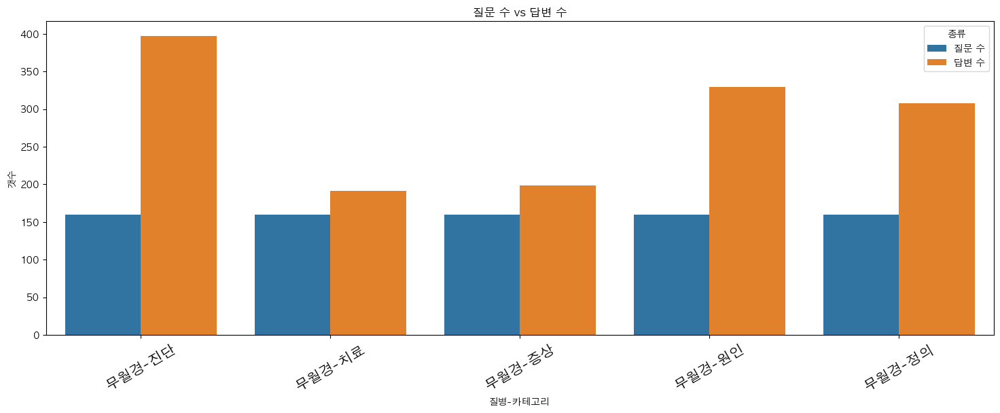

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


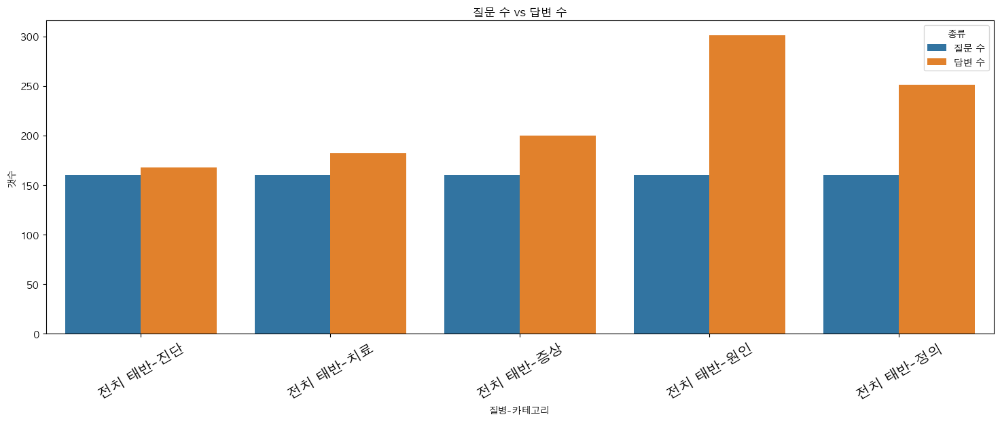

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


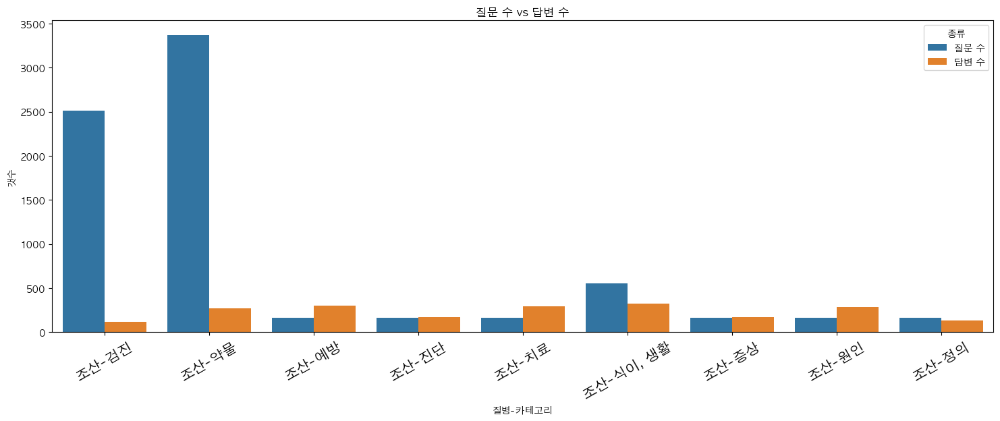

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


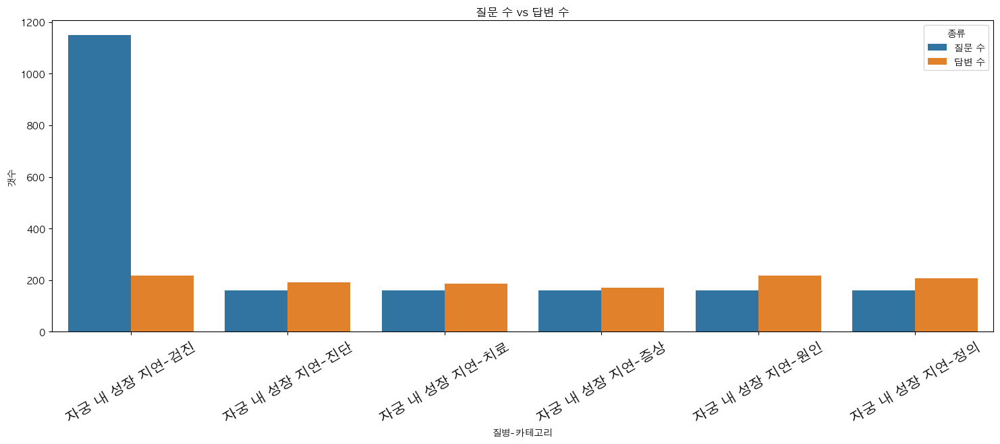

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


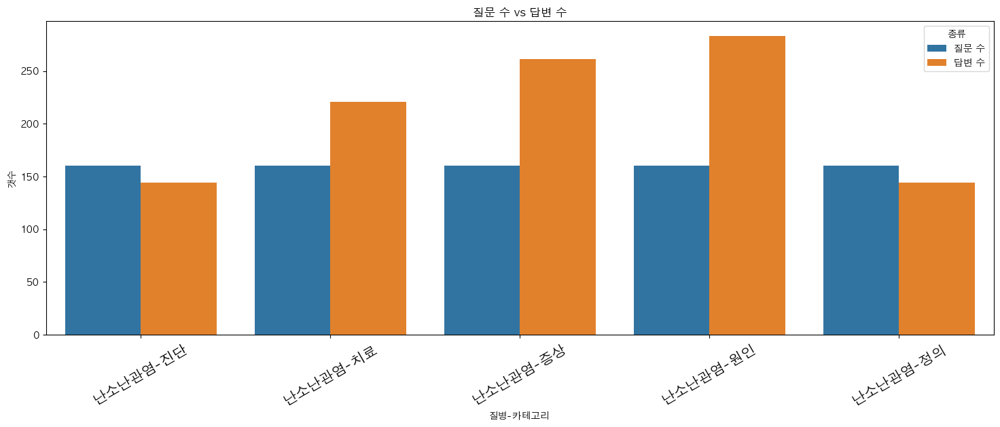

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


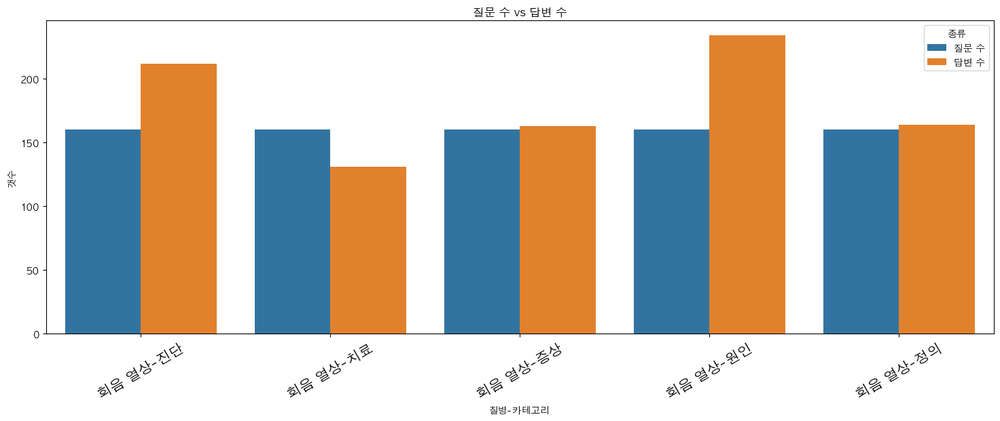

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


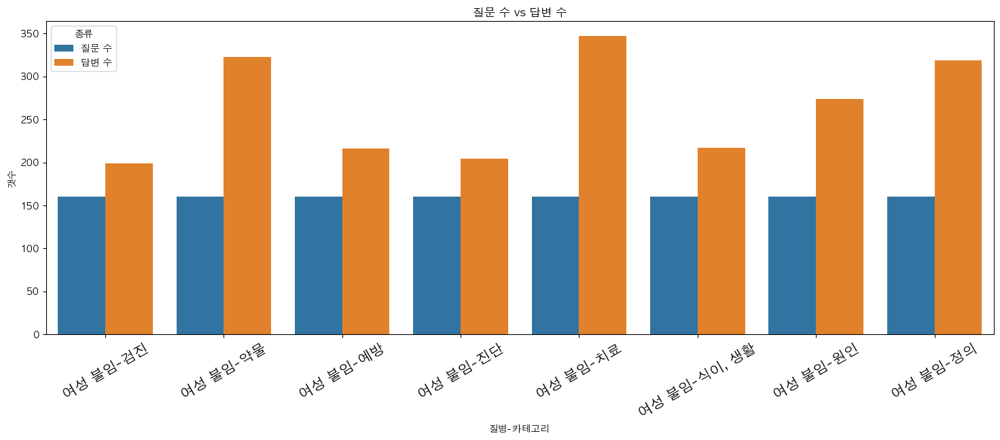

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


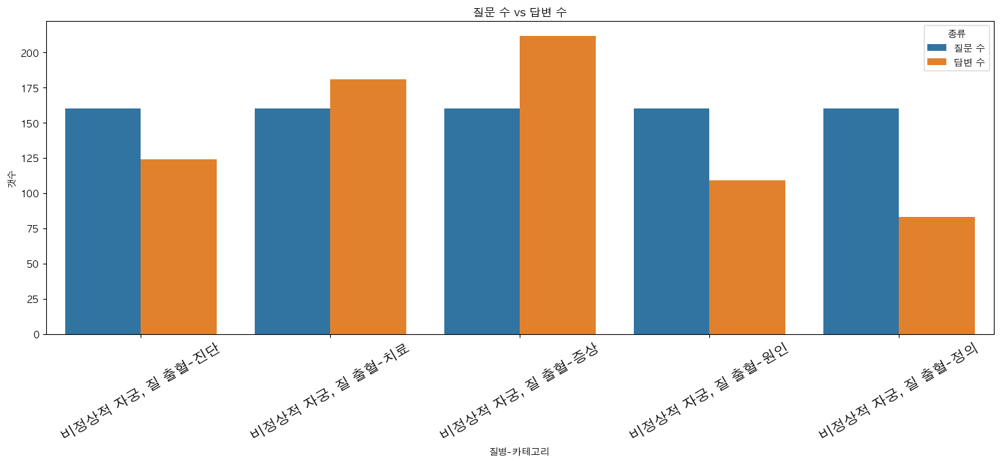

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


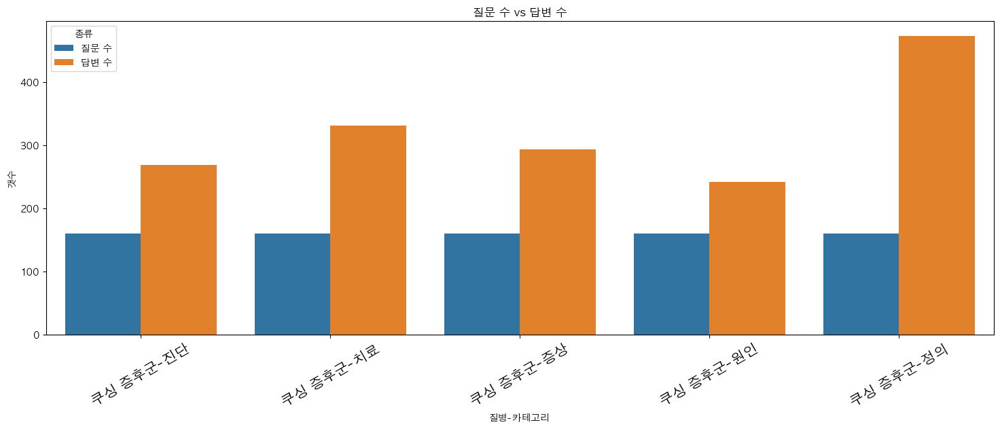

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


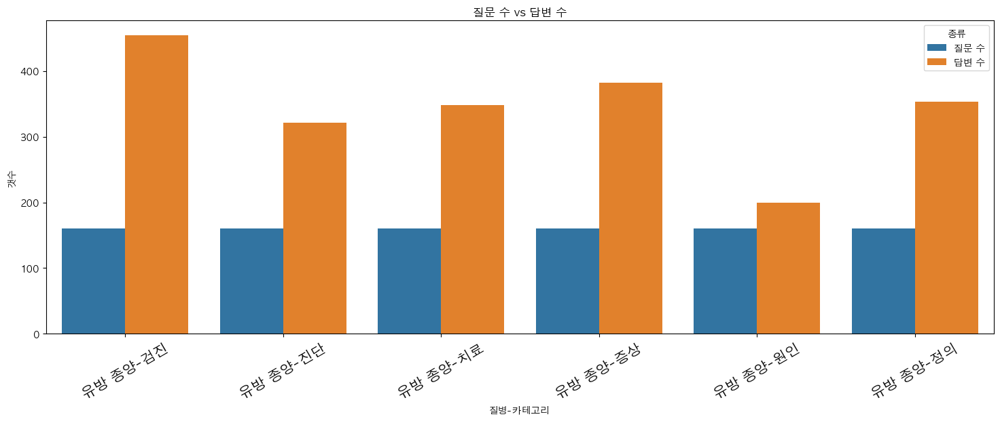

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


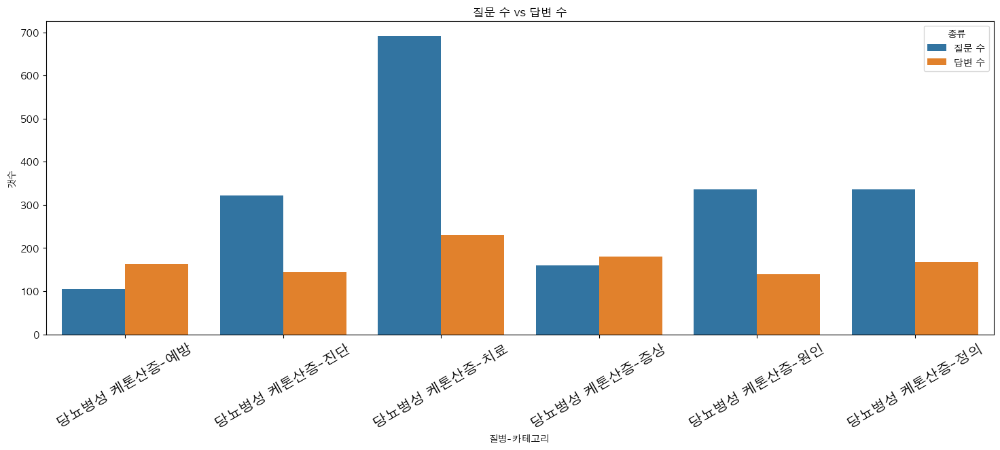

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


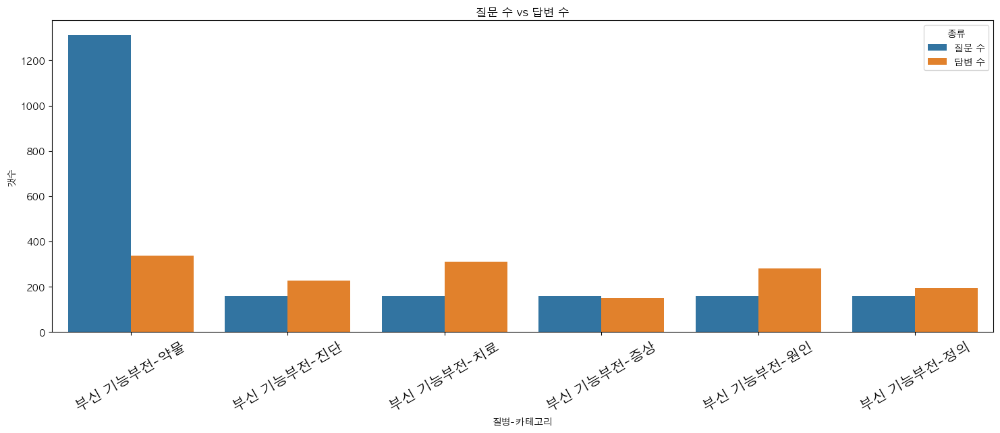

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


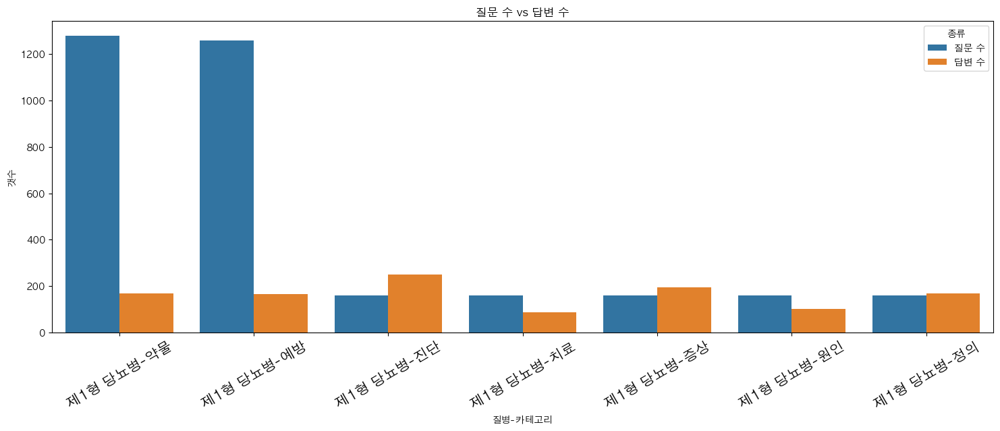

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


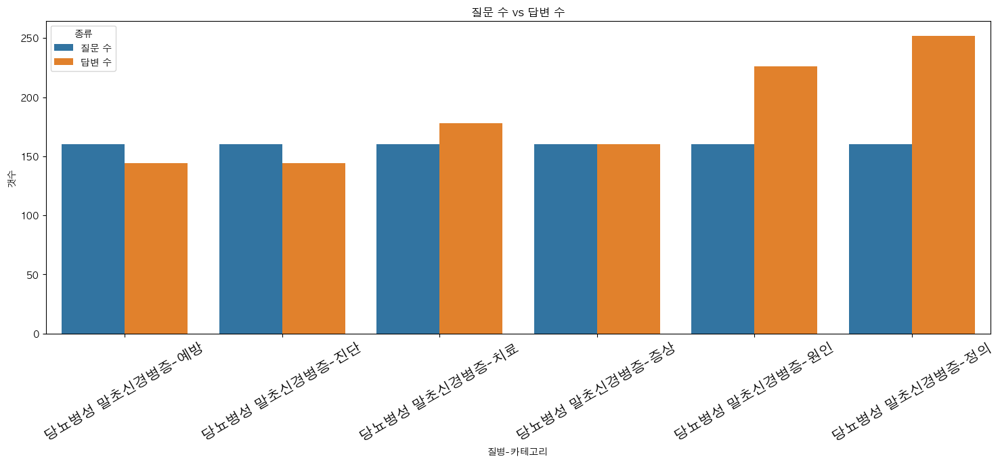

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


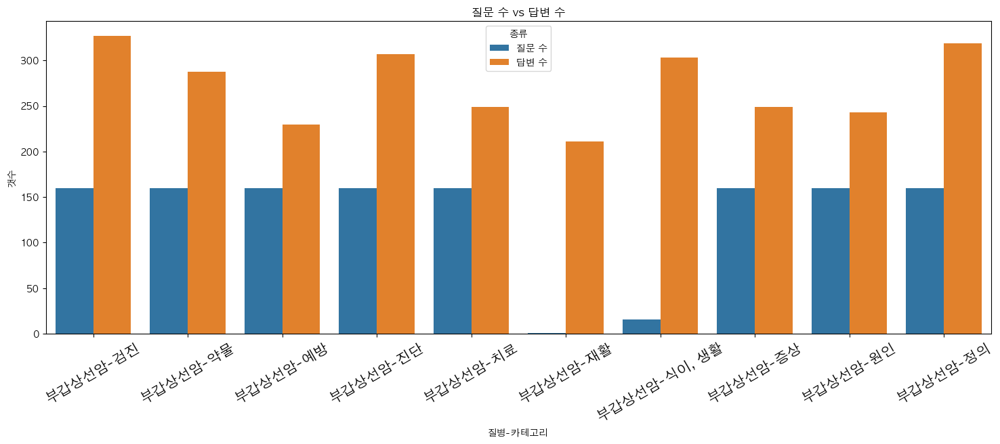

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


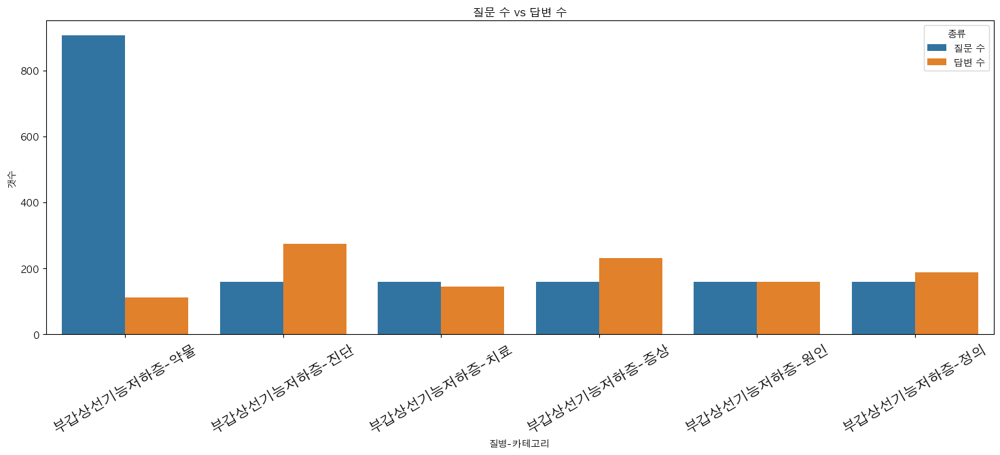

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


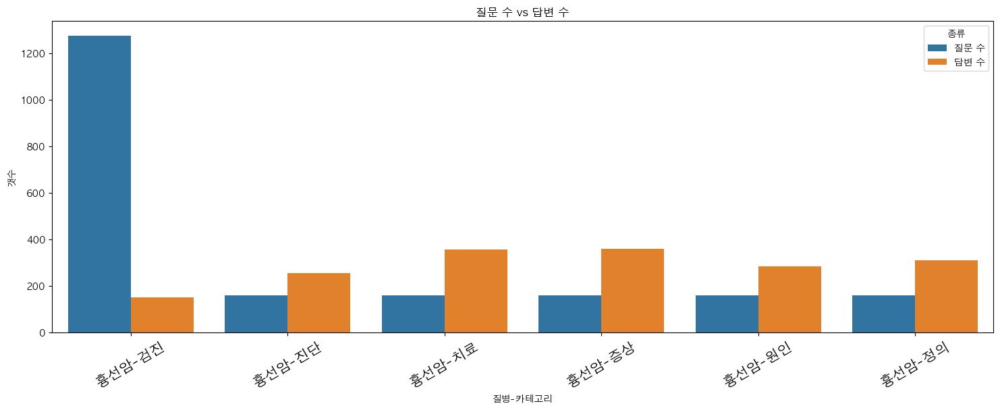

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


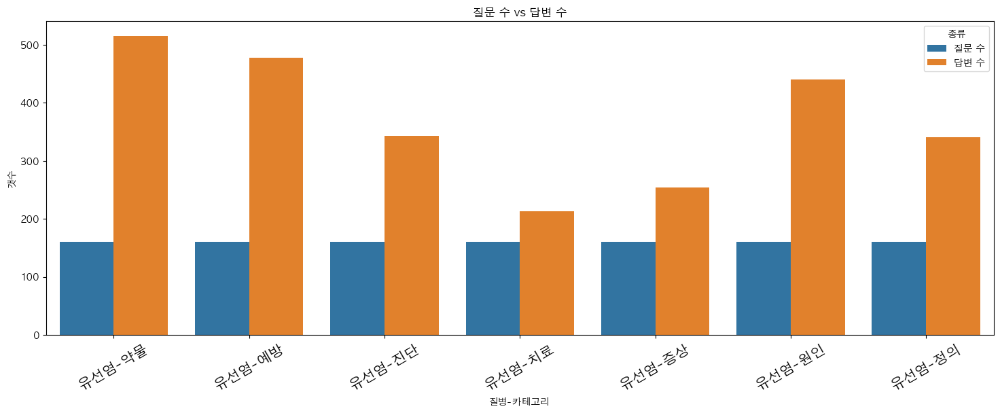

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


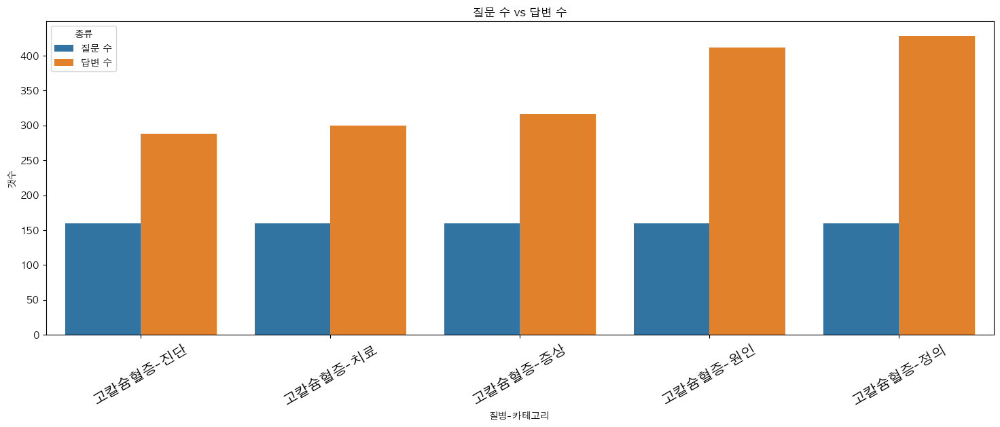

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


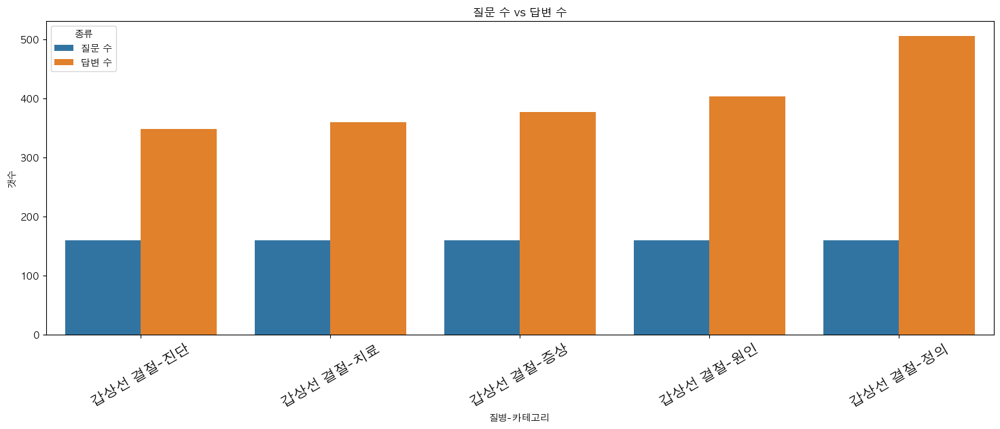

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


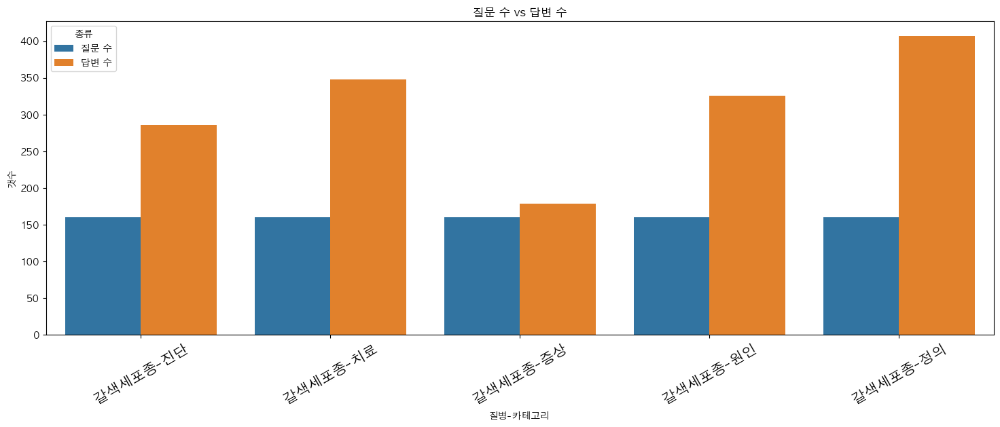

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


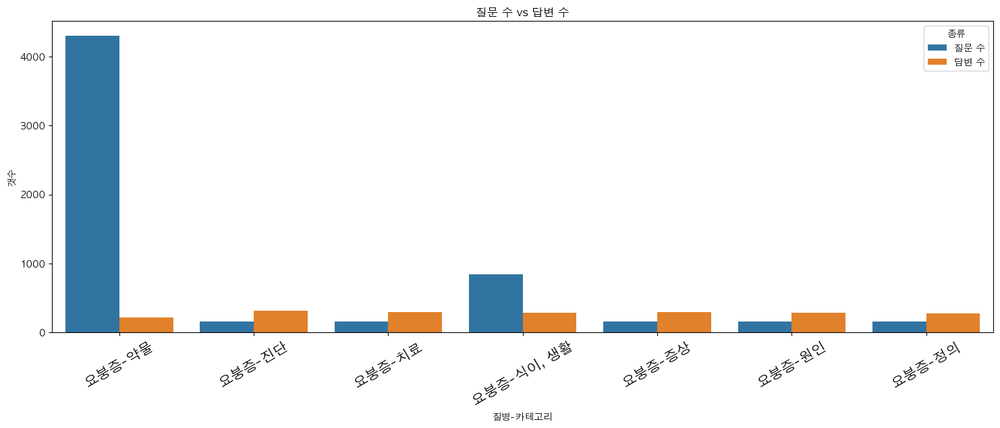

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


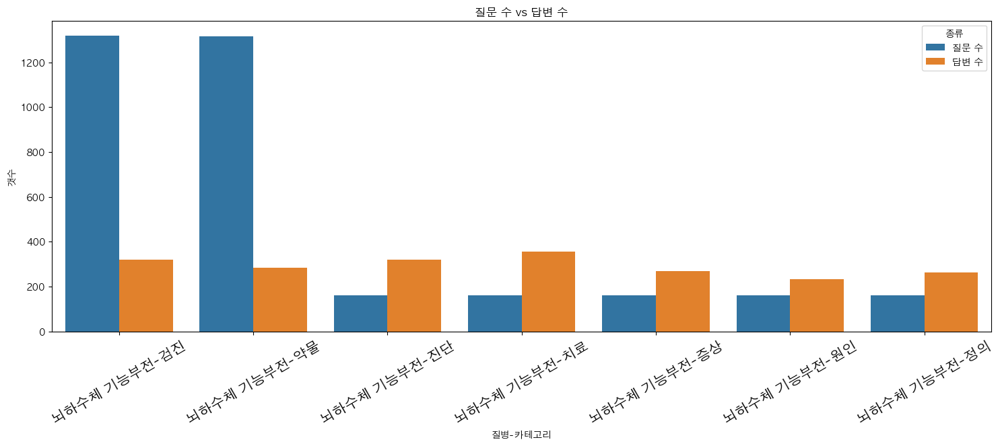

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


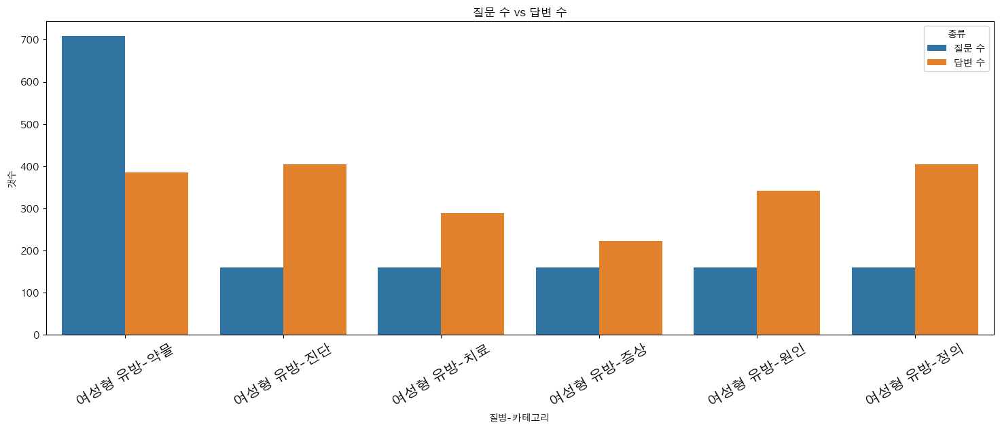

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


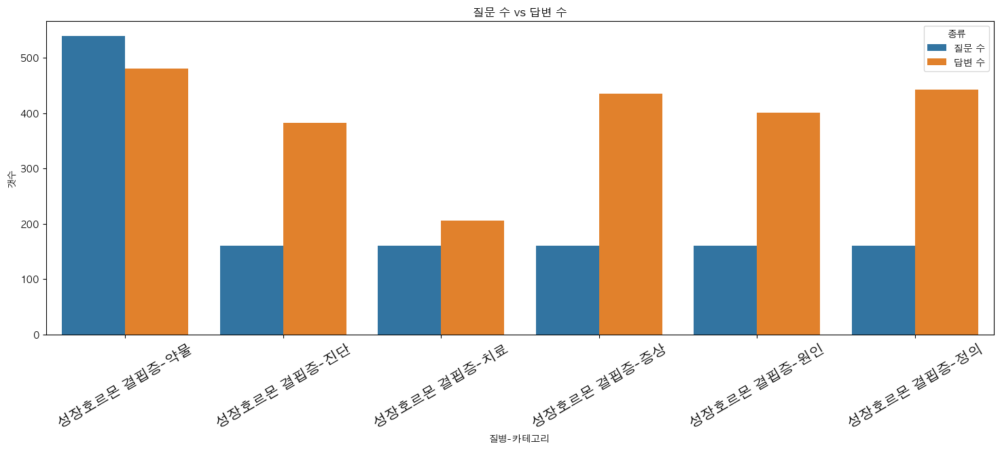

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


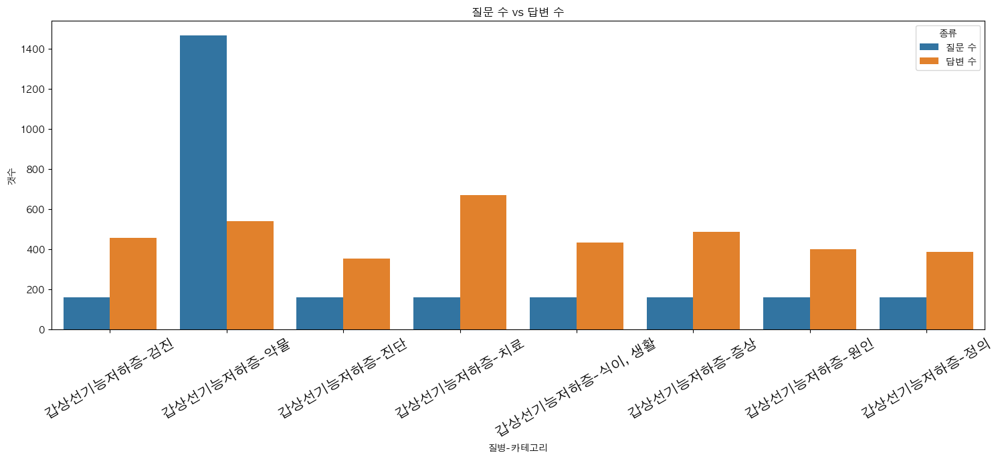

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


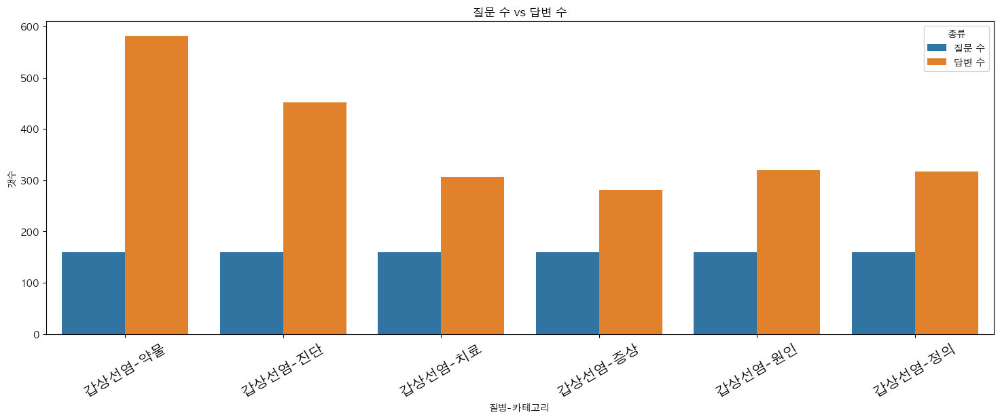

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


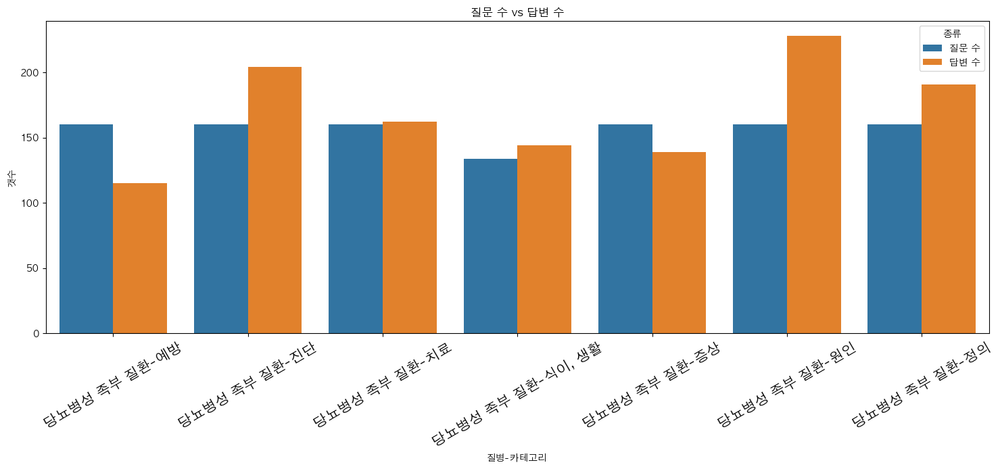

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


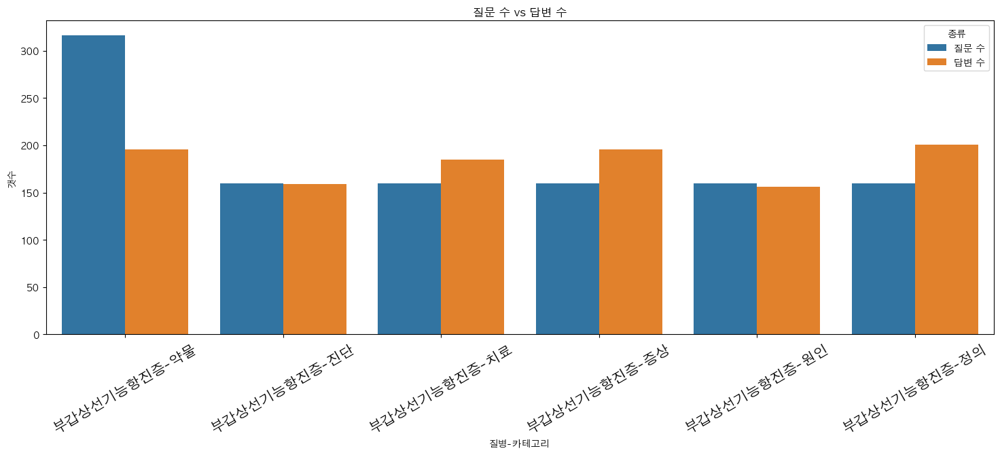

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


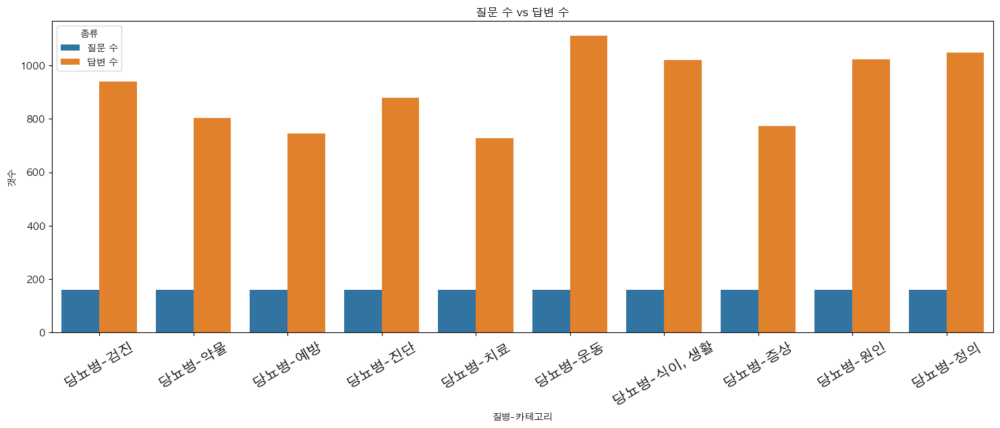

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


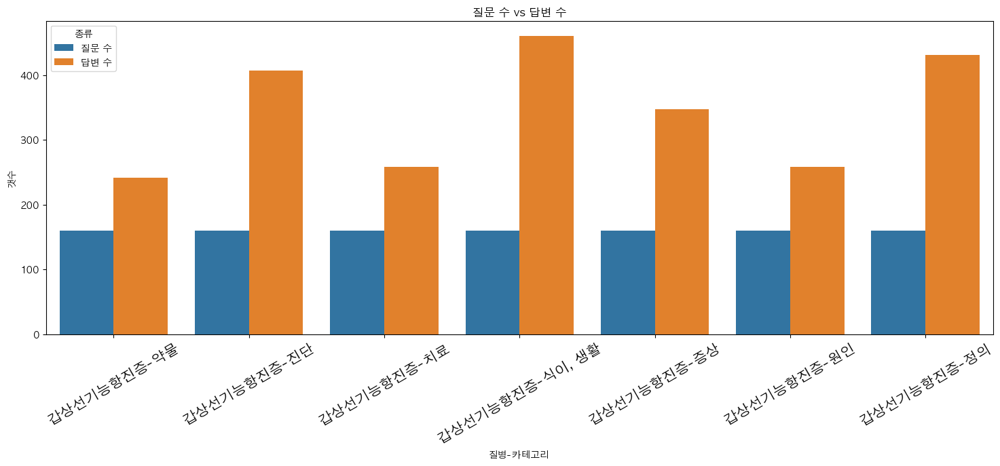

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


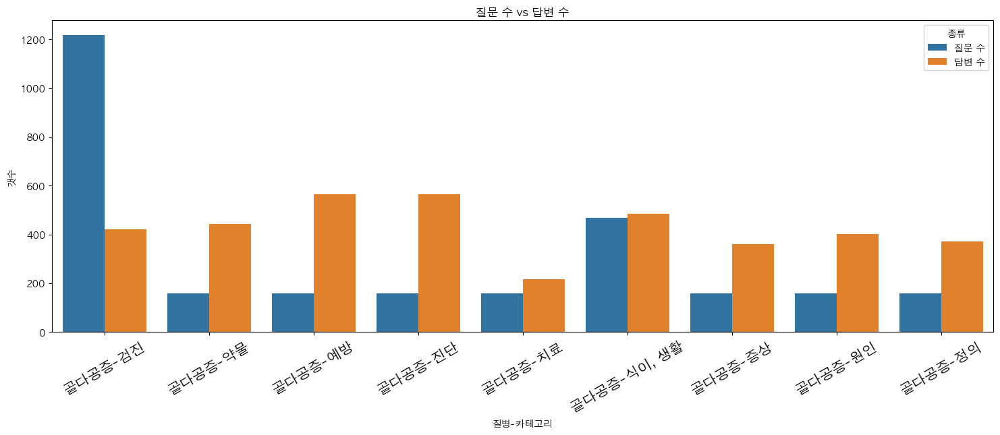

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


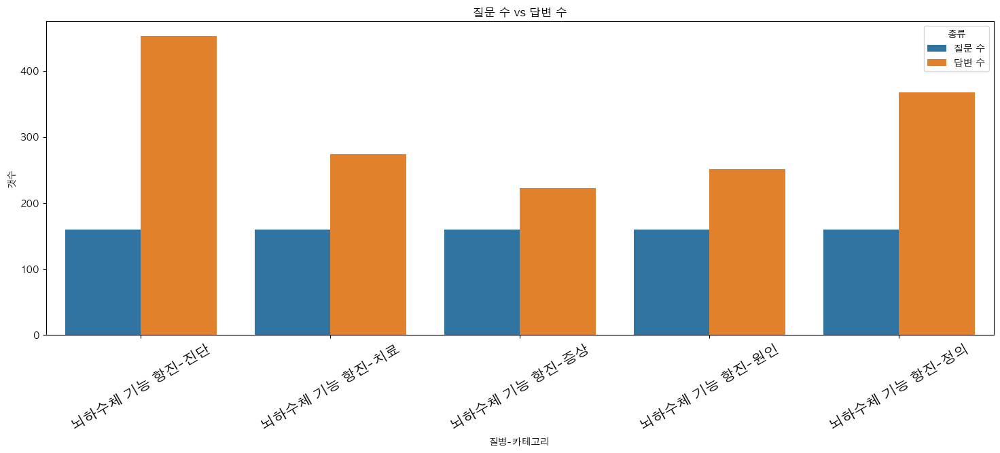

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


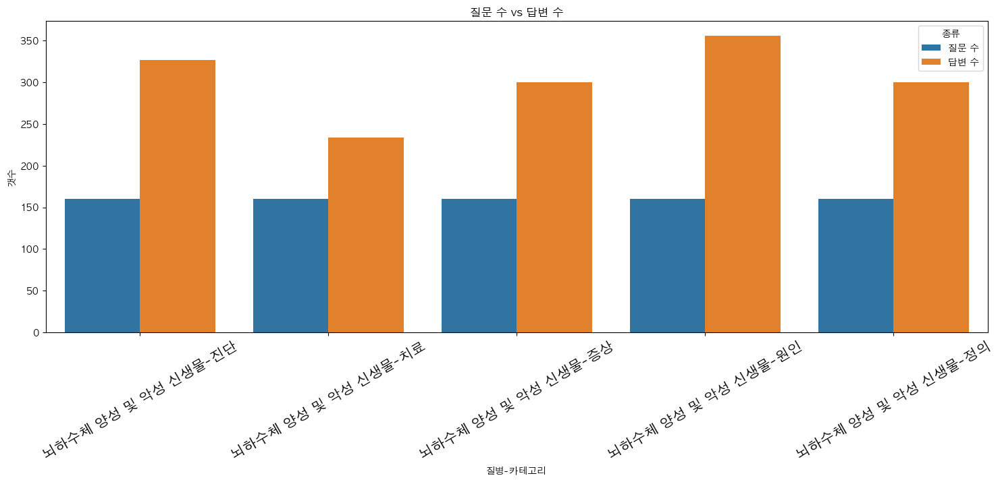

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


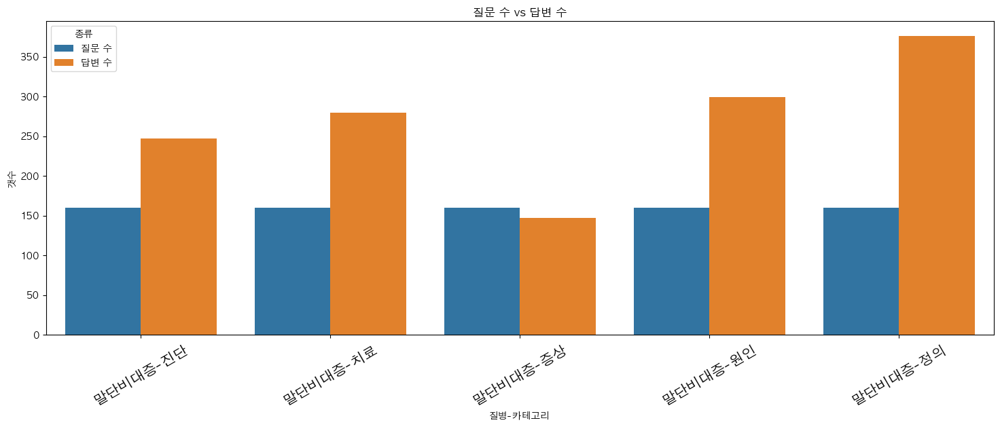

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


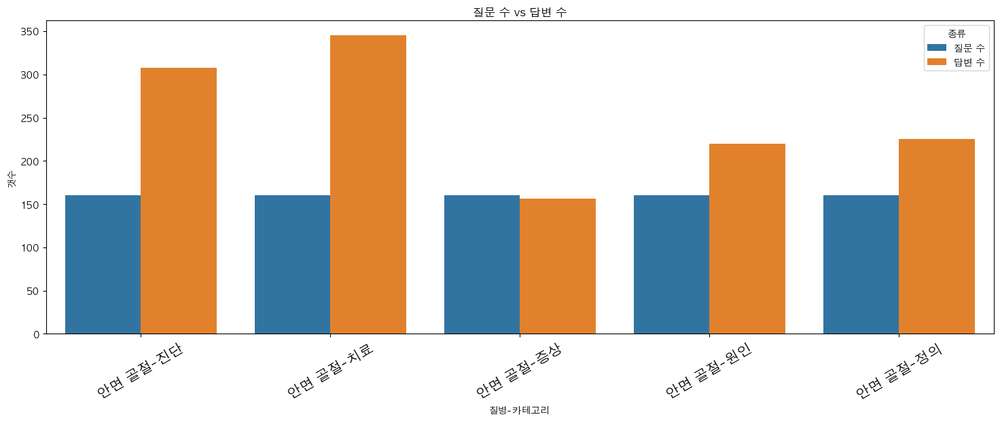

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


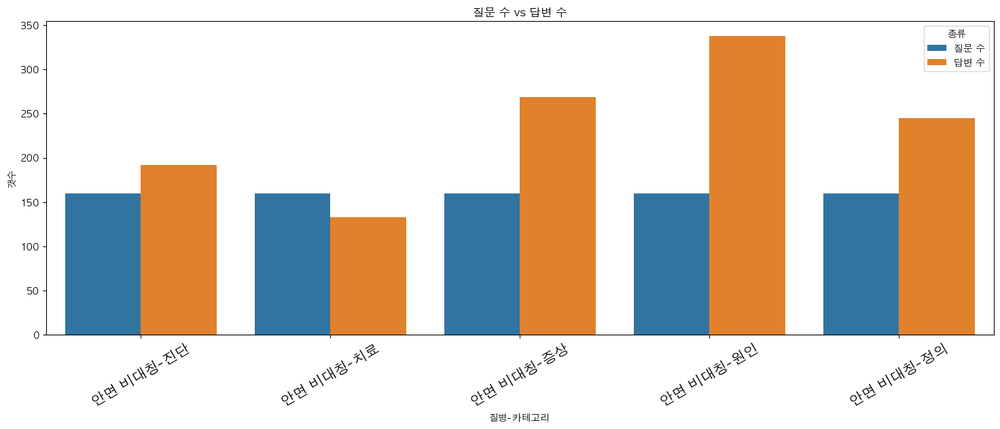

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


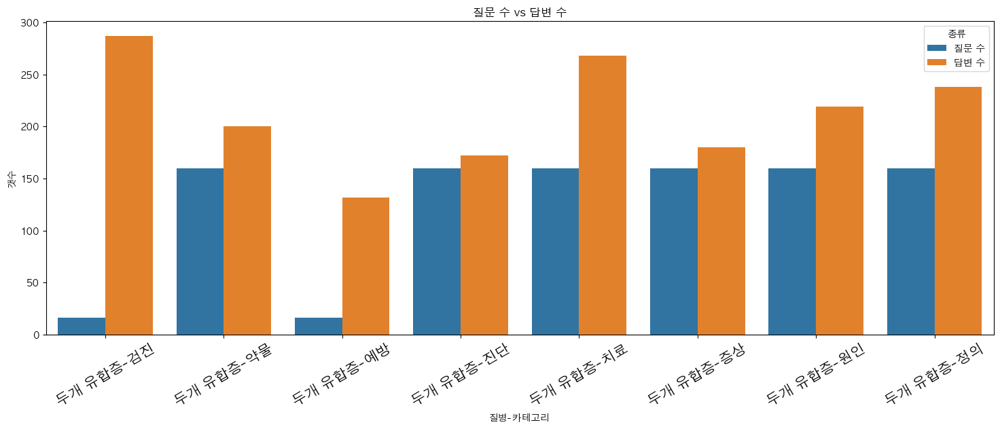

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


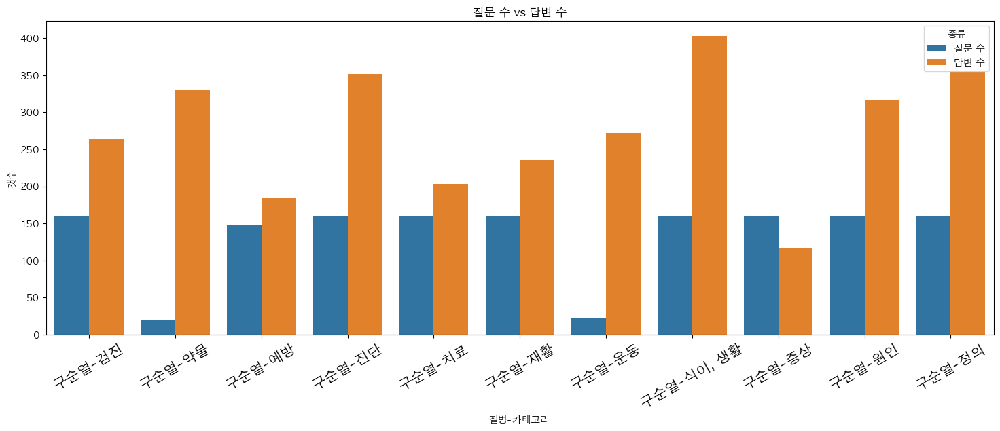

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


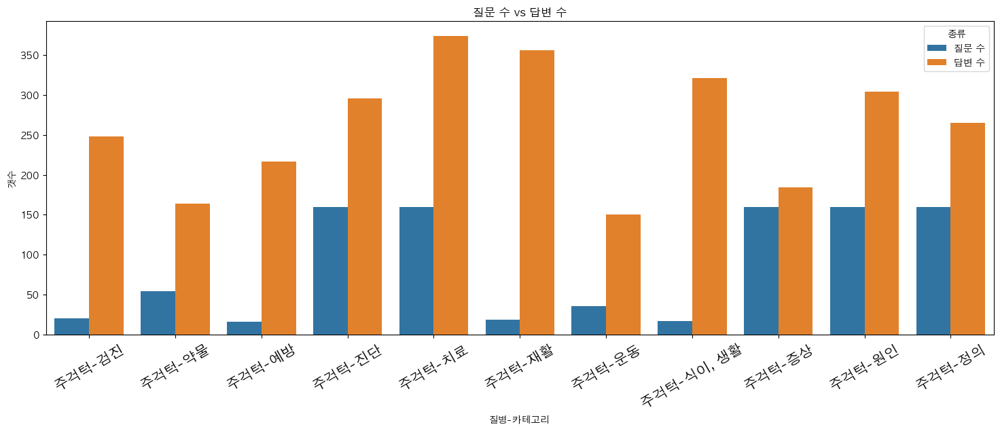

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


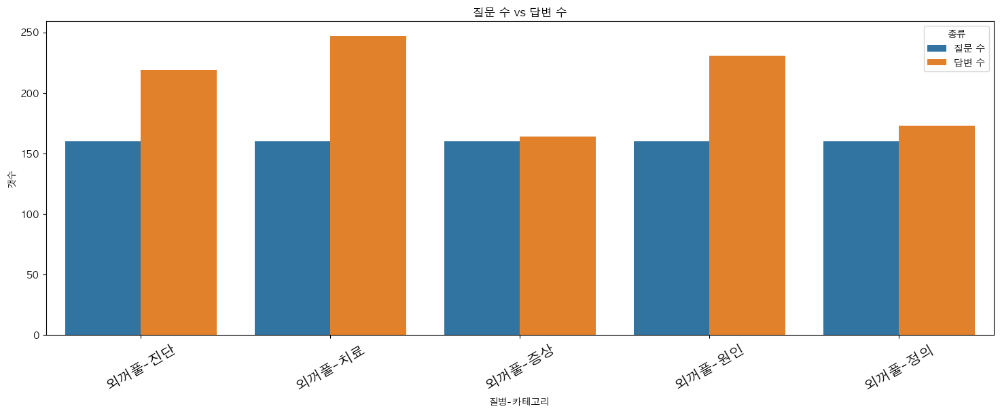

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


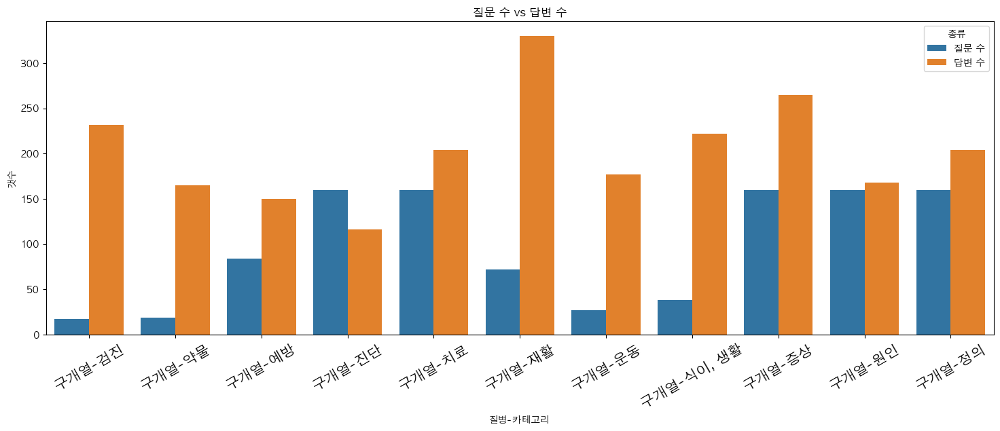

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


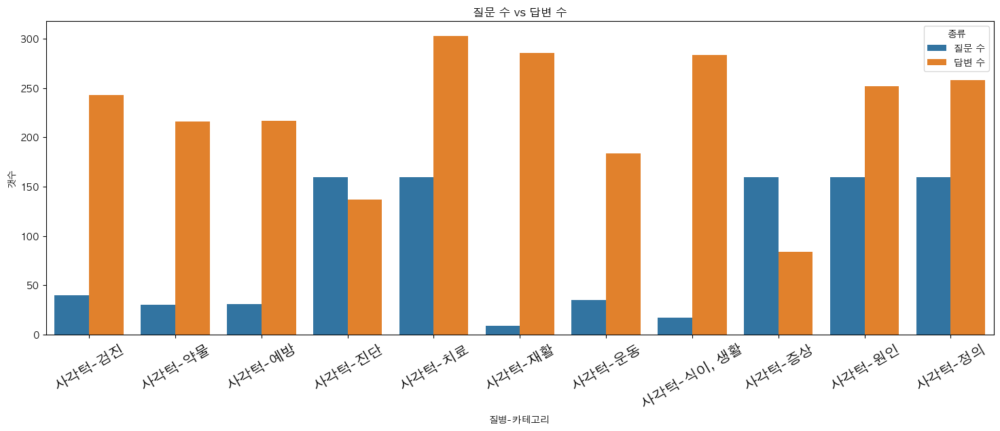

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


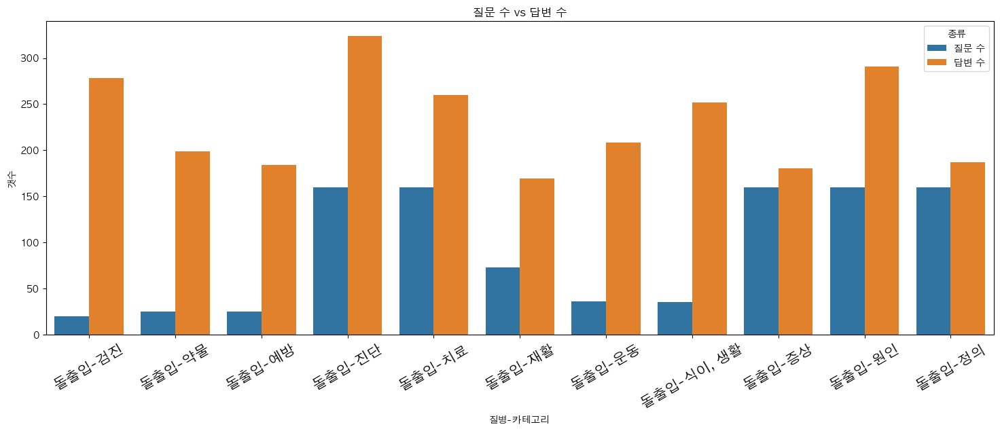

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


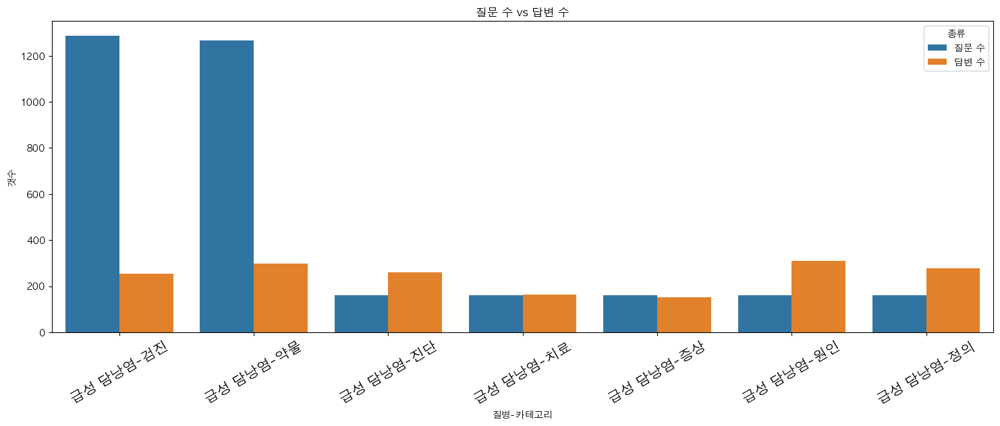

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


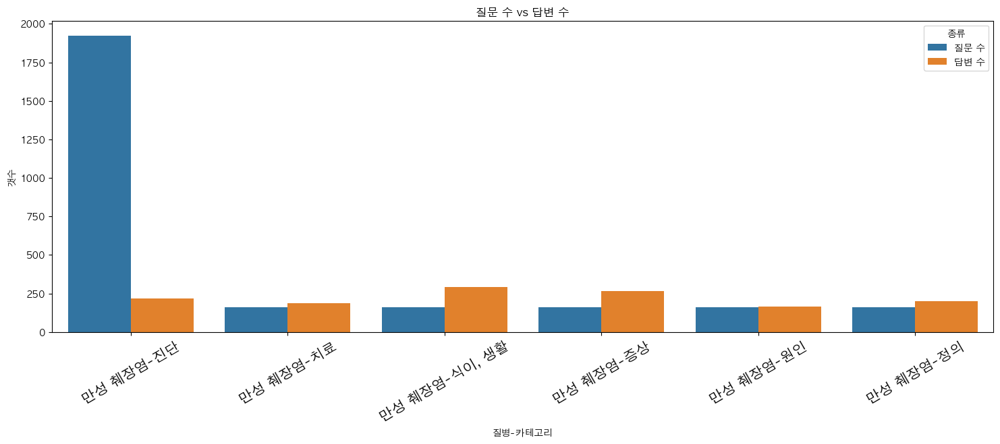

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


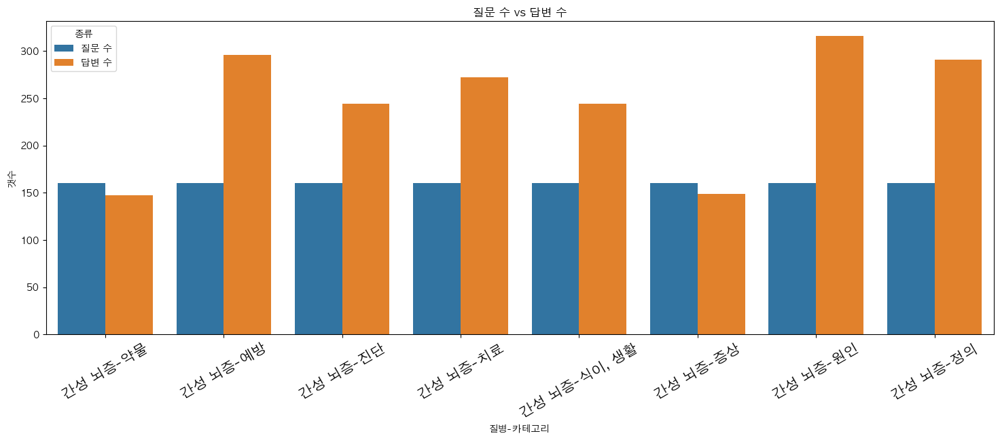

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


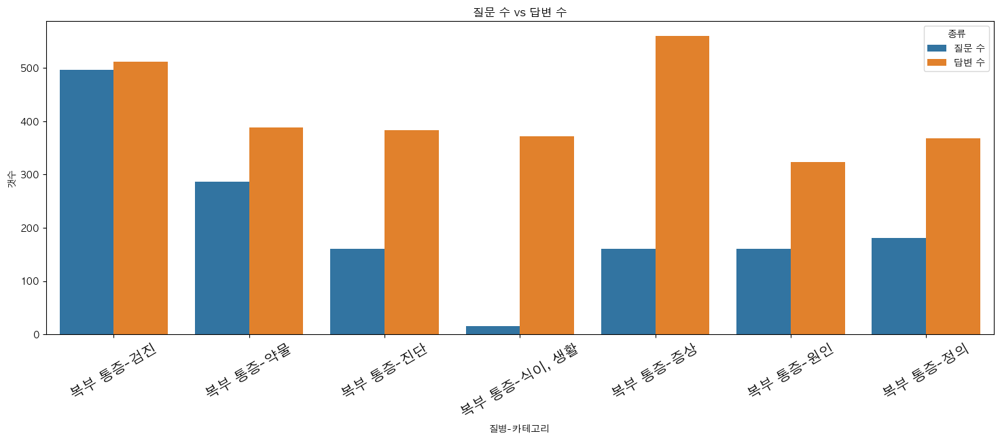

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


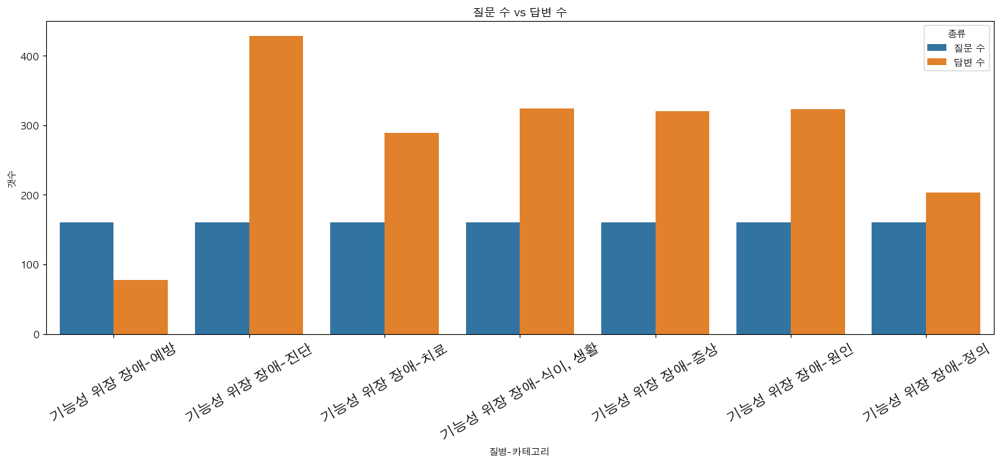

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


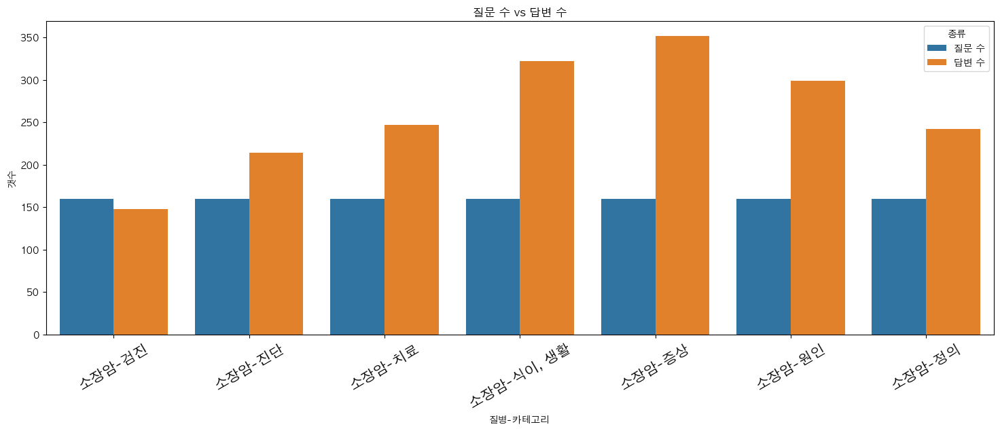

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


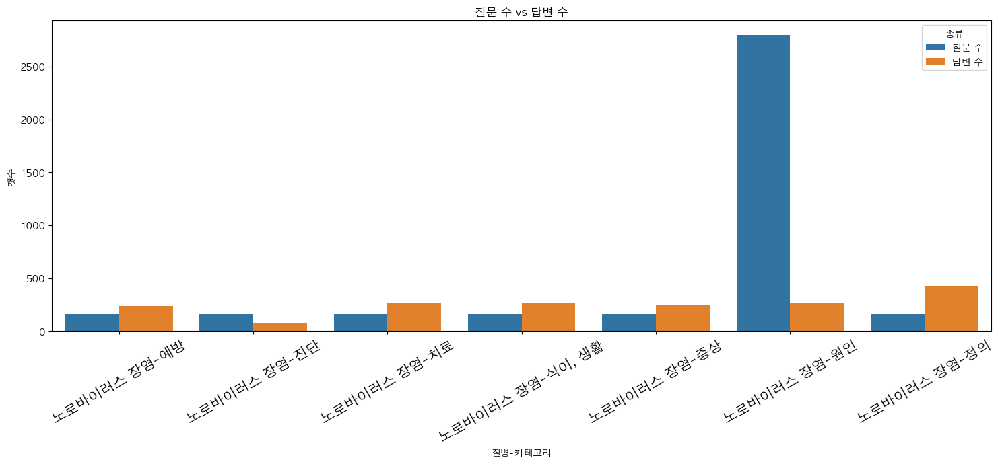

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


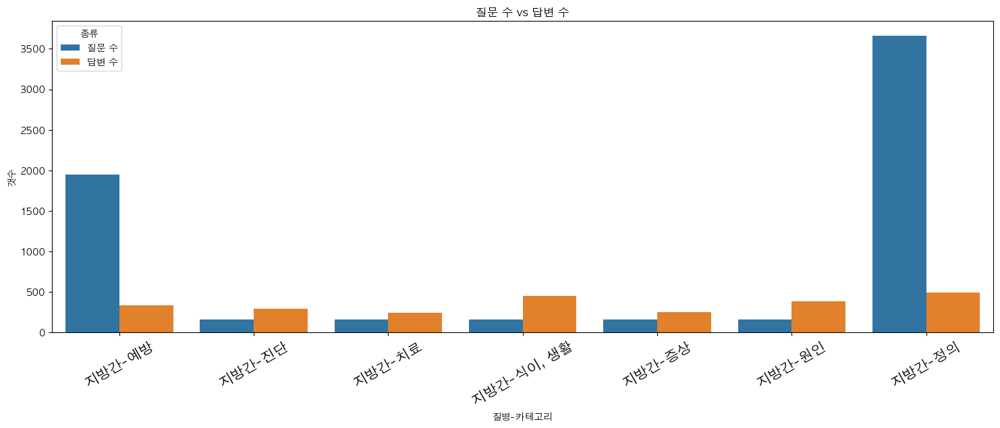

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


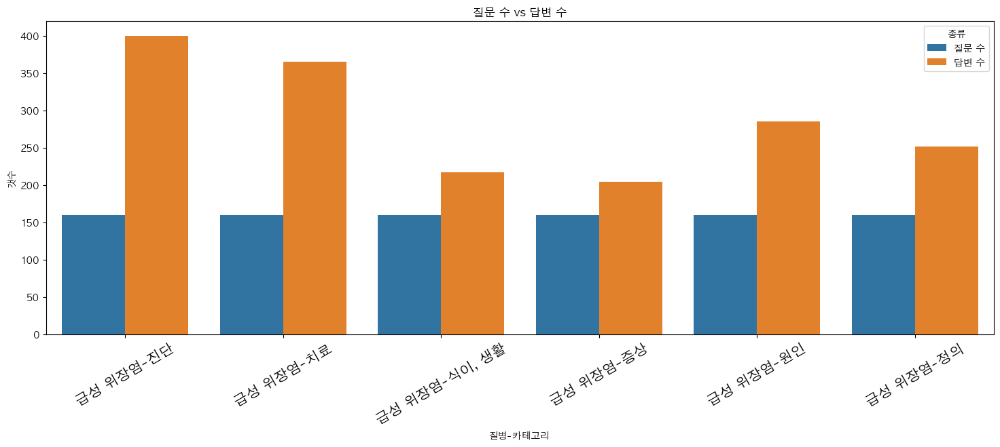

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


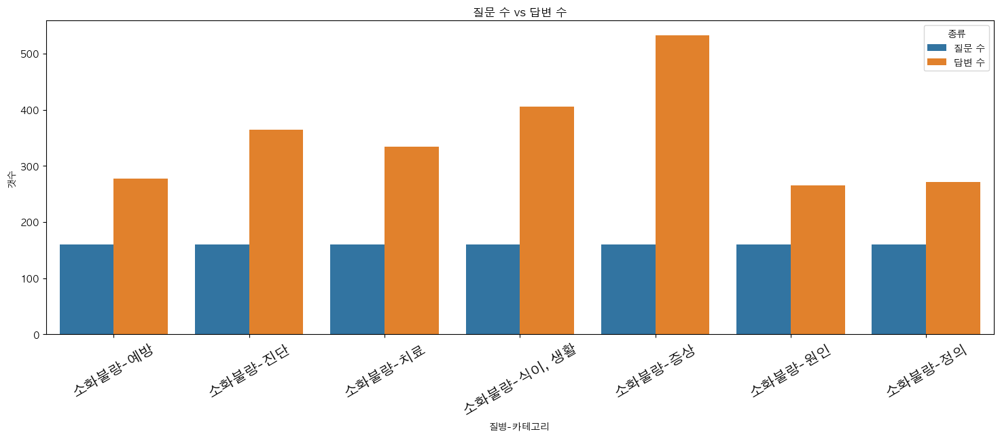

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


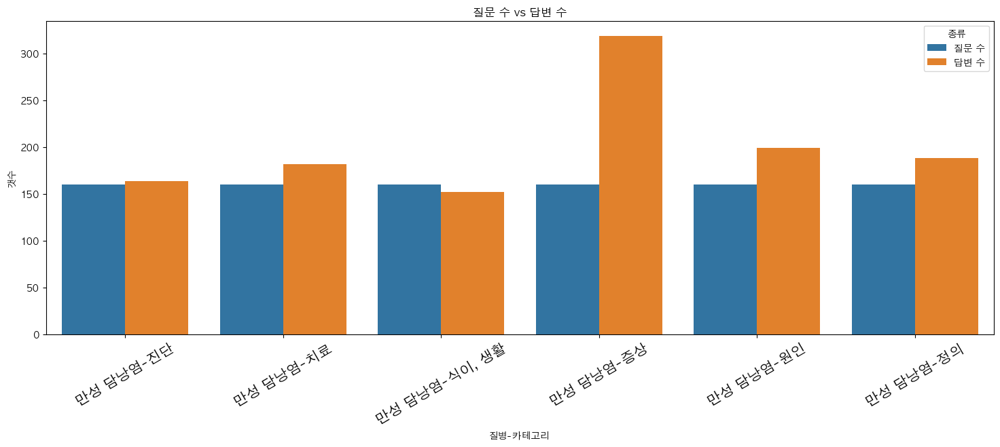

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


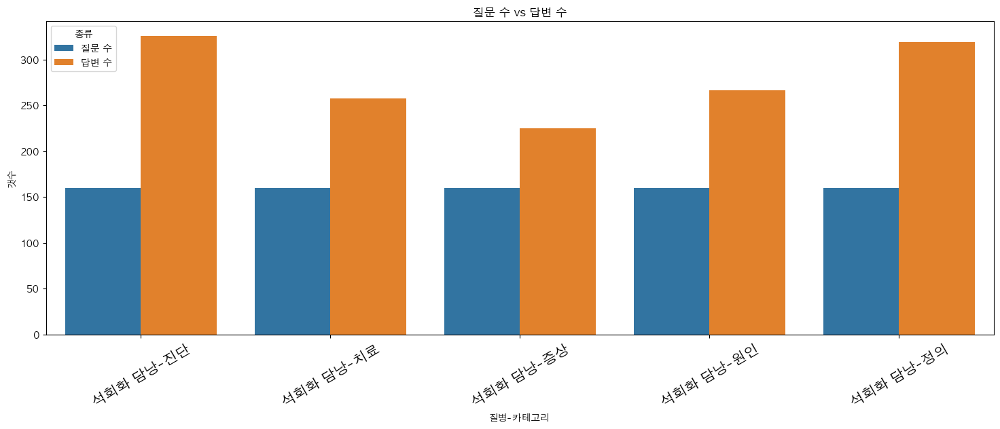

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


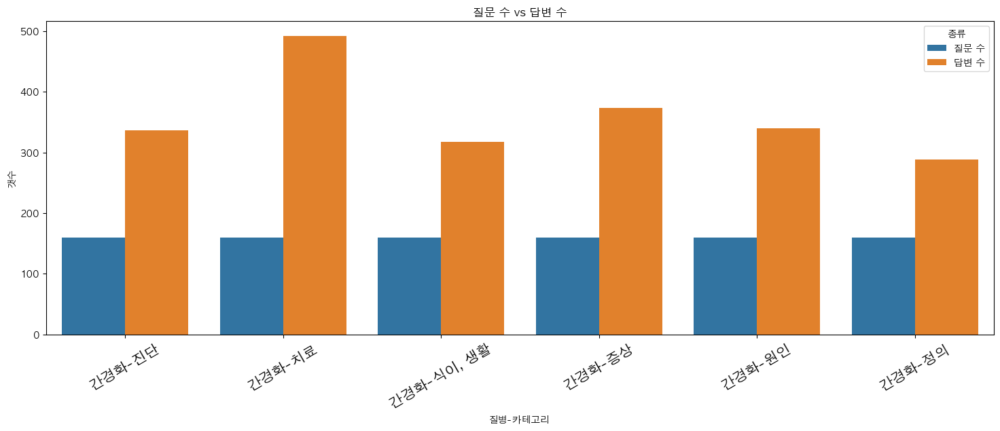

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


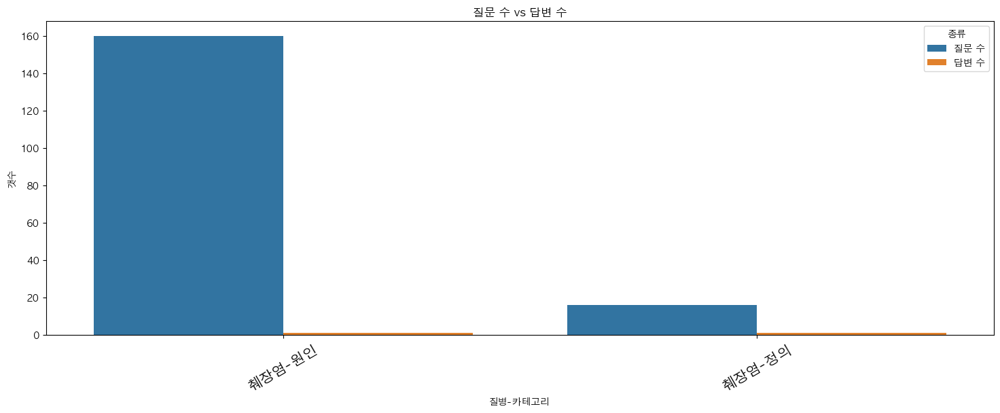

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


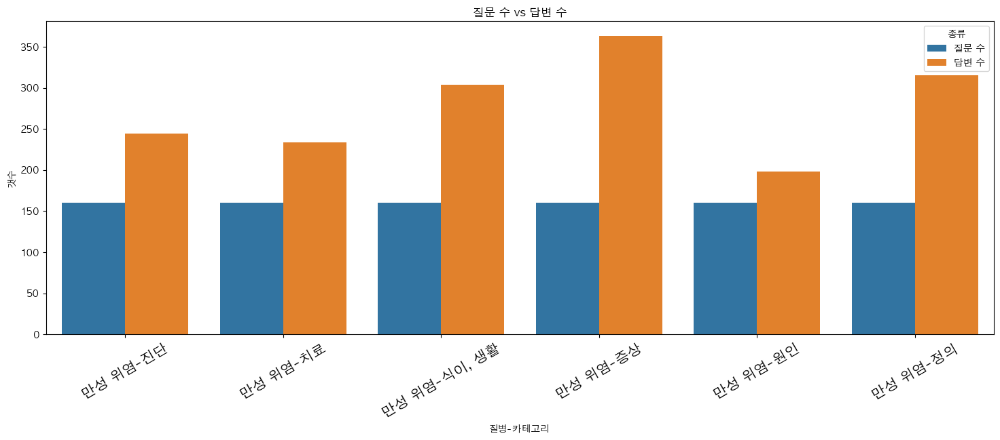

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


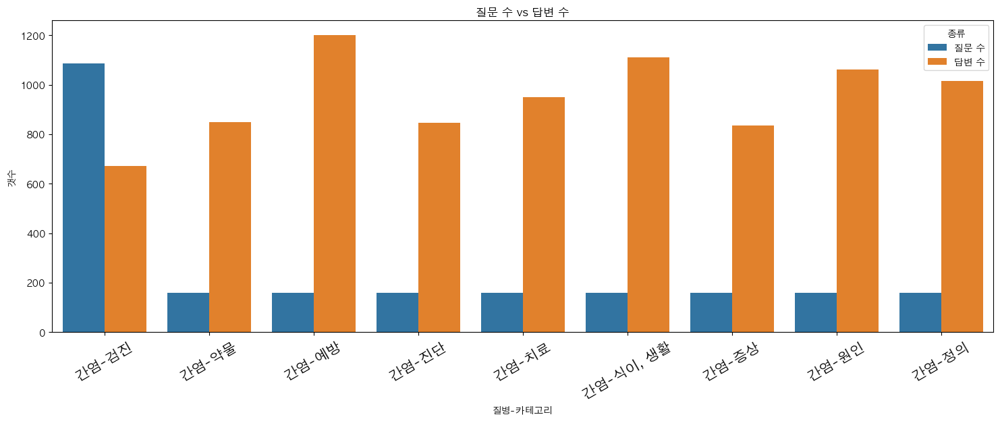

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


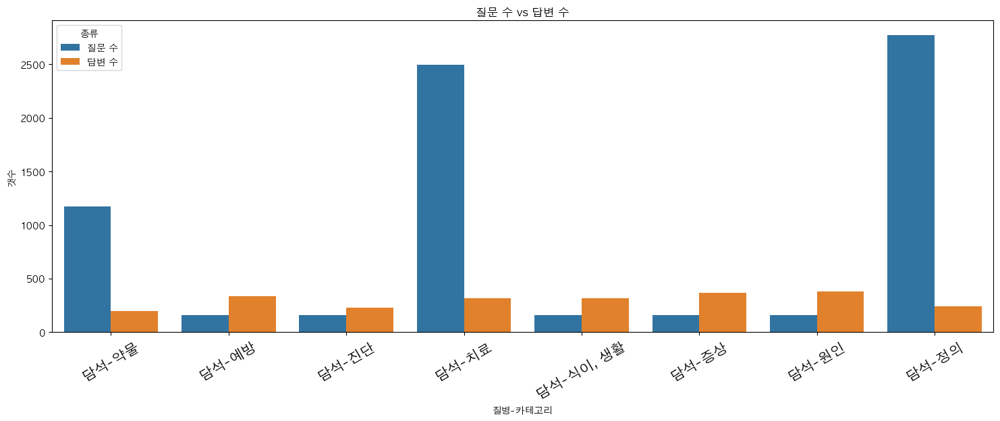

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


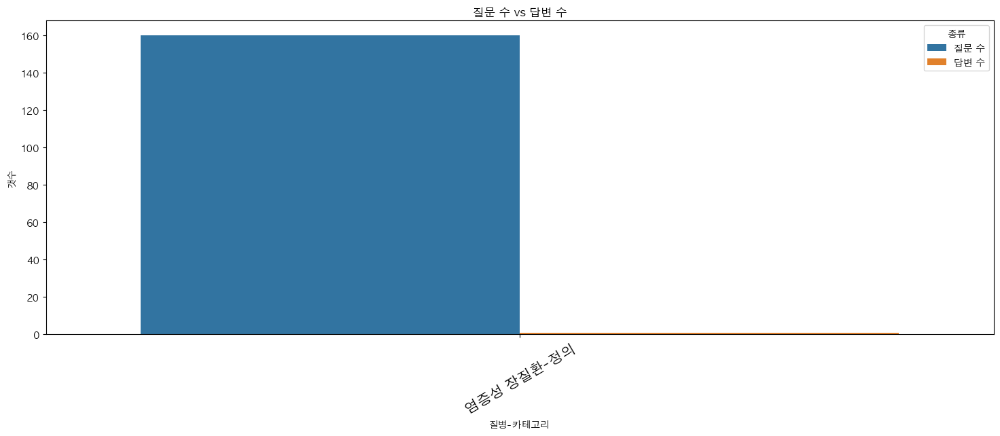

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


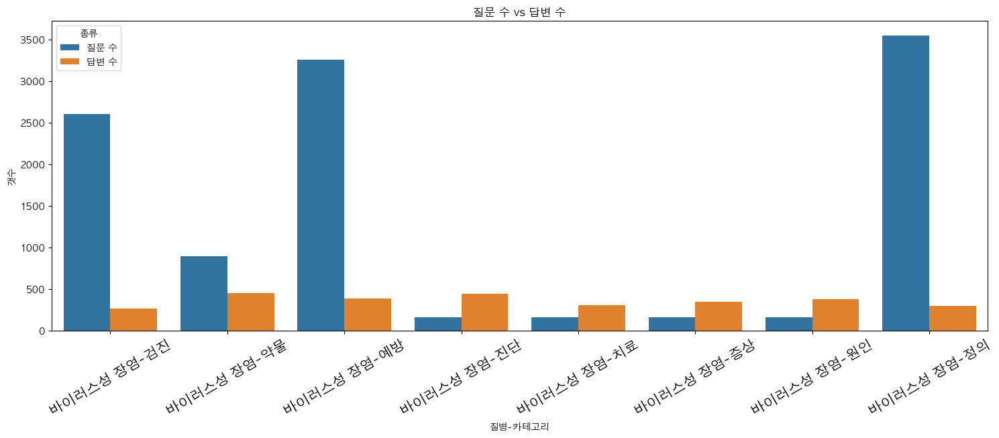

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


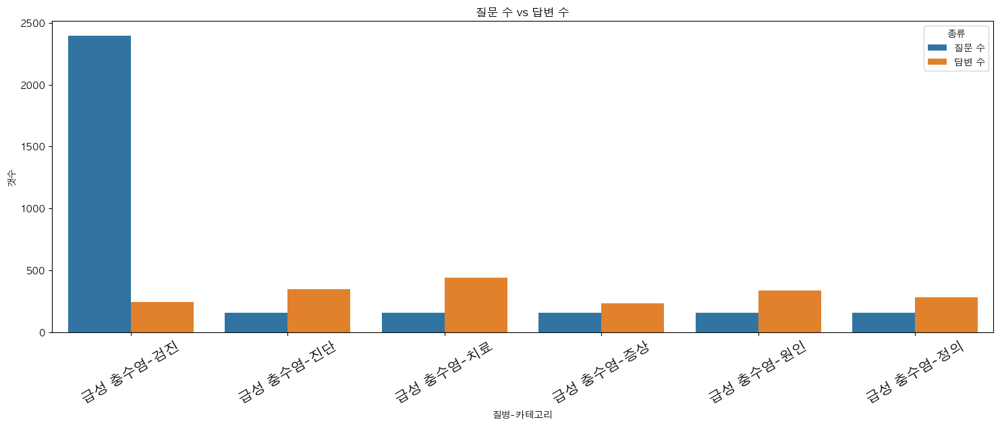

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


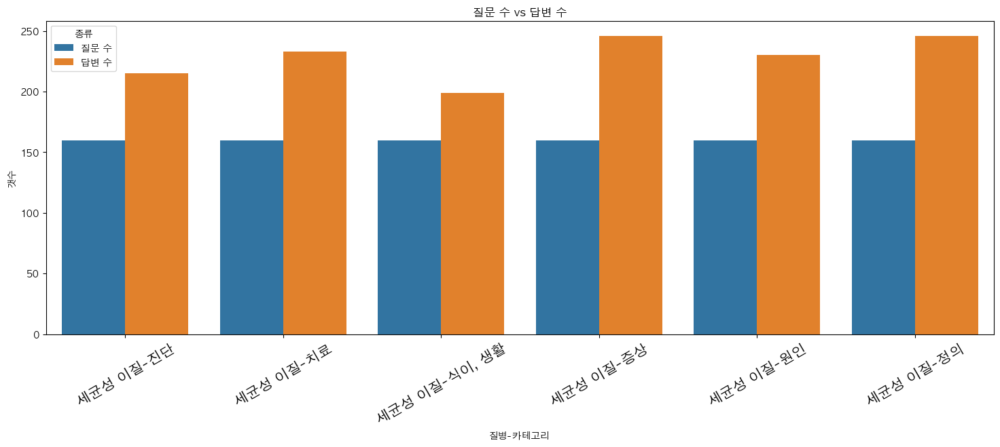

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


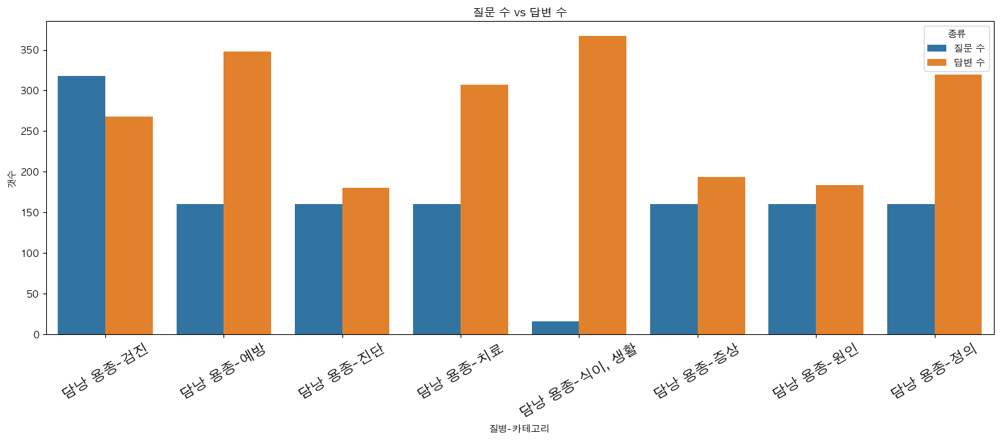

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


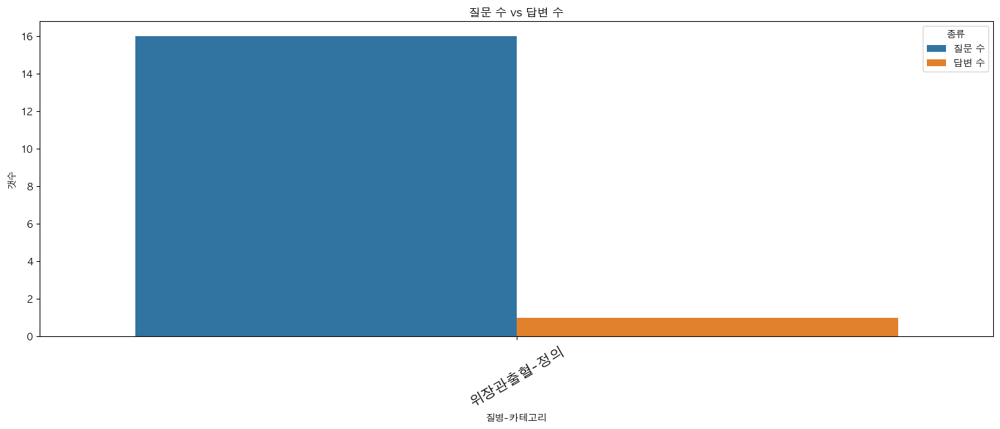

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


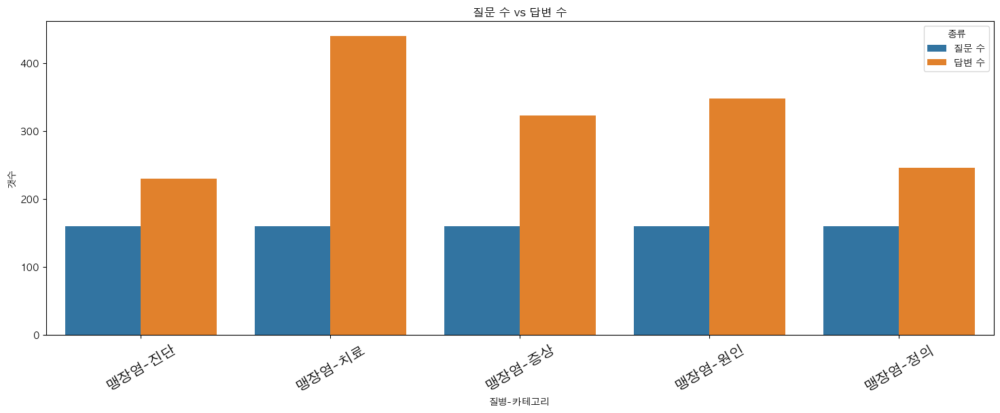

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


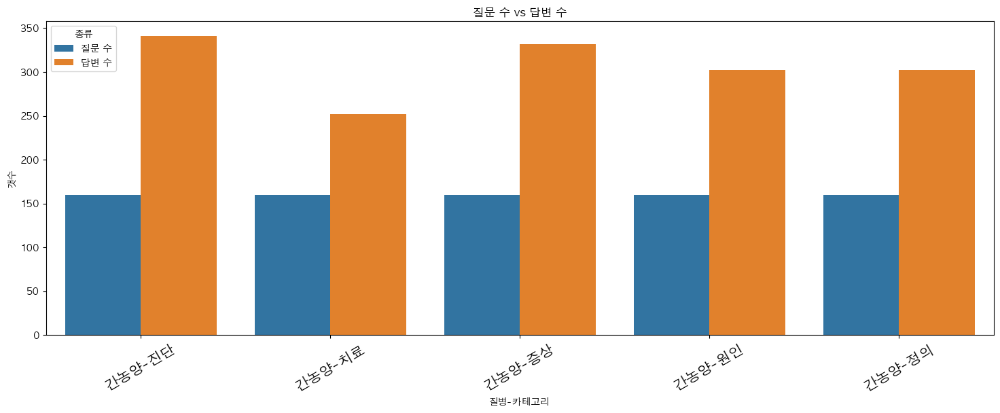

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


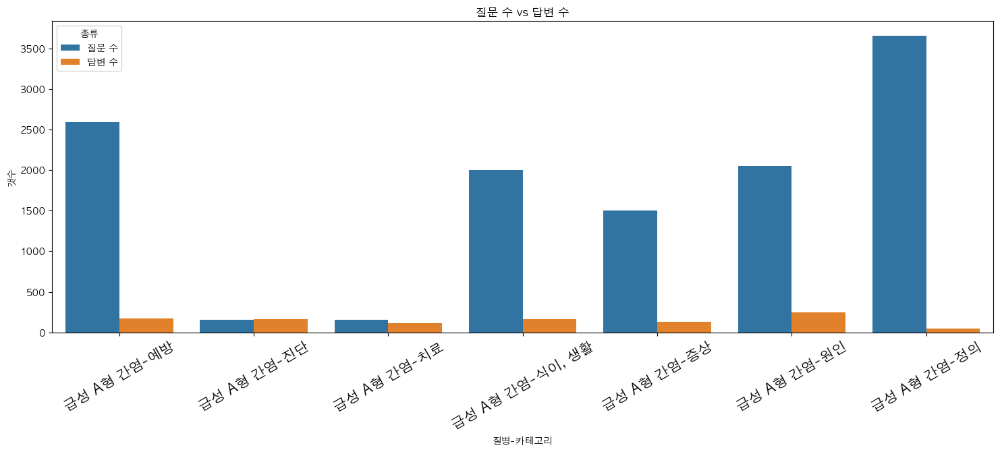

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


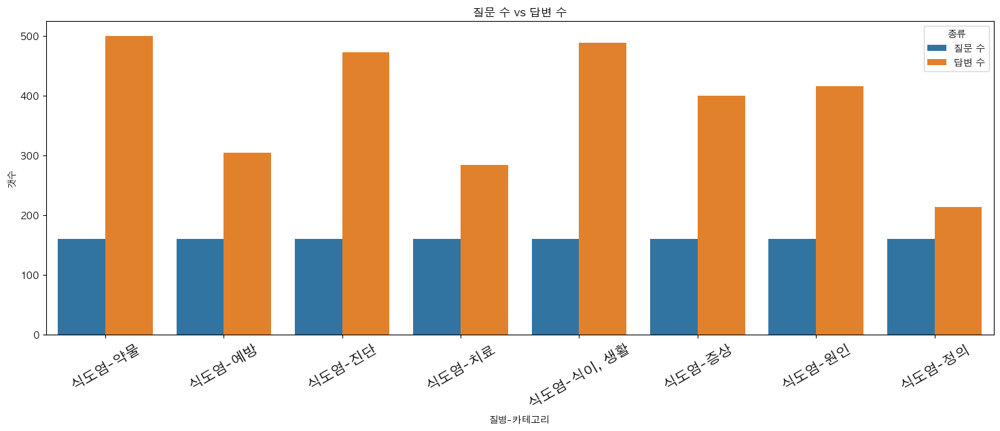

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


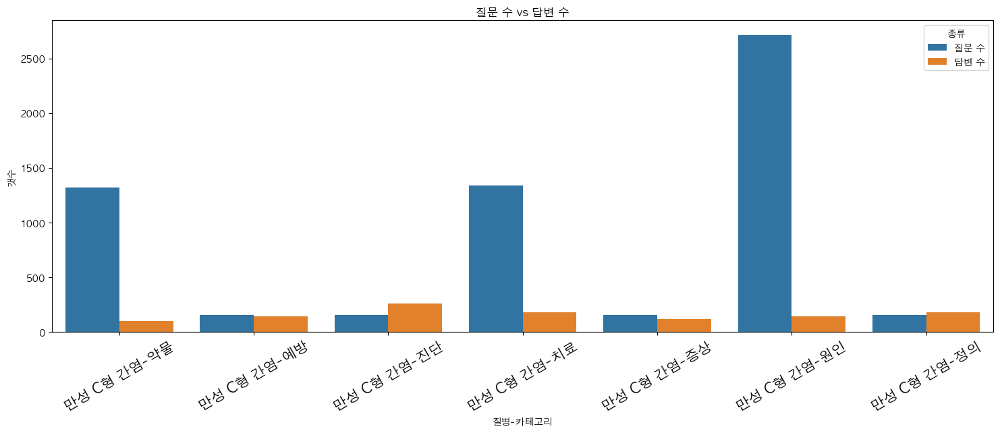

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


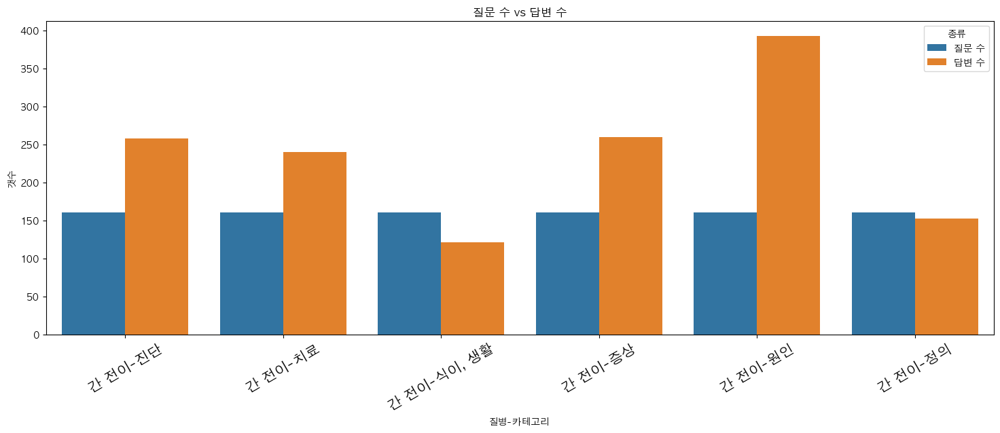

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


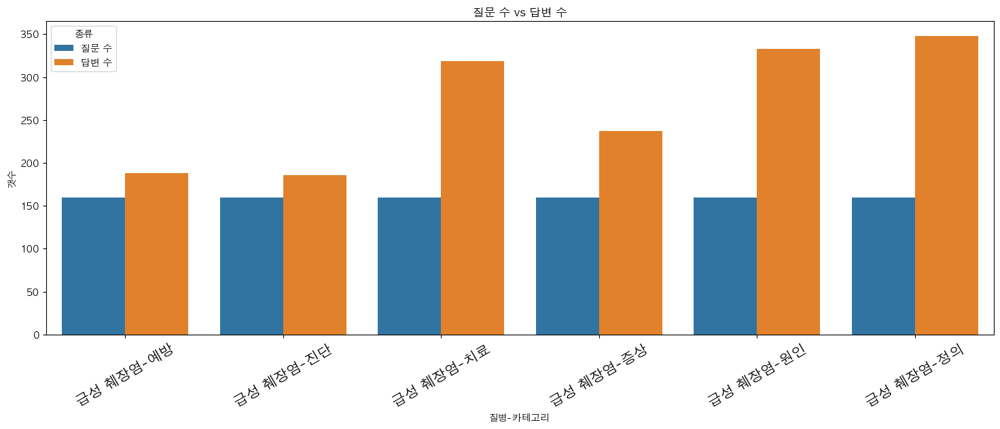

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


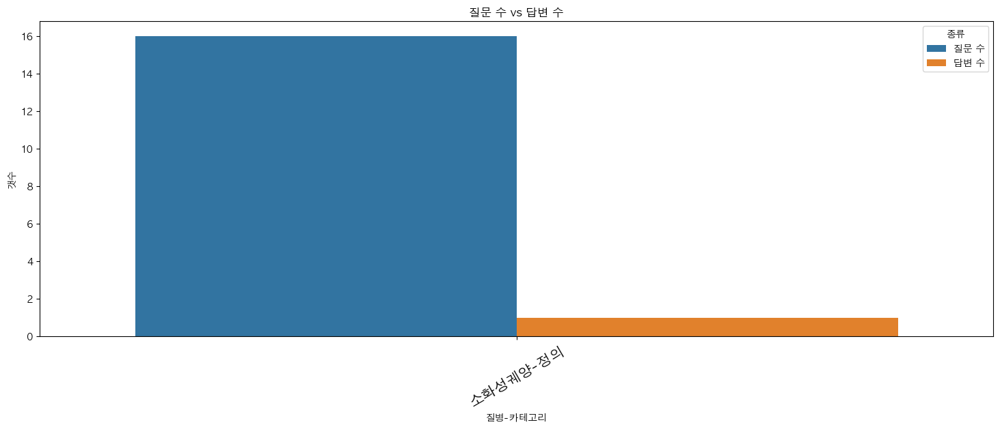

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


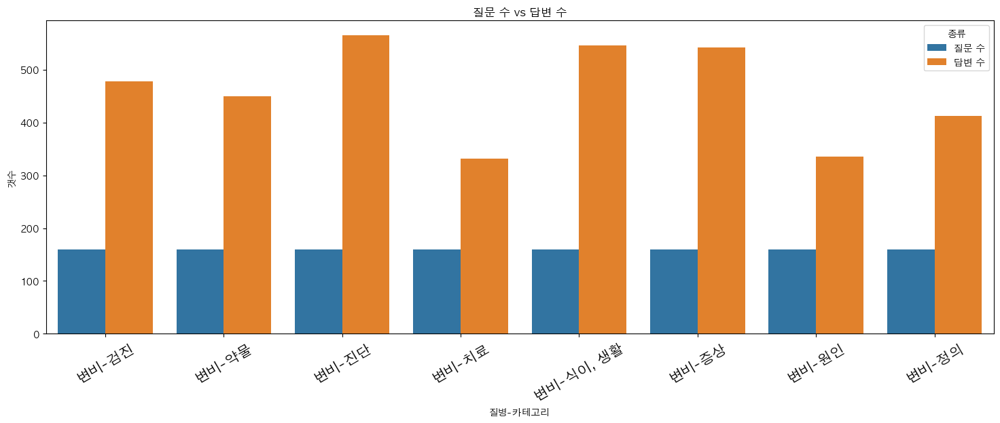

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


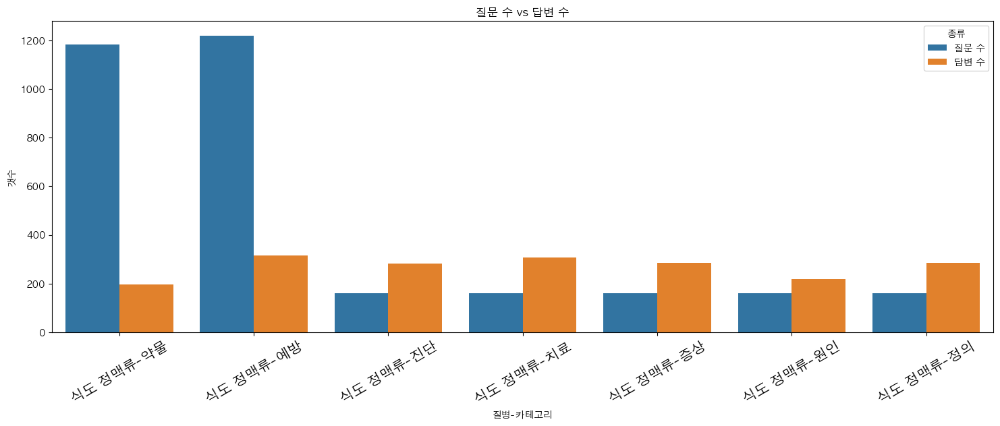

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


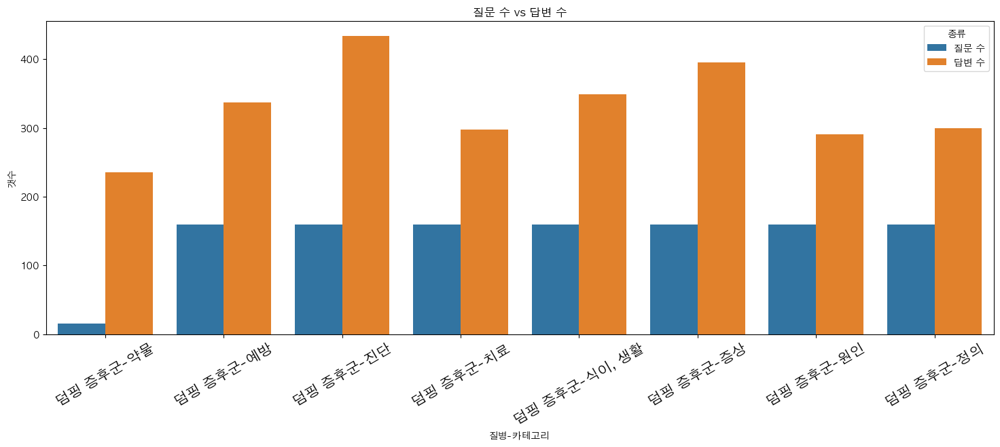

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


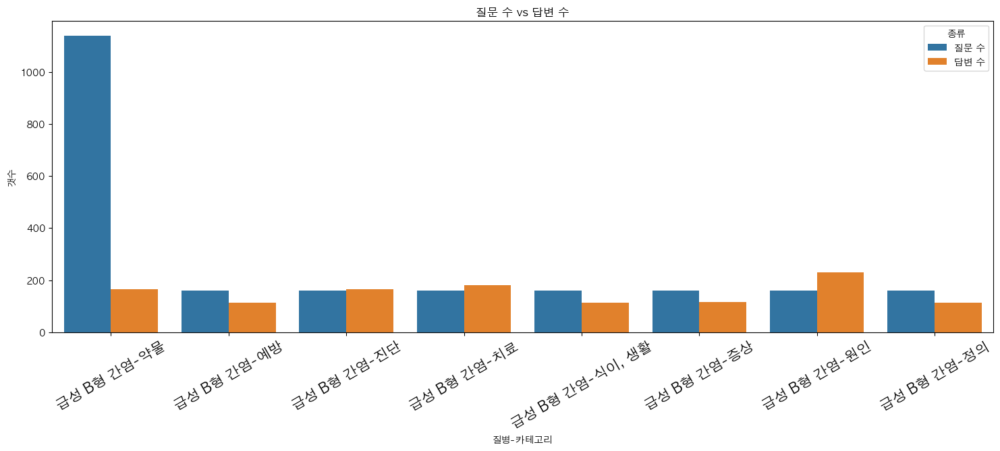

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


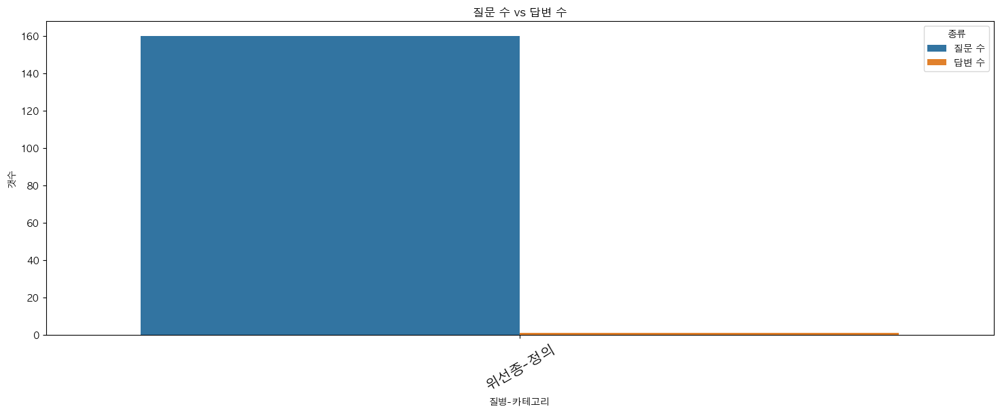

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


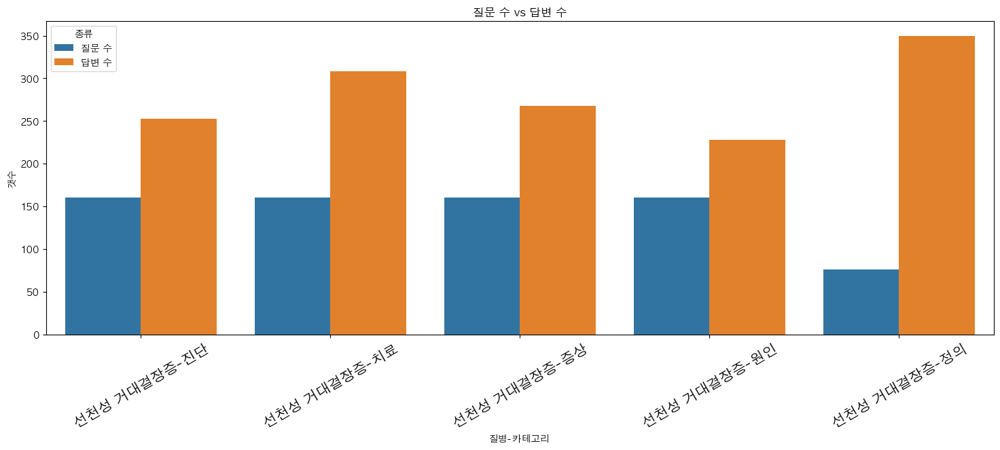

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


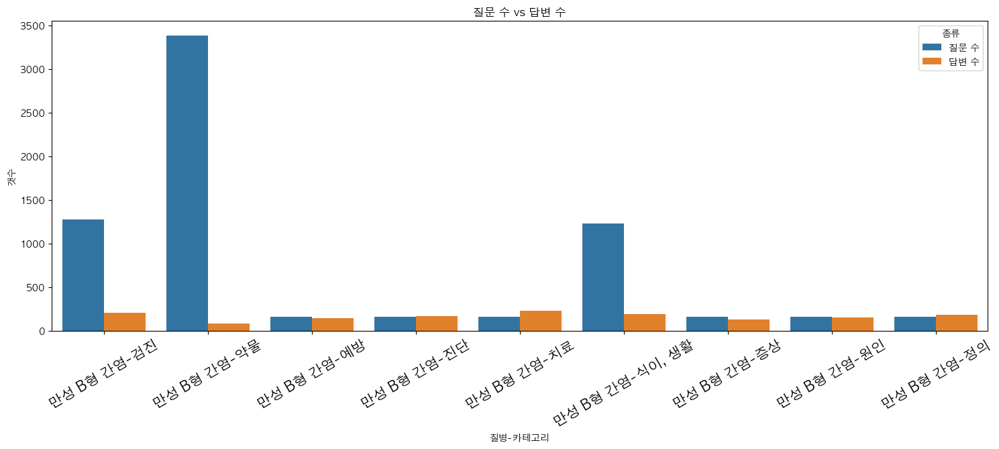

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


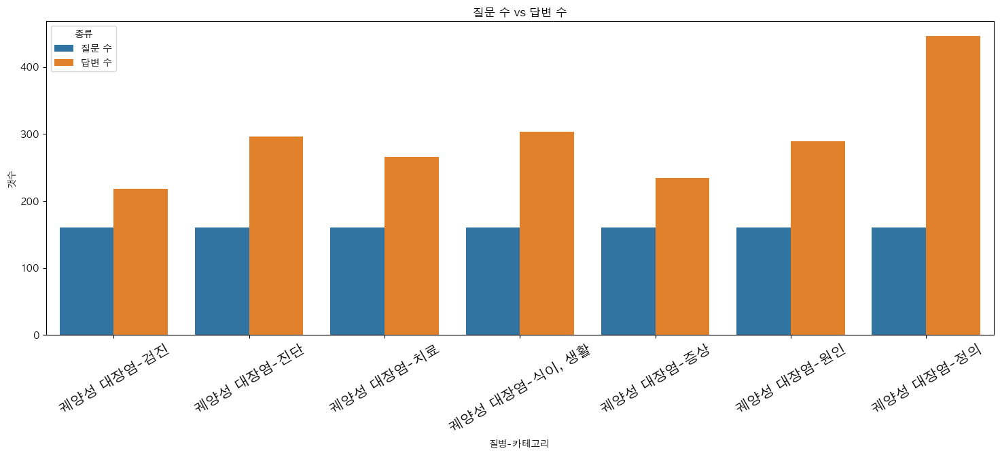

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


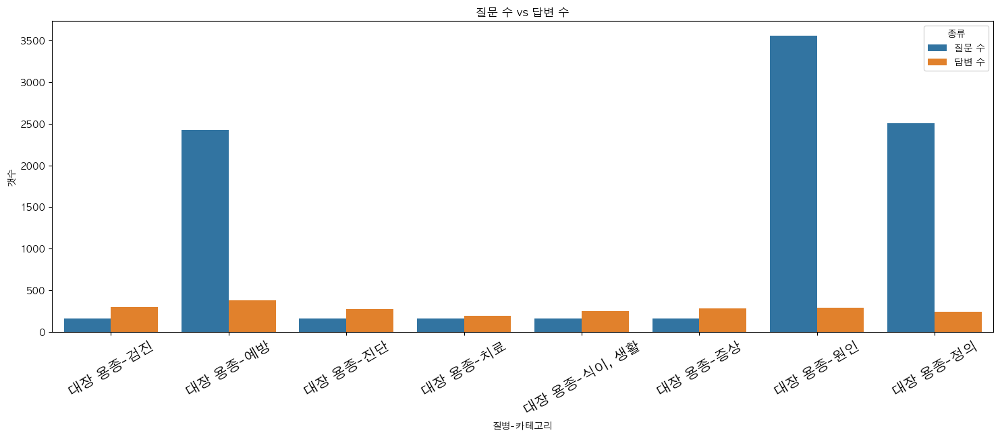

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


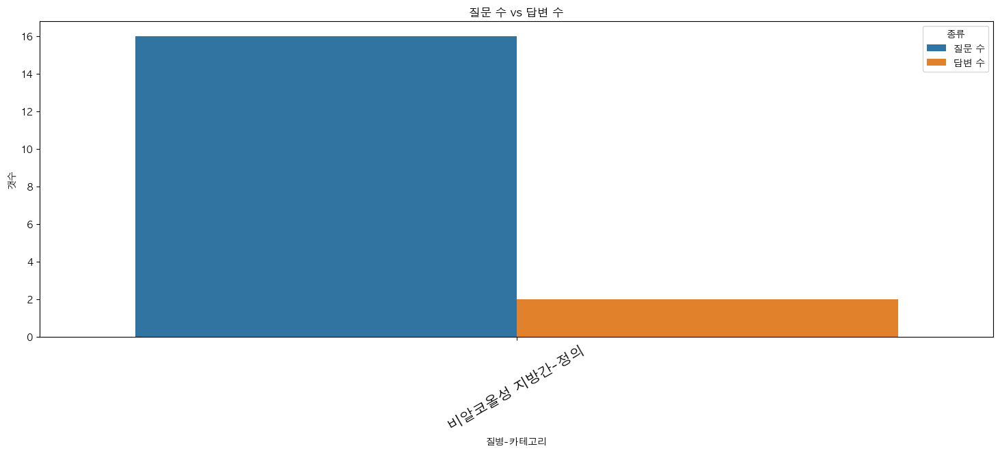

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


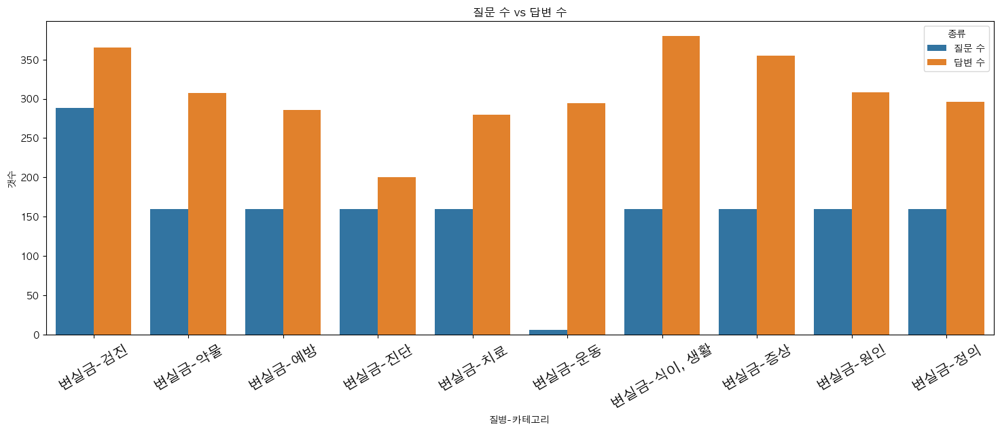

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


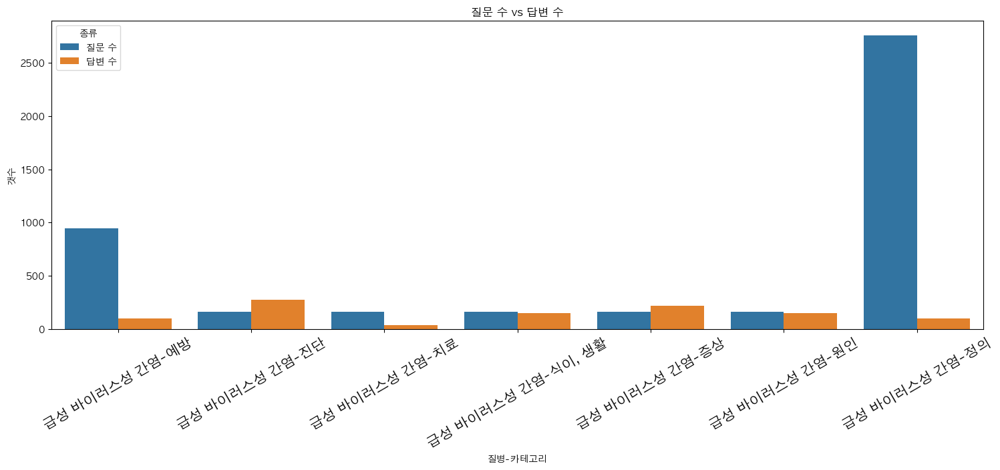

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


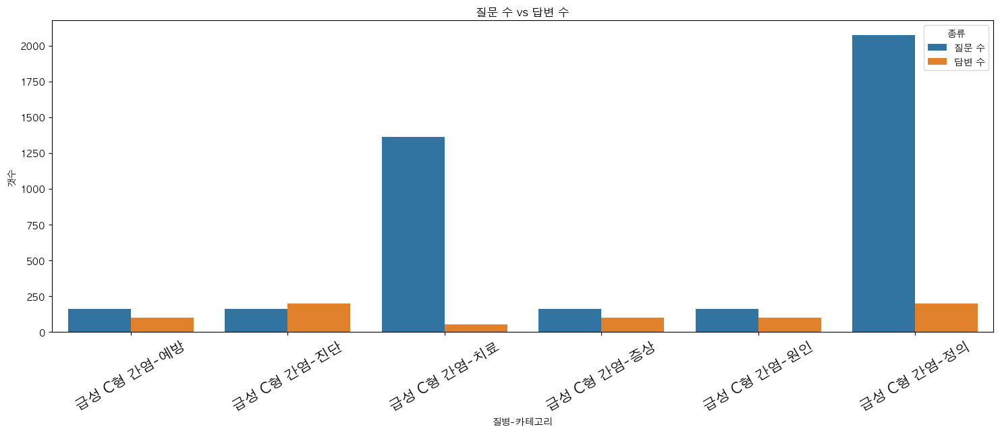

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


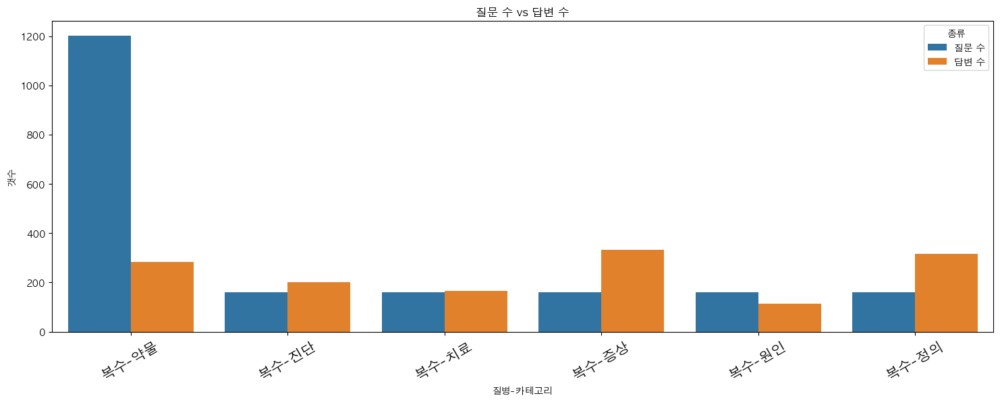

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


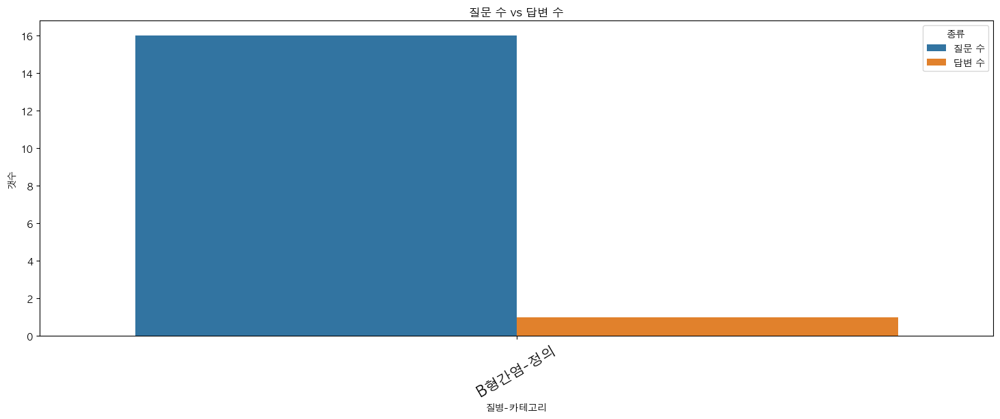

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


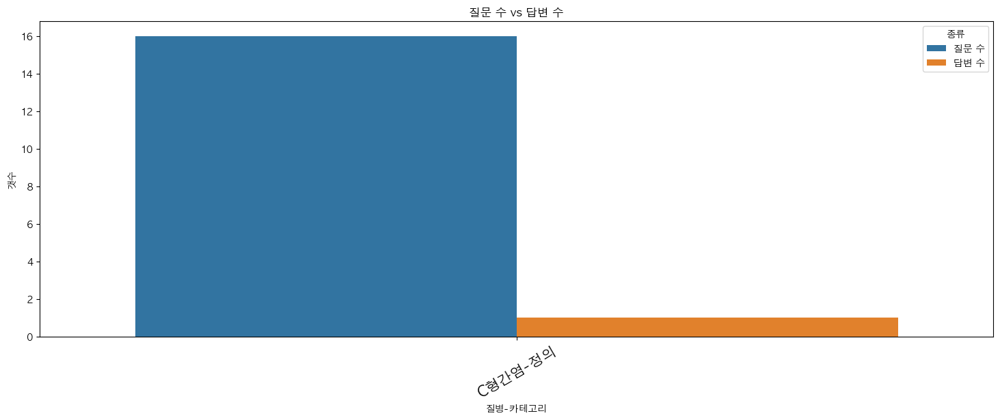

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


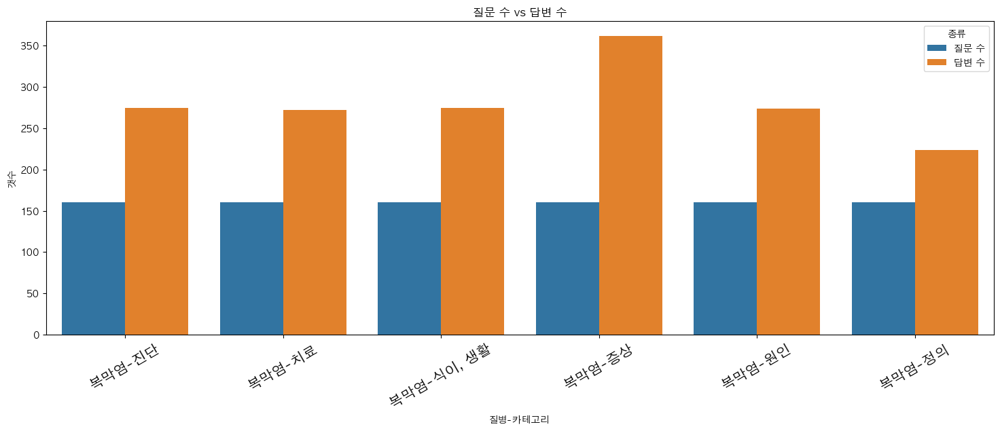

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


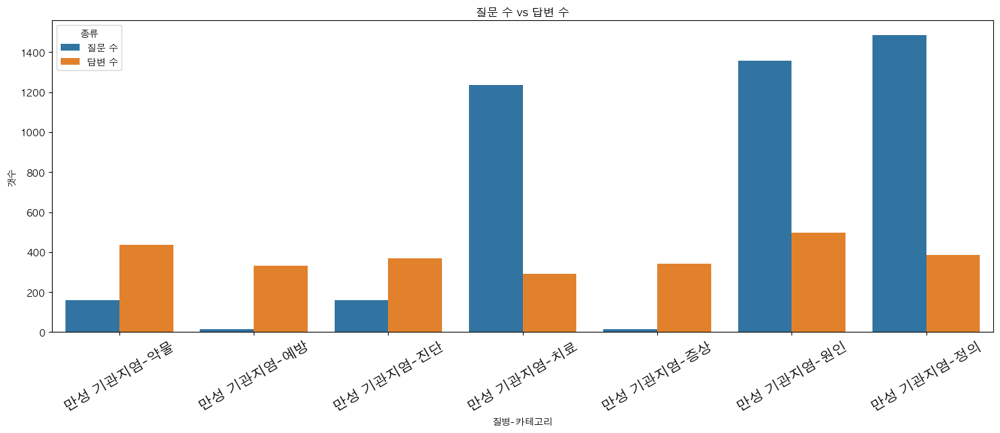

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


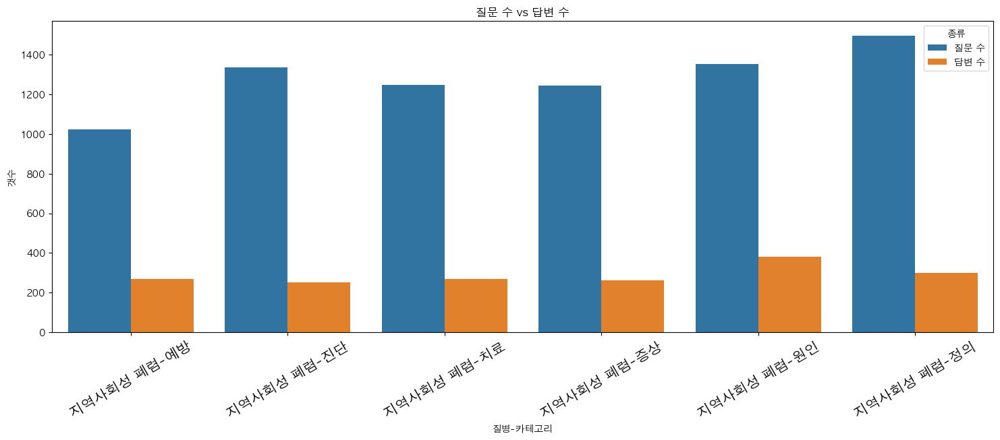

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


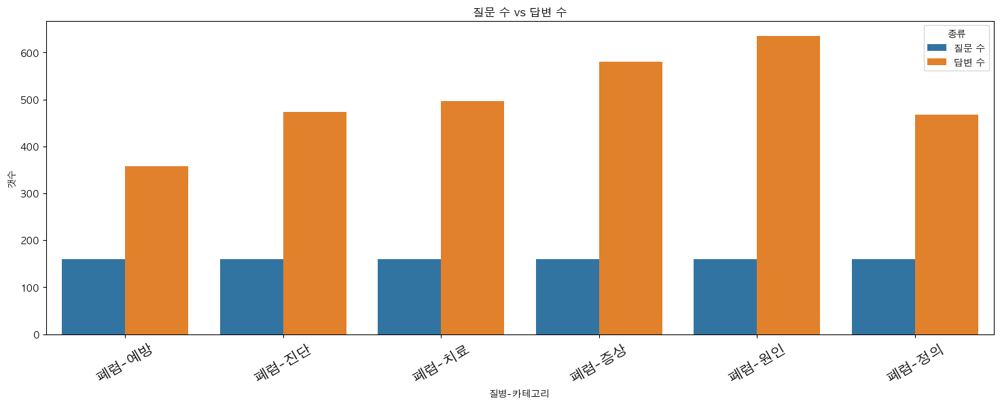

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


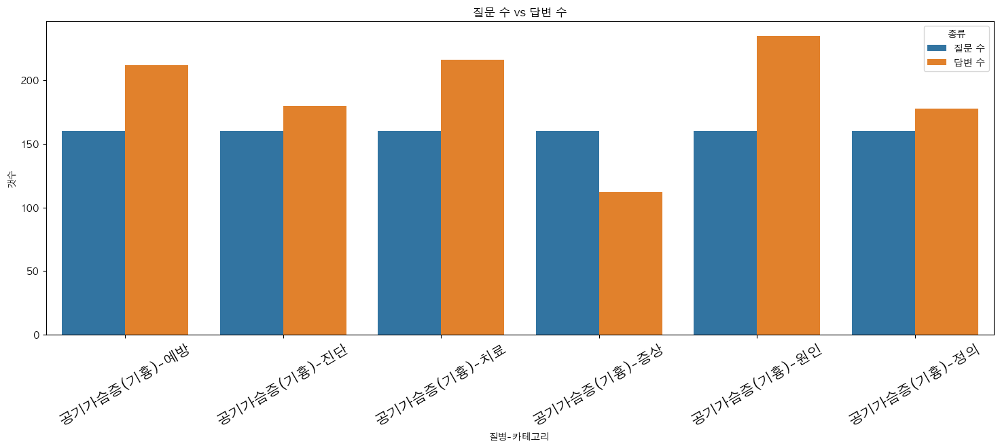

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


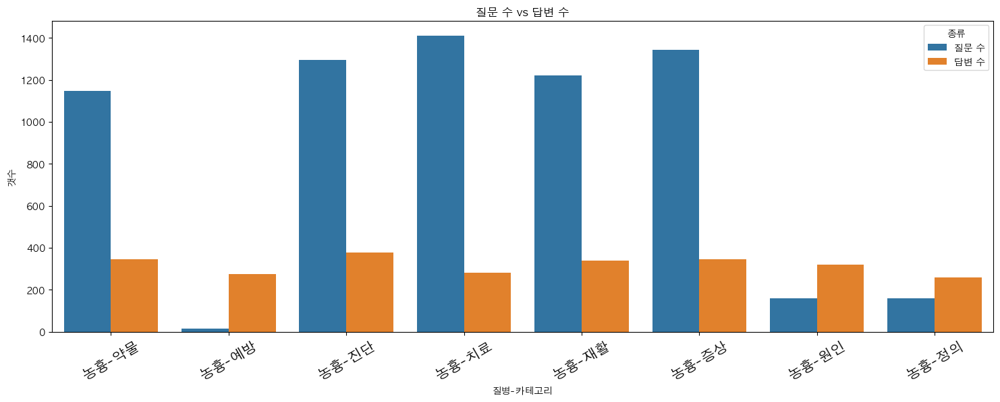

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


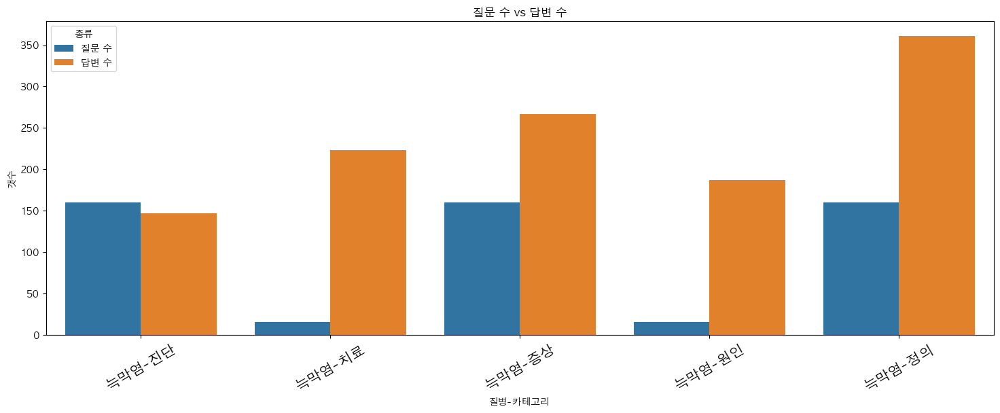

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


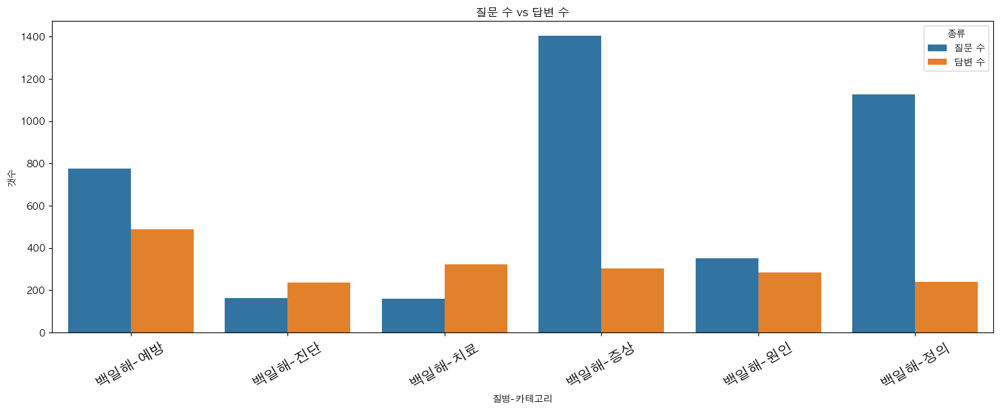

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


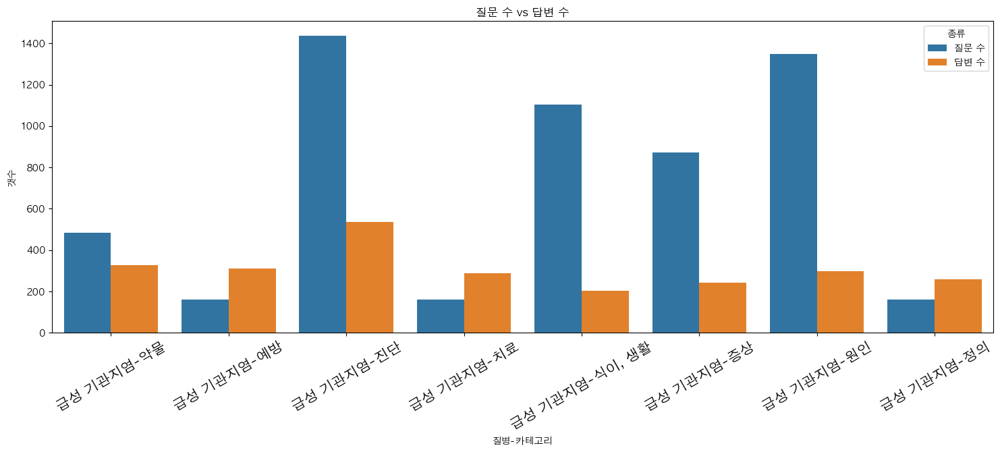

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


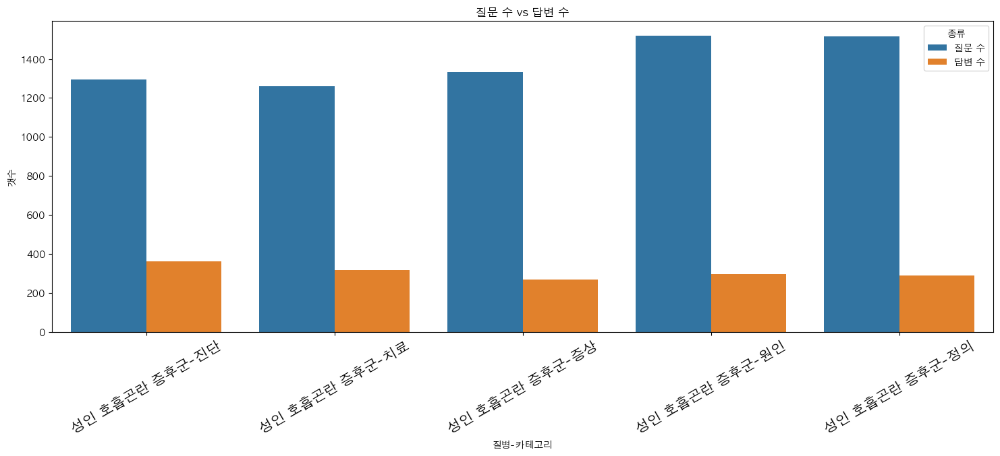

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


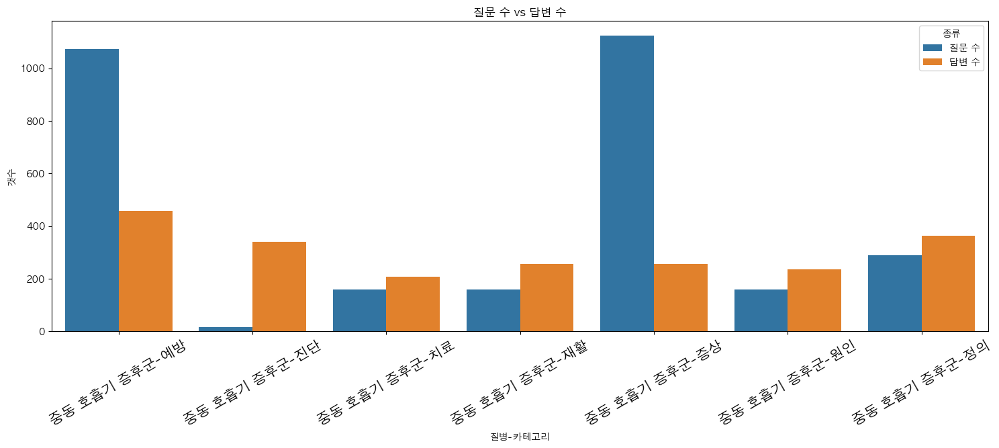

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


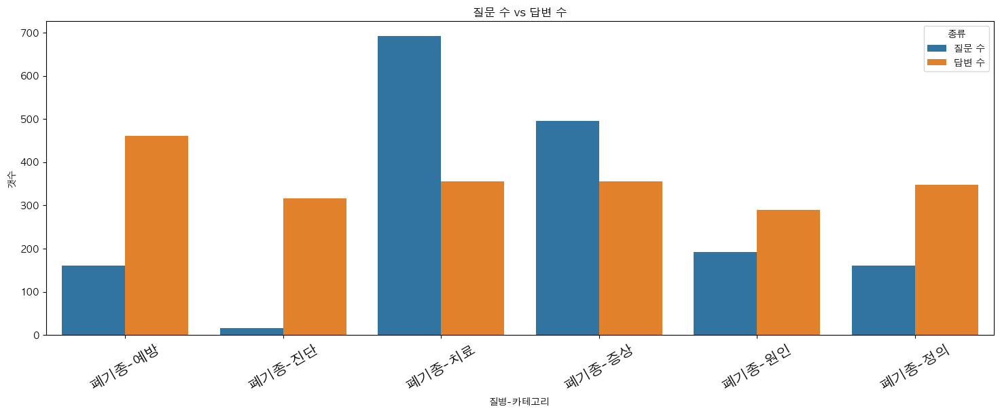

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


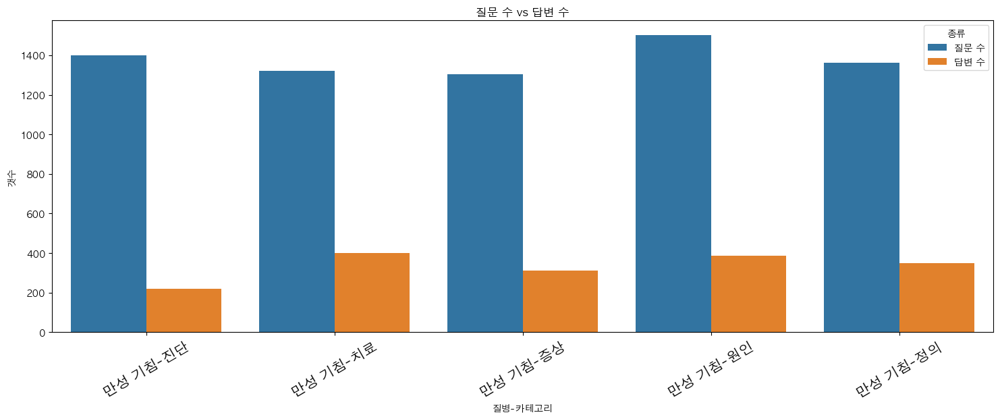

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


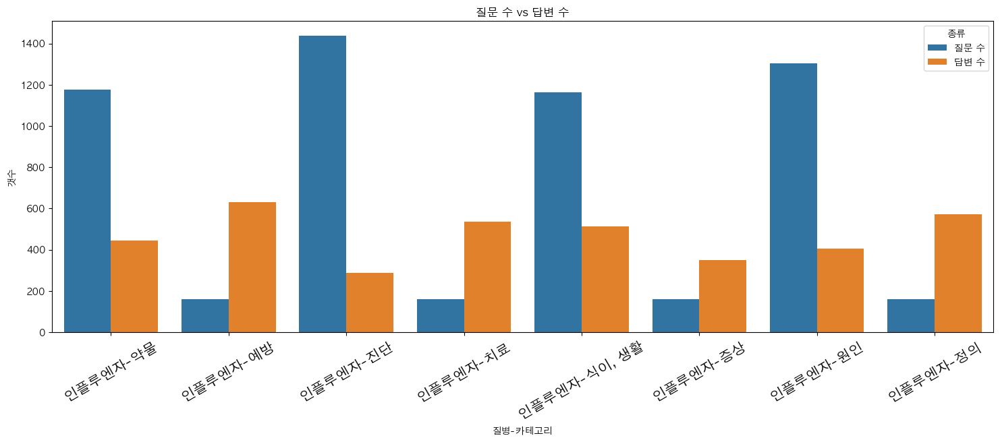

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


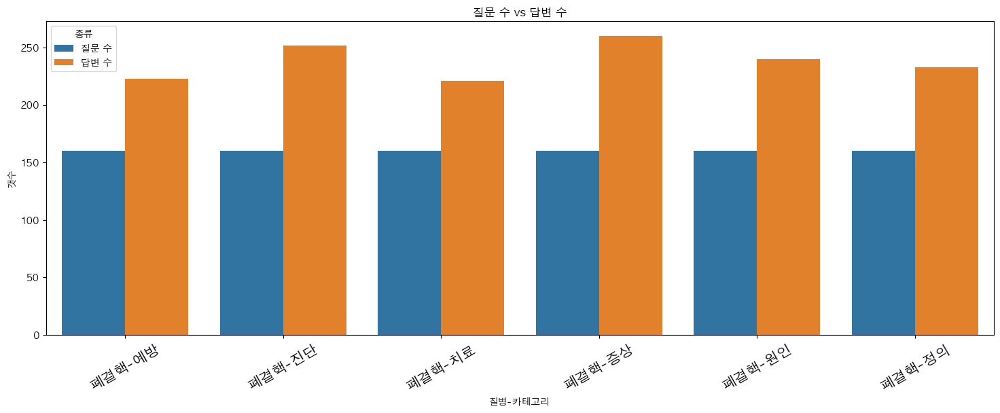

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


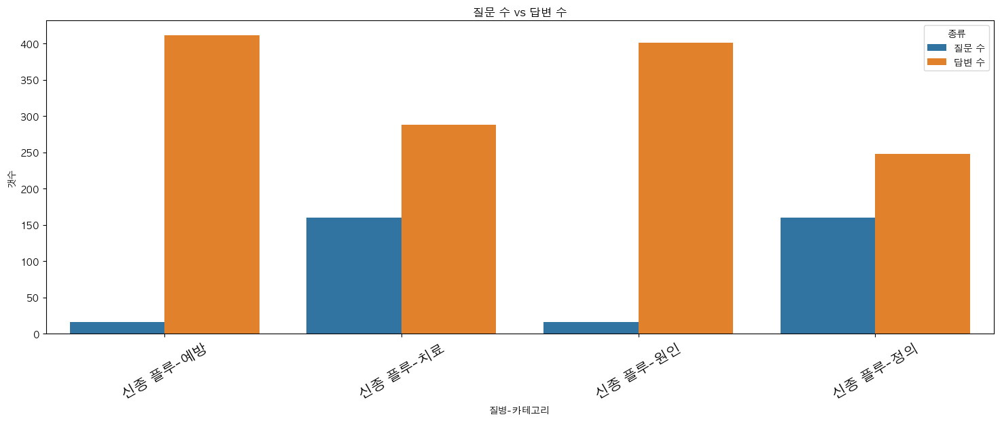

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


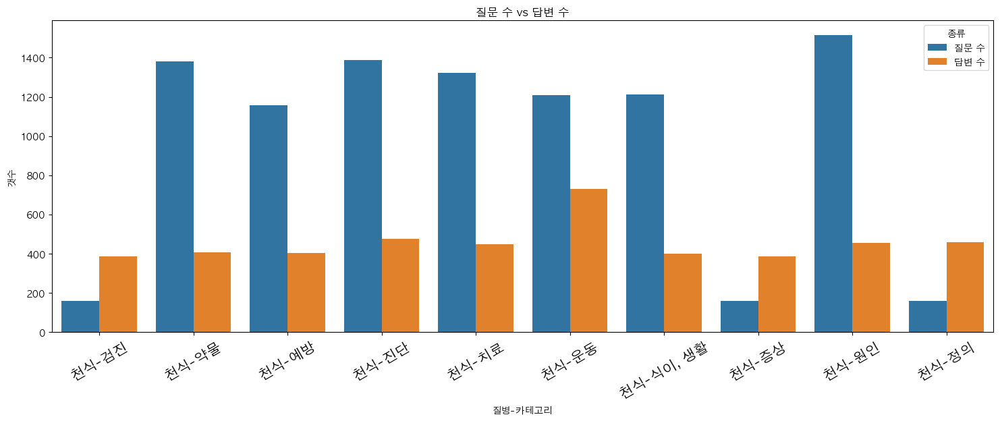

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


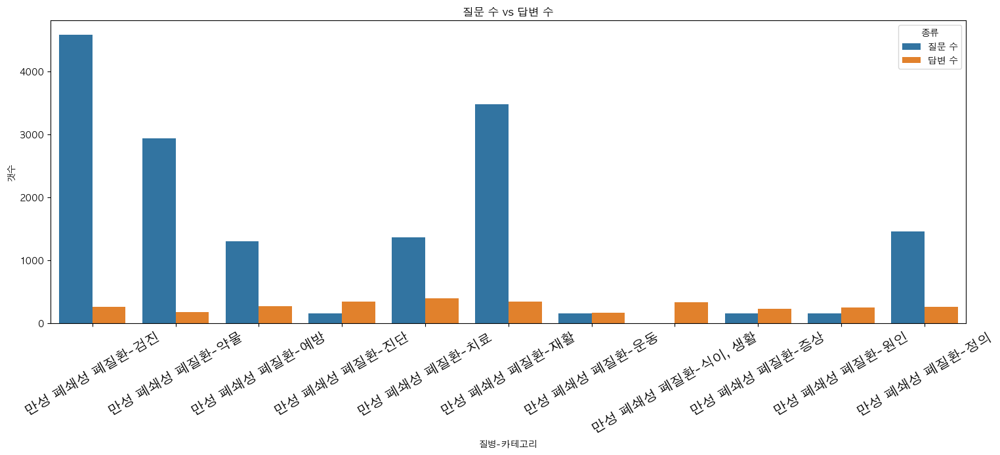

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


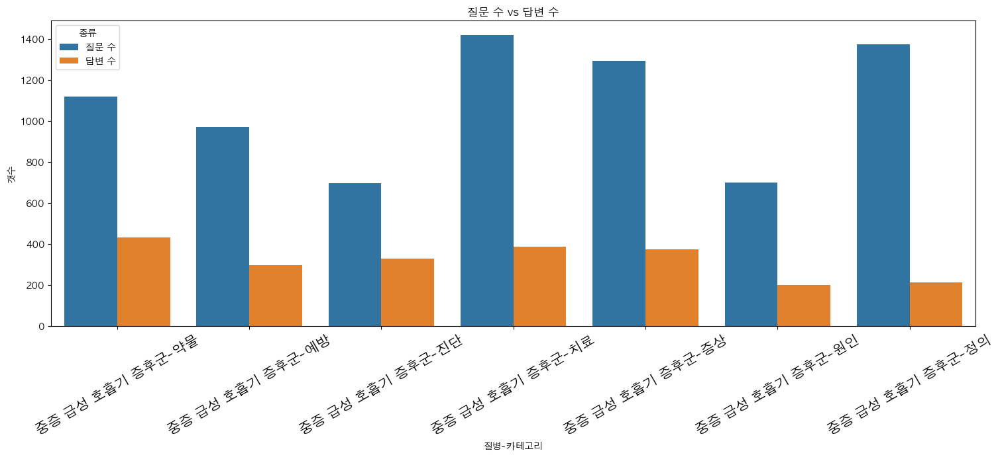

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


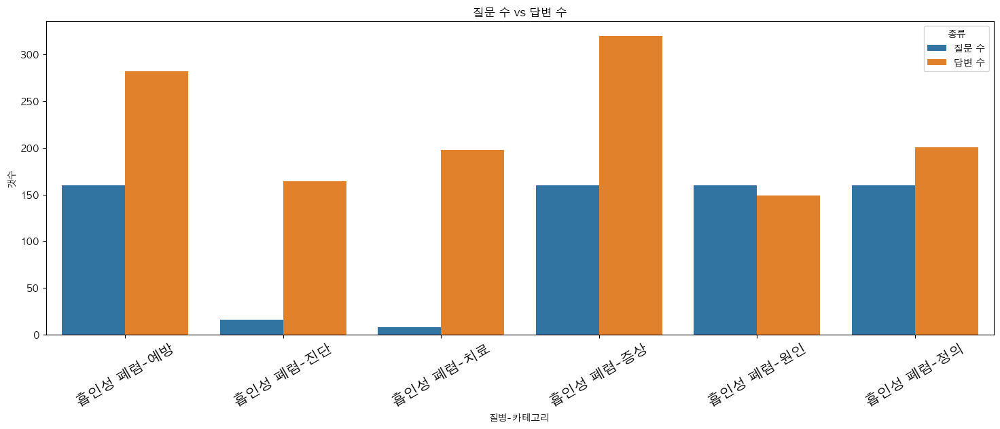

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


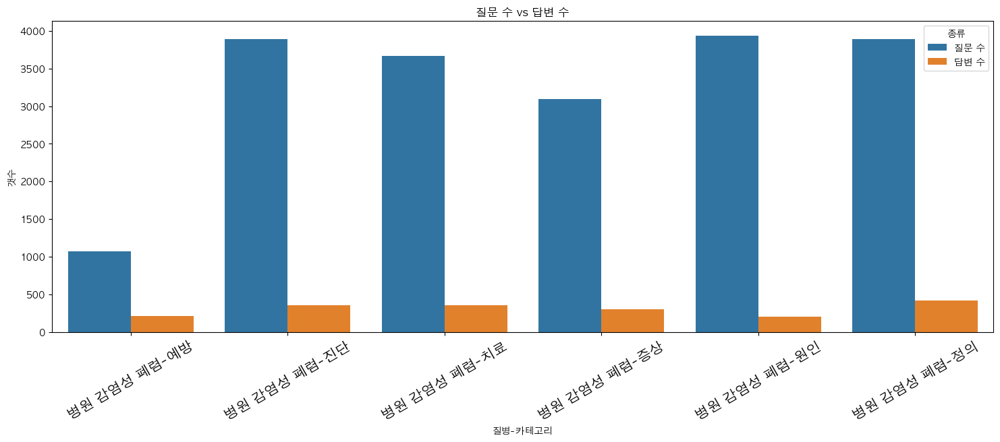

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


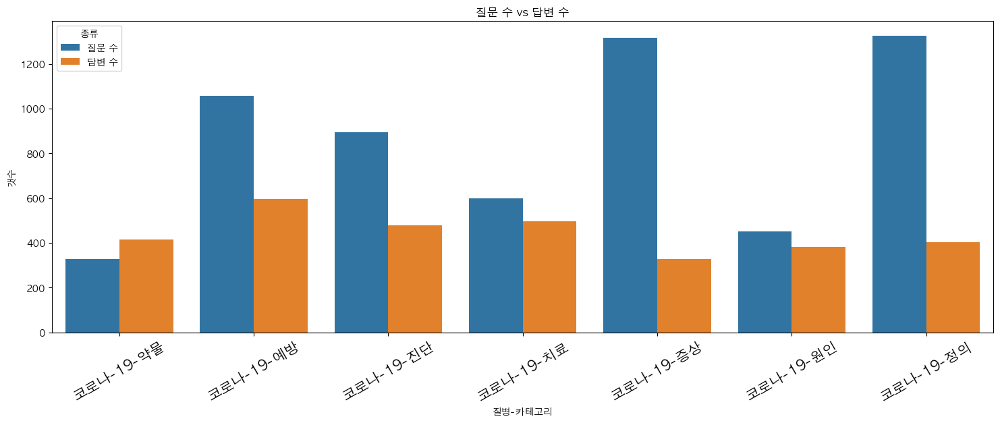

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


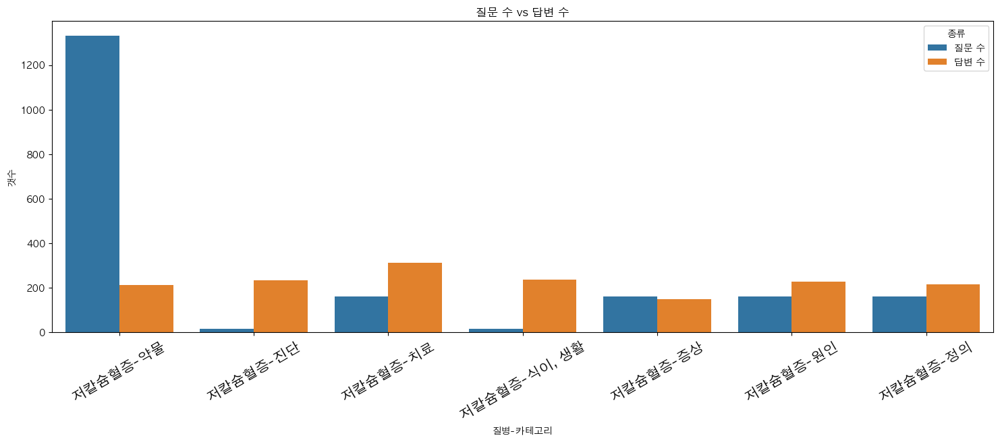

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


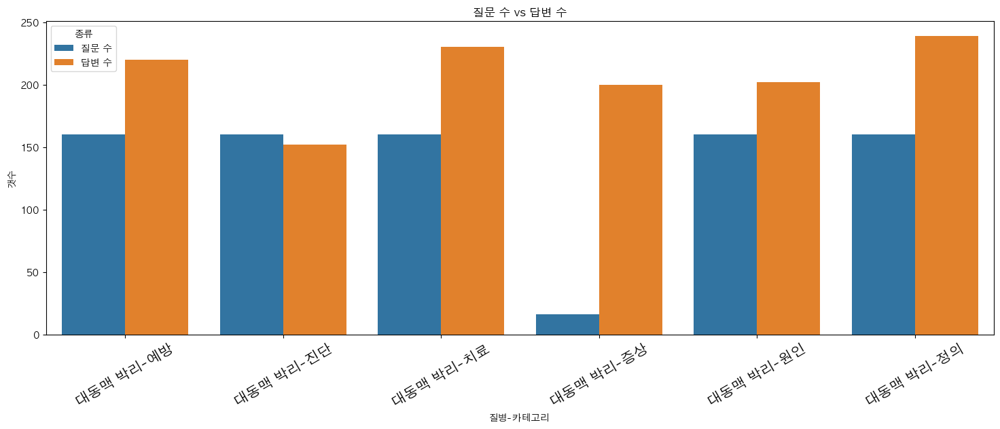

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


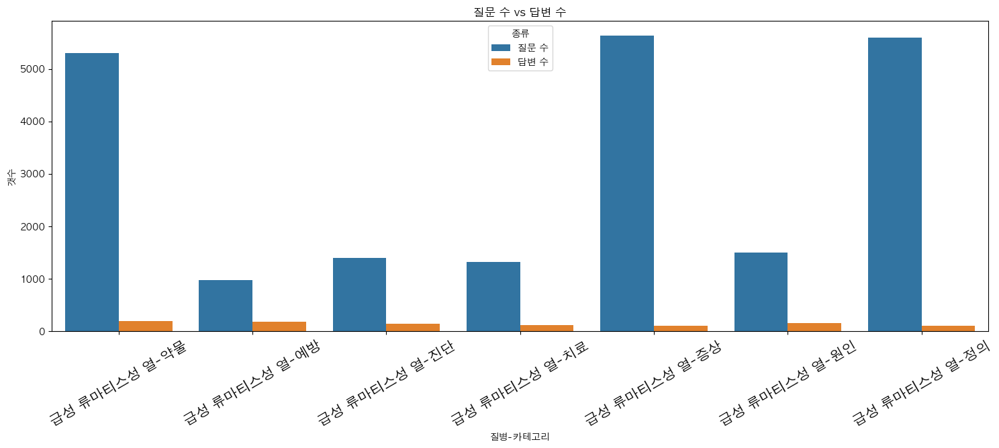

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


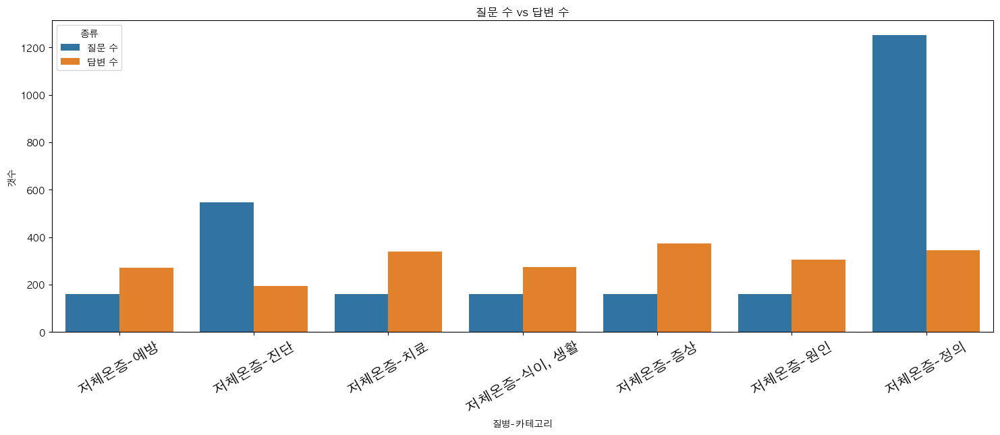

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


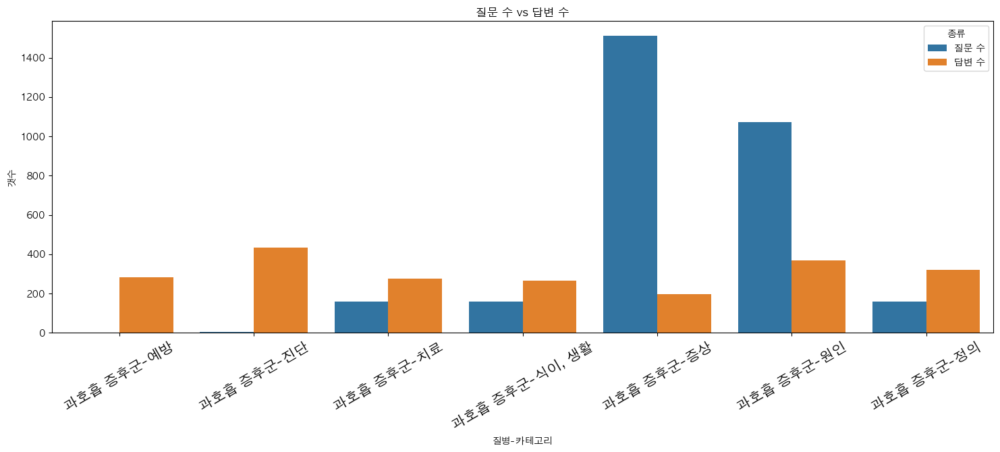

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


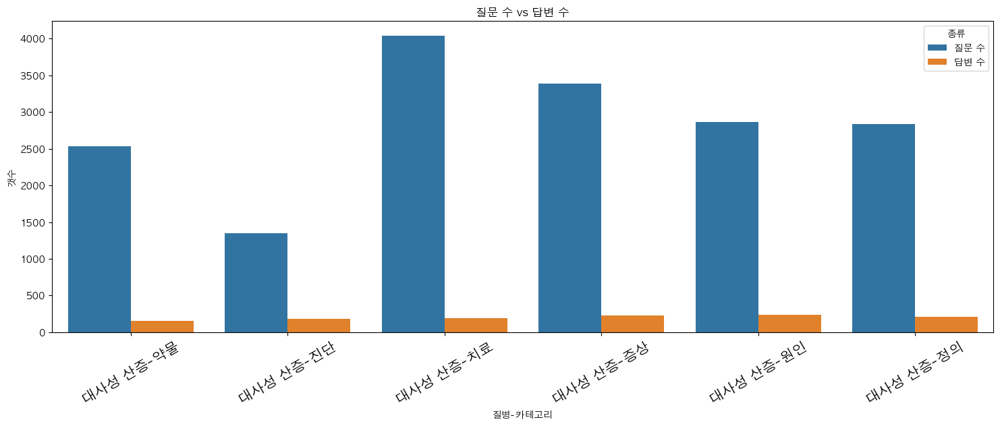

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


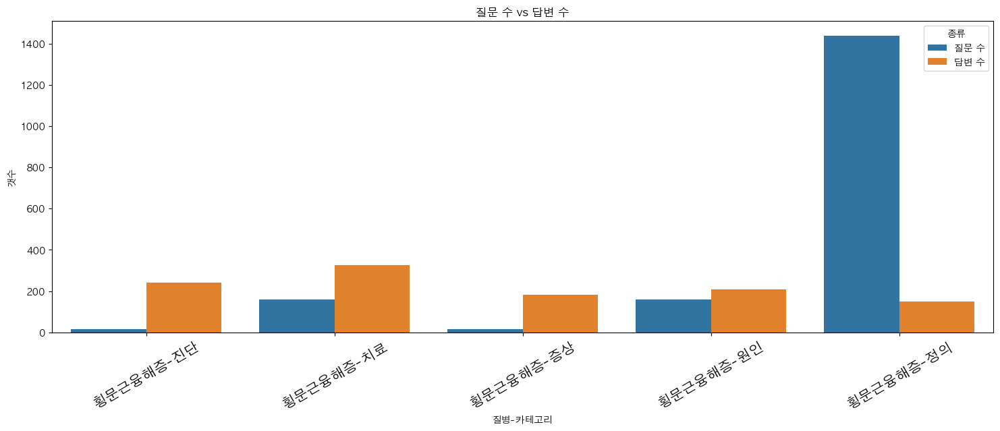

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


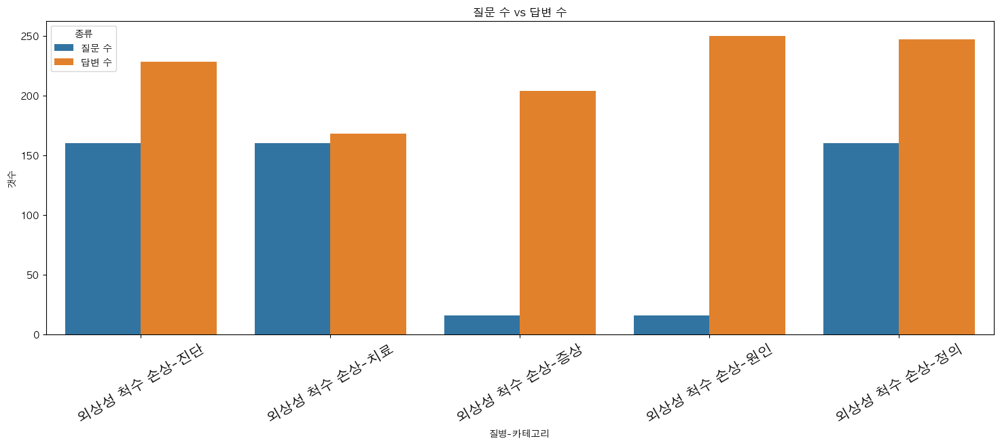

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


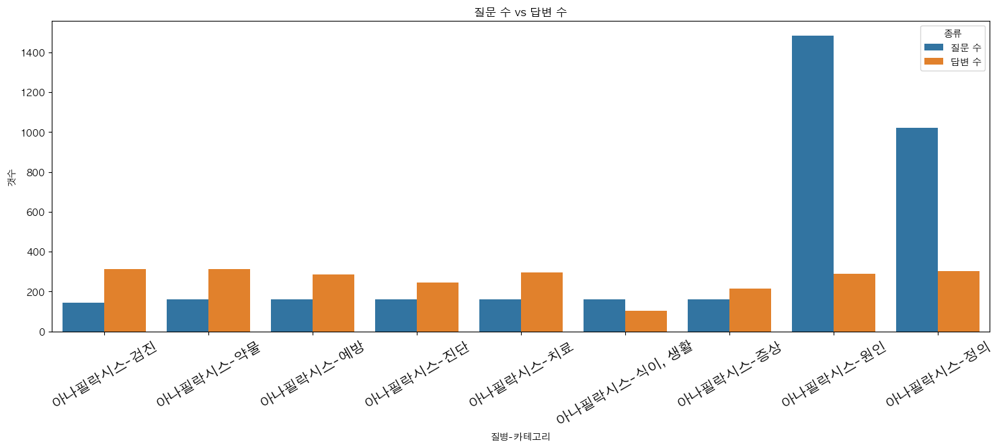

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


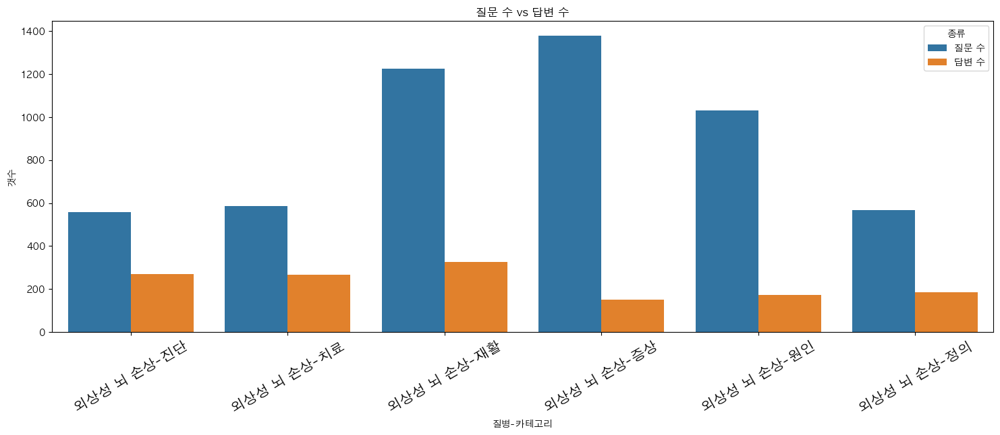

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


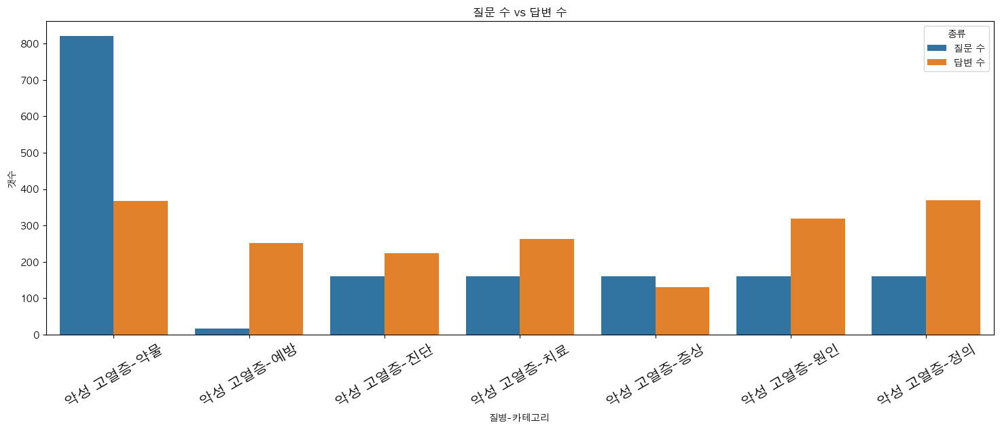

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


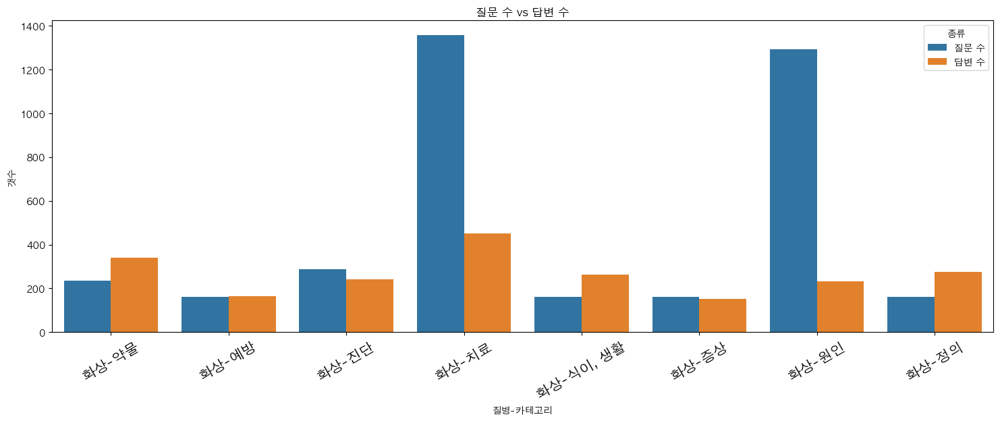

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


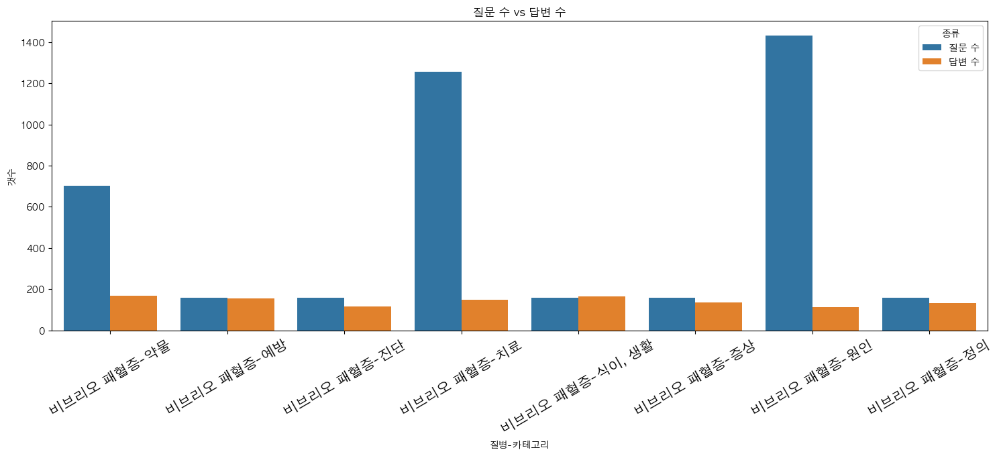

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


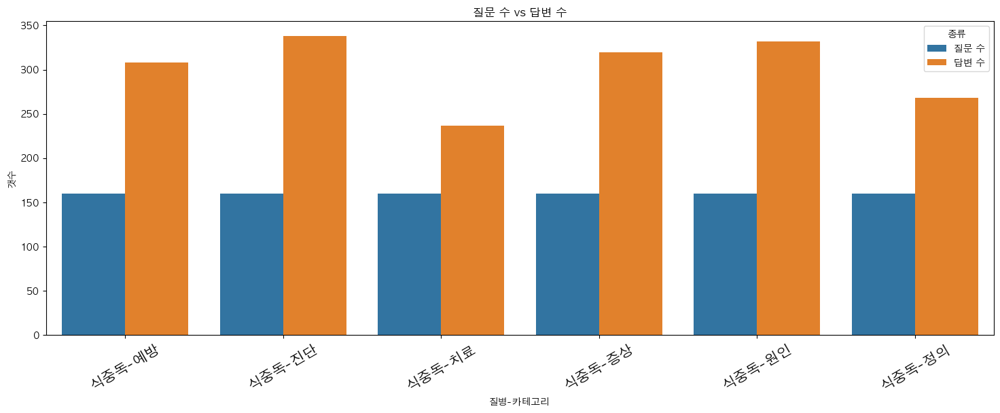

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


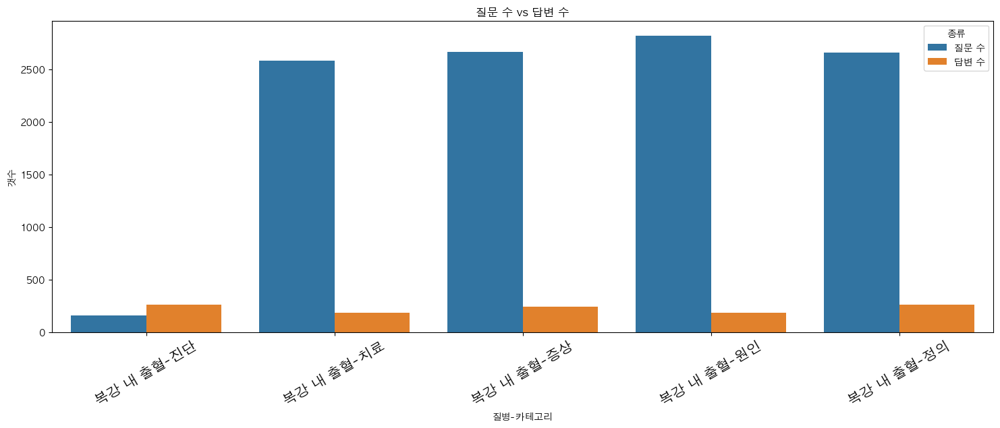

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


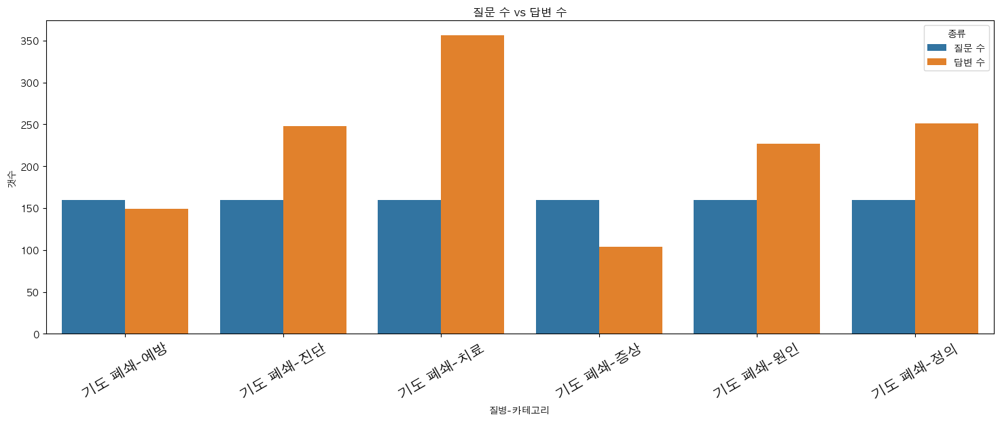

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


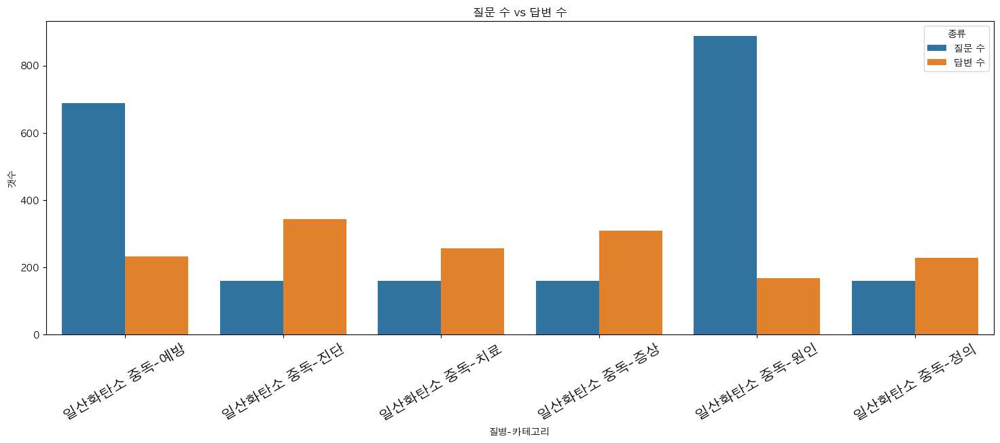

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


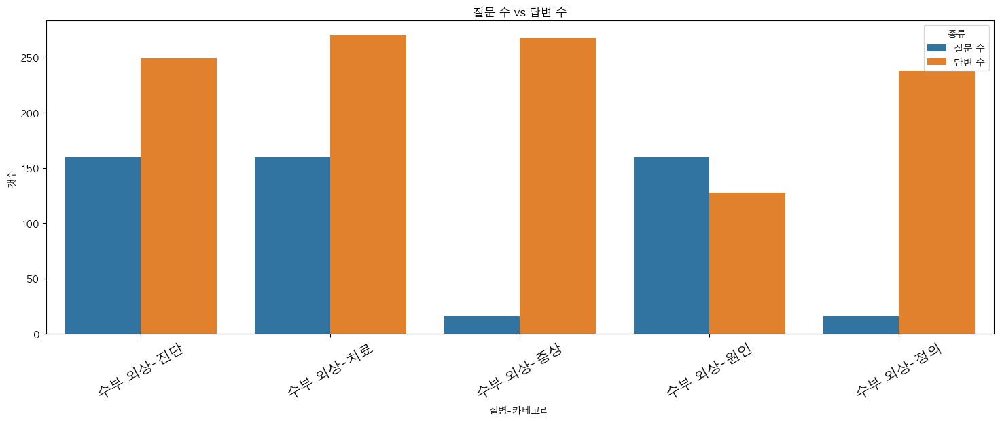

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


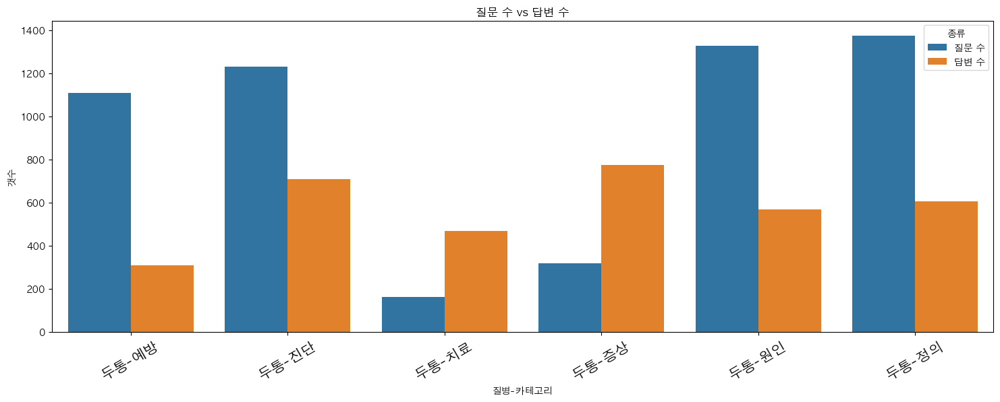

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


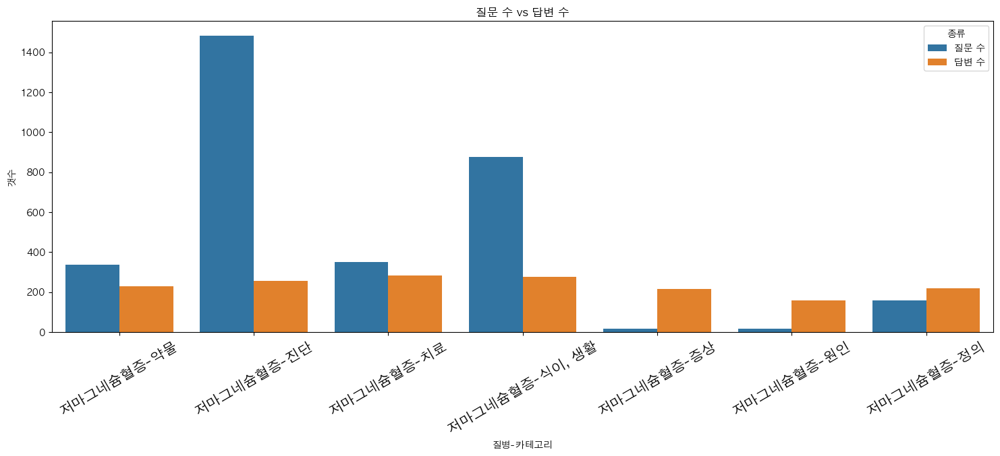

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


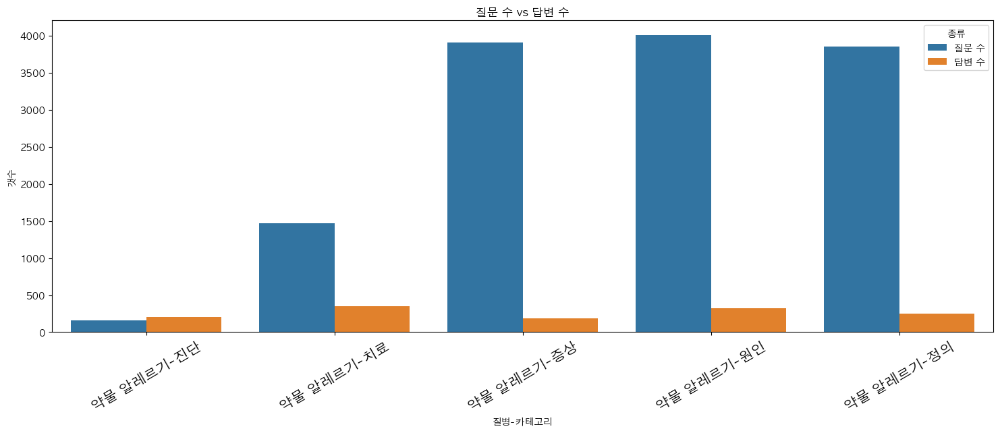

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


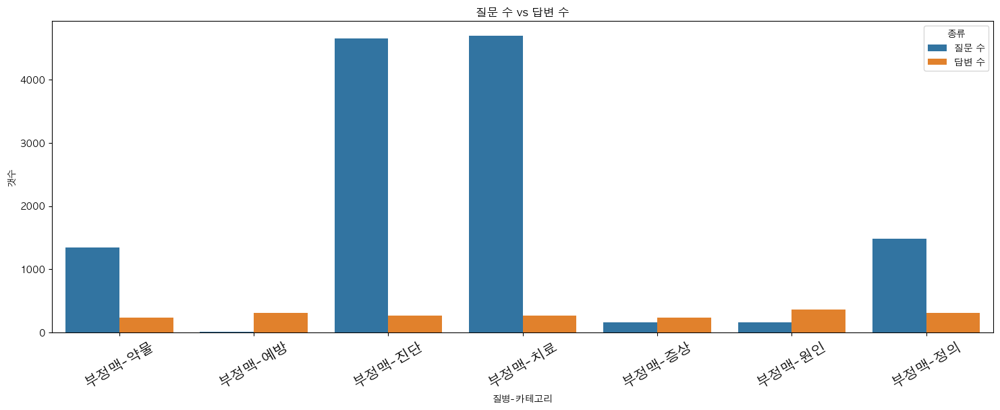

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


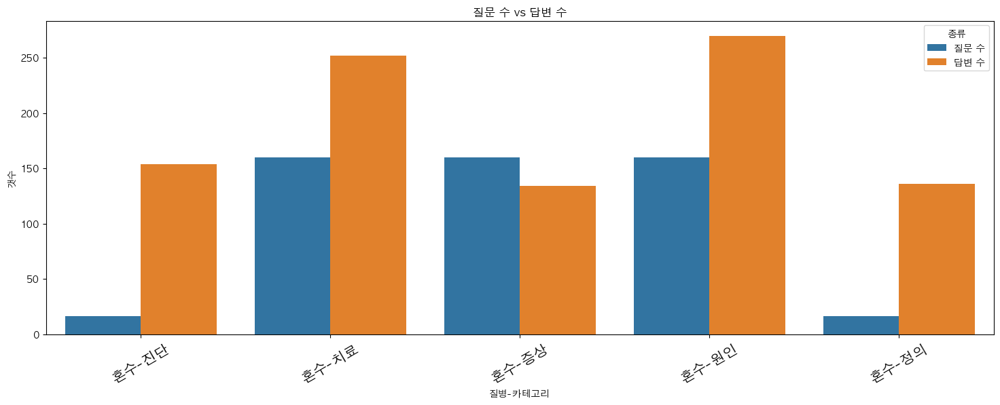

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


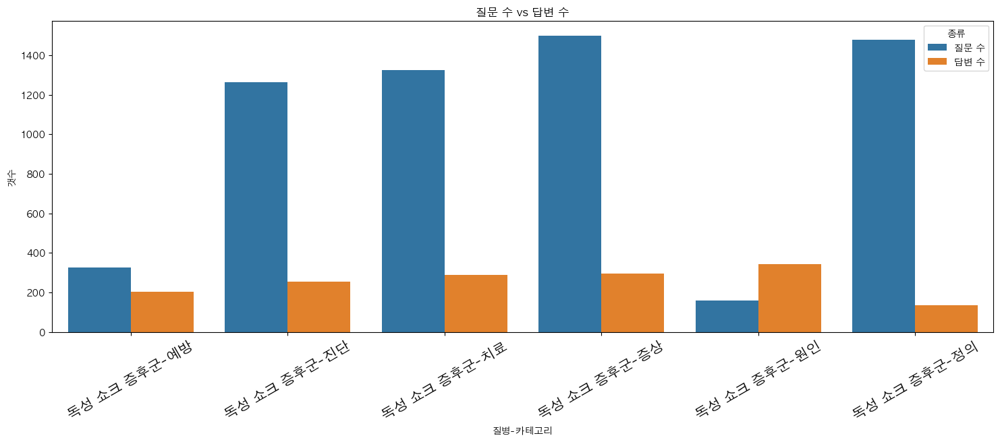

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


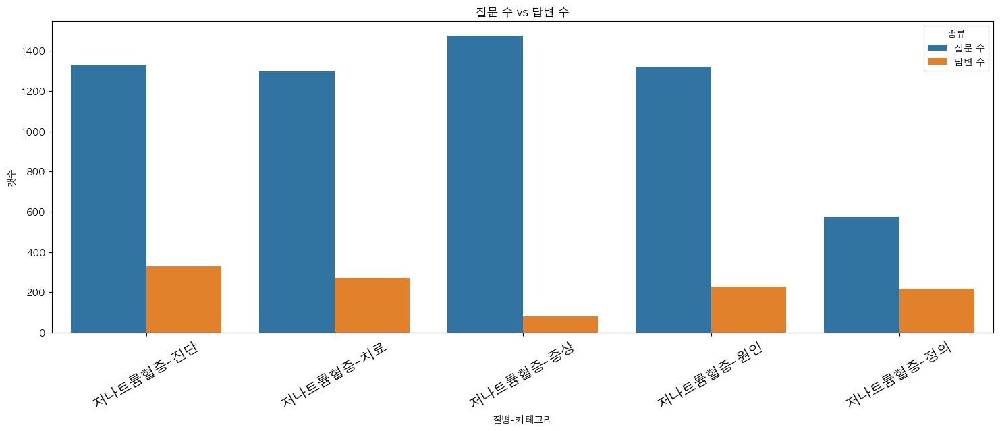

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


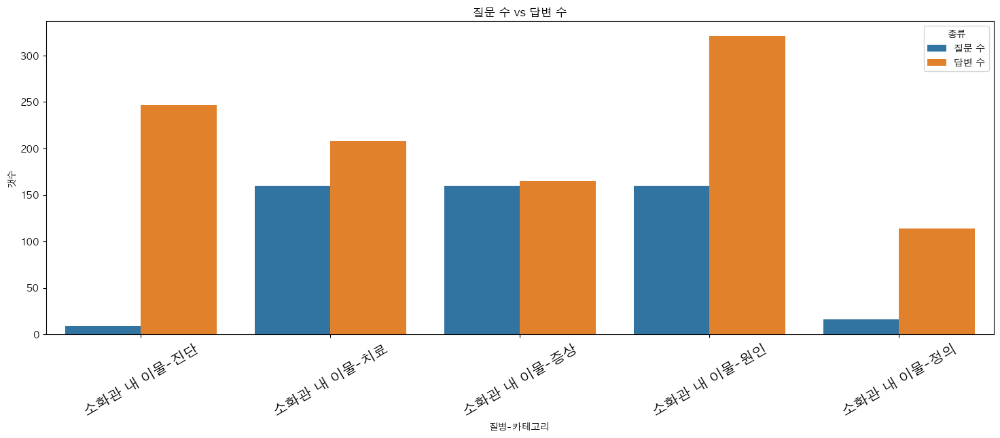

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


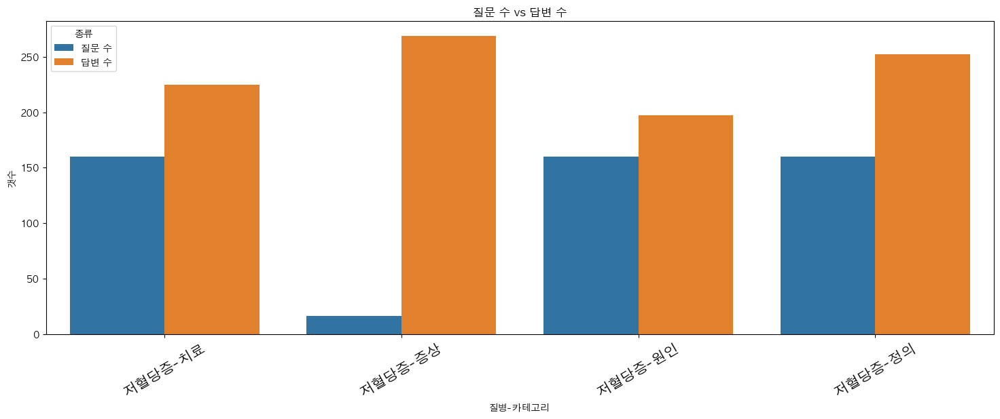

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


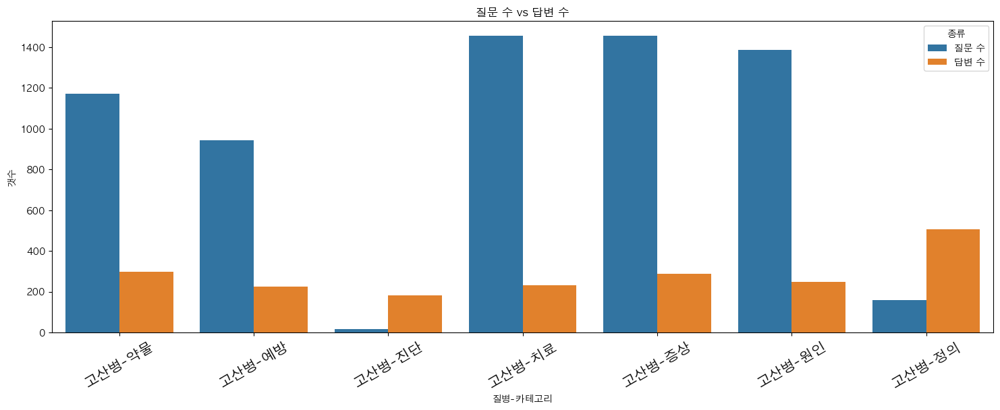

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


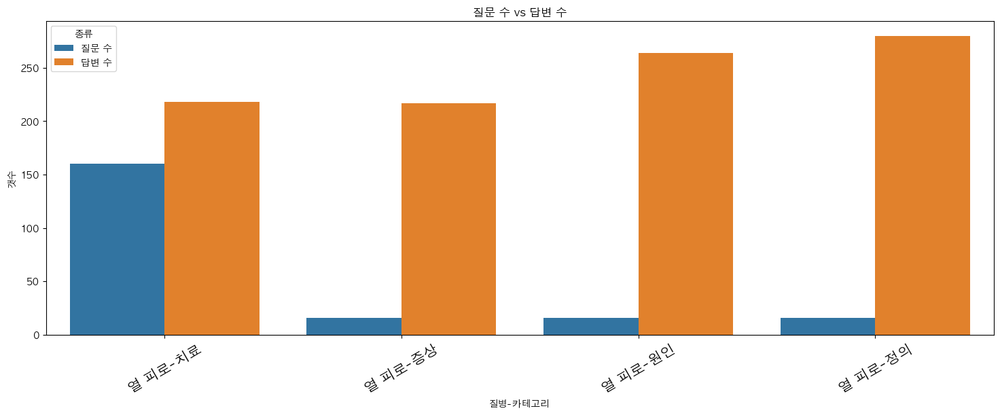

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


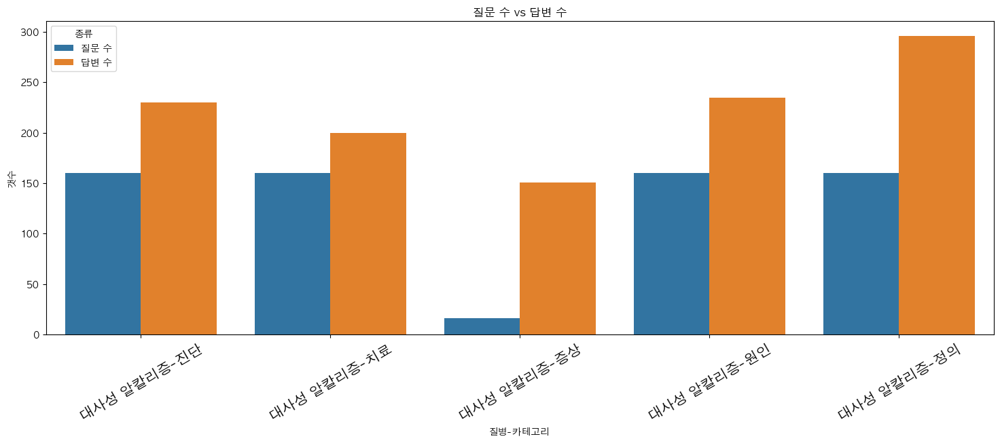

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


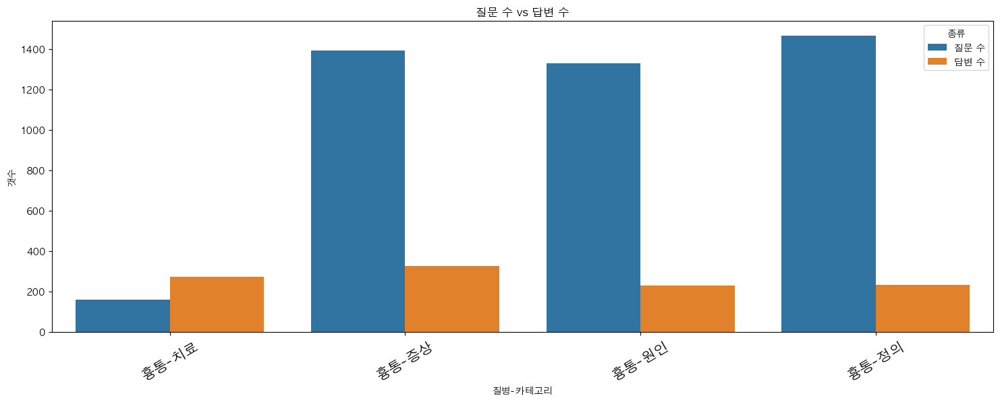

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


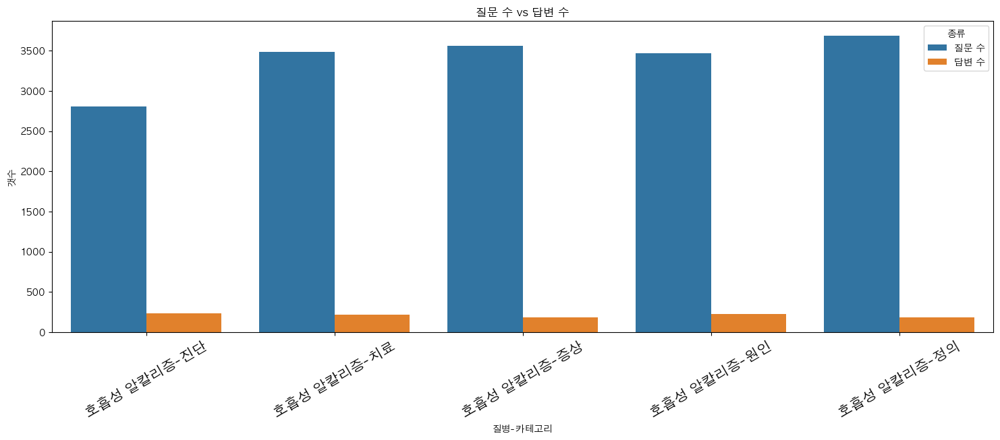

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


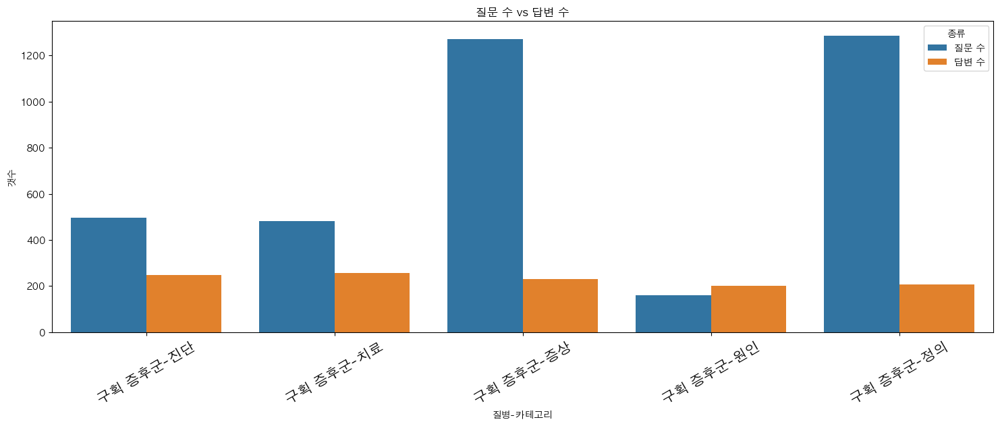

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


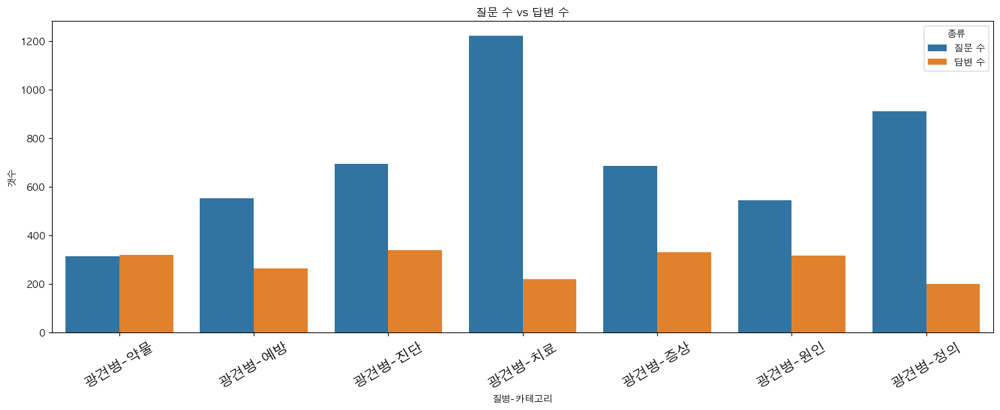

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


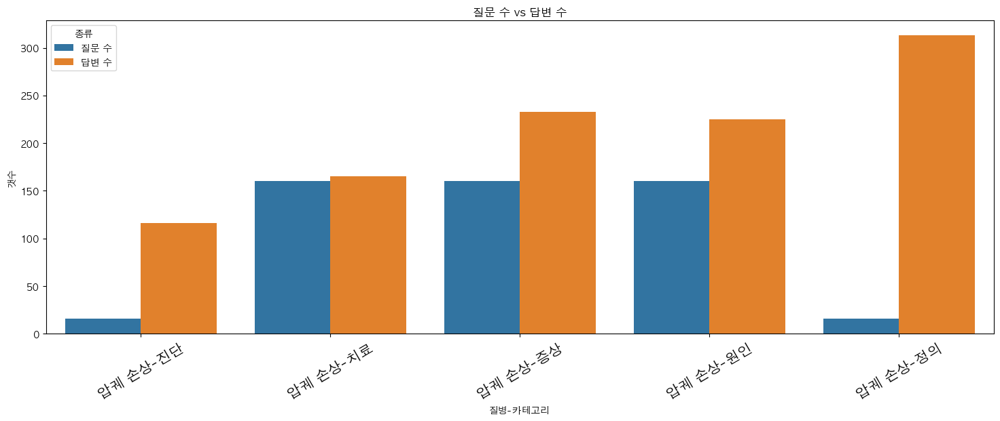

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


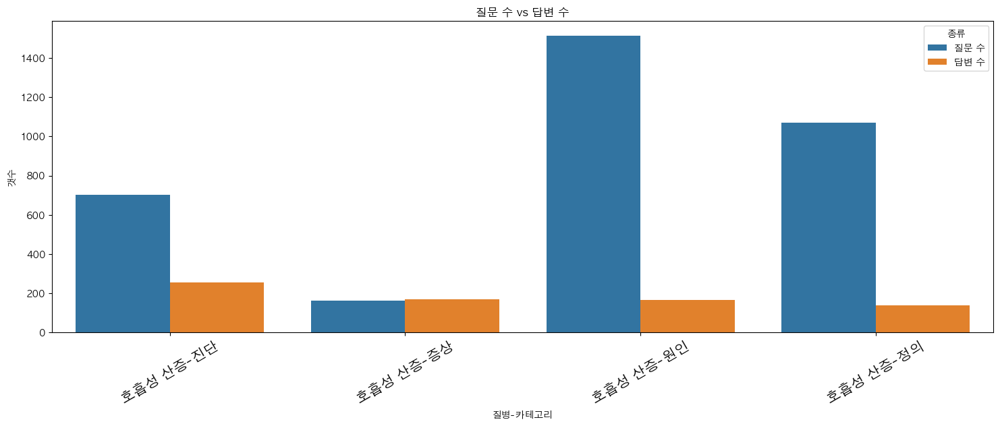

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


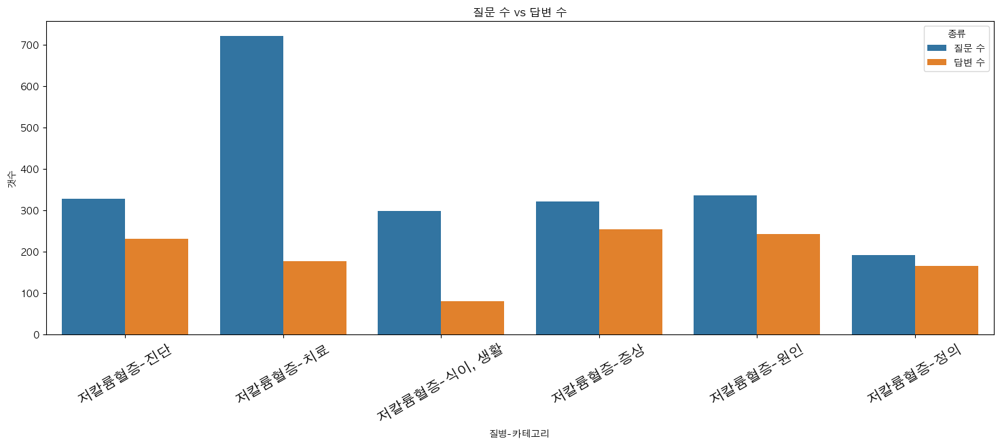

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


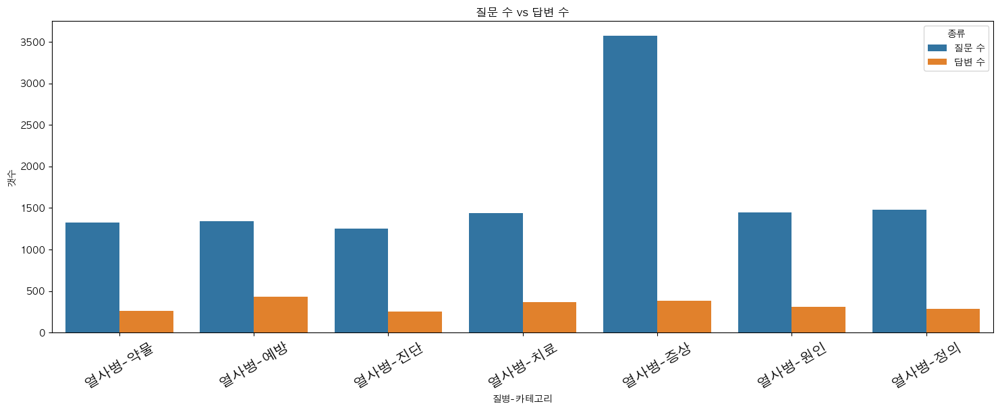

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


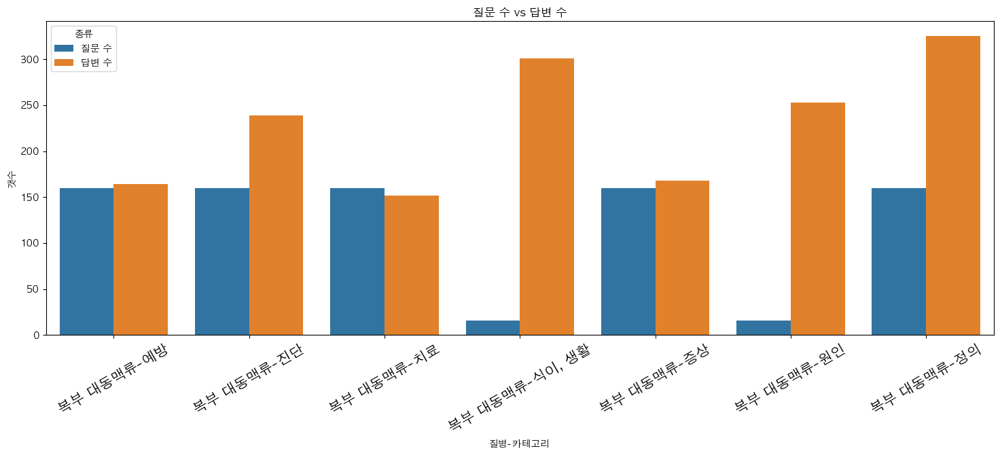

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


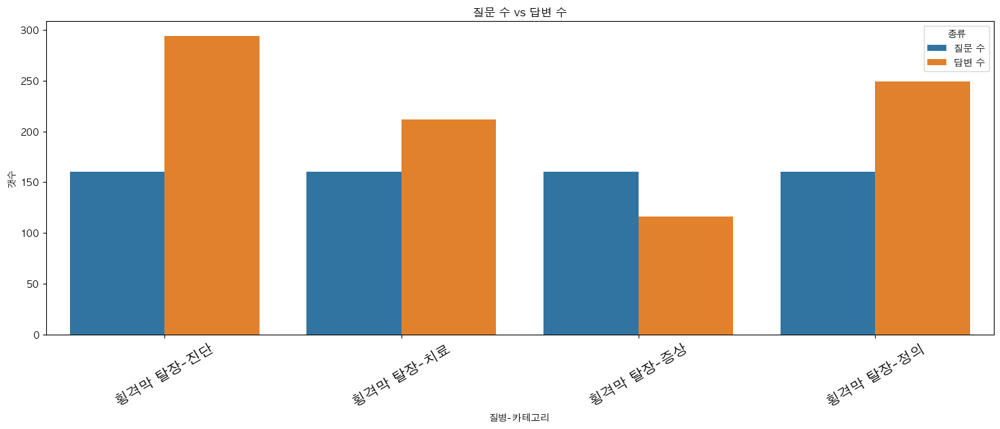

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


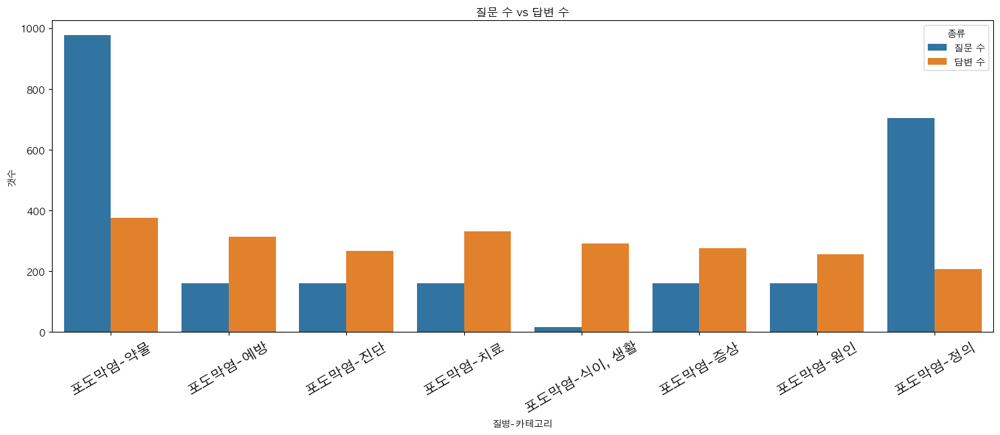

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


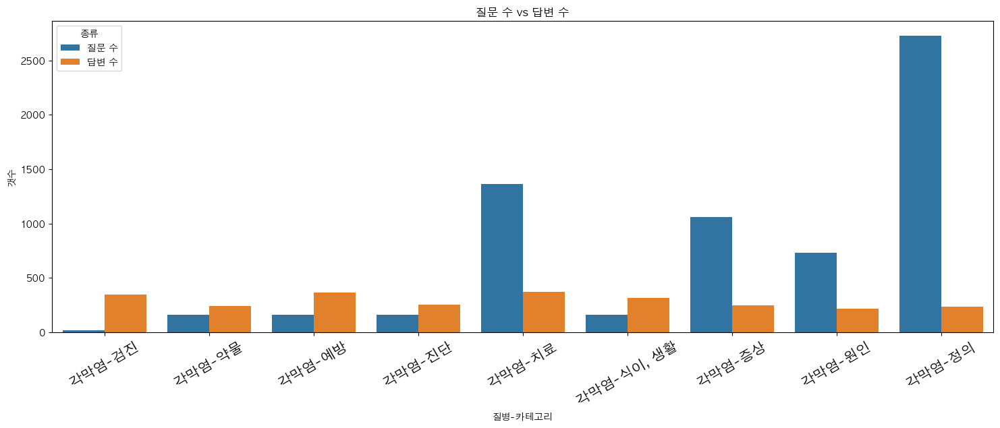

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


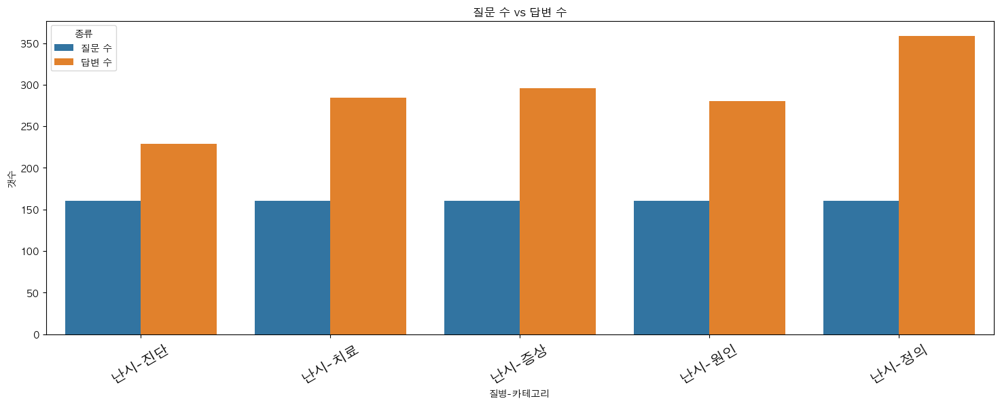

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


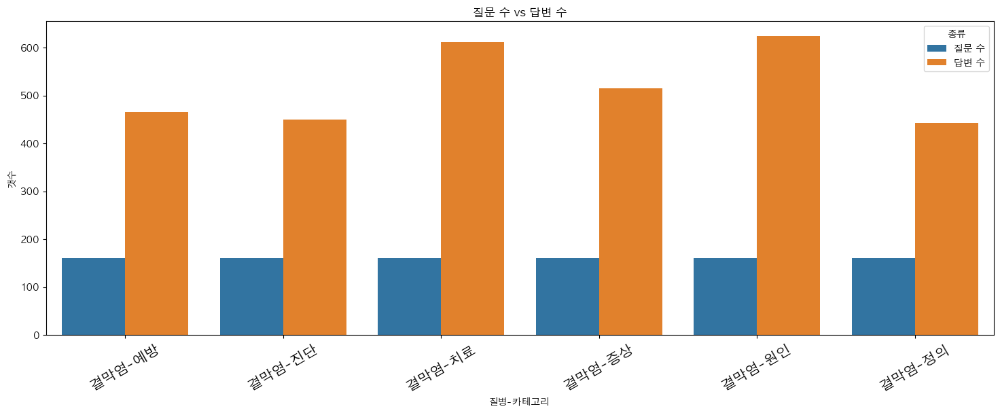

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


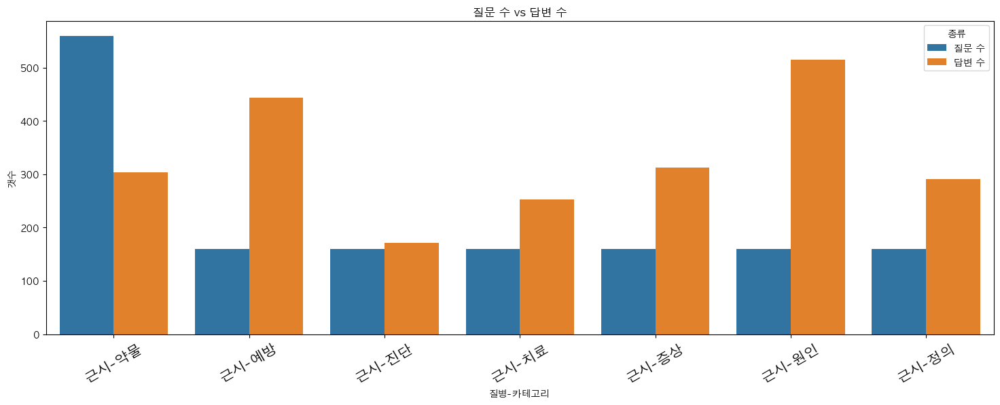

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


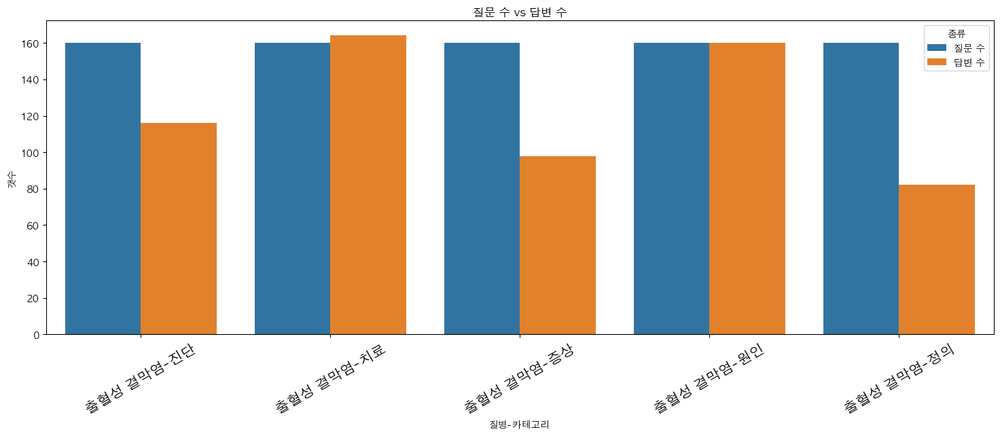

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


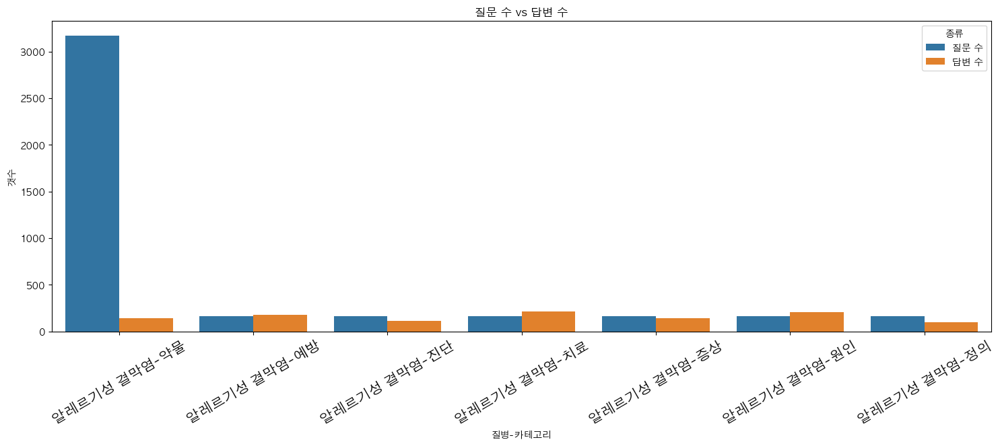

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


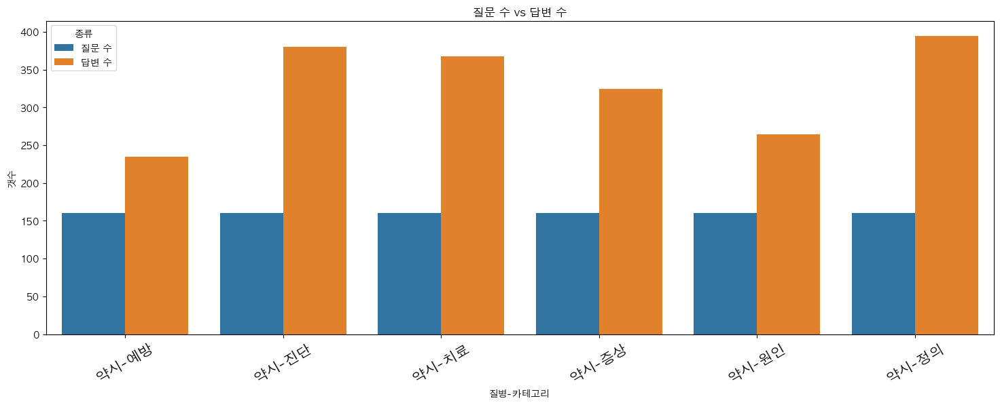

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


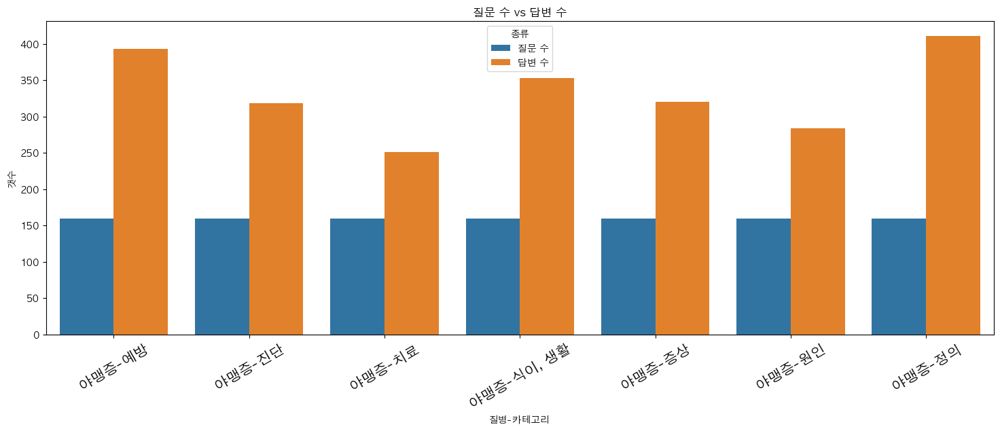

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


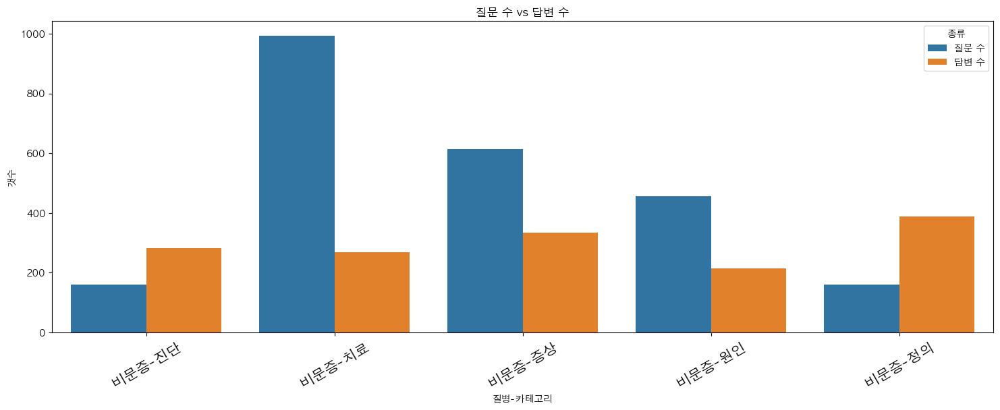

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


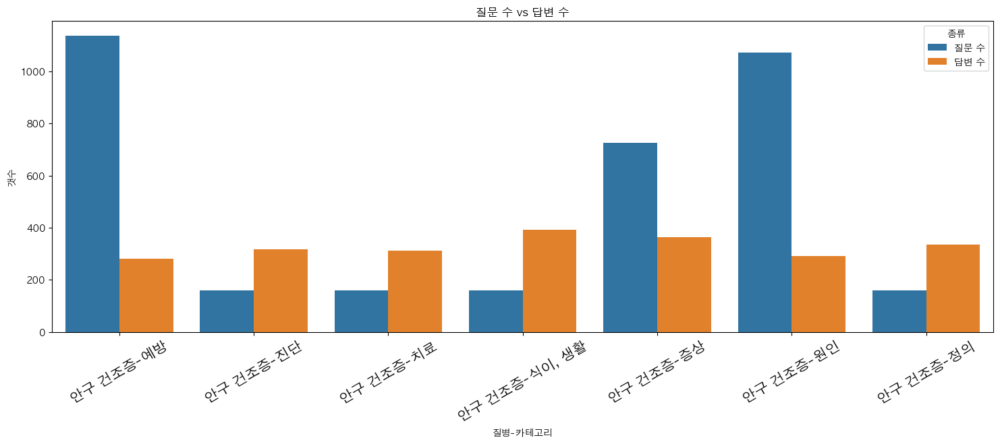

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


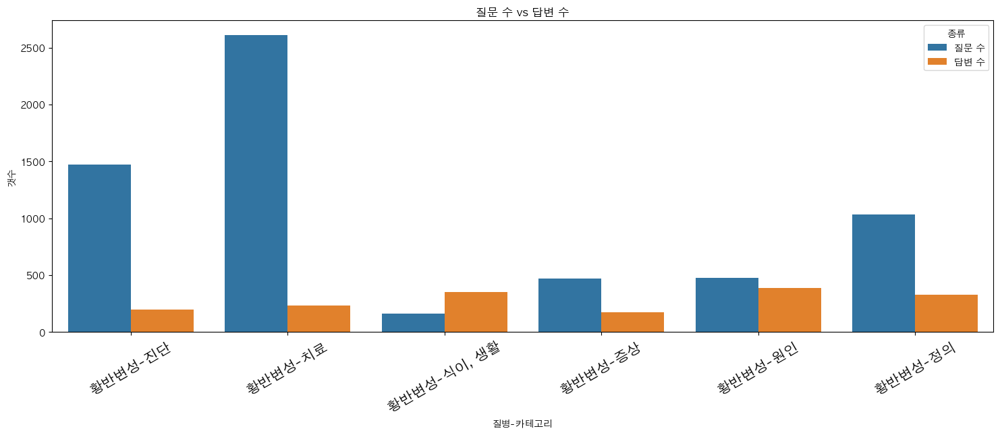

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


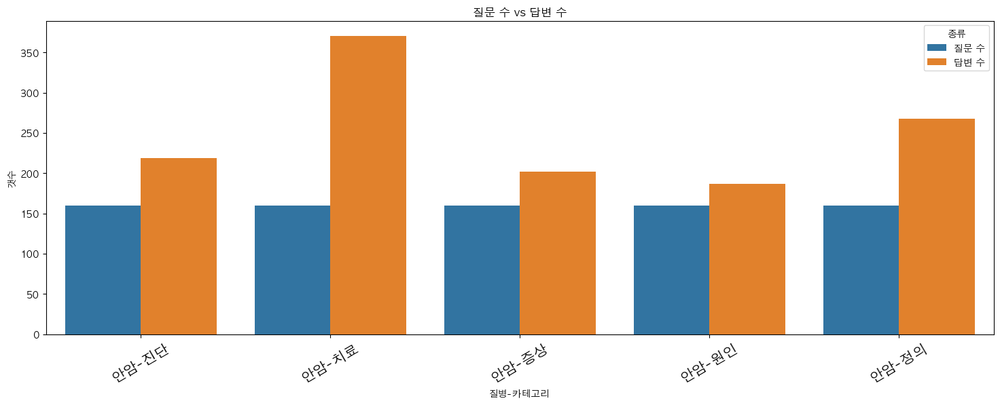

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


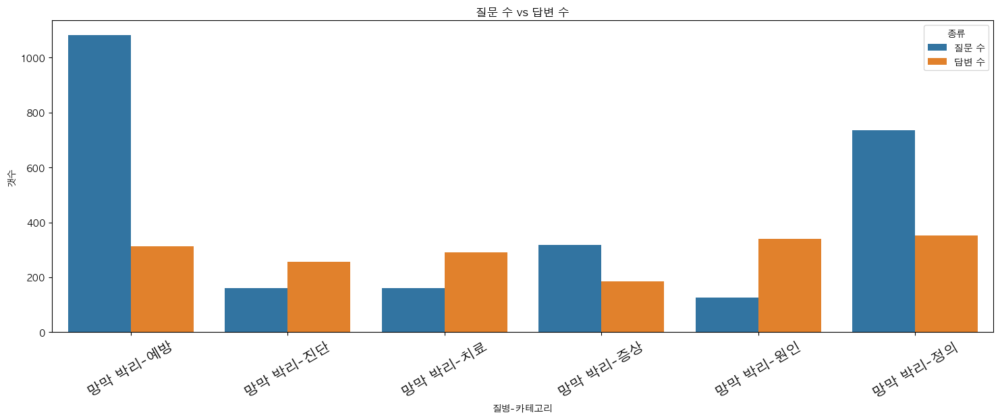

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


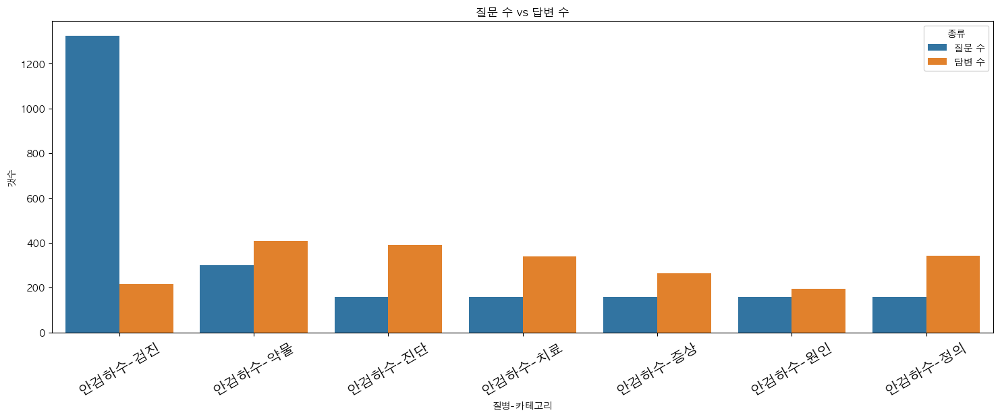

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


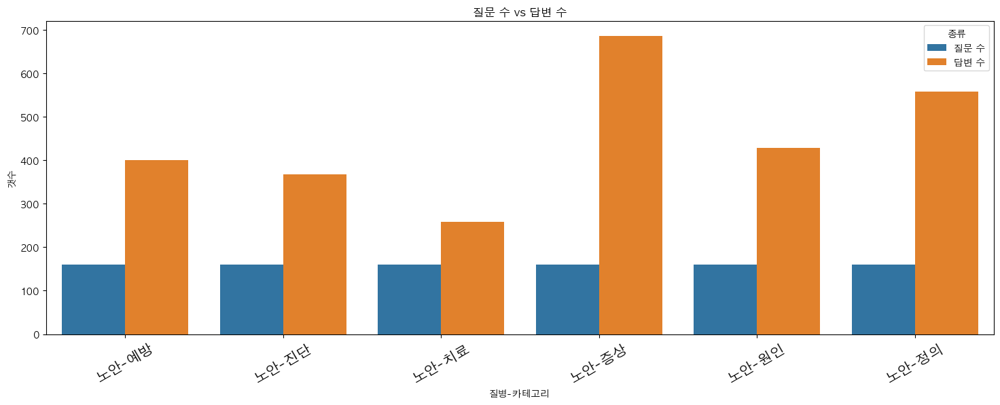

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


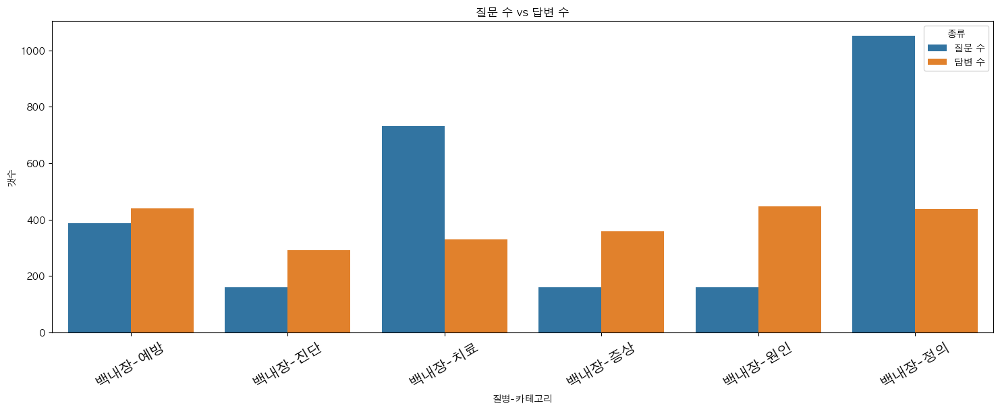

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


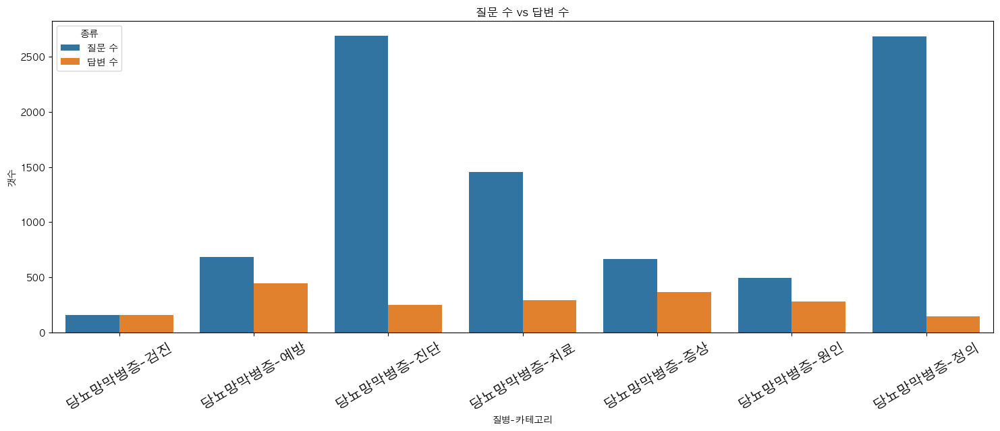

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


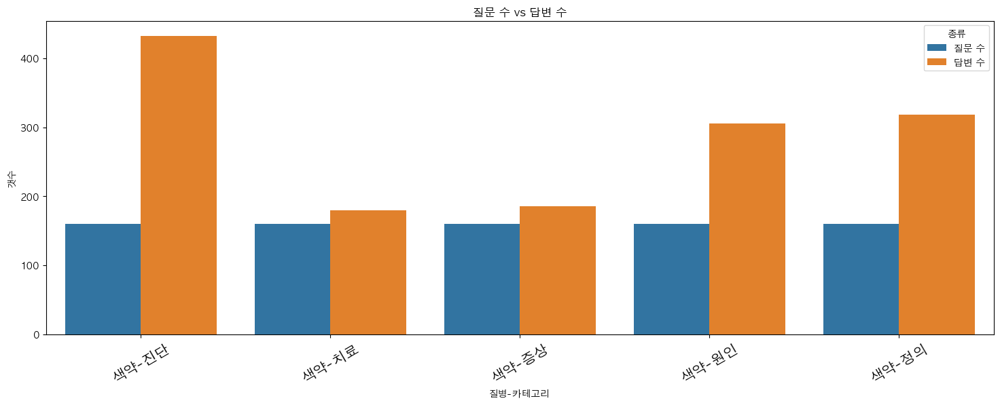

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


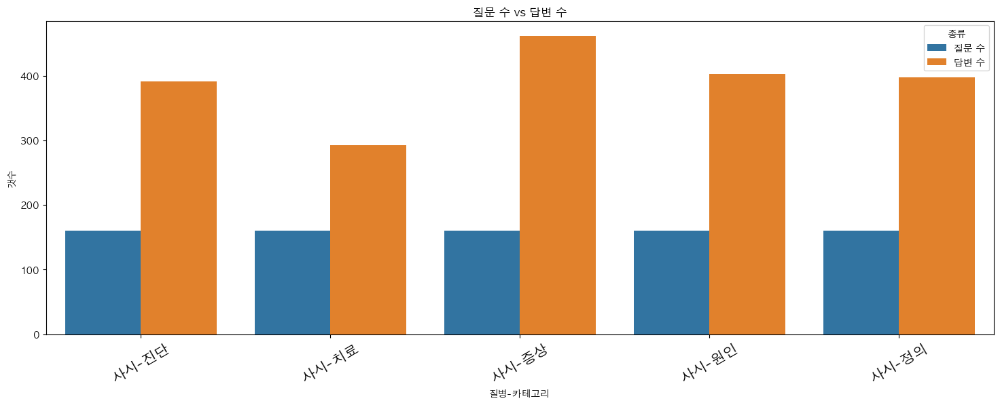

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


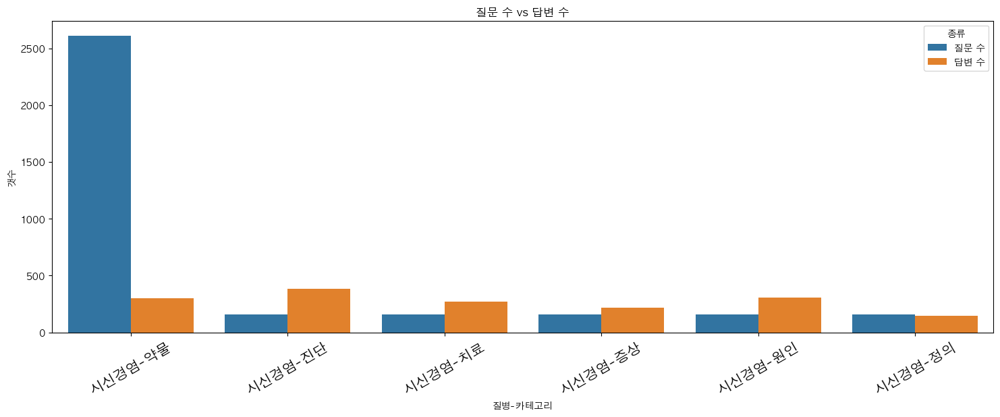

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


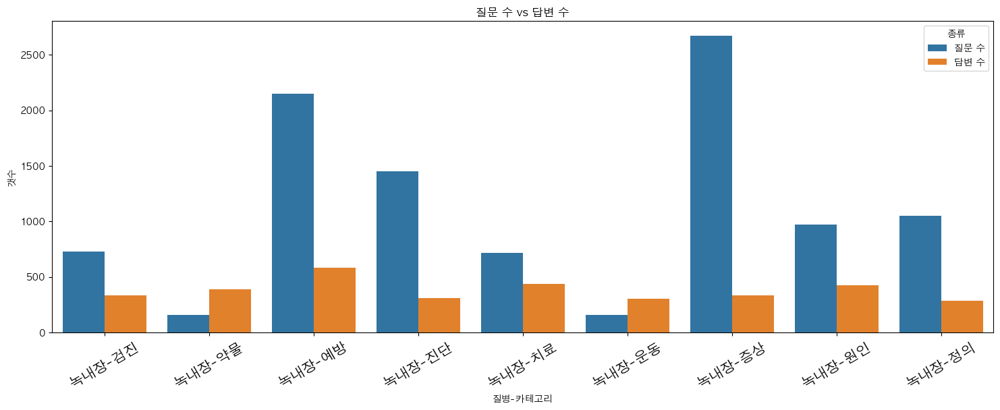

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


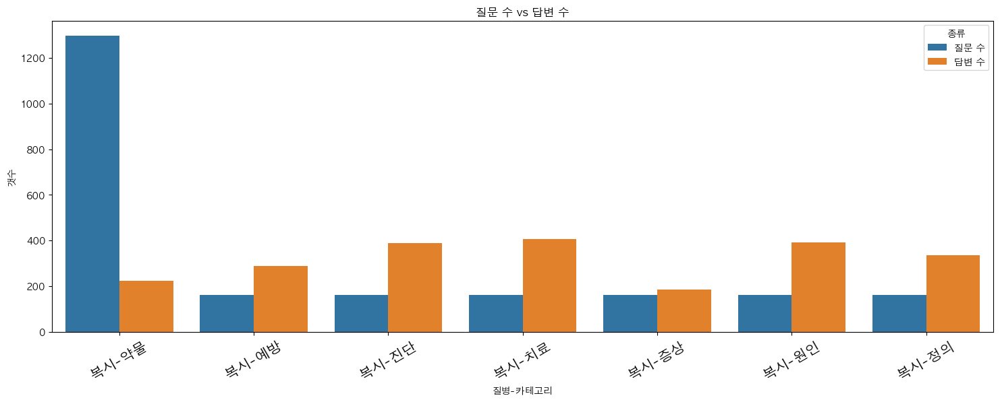

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


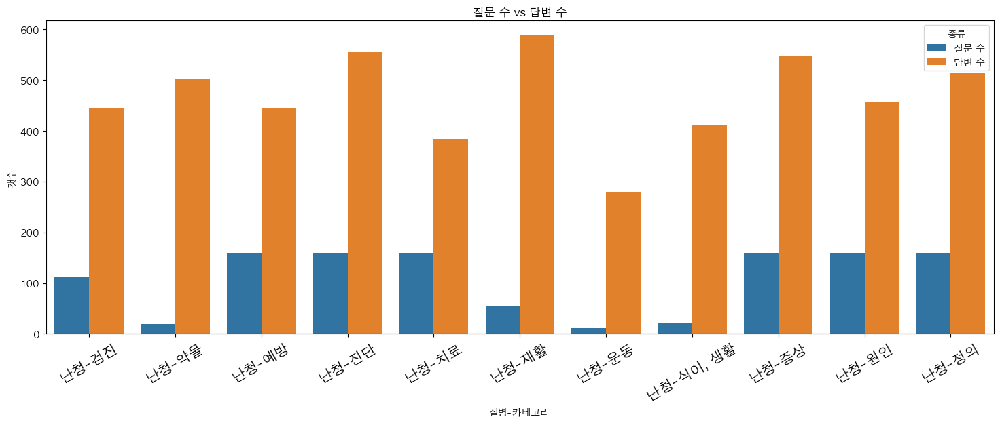

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


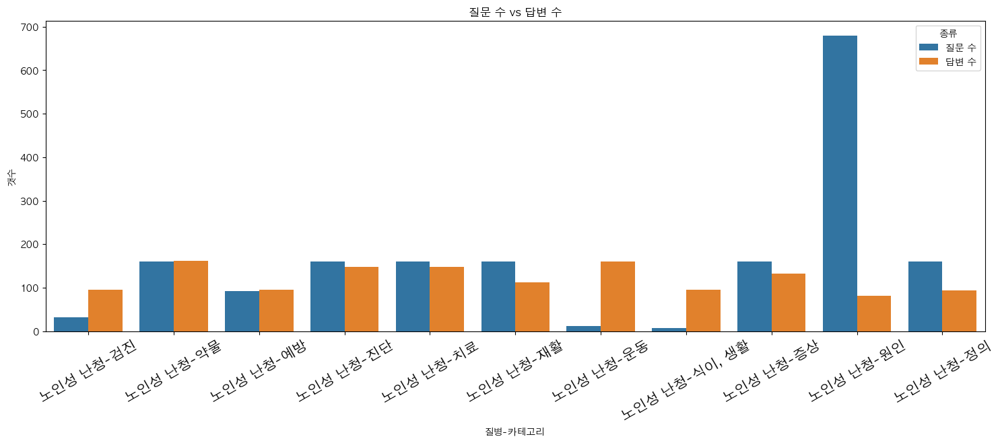

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


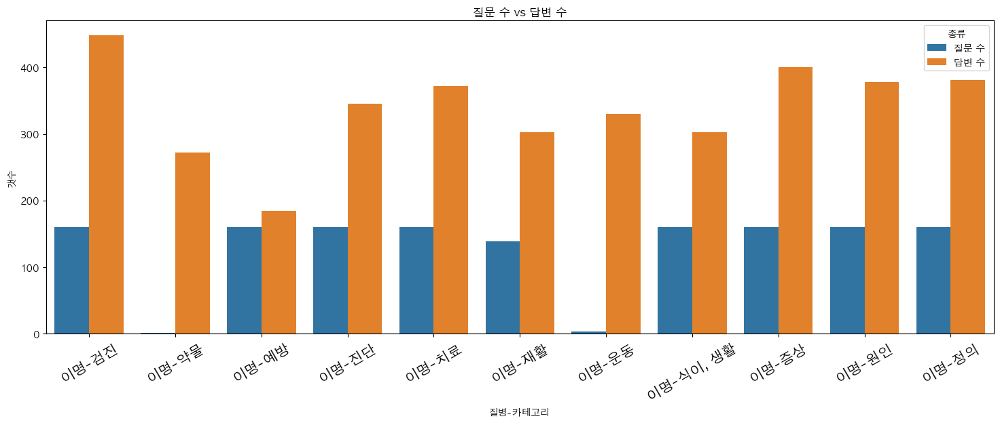

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


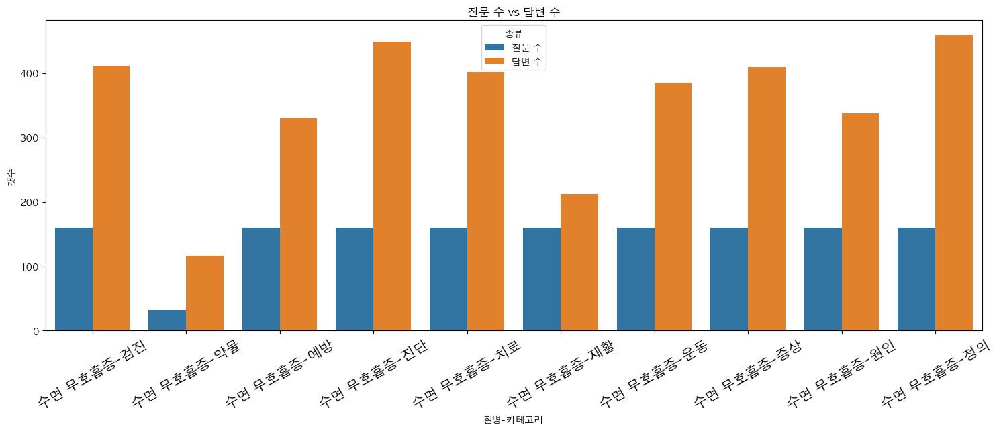

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


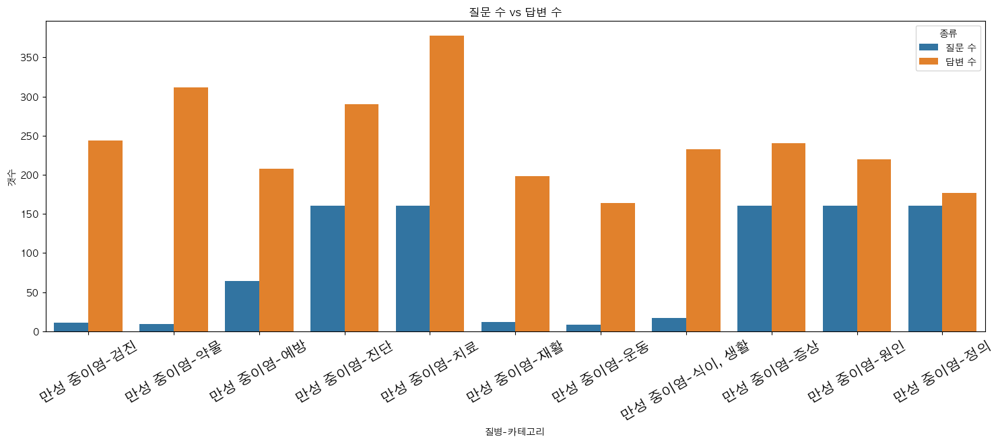

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


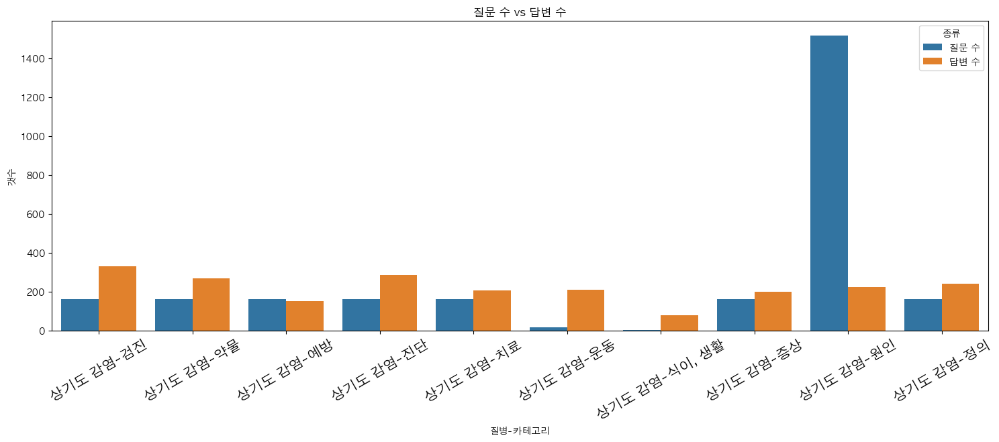

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


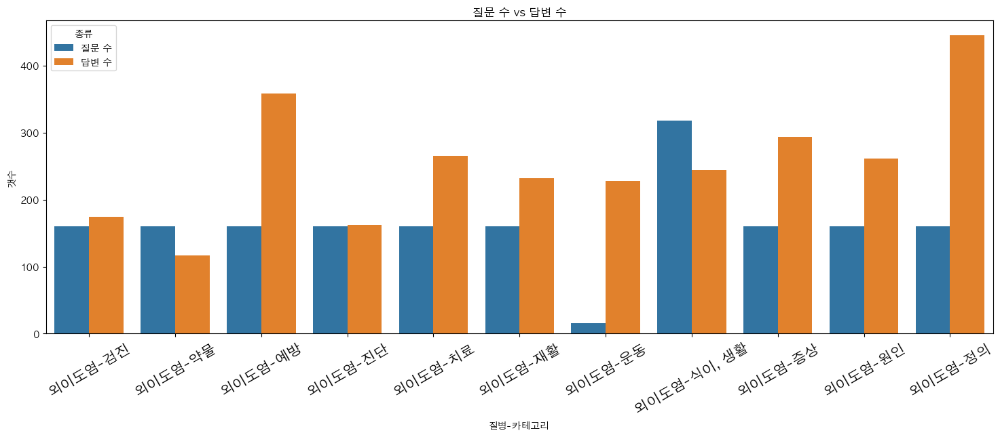

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


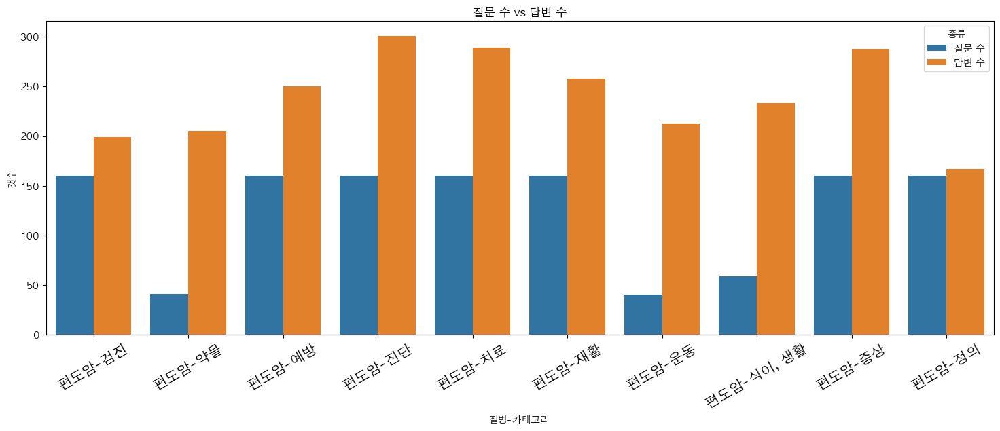

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


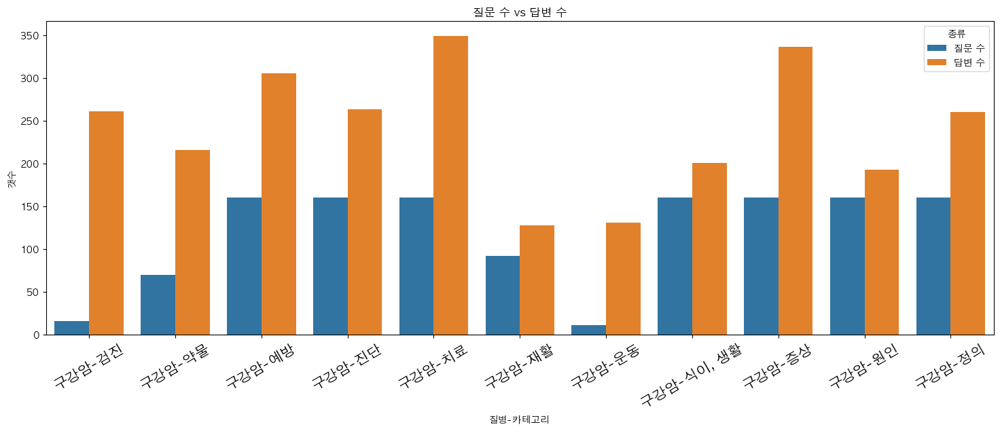

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


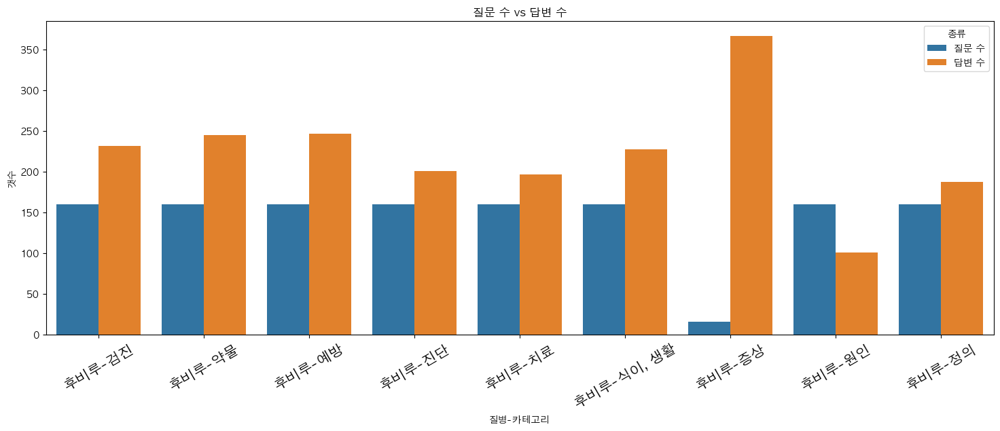

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


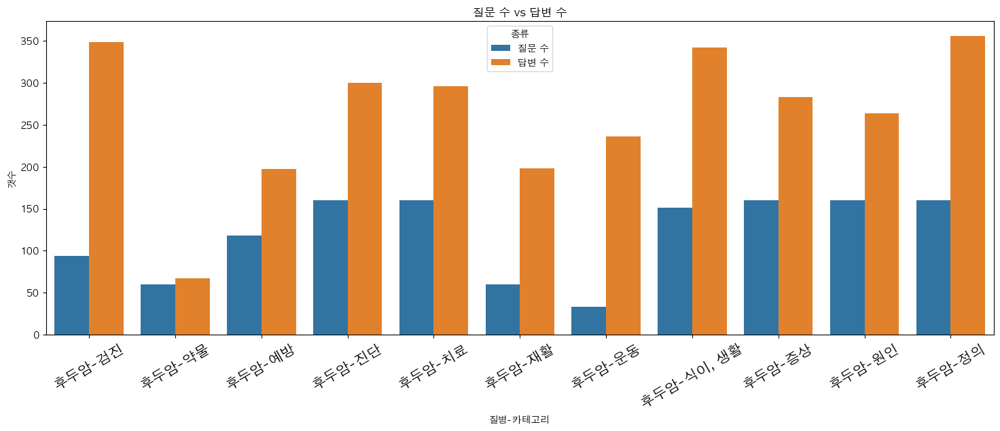

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


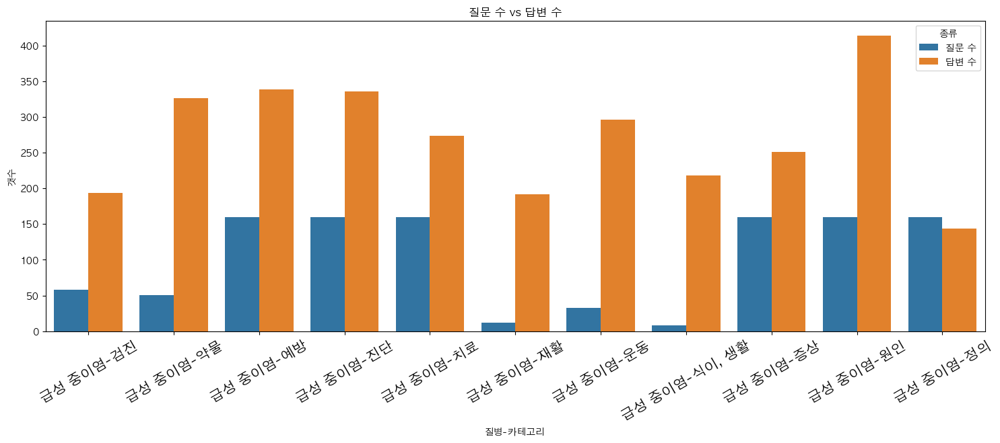

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


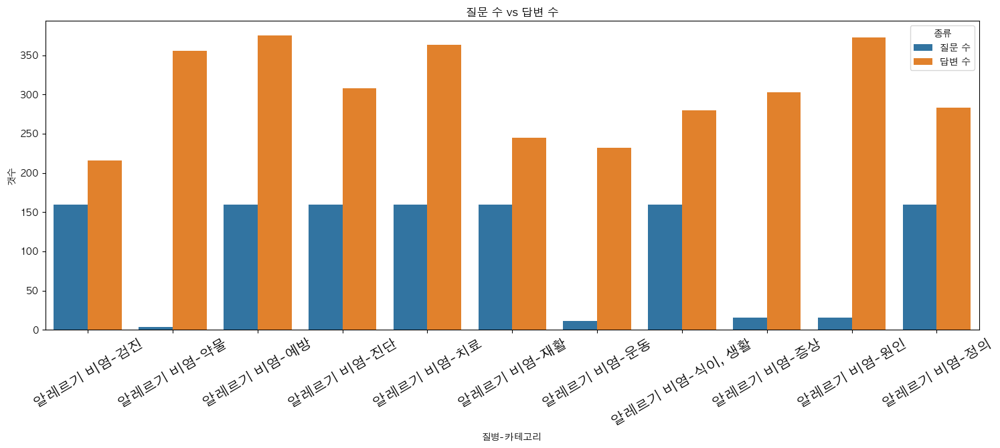

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


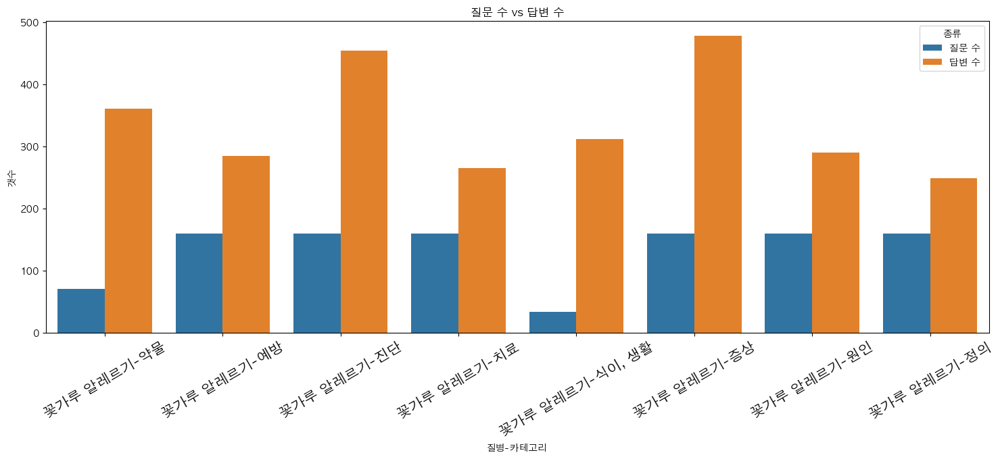

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


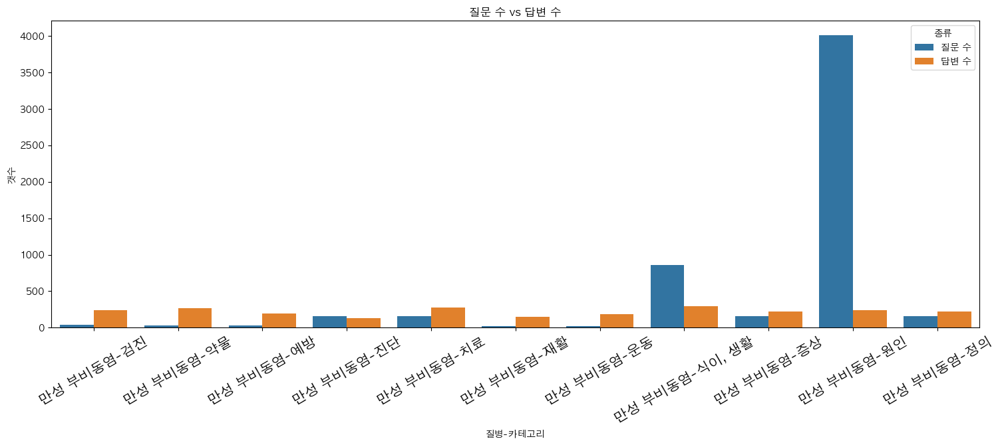

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


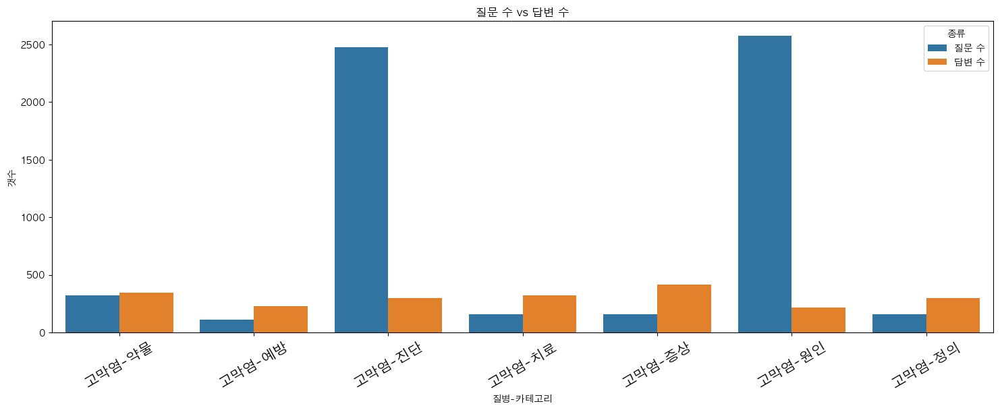

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


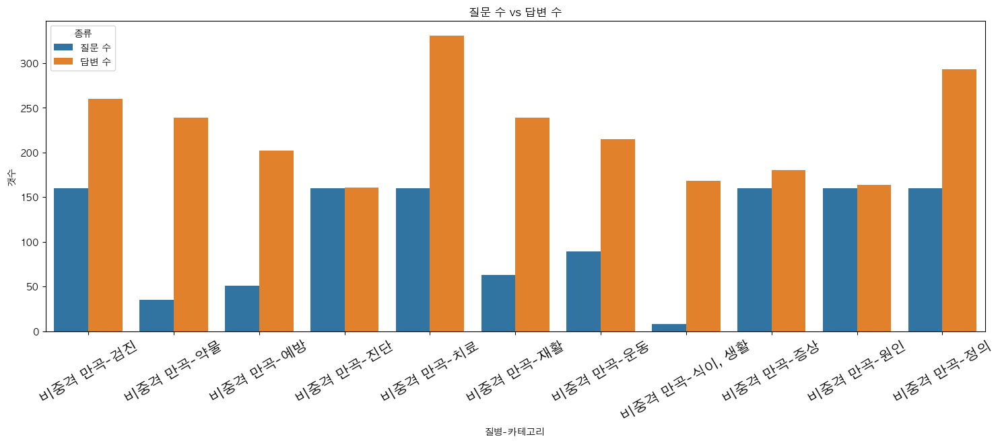

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


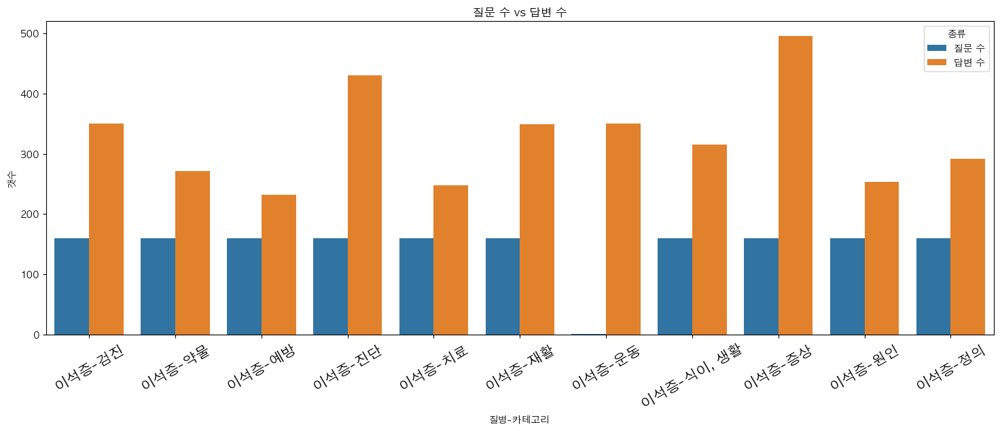

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


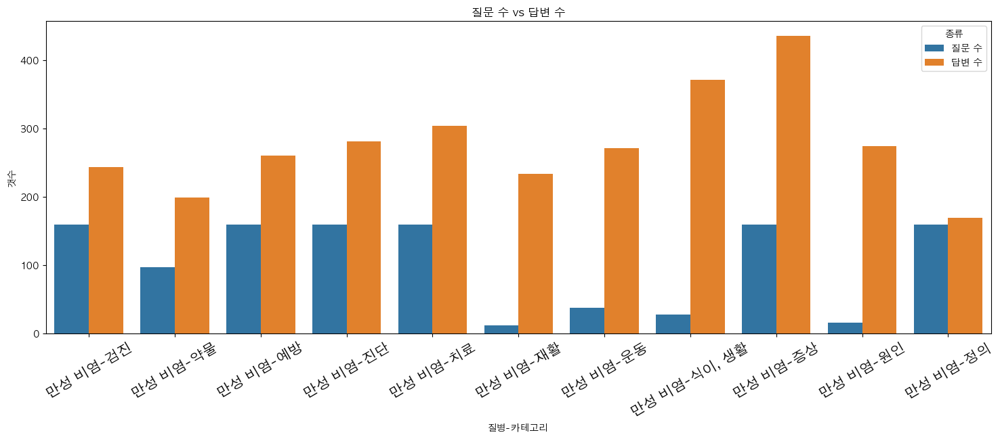

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


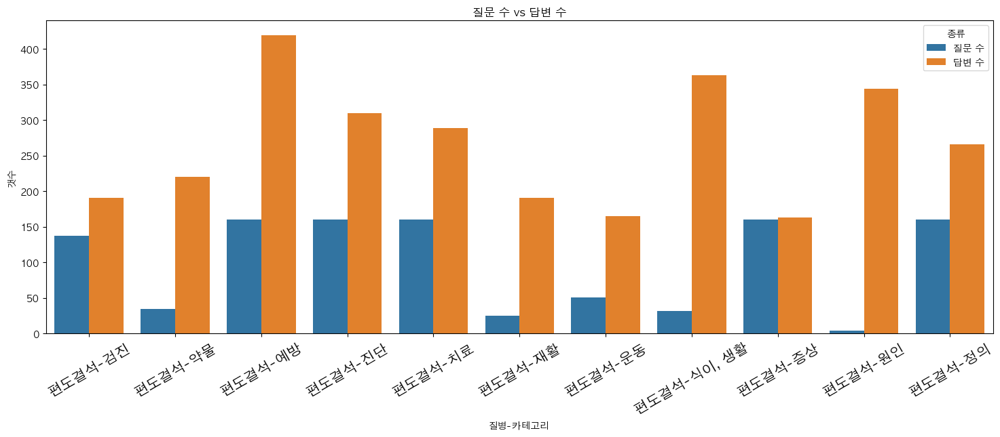

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


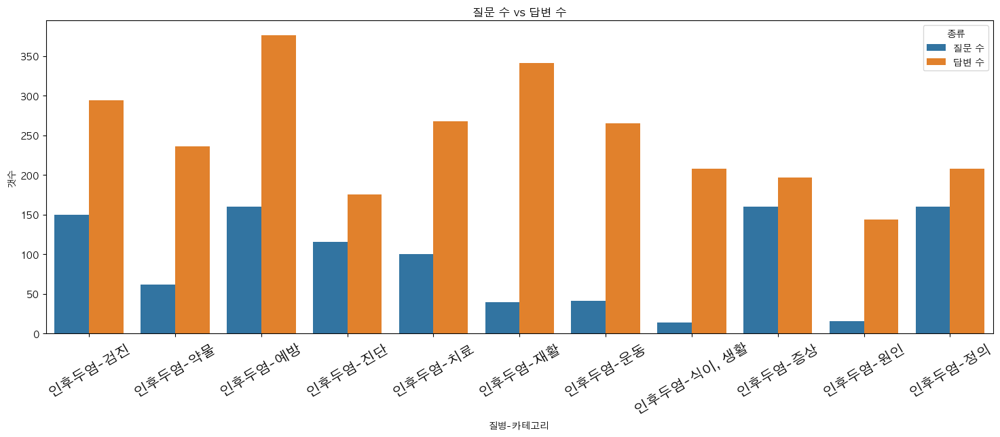

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


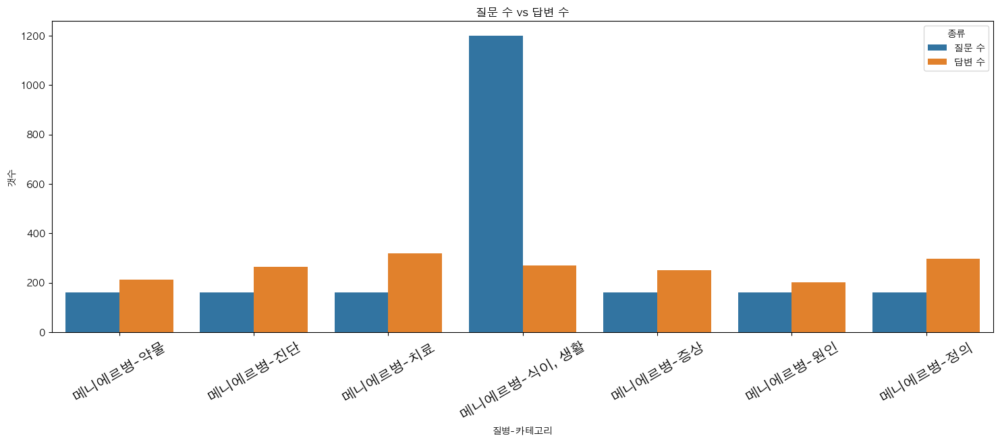

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


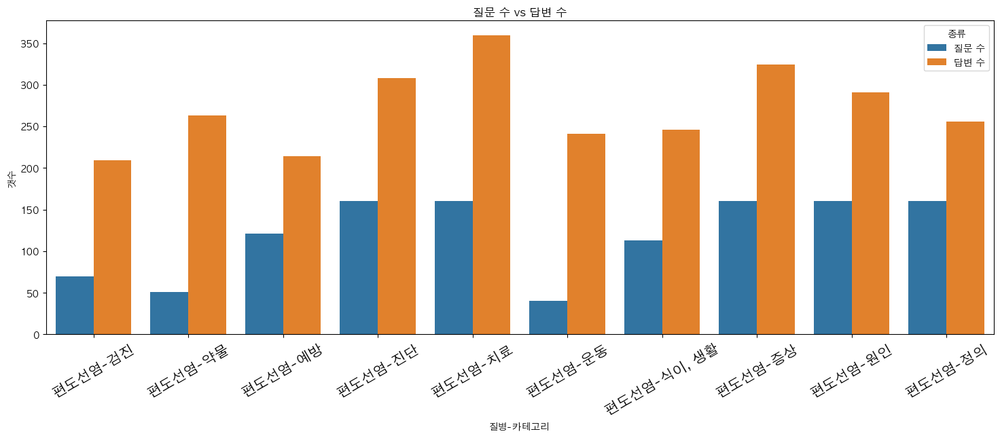

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


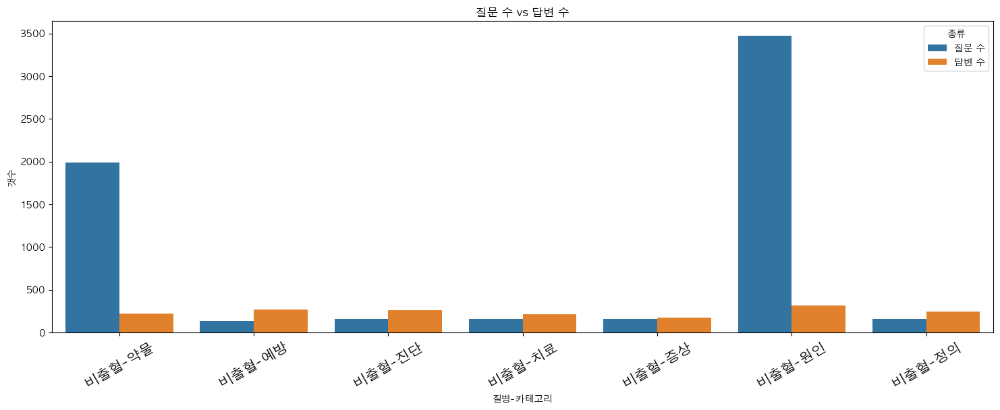

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


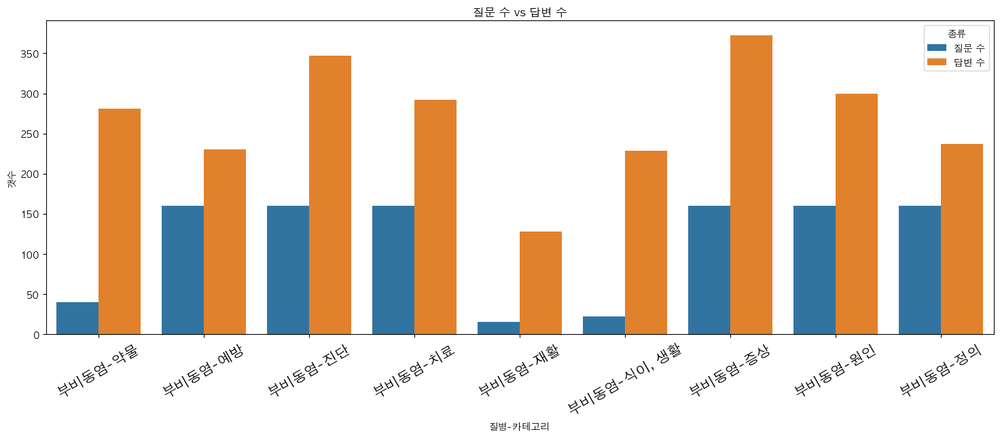

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


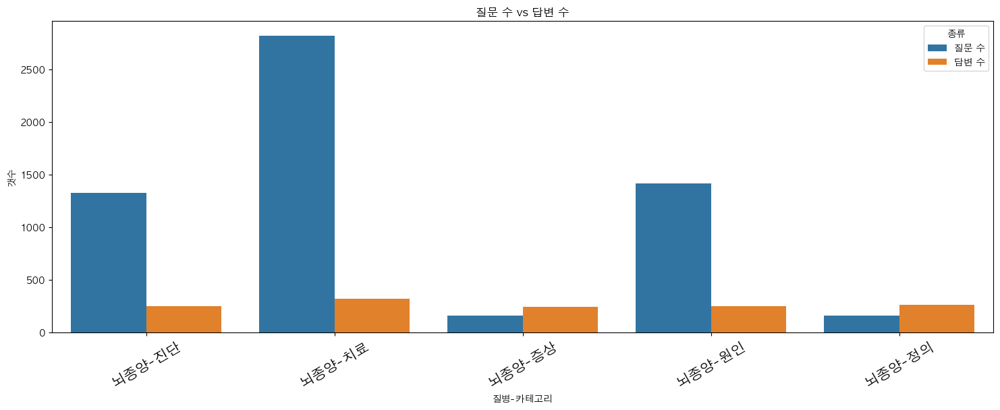

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


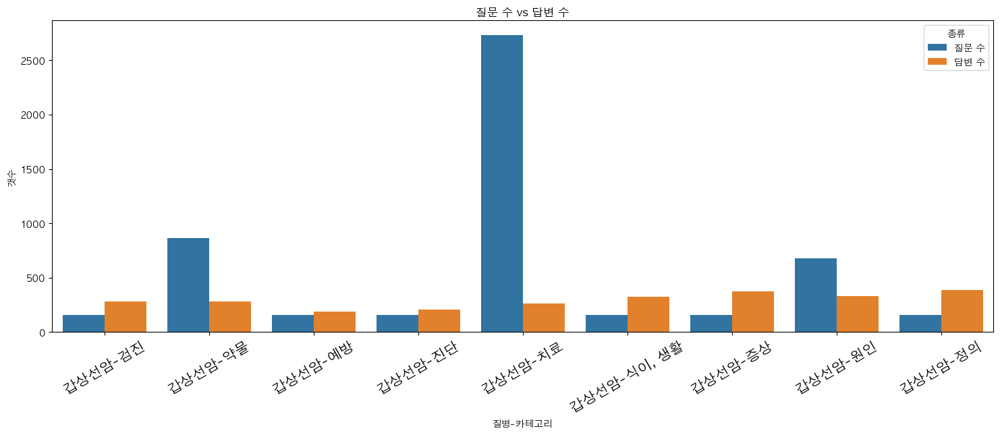

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


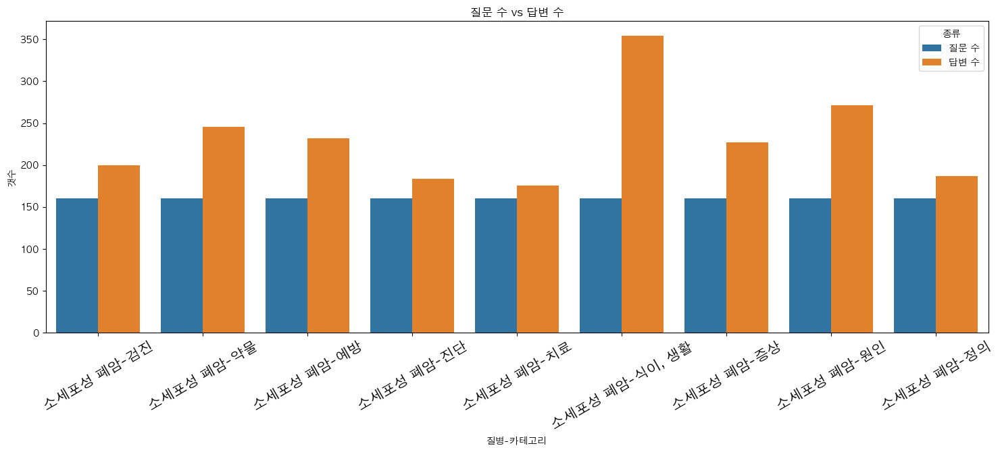

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


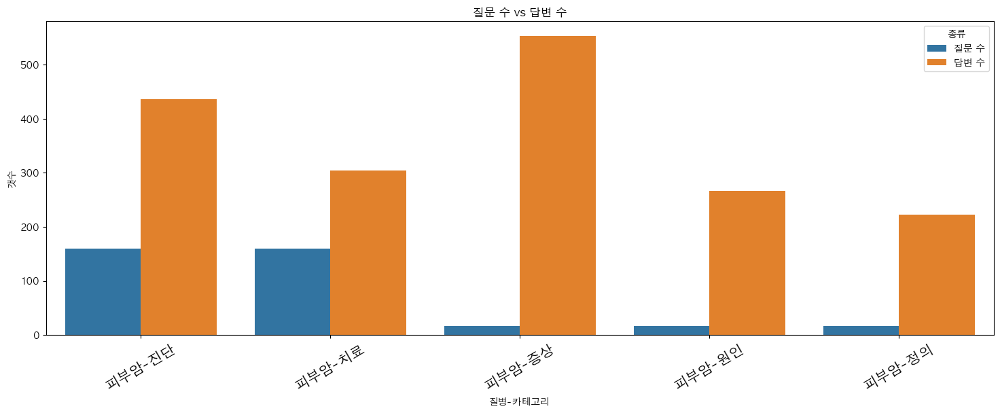

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


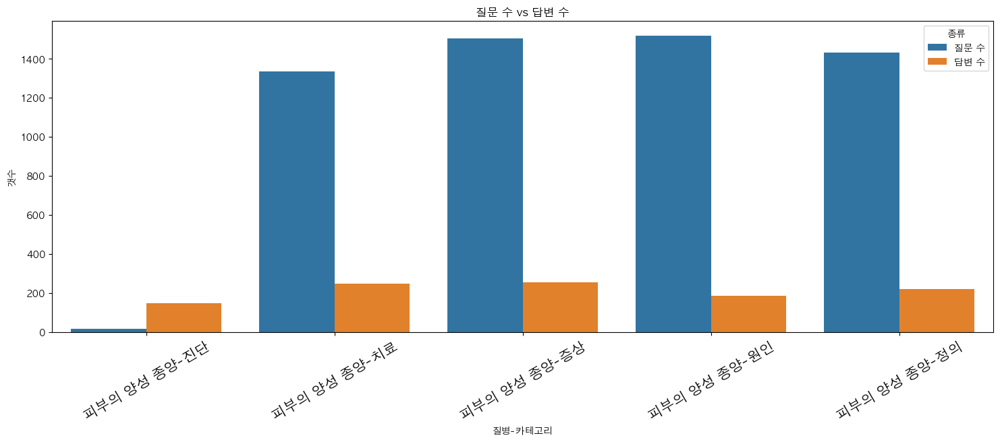

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


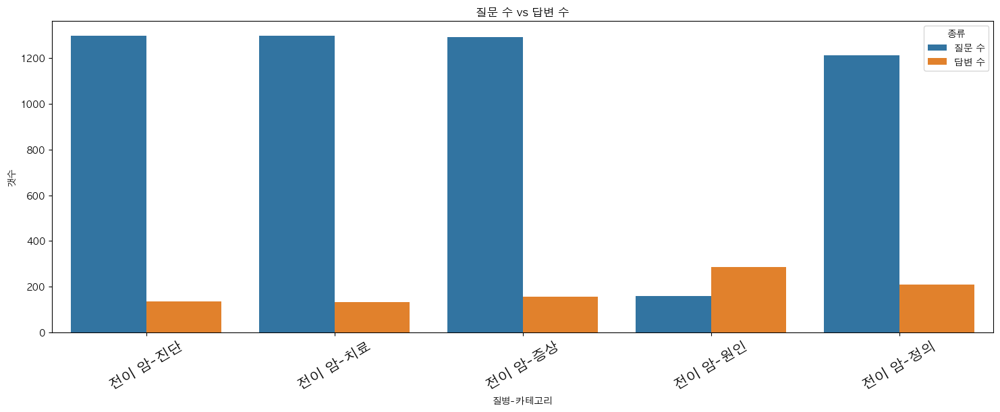

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


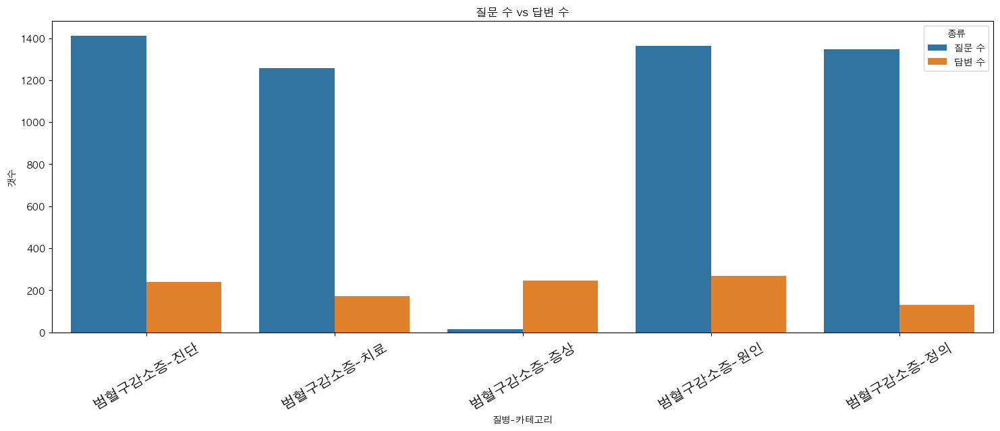

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


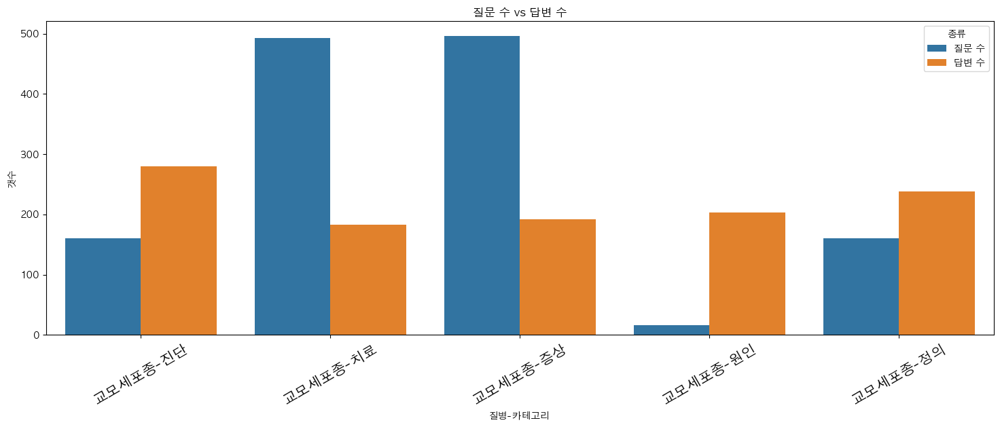

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


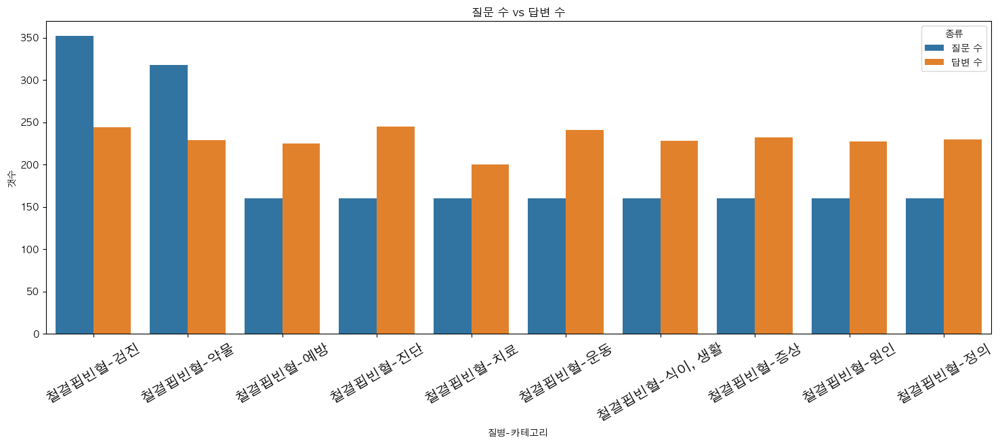

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


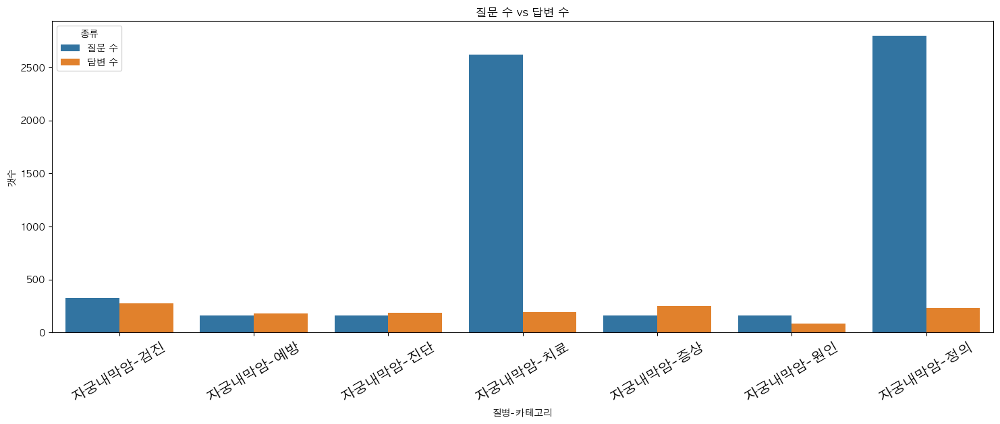

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


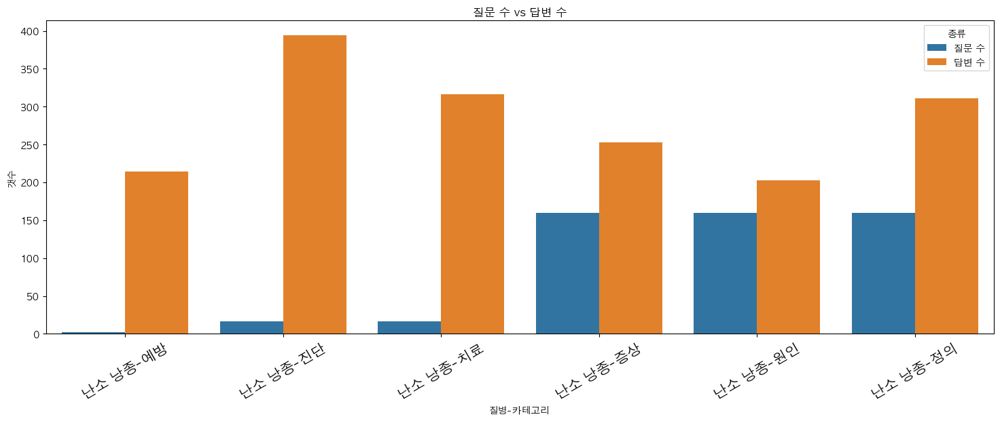

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


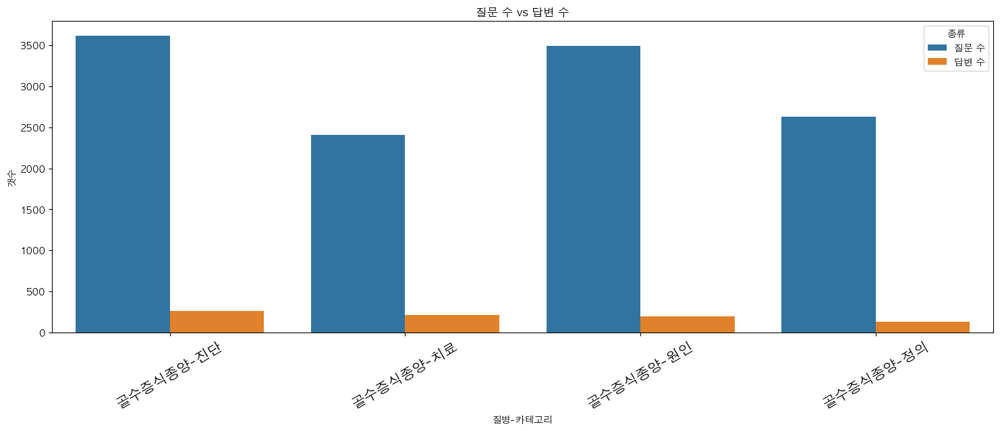

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


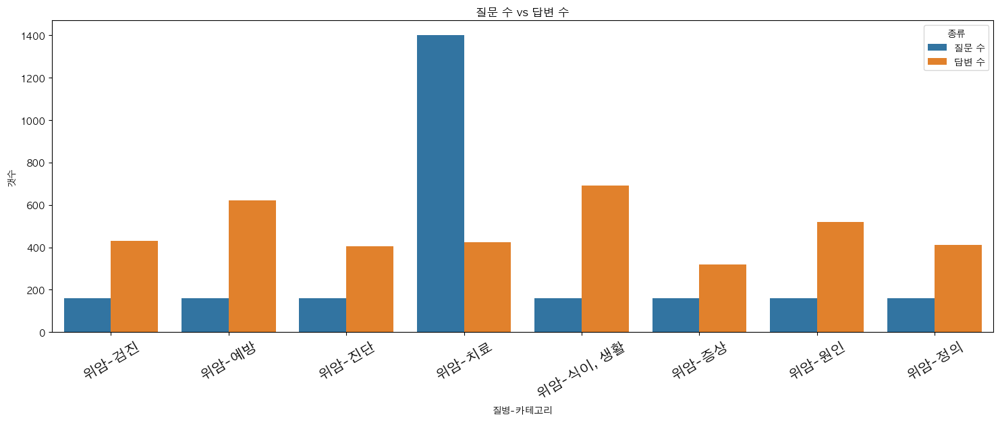

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


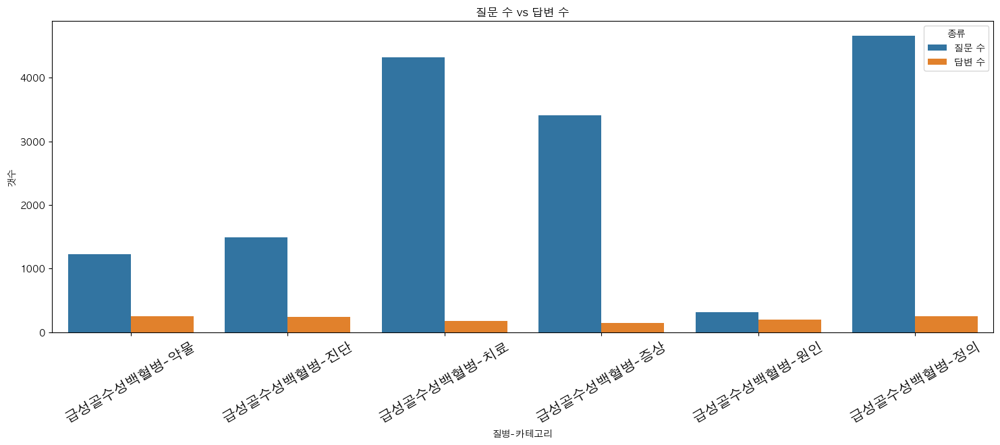

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


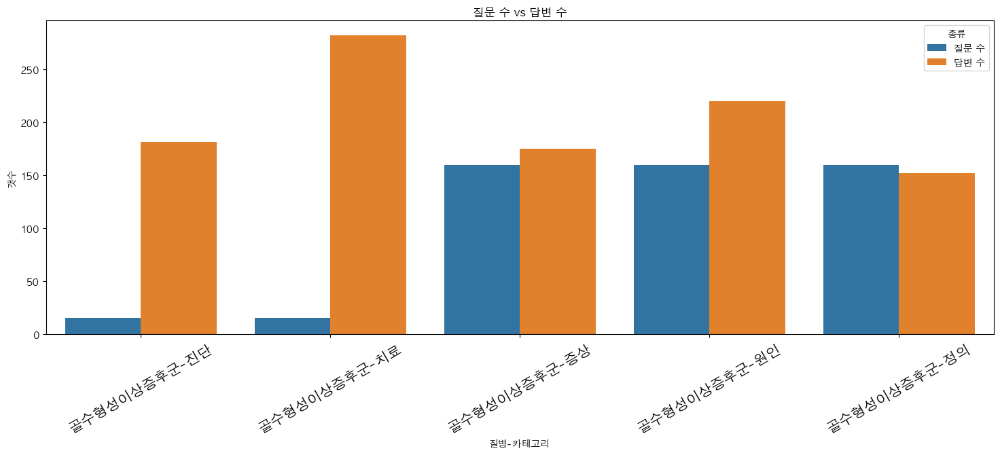

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


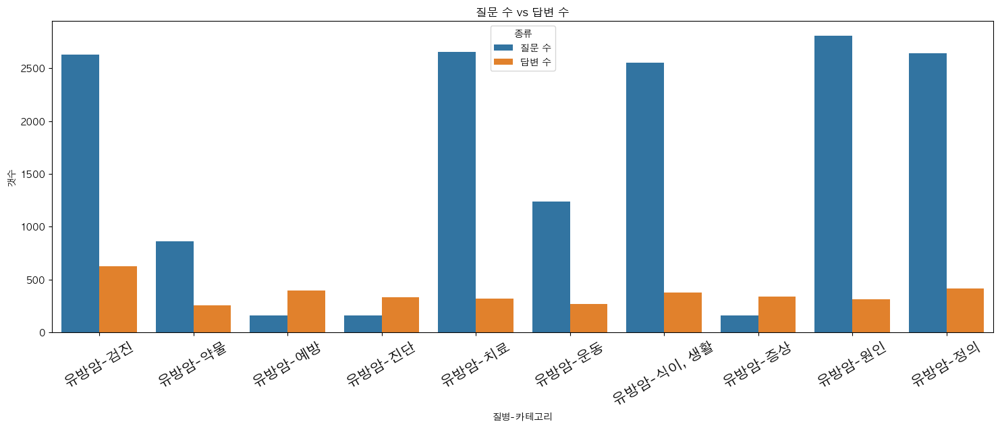

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


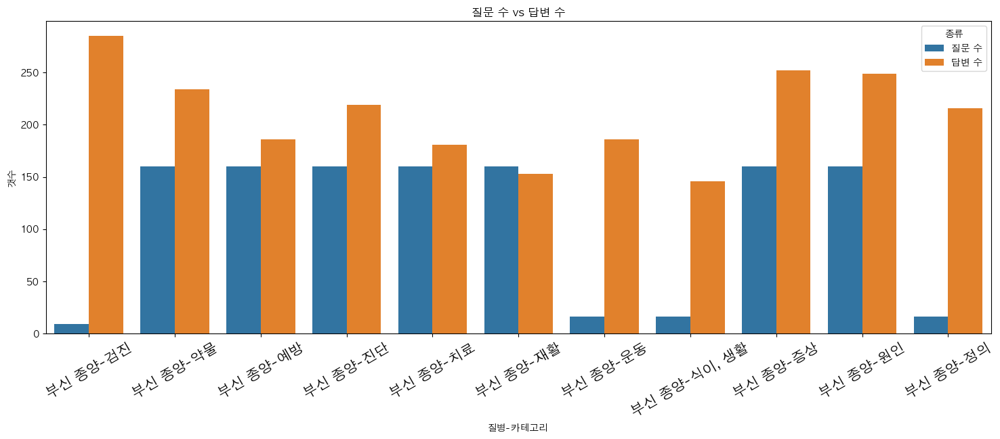

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


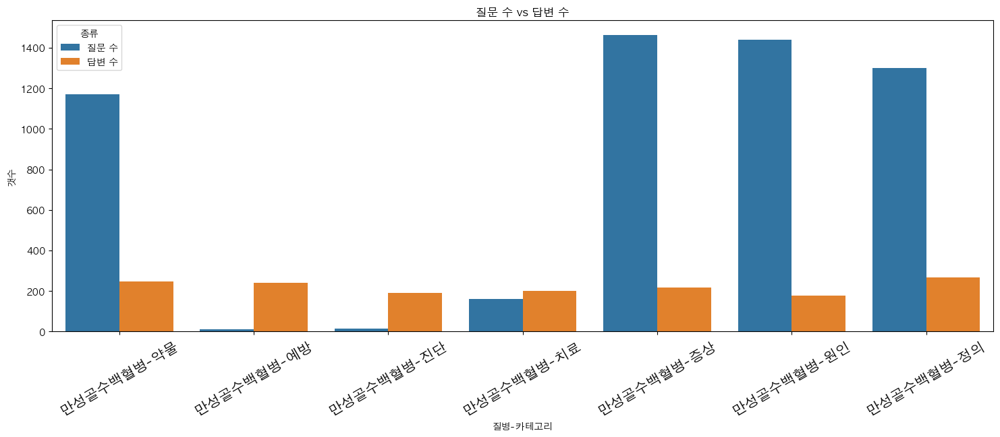

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


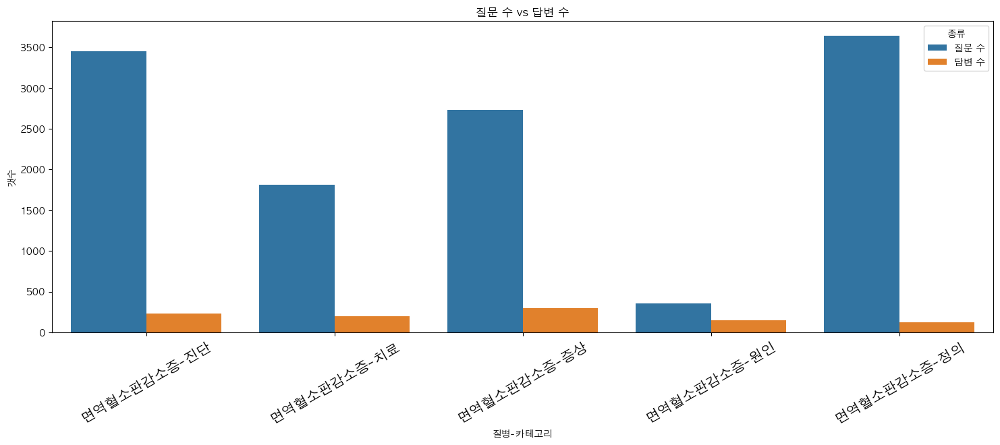

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


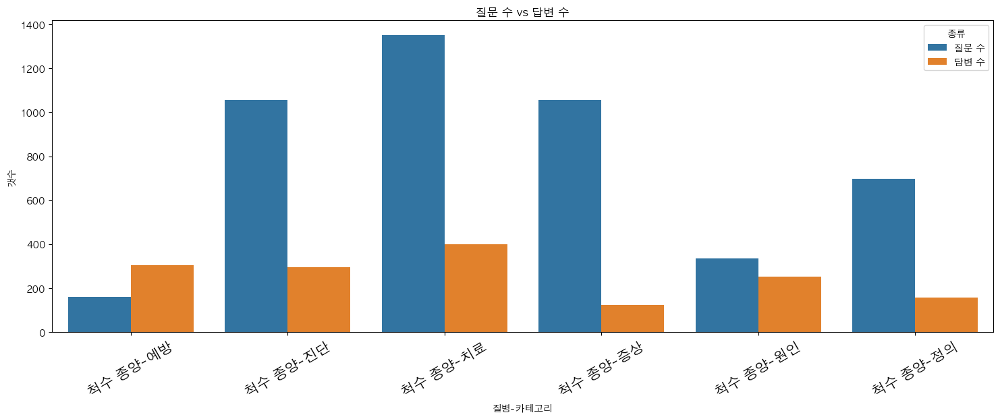

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


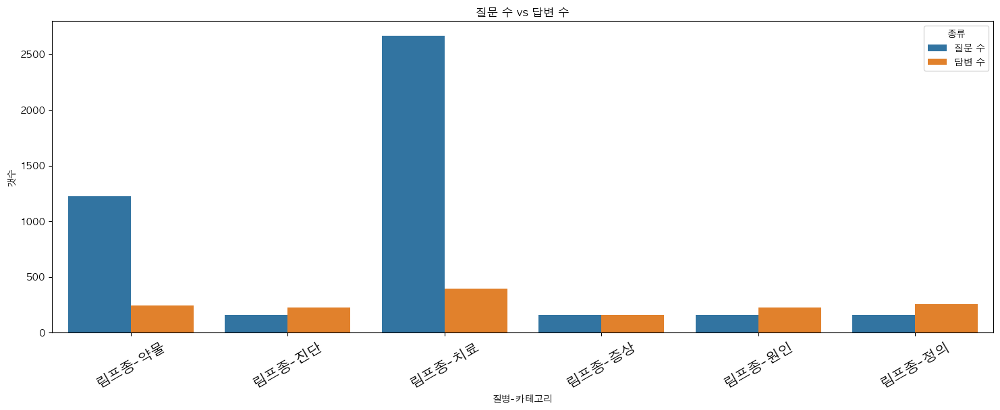

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


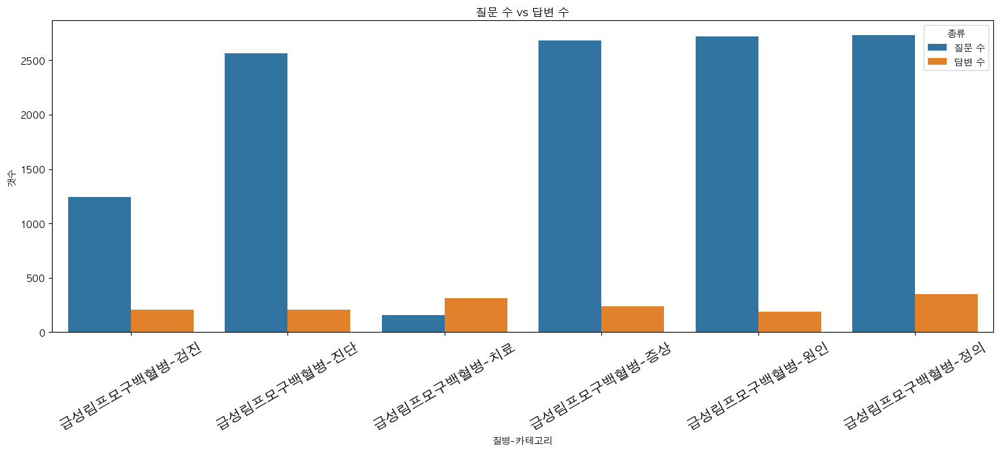

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


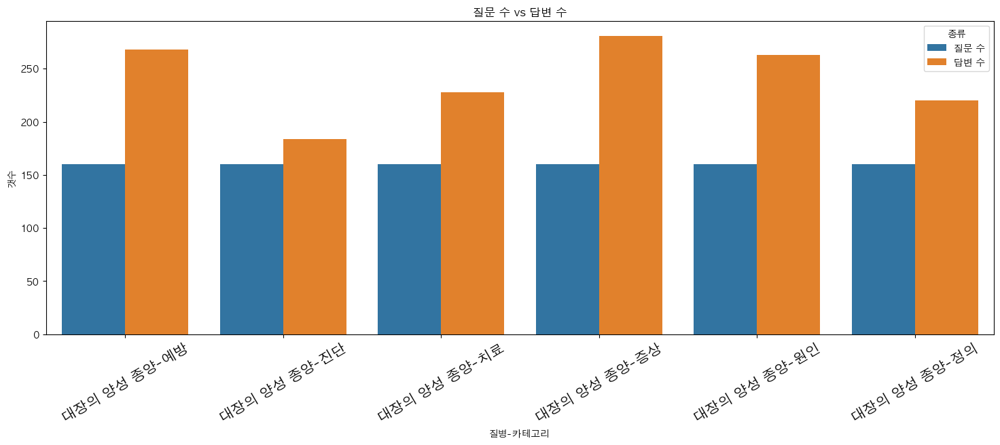

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


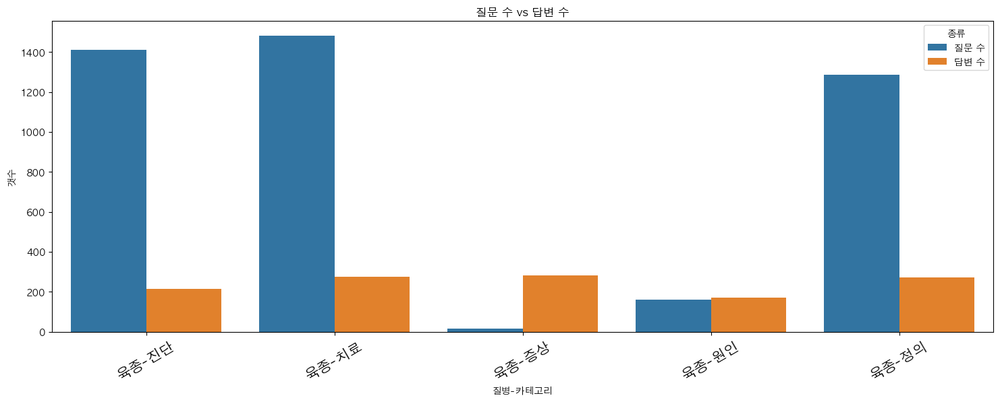

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


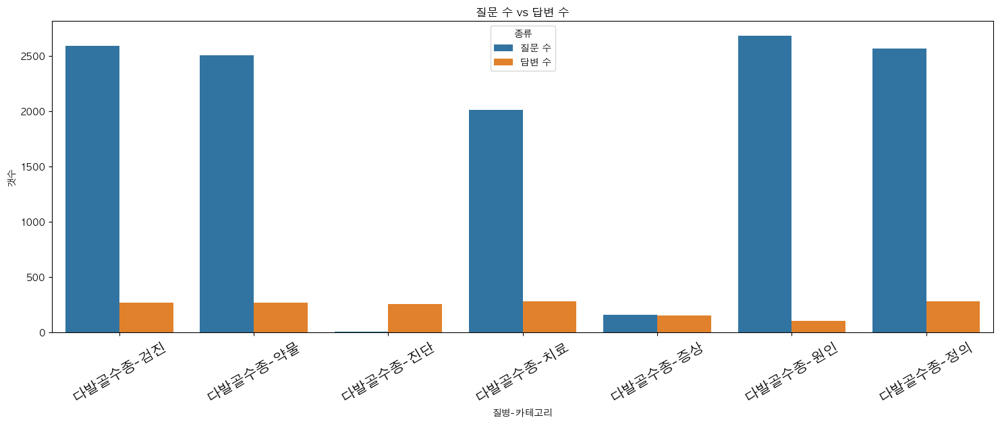

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


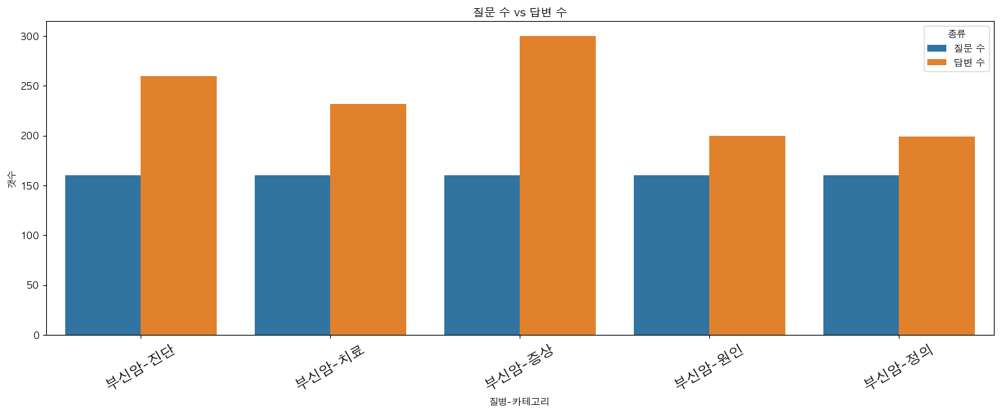

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


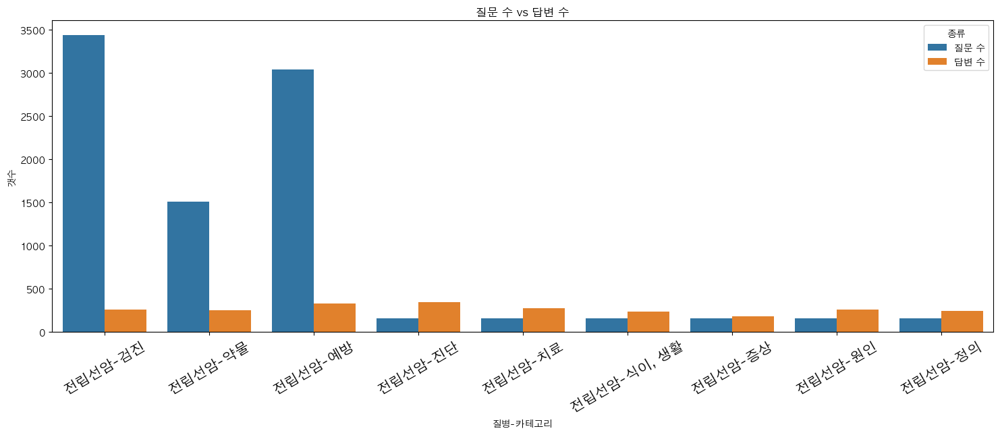

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


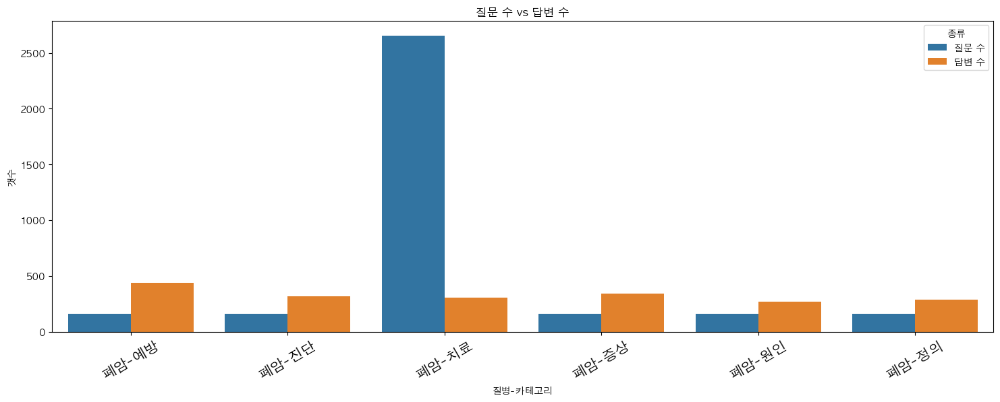

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


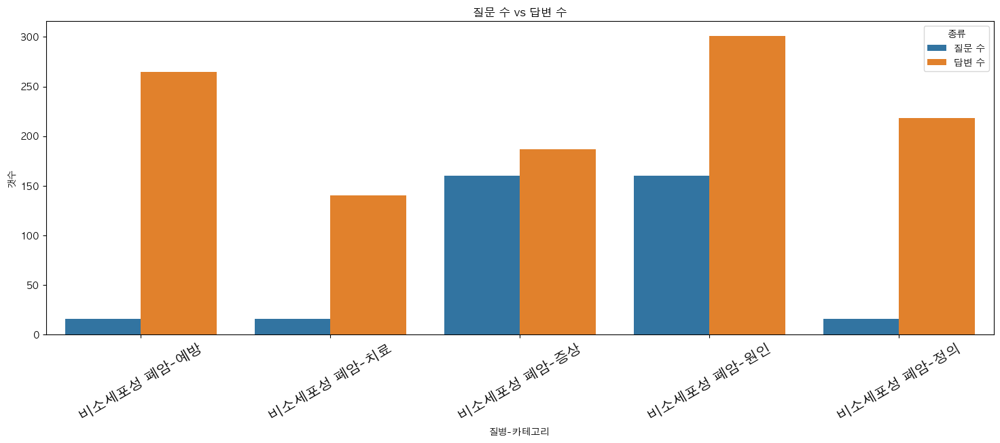

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


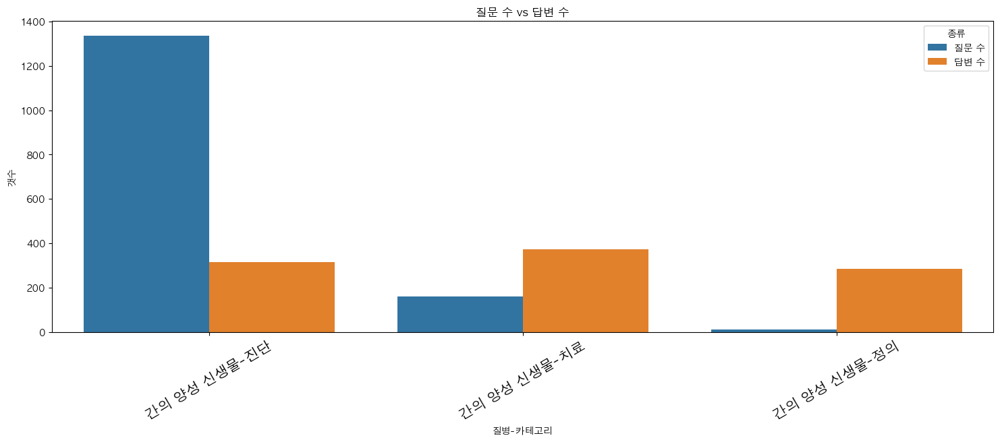

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


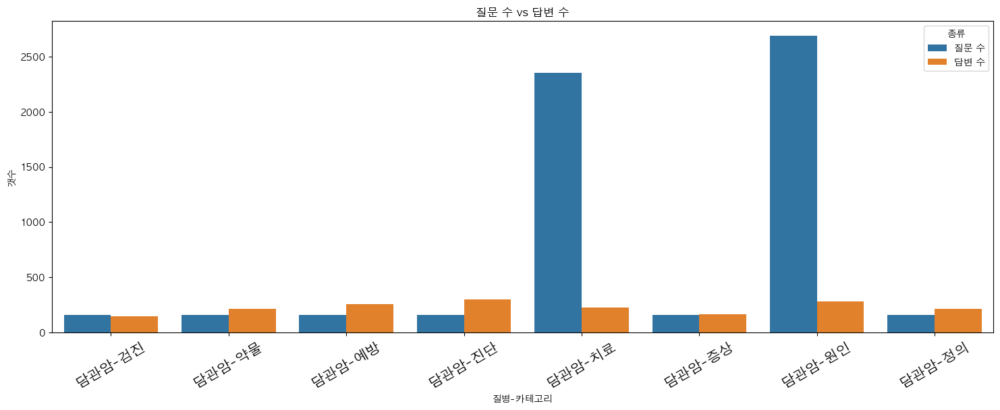

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


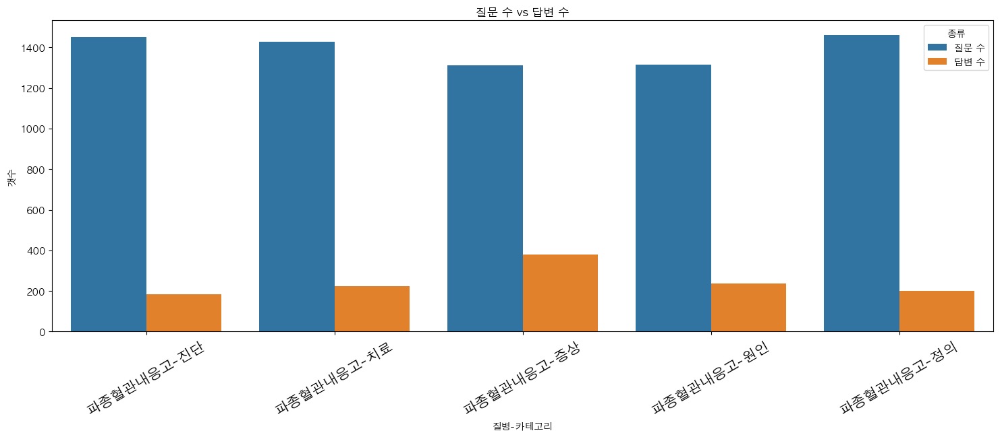

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


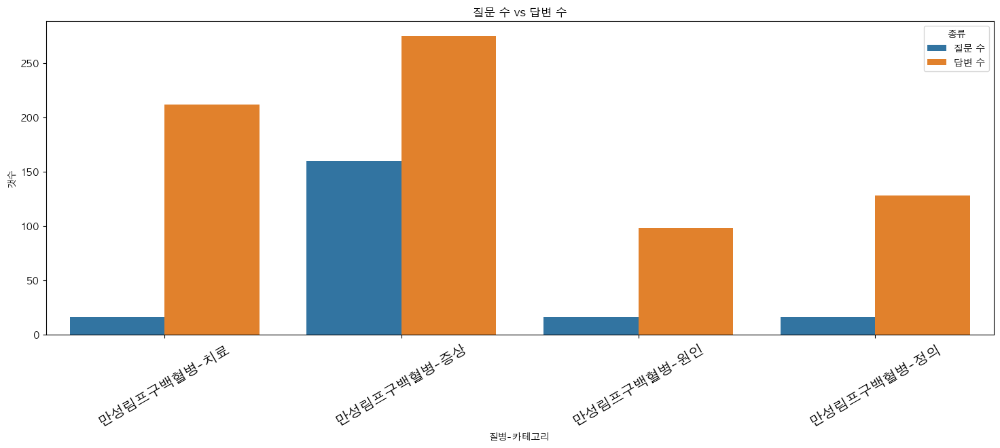

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


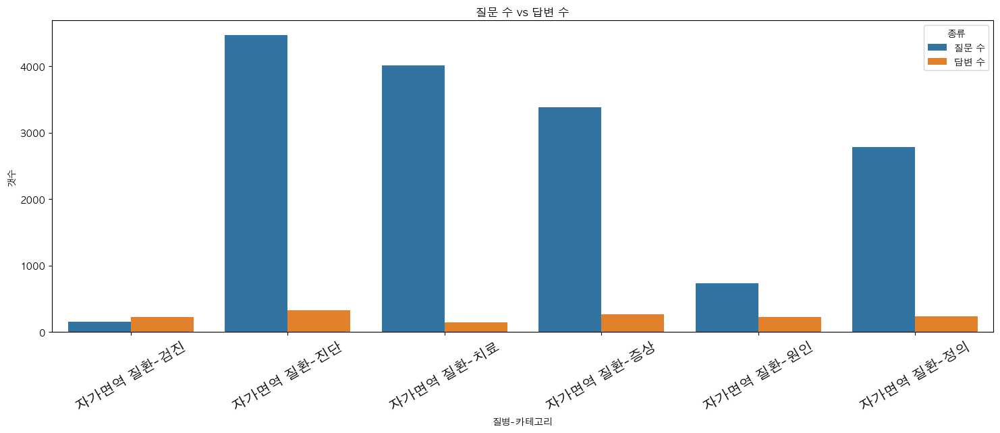

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


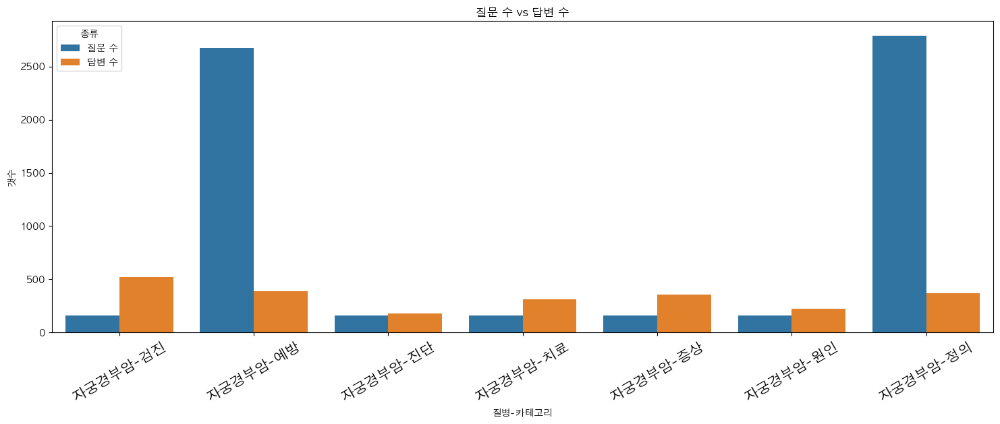

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


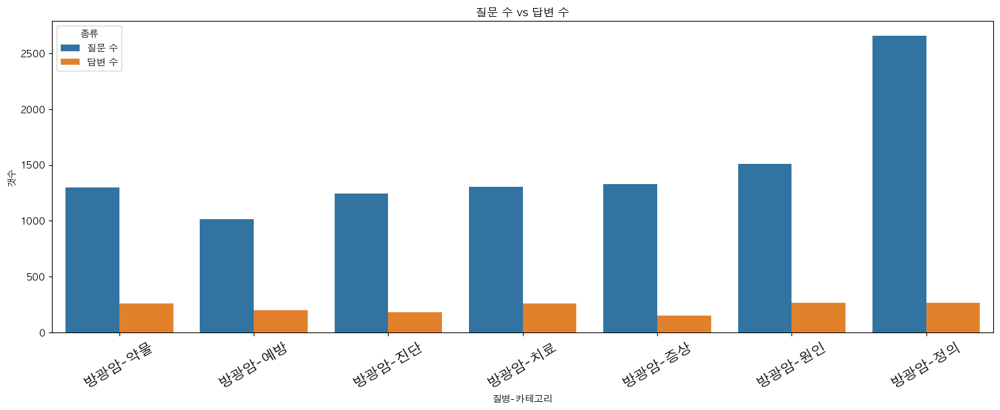

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


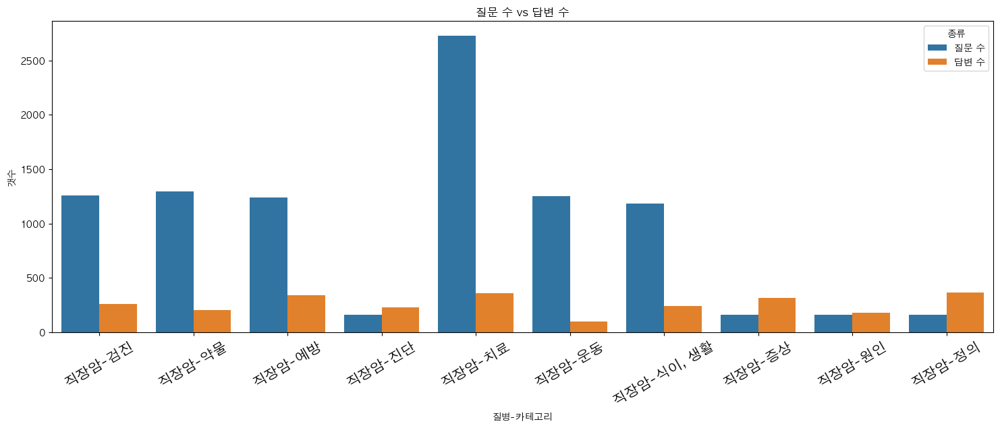

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


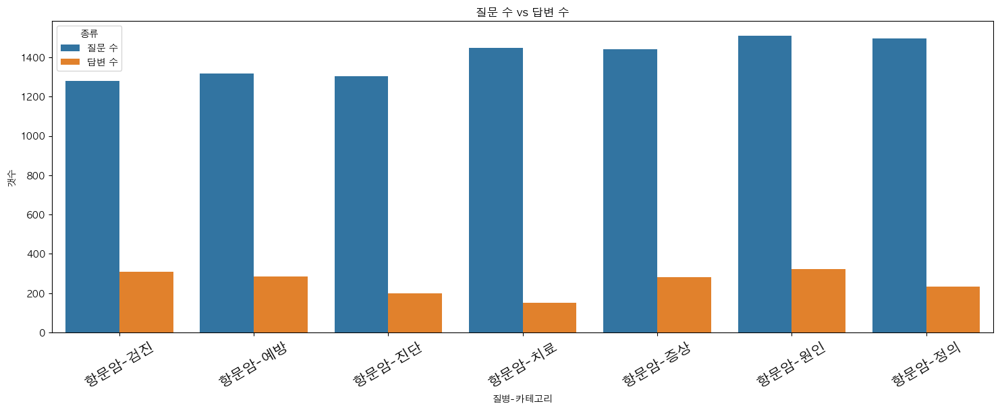

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


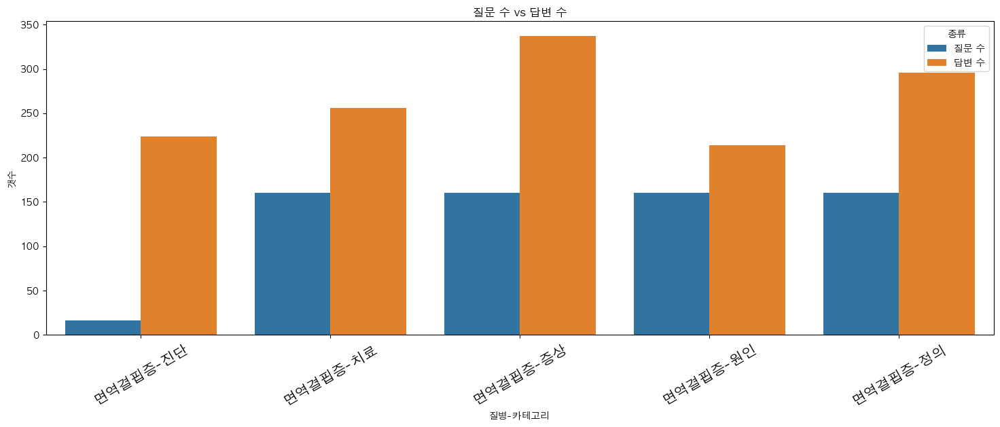

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


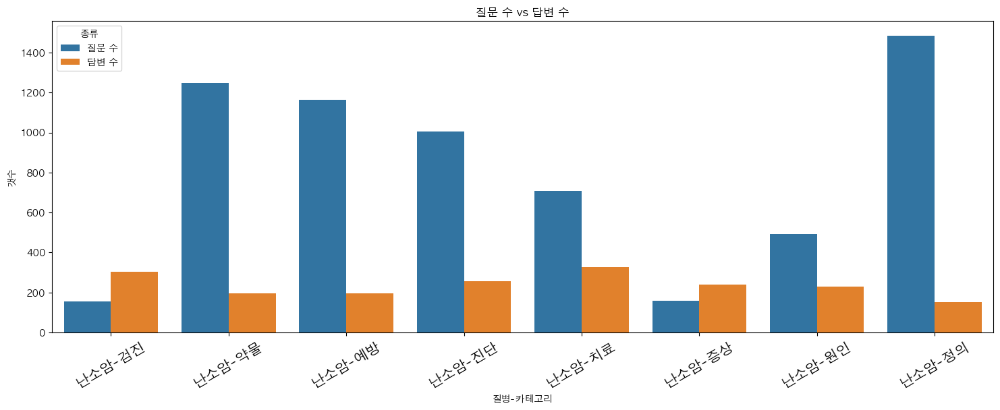

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


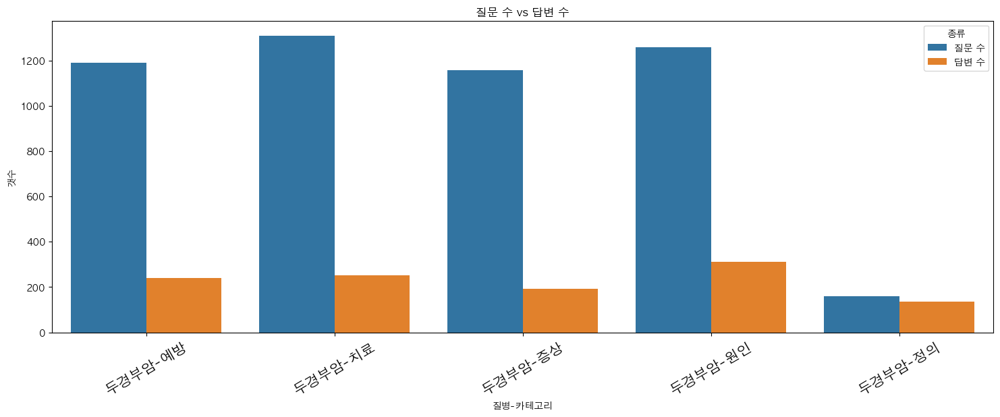

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


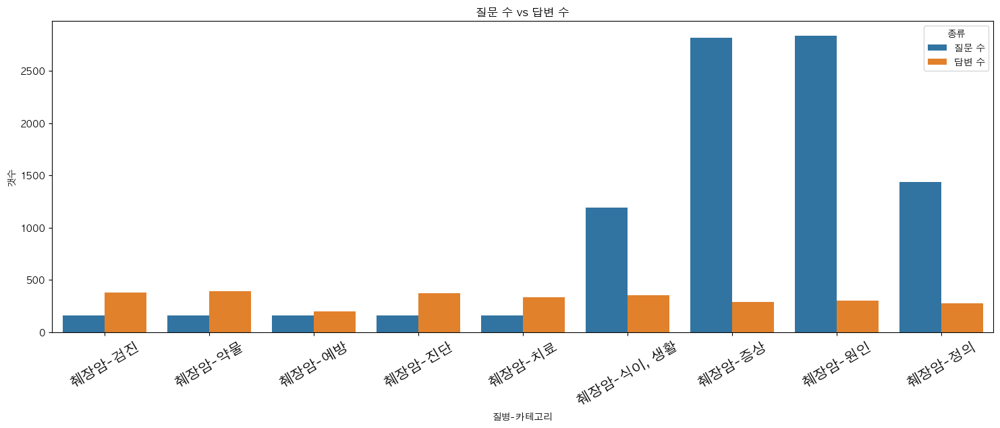

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


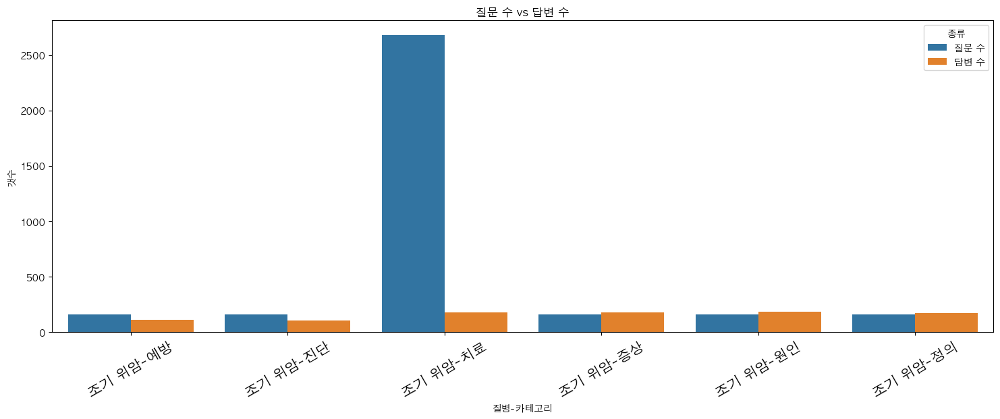

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


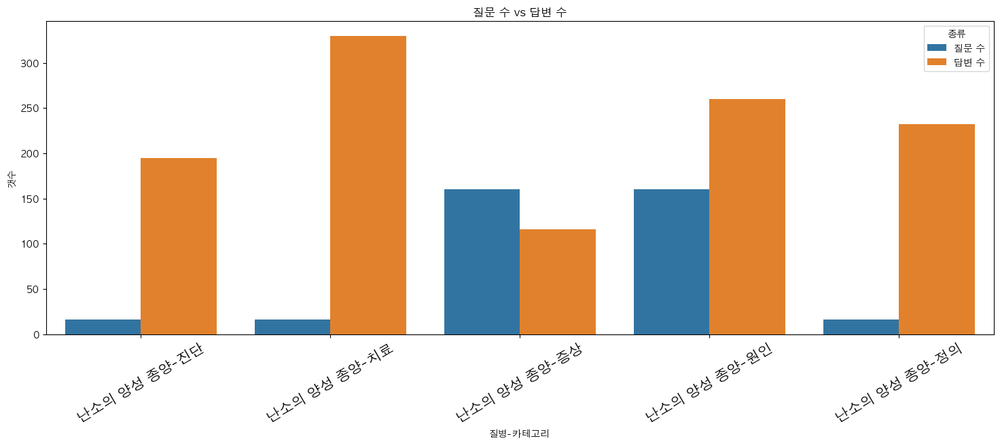

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


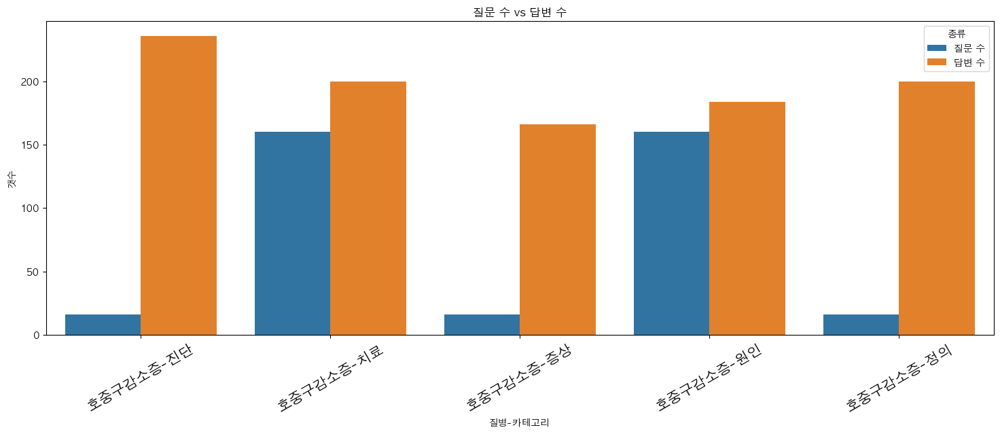

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


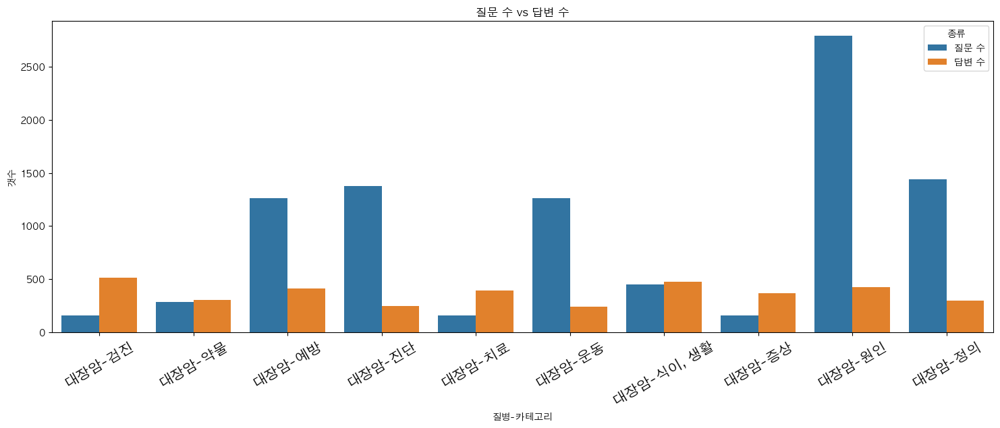

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


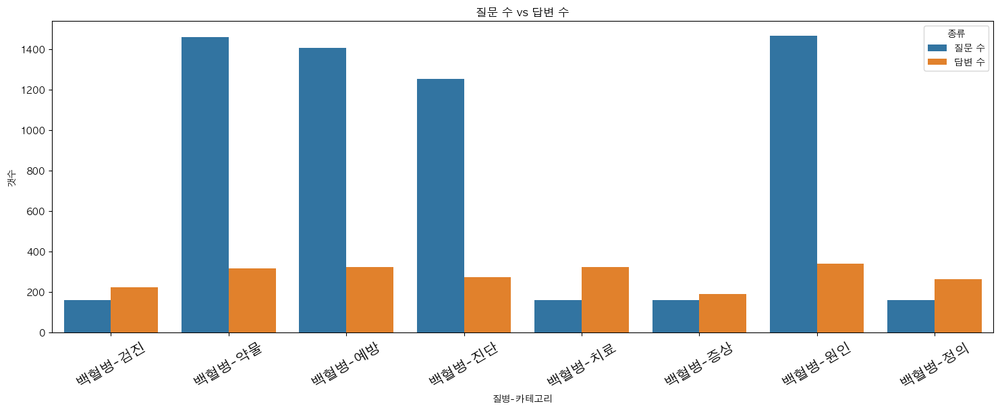

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


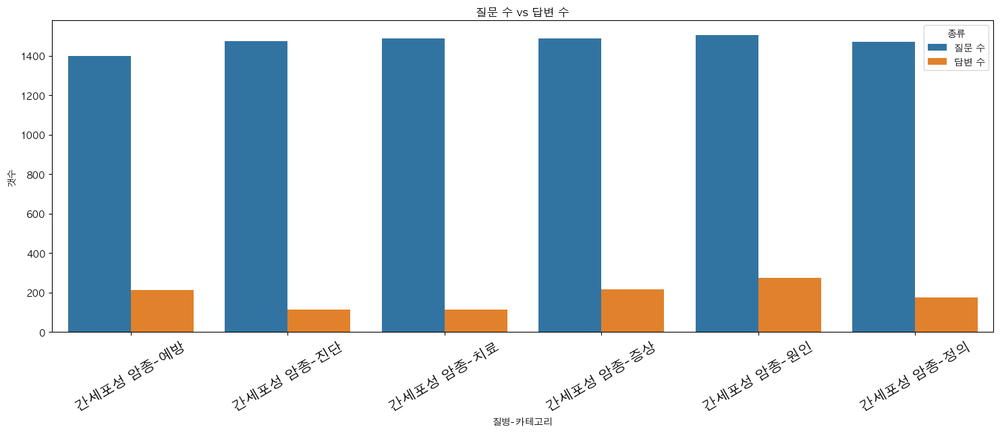

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


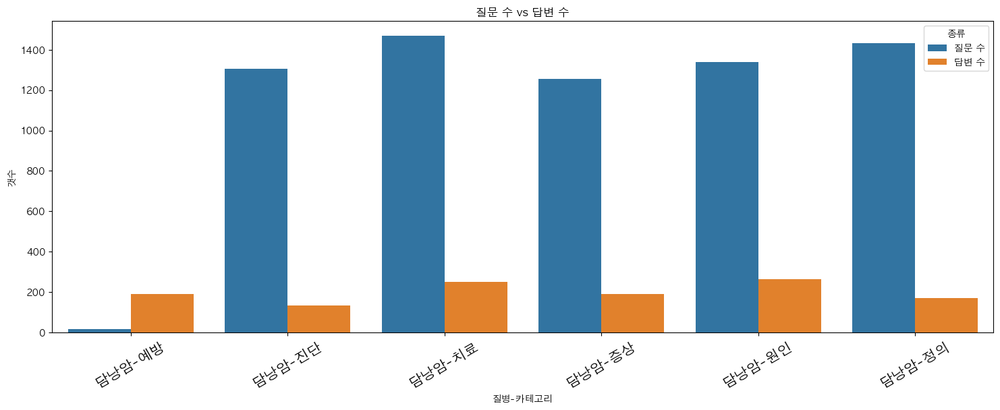

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


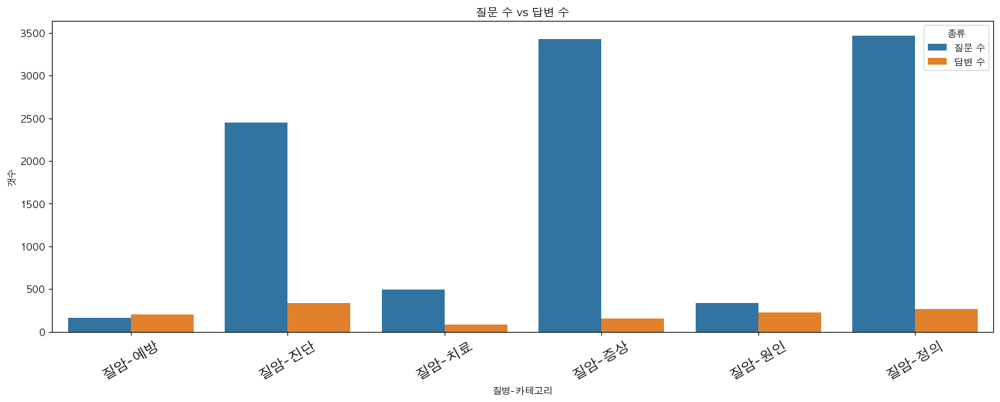

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


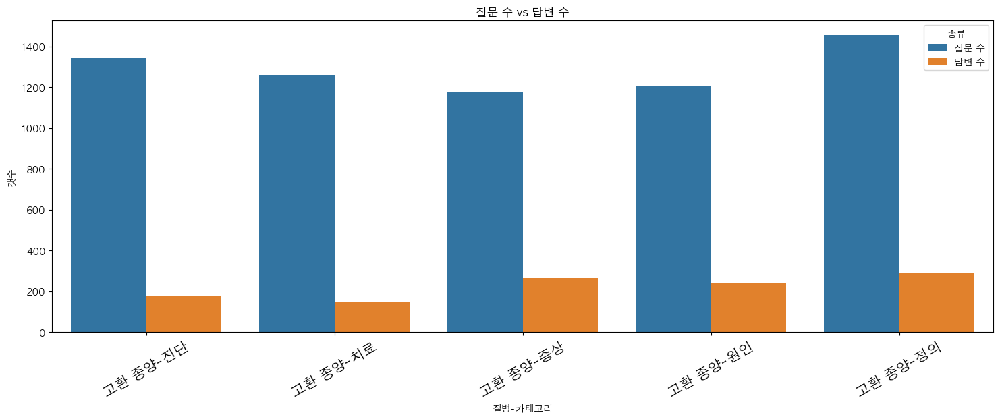

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


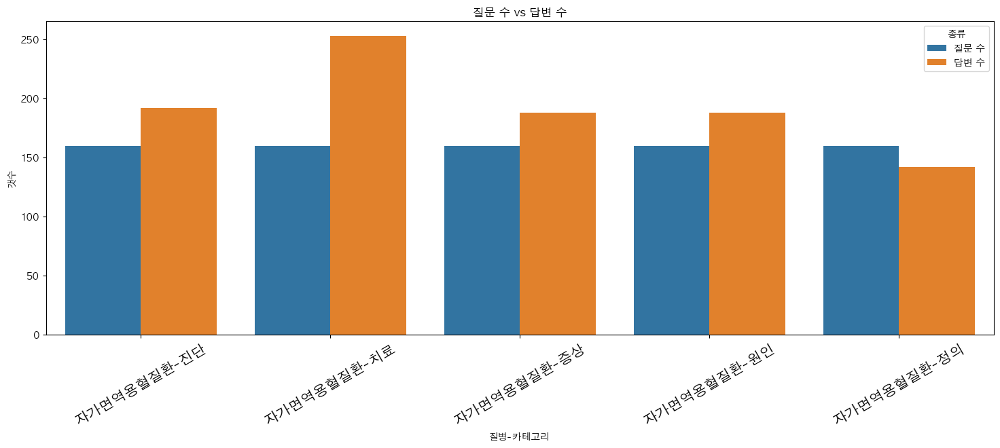

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


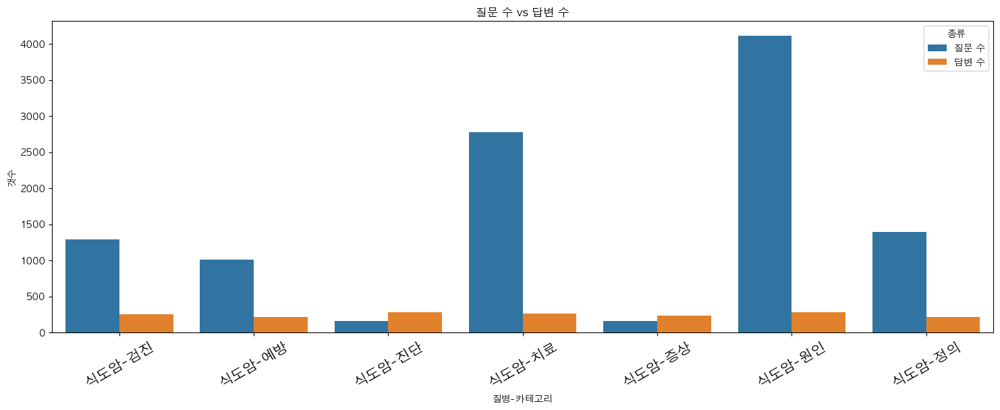

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


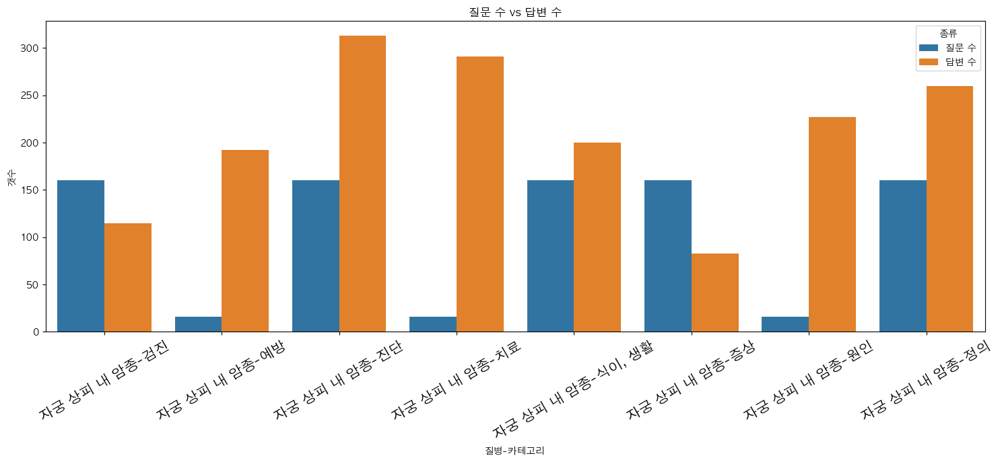

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


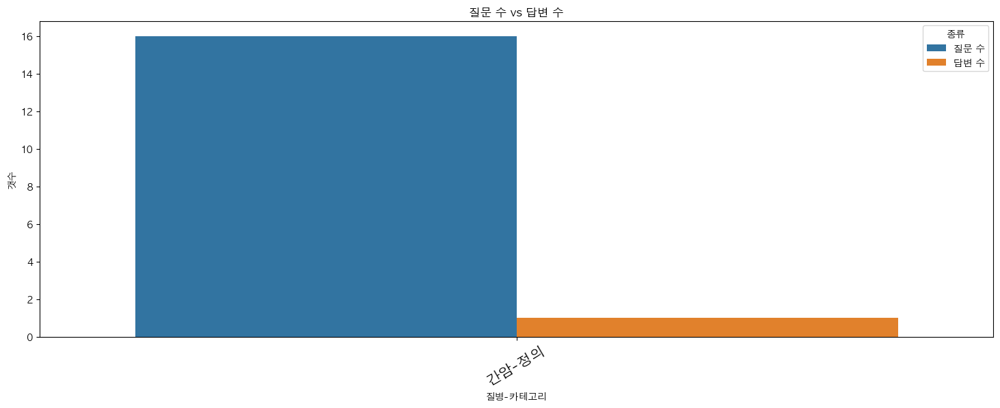

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


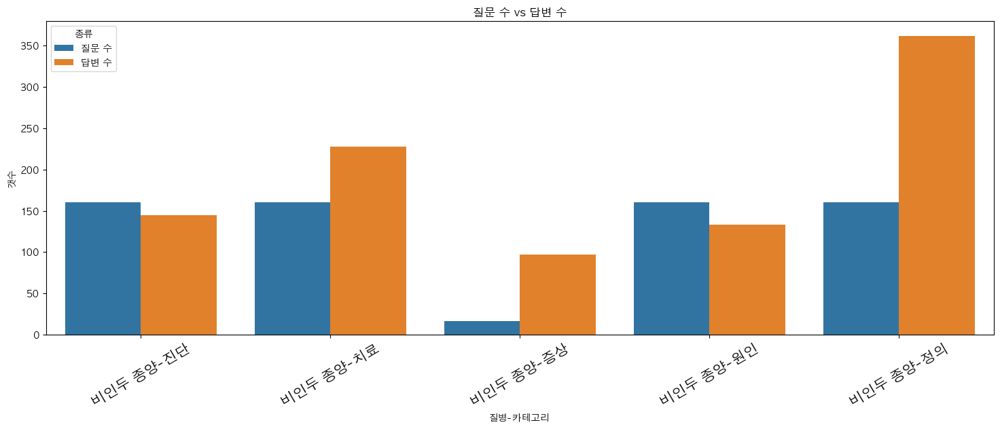

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


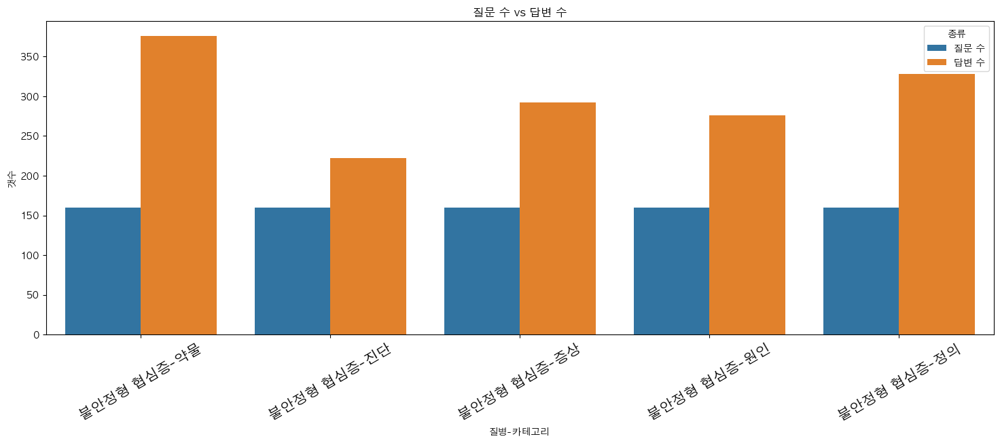

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


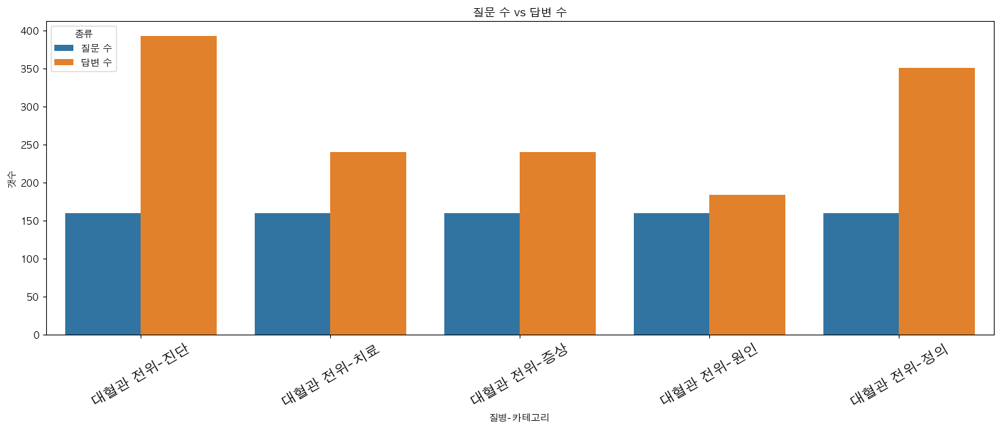

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


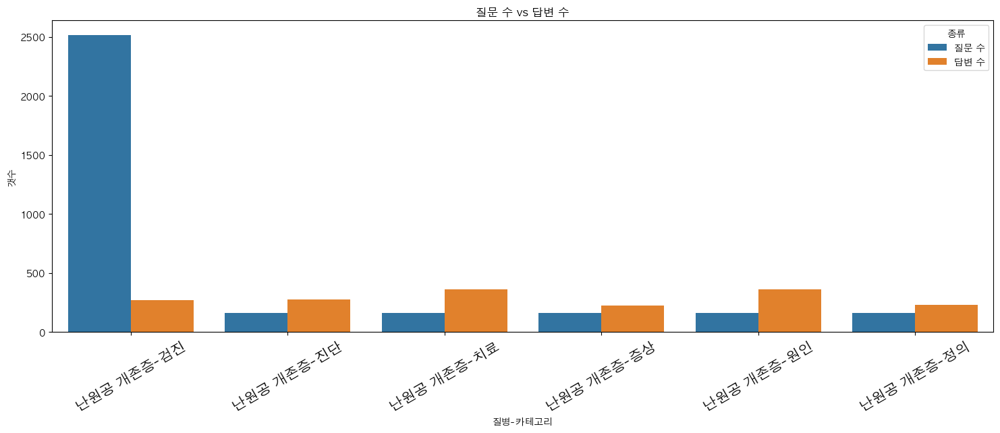

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


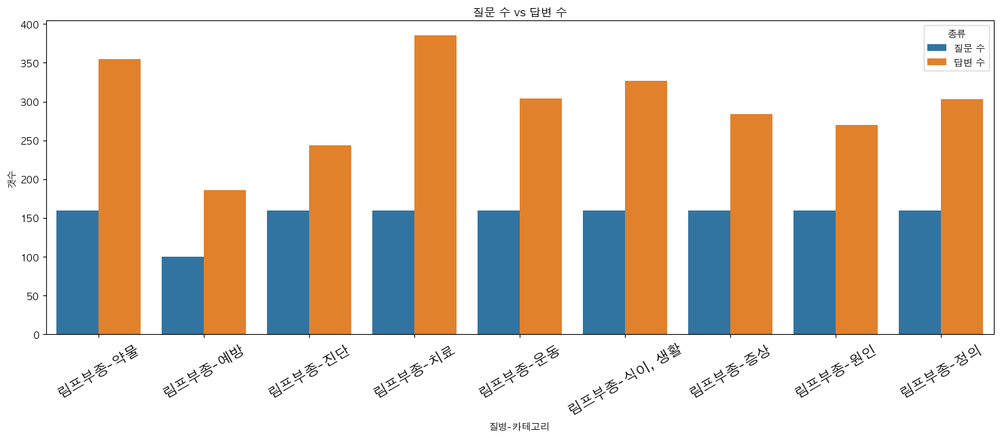

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


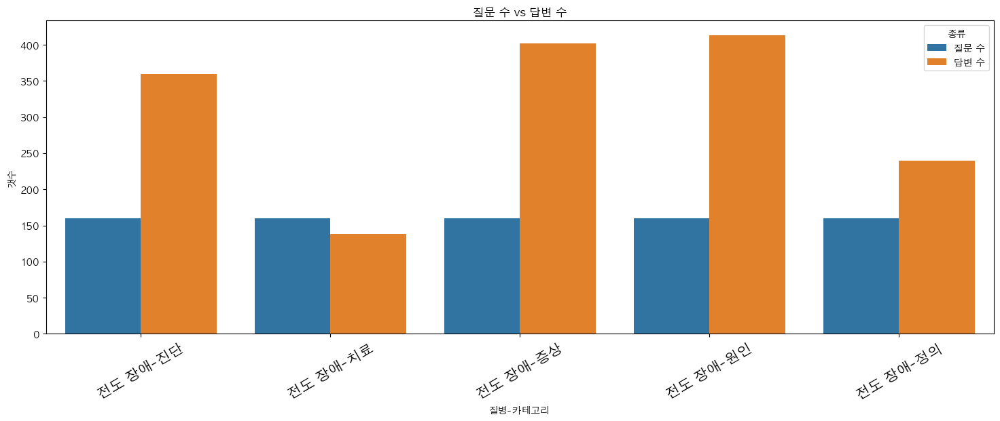

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


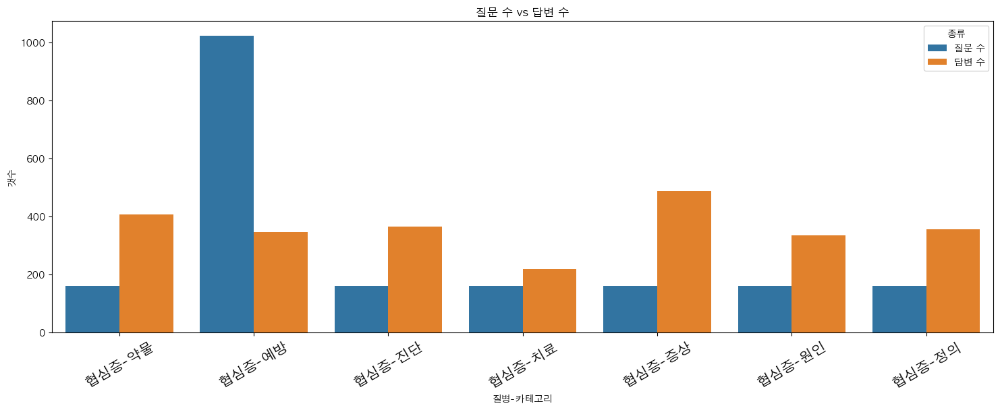

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


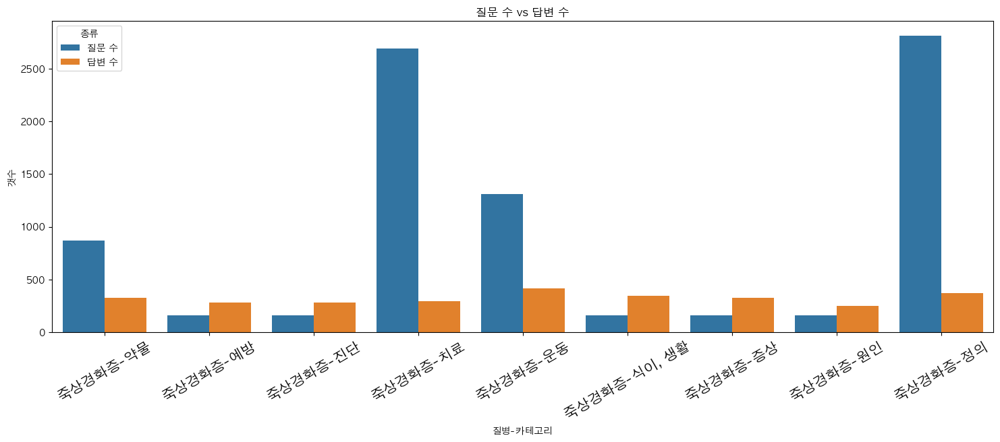

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


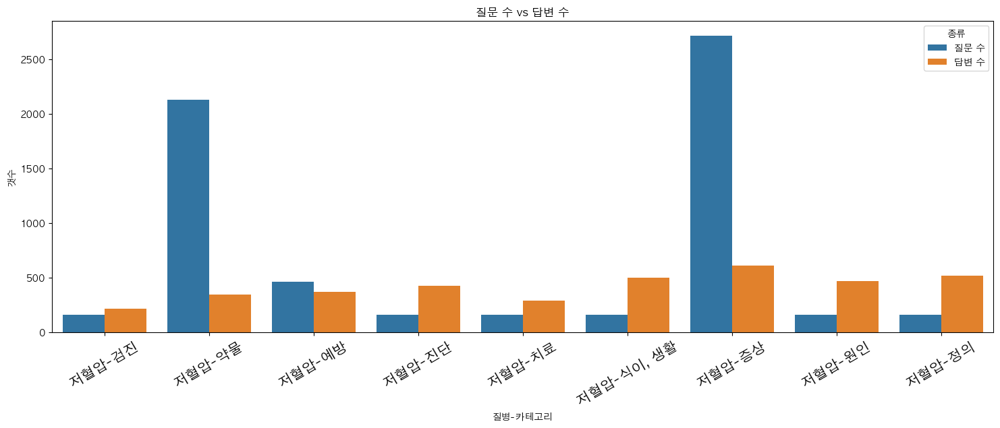

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


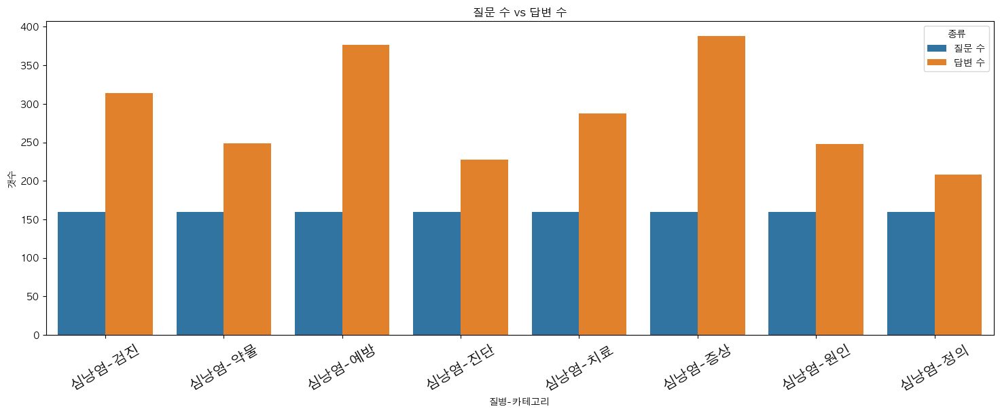

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


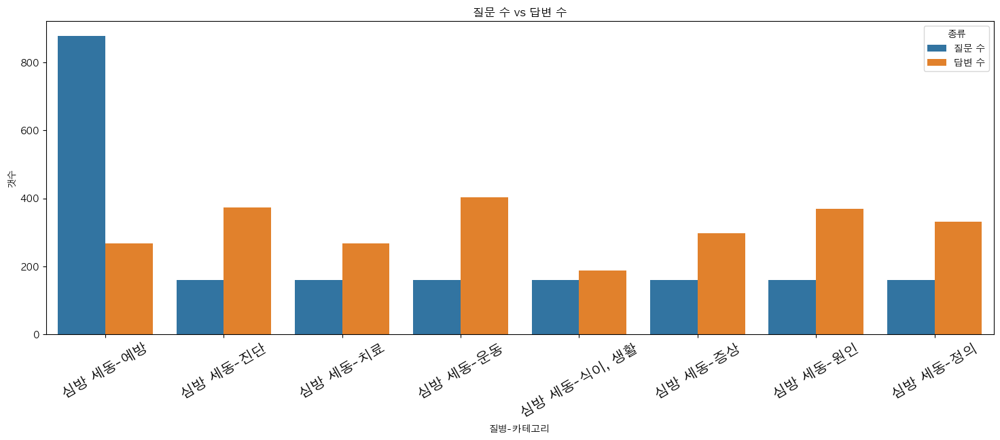

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


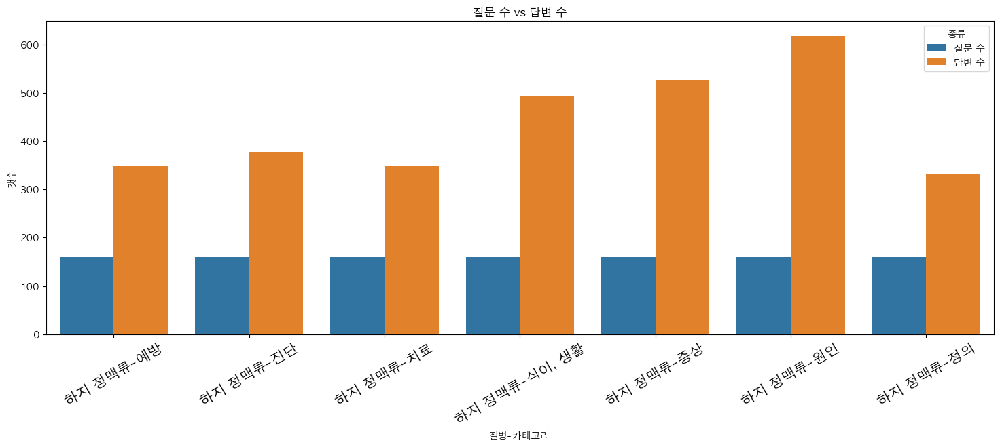

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


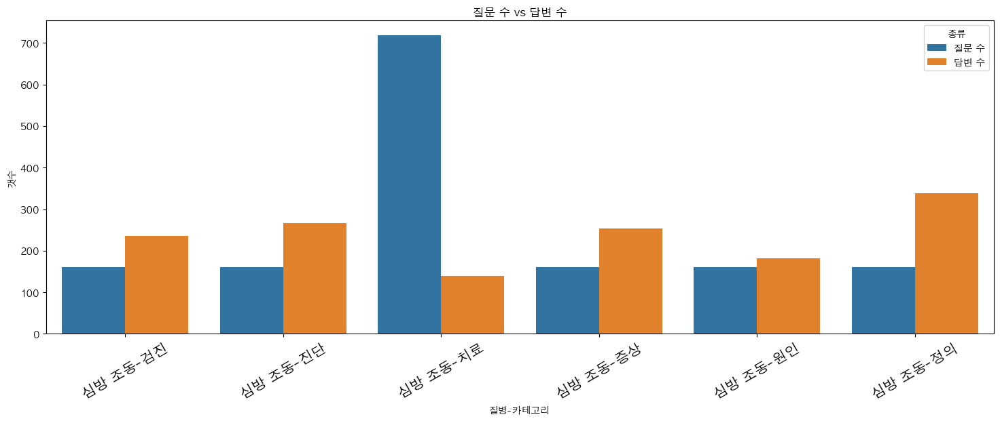

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


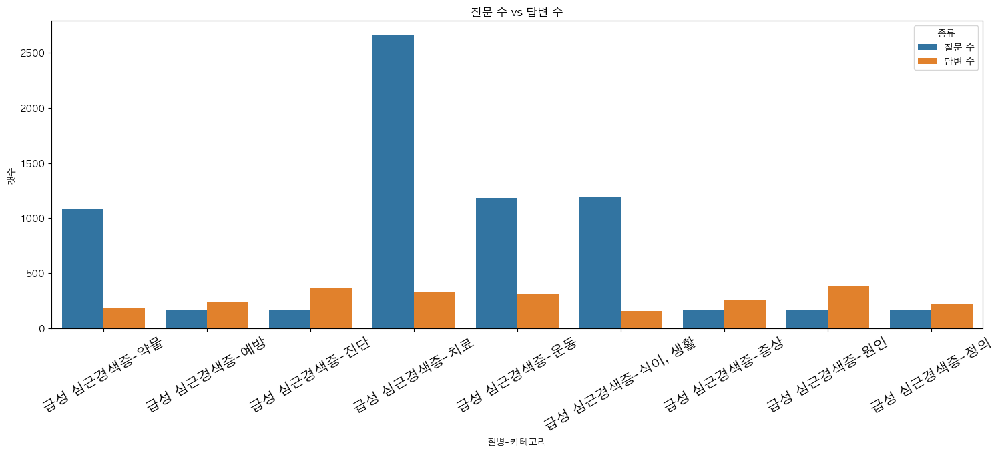

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


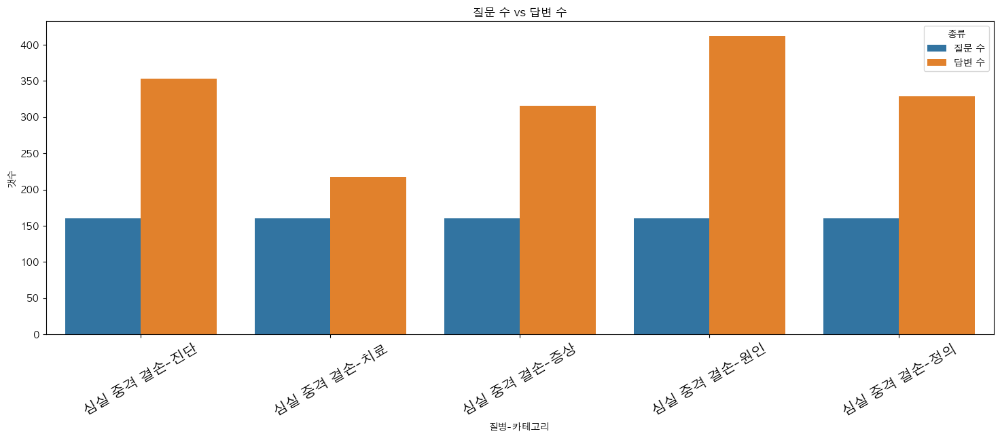

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


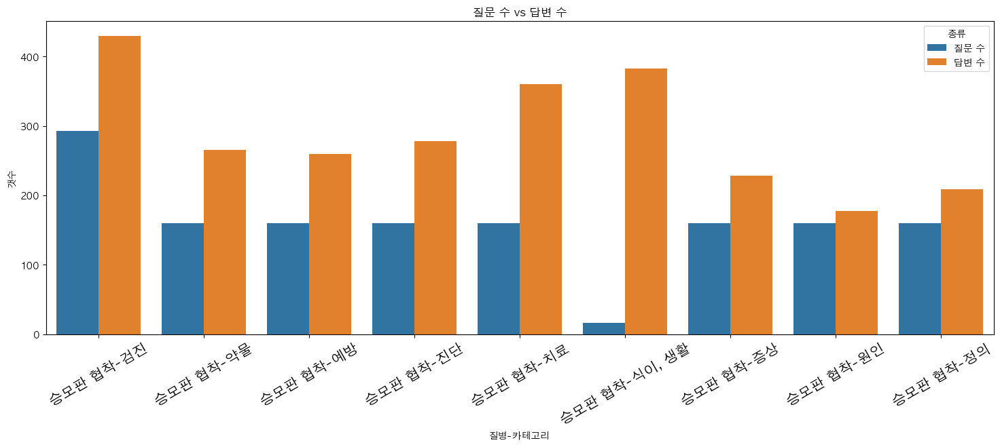

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


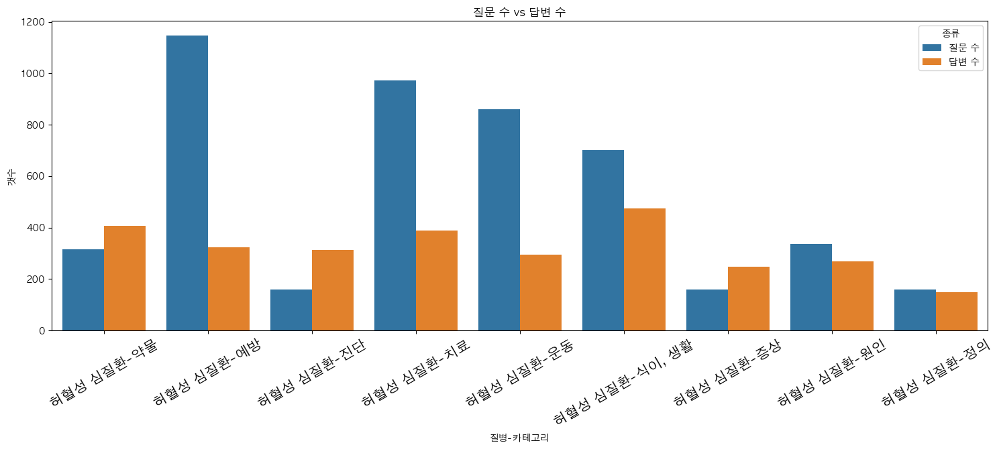

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


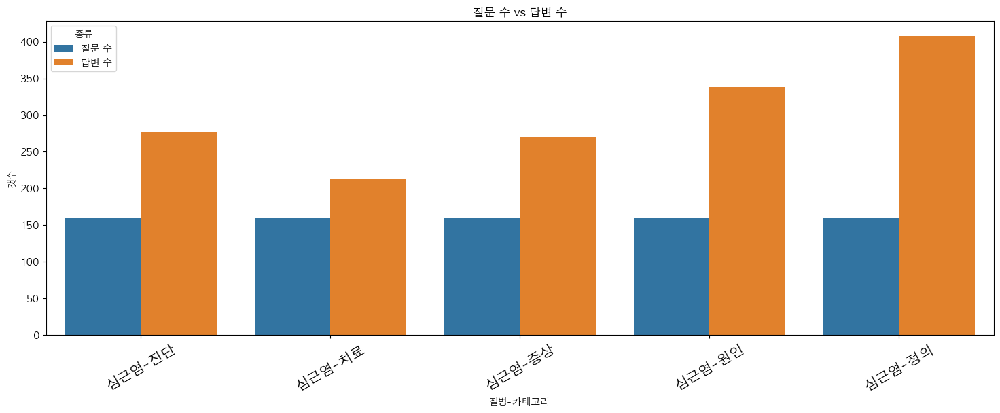

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


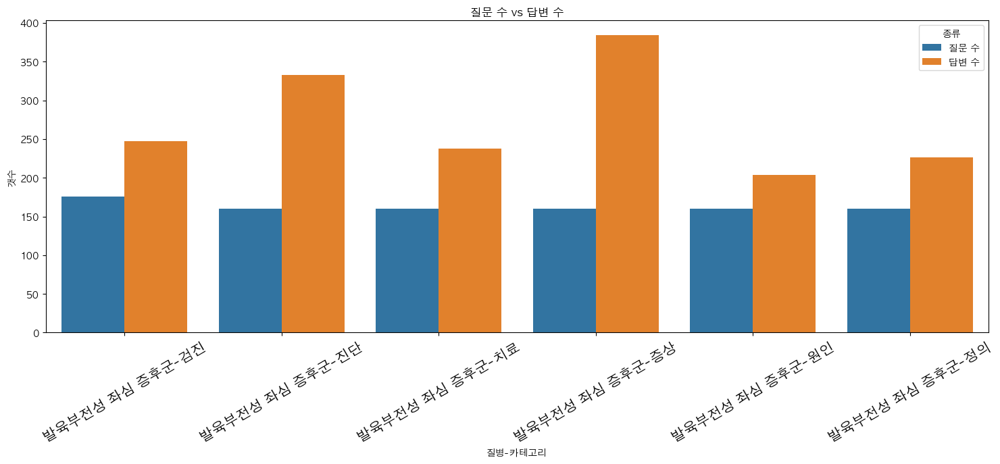

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


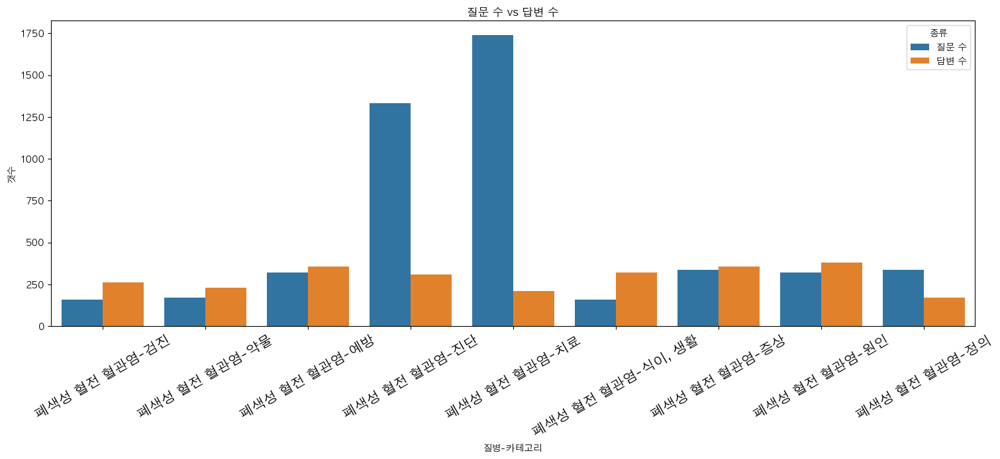

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


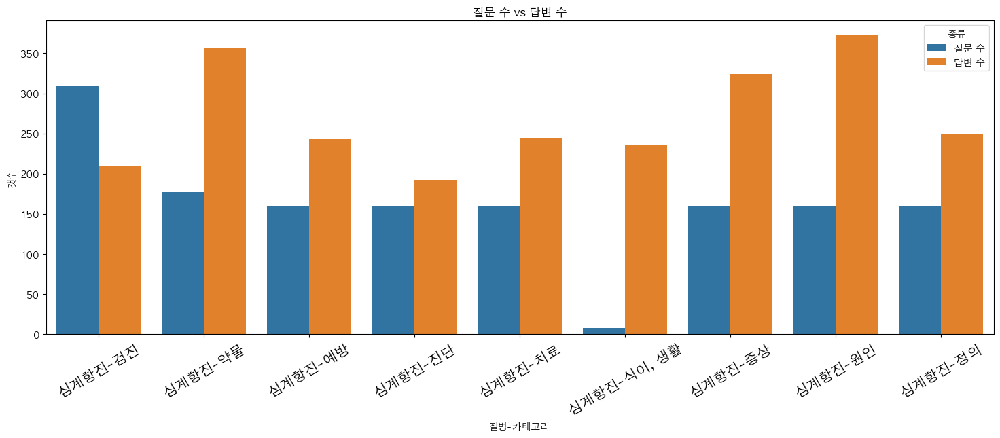

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


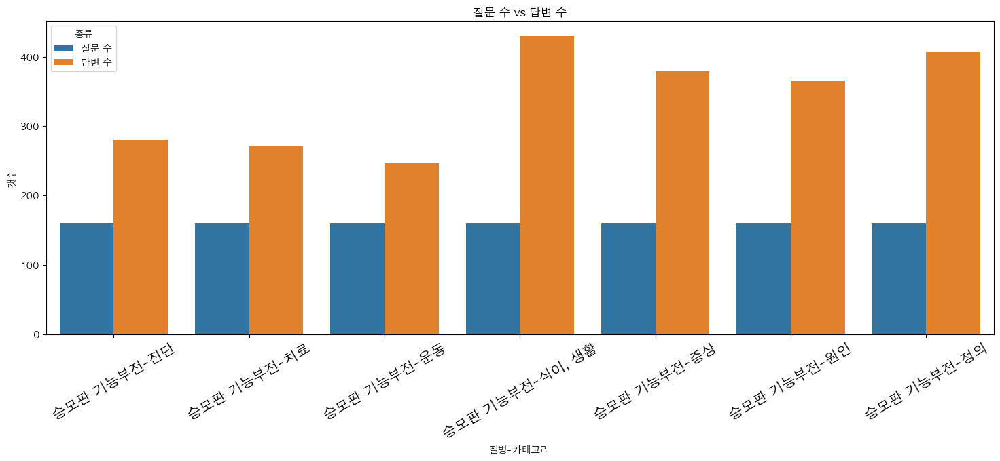

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


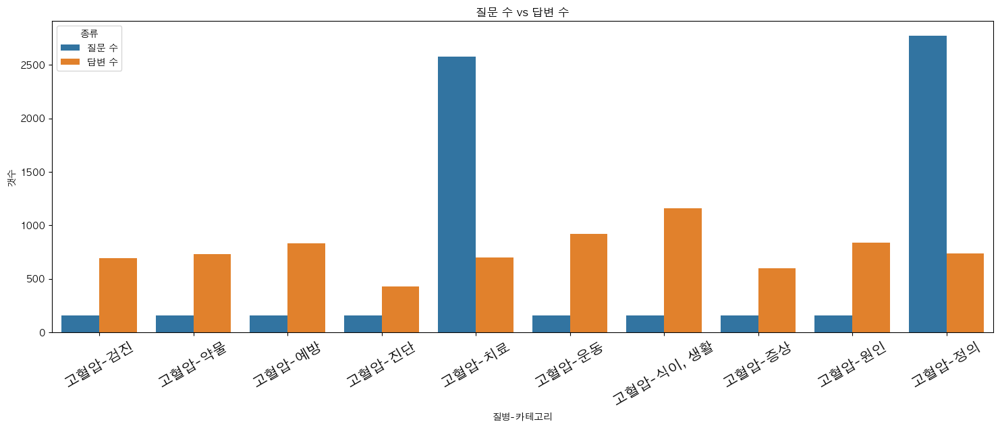

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


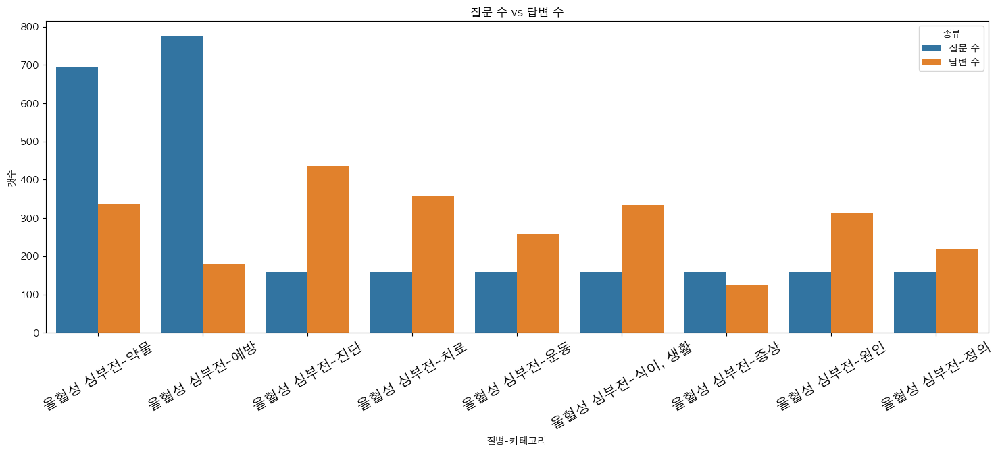

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


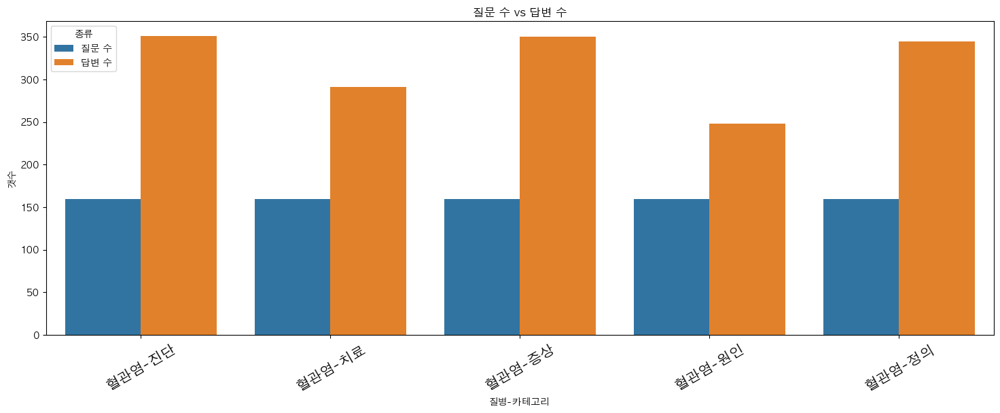

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


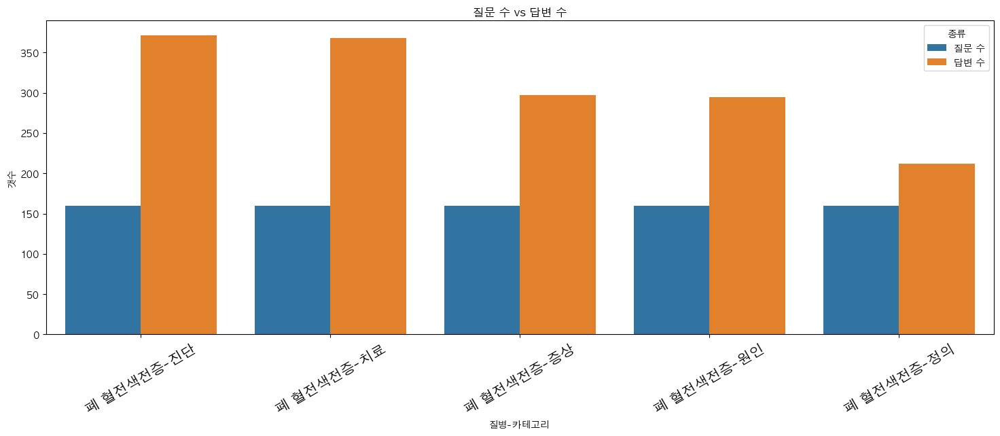

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


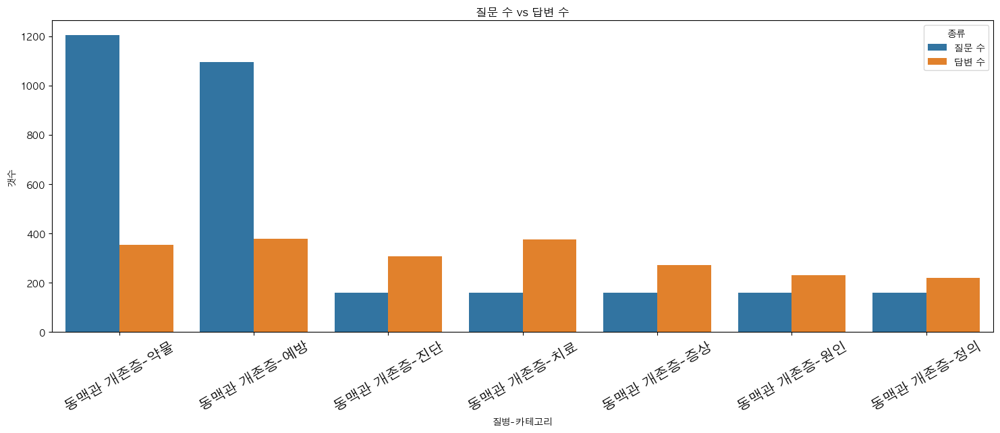

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


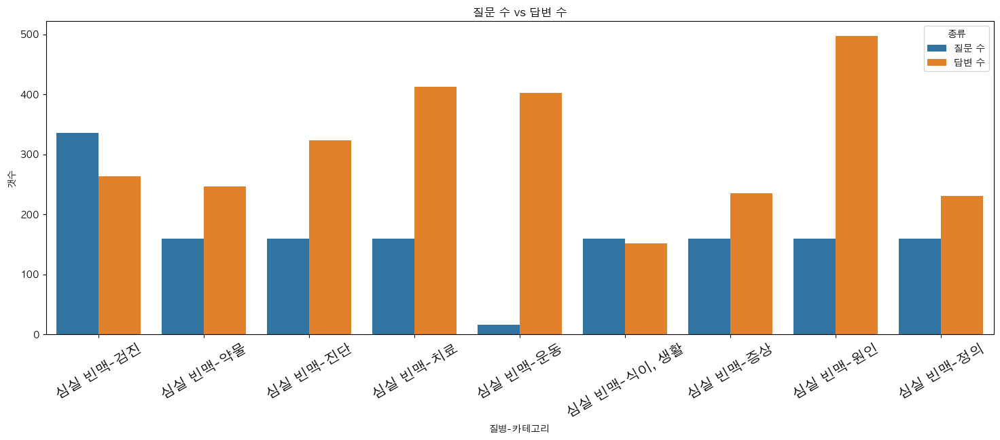

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


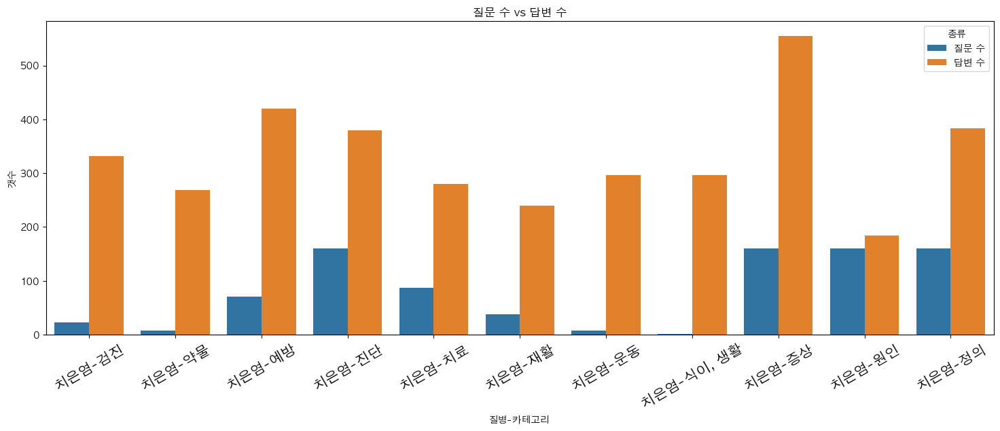

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


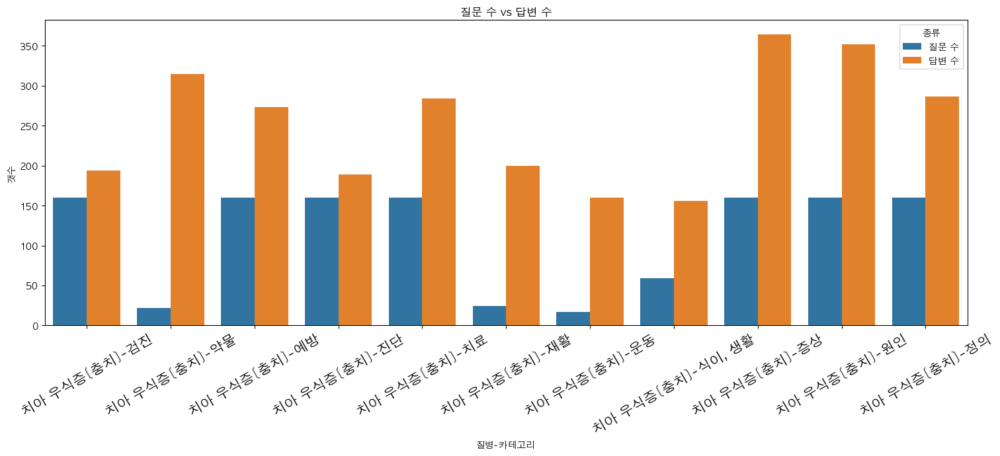

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


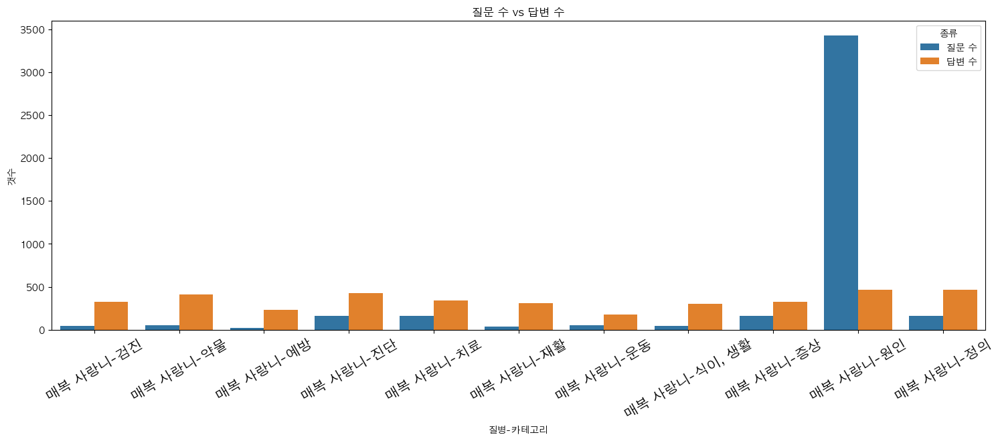

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


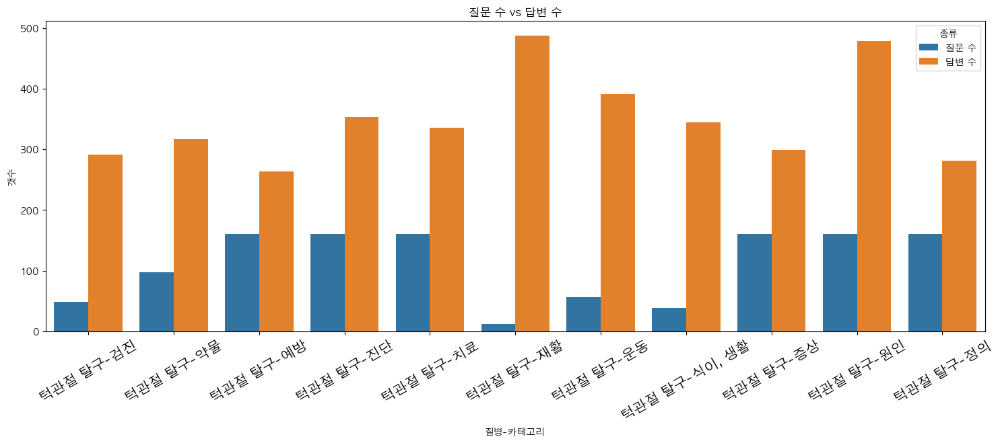

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


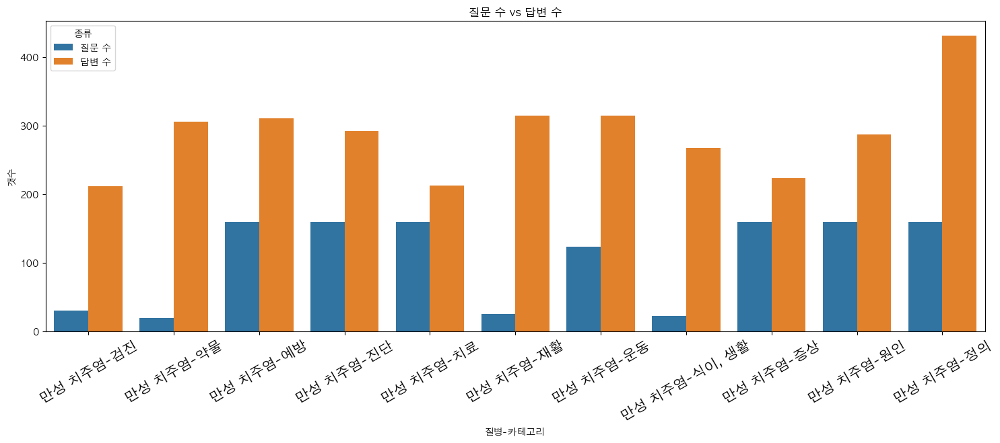

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


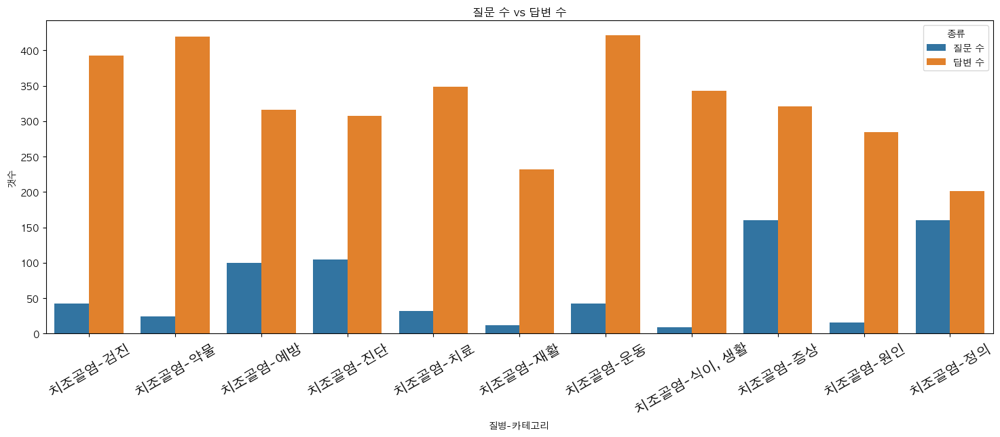

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


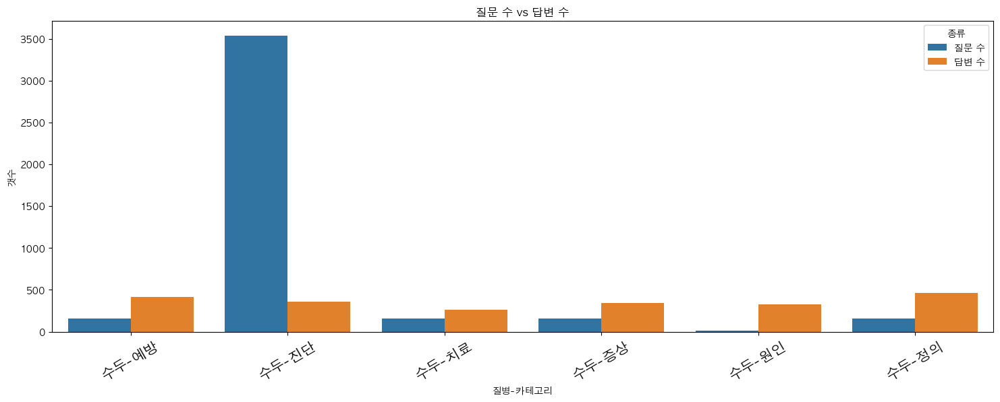

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


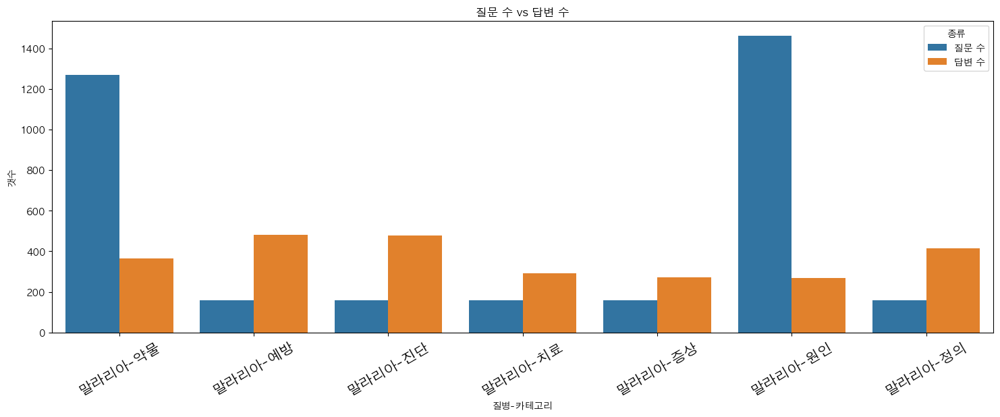

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


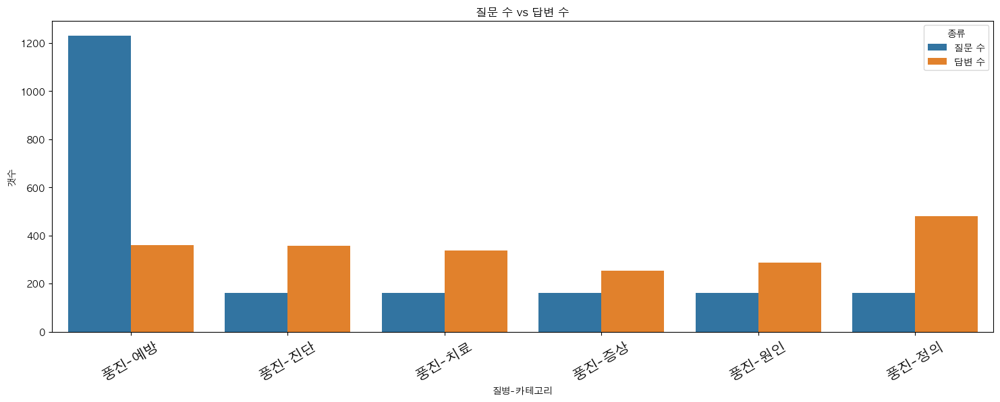

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


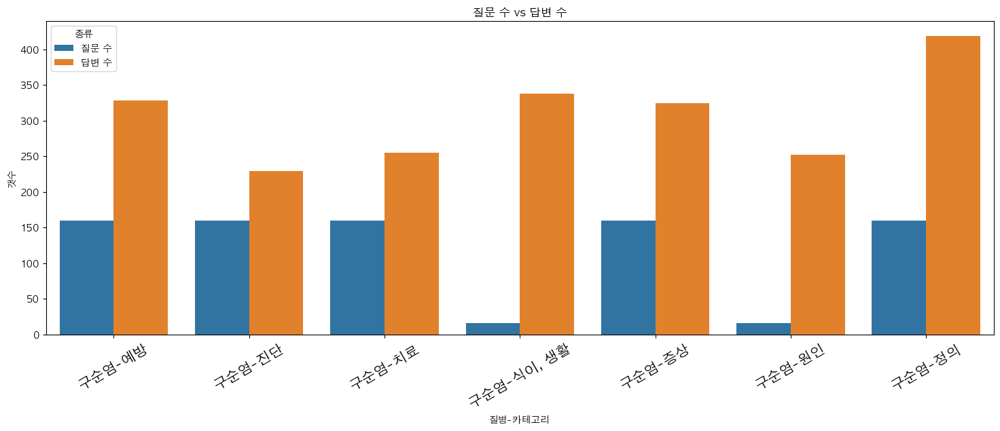

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


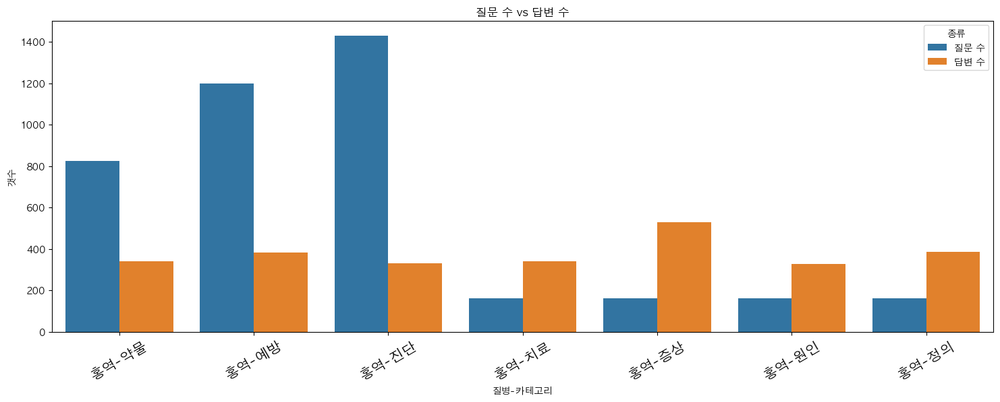

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


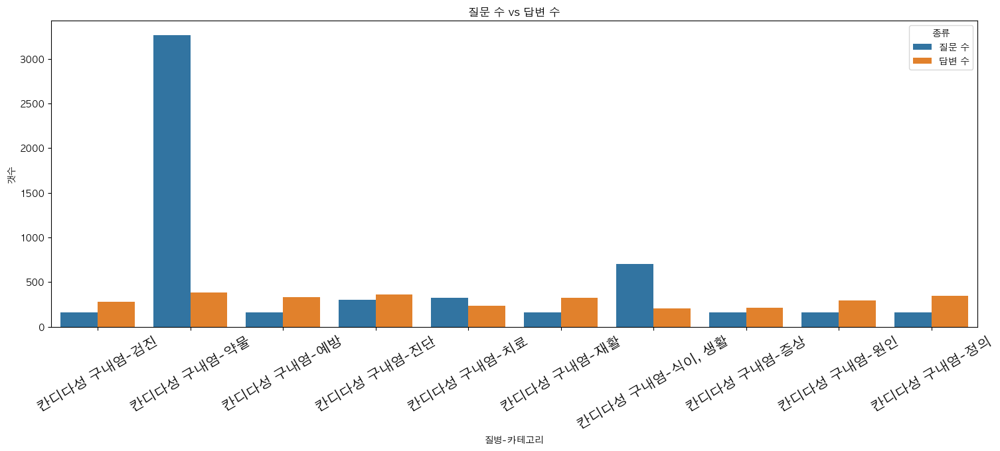

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


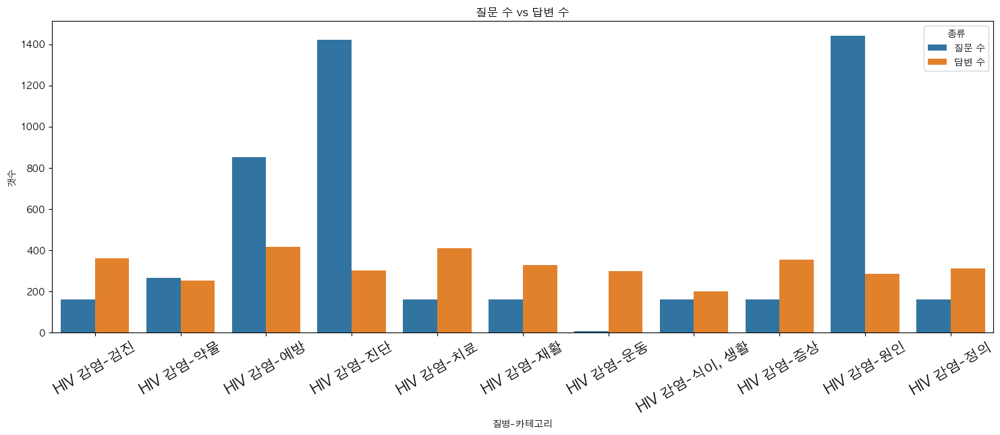

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


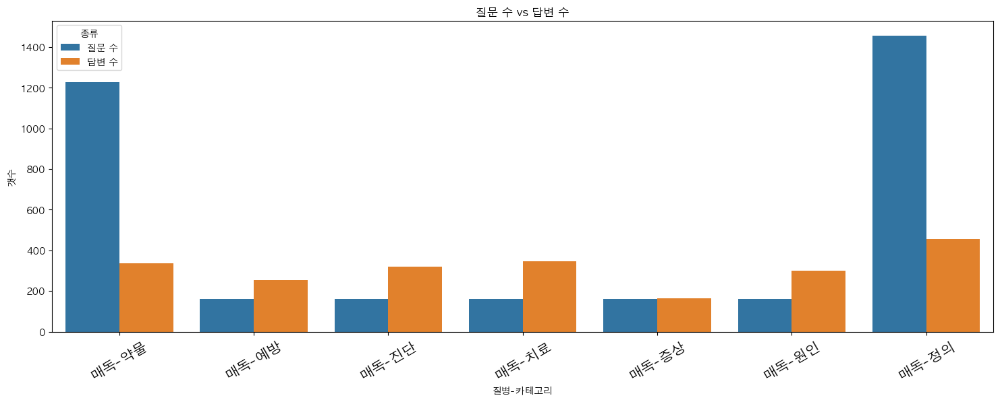

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


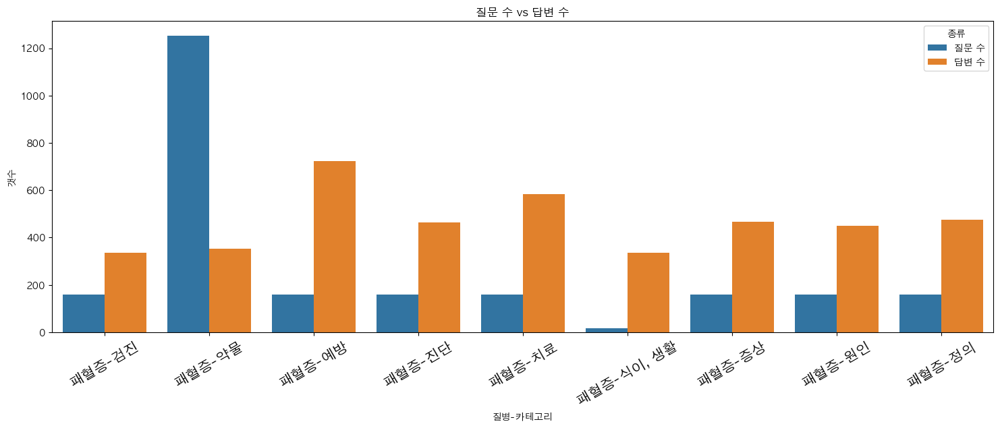

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


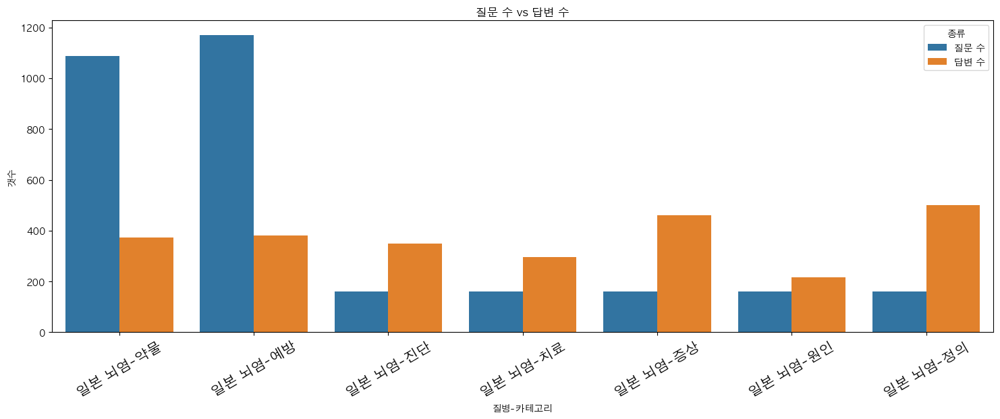

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


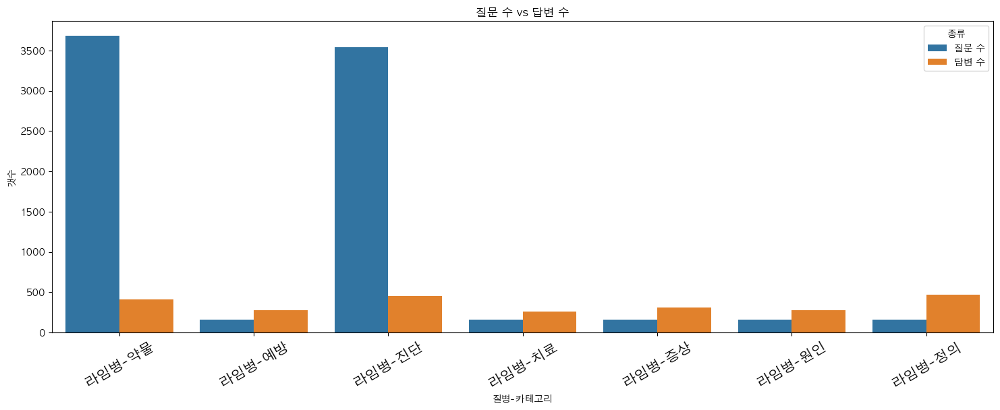

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


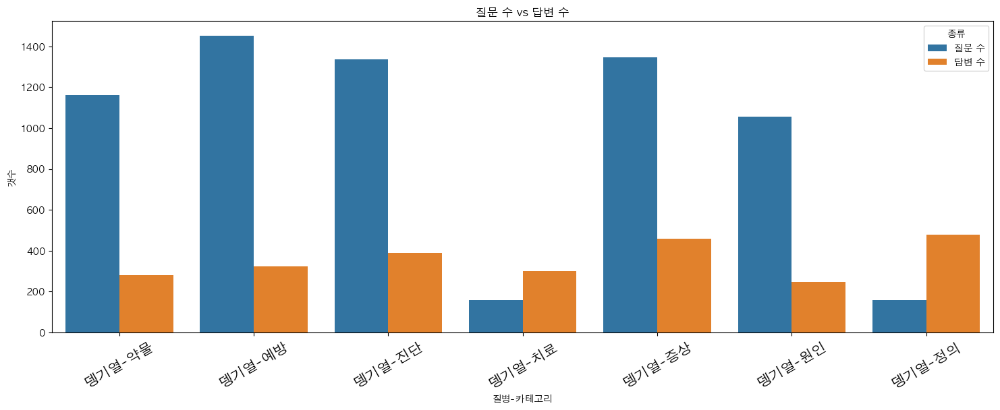

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


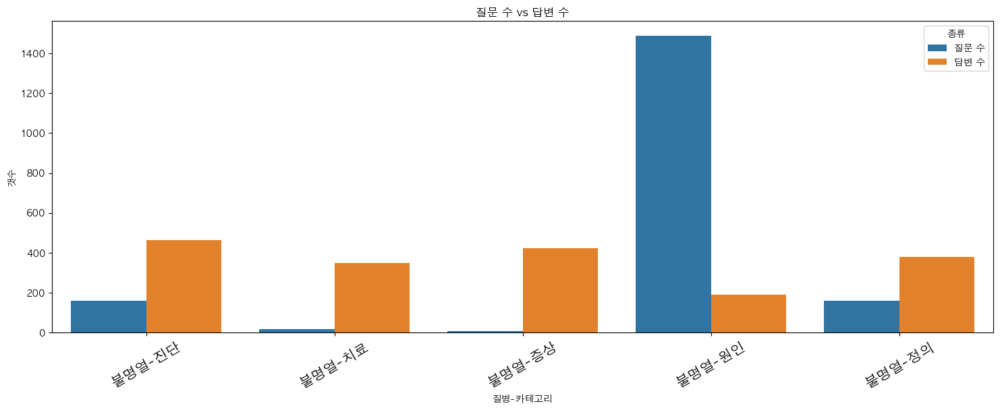

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


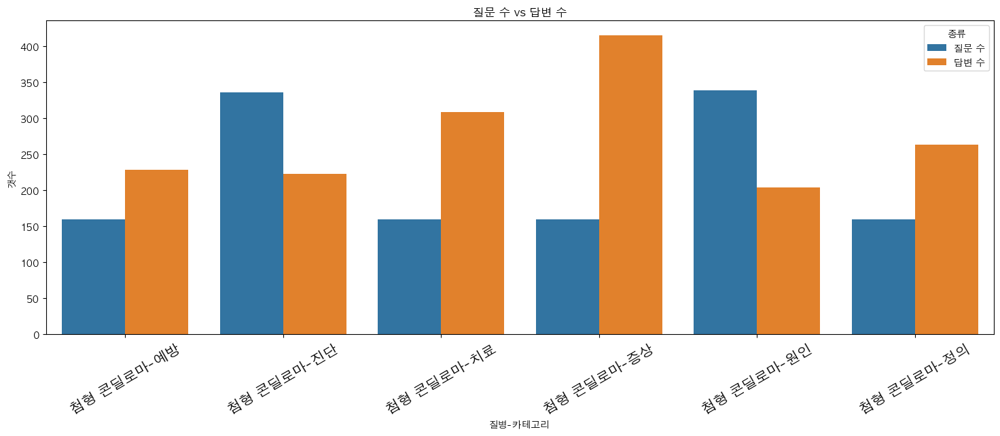

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


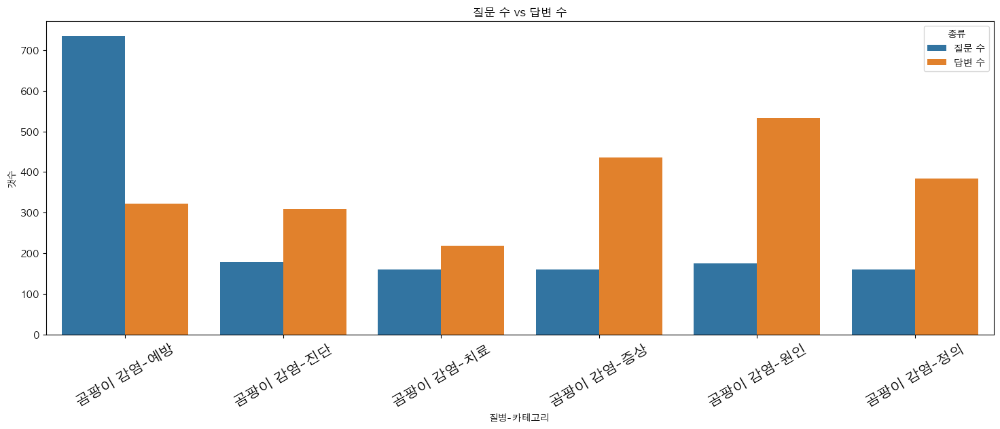

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


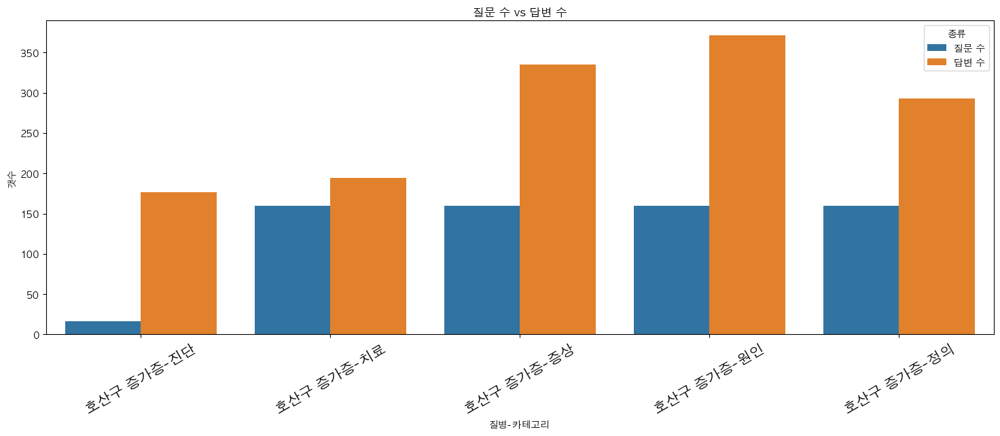

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


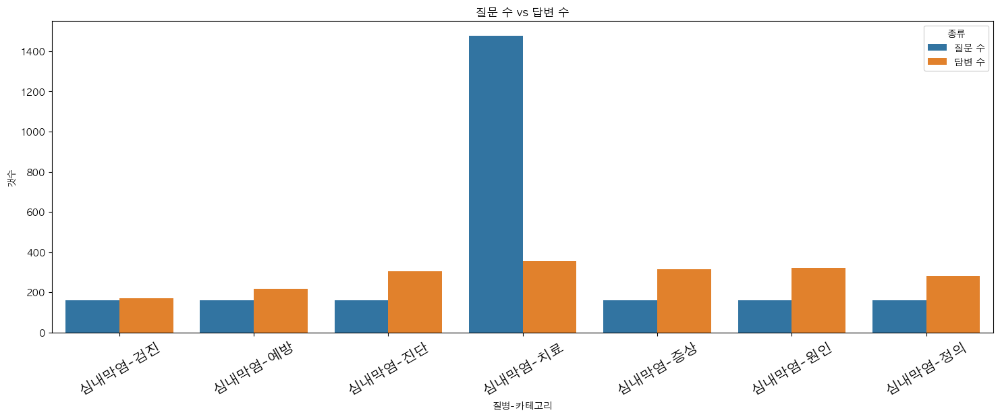

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


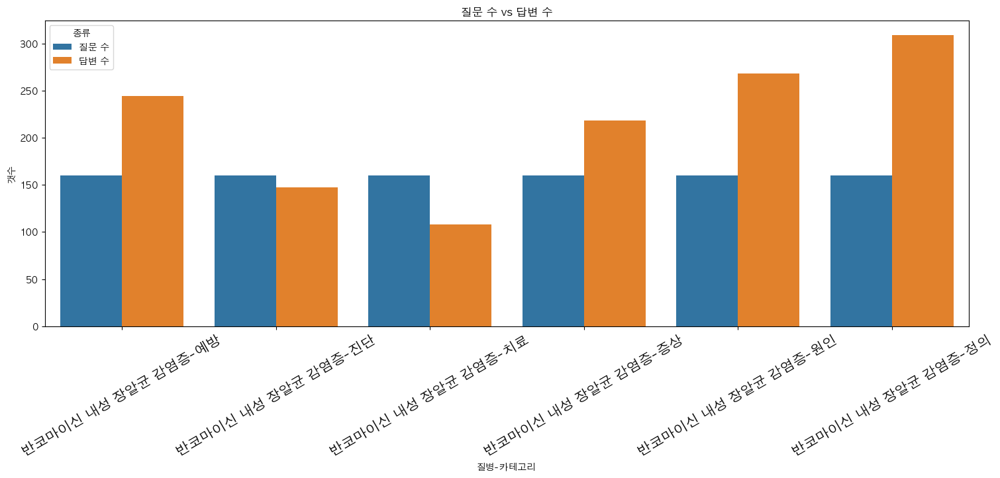

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


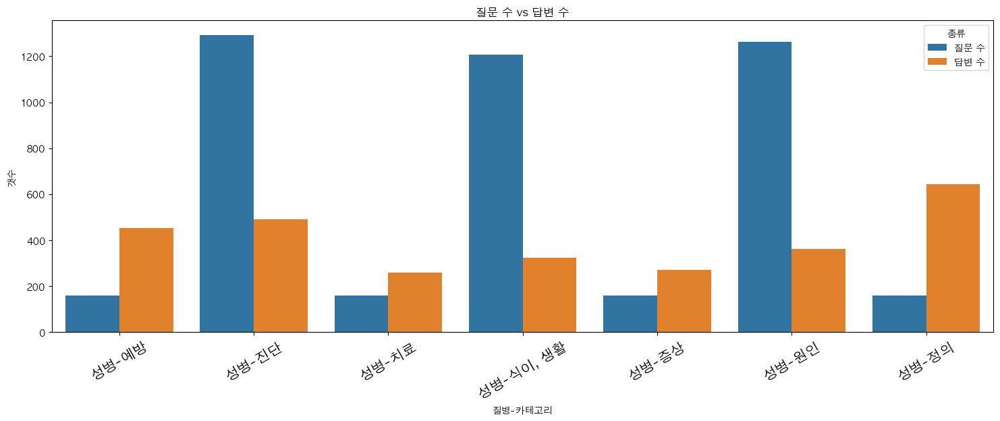

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


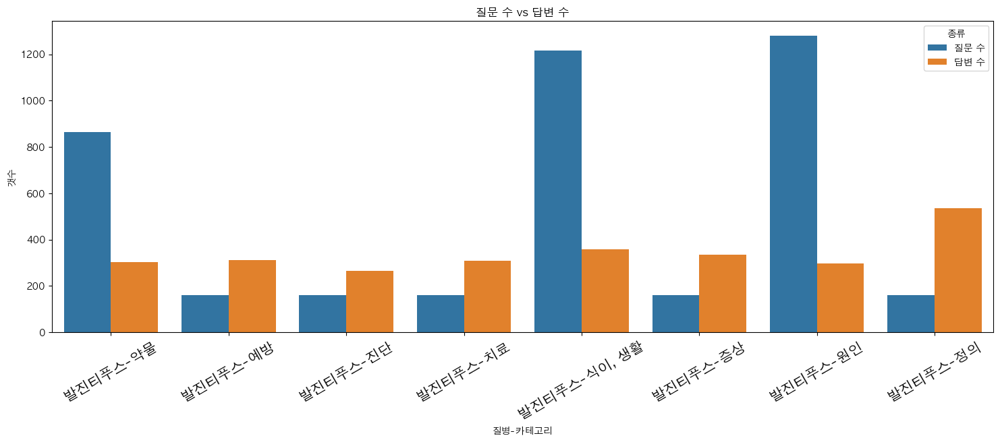

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


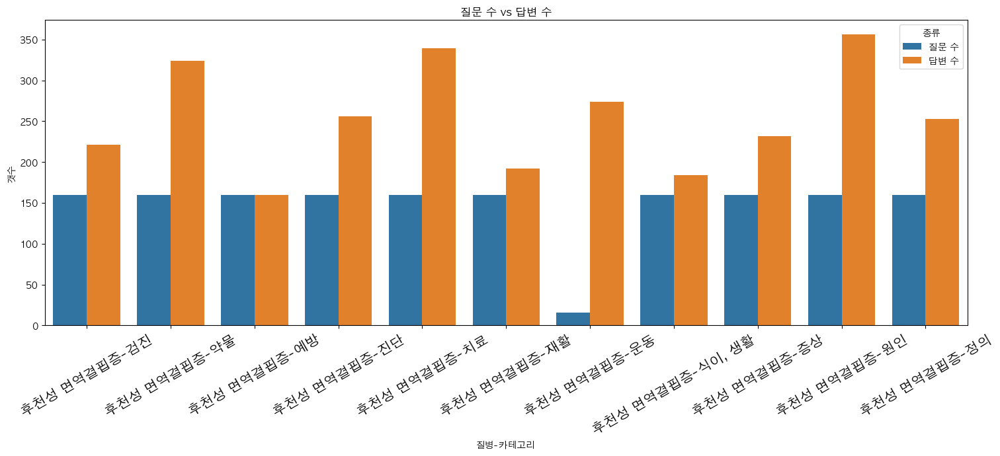

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


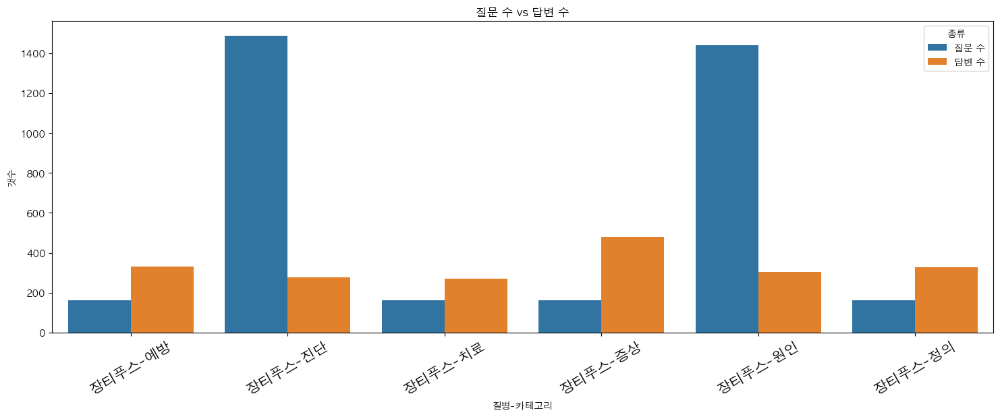

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


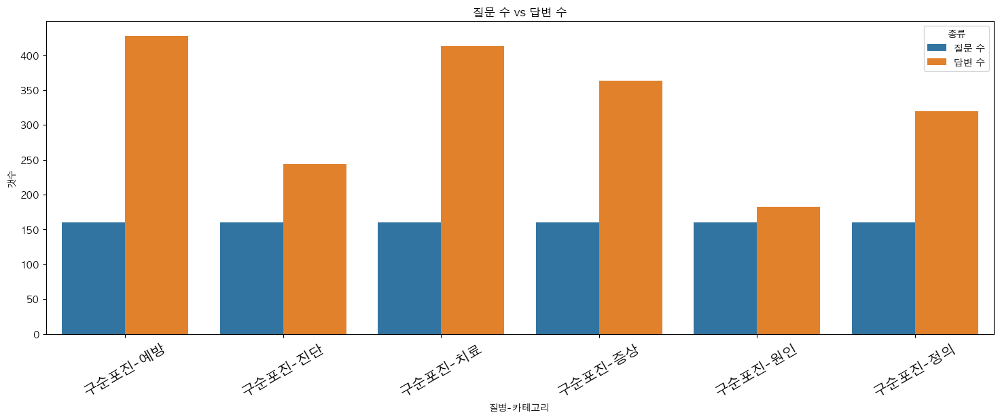

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


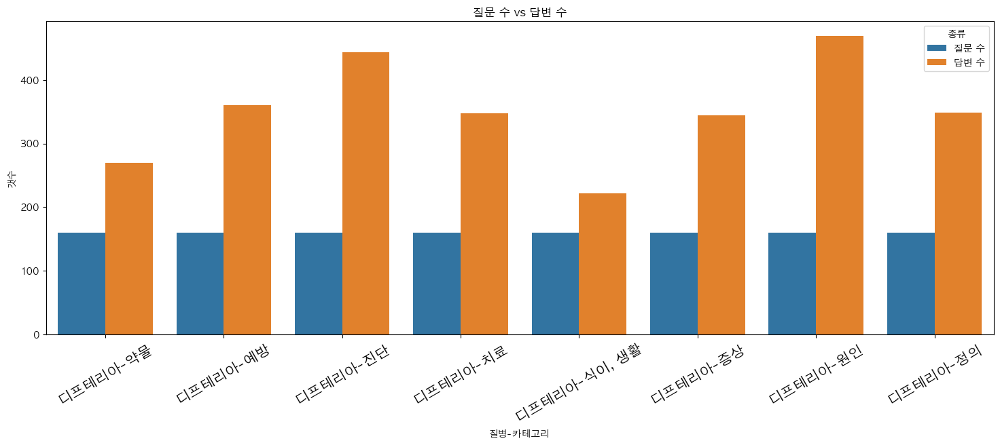

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


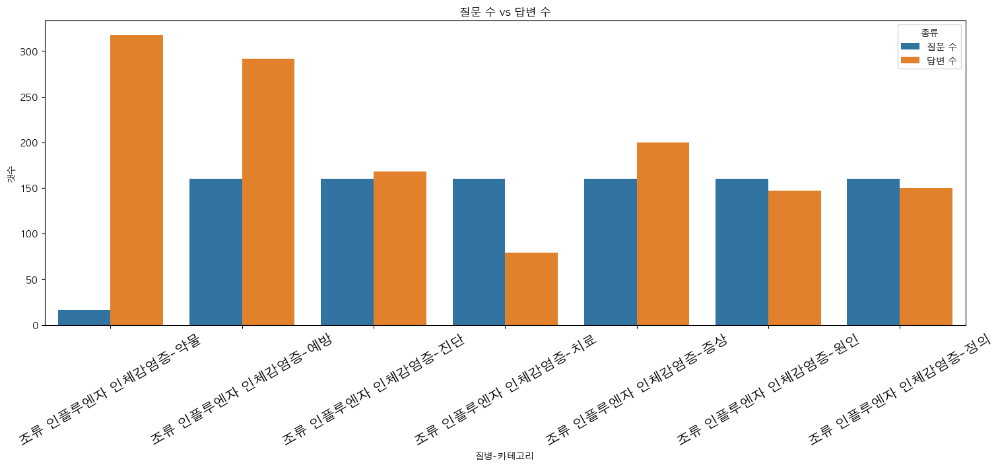

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


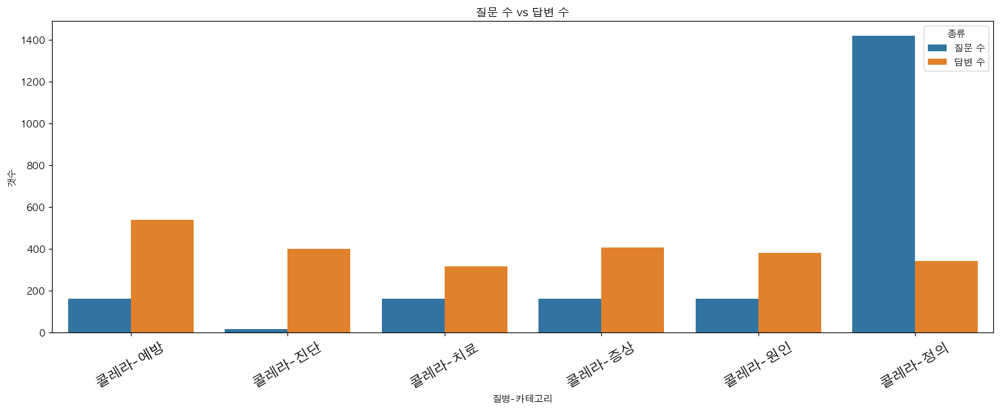

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


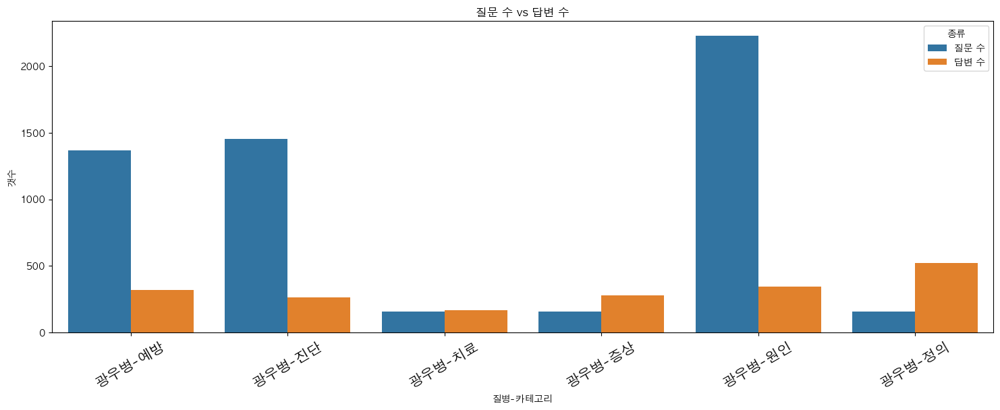

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


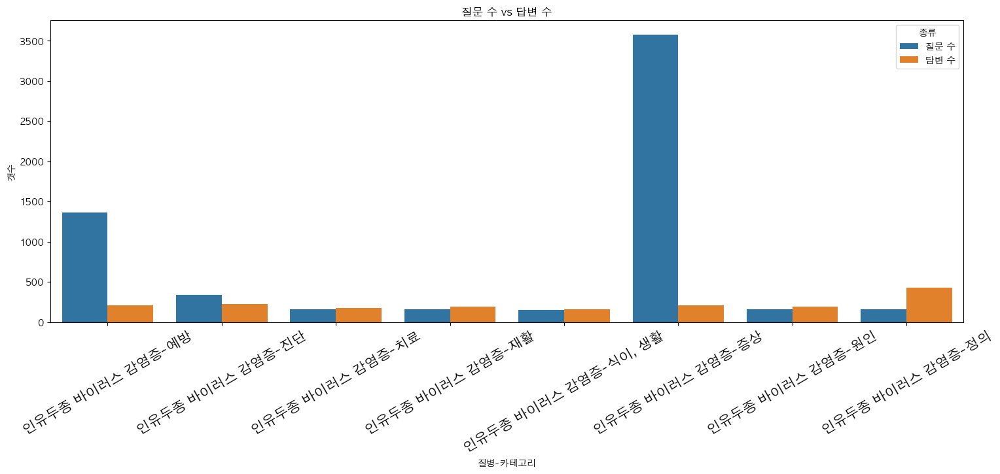

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


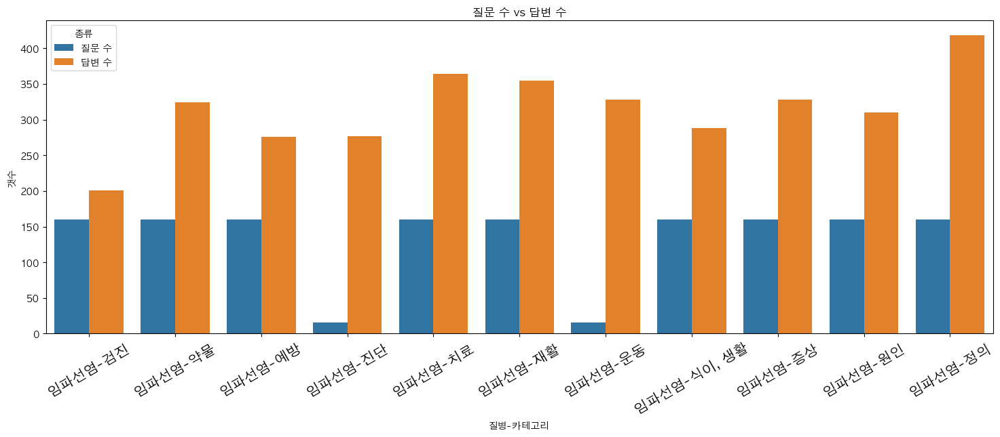

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


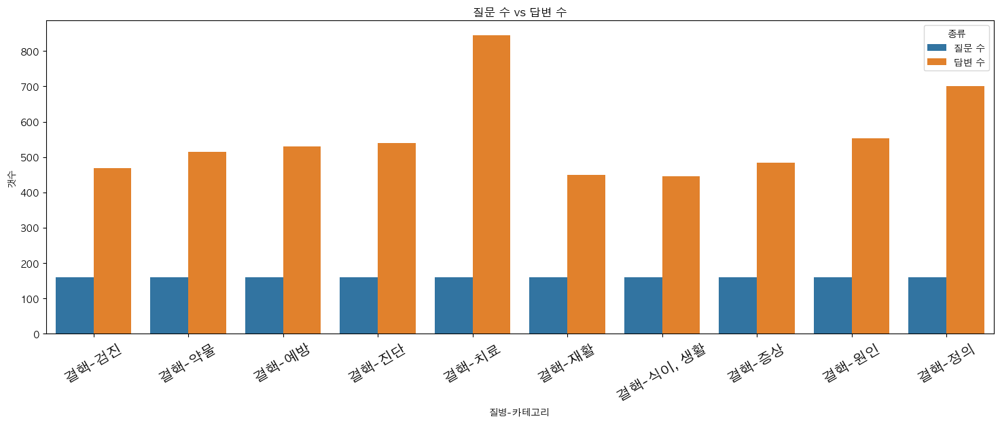

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


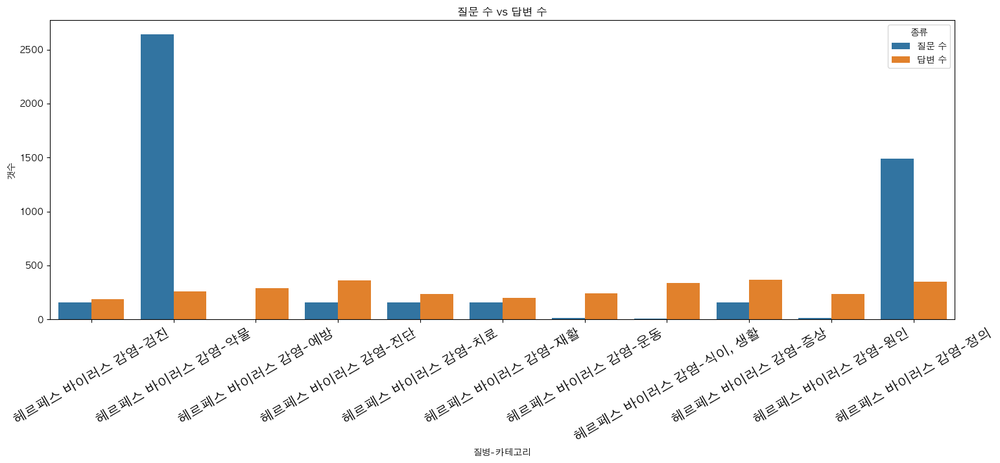

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


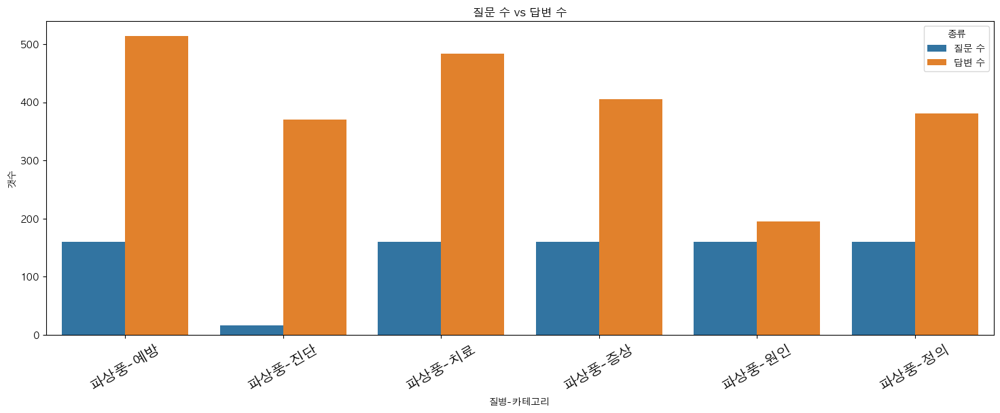

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


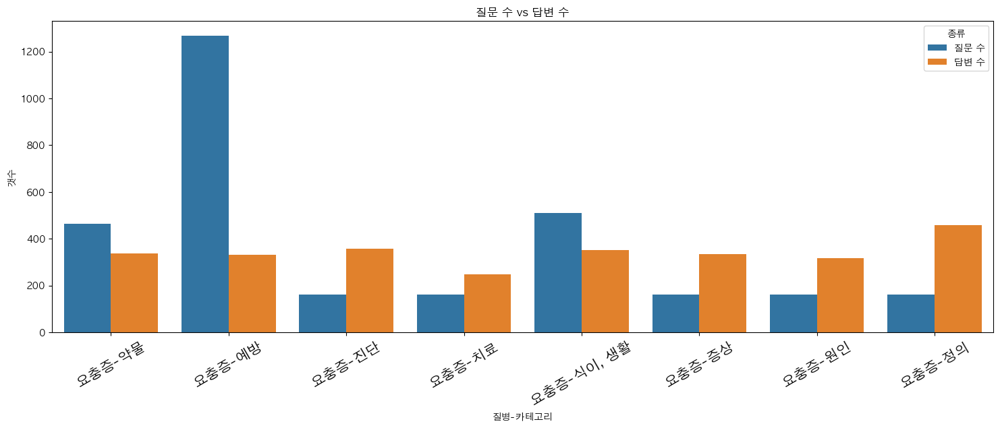

/var/folders/1t/sts9dw9x317fjpv6tzhvwldw0000gn/T/ipykernel_48712/2471749681.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']


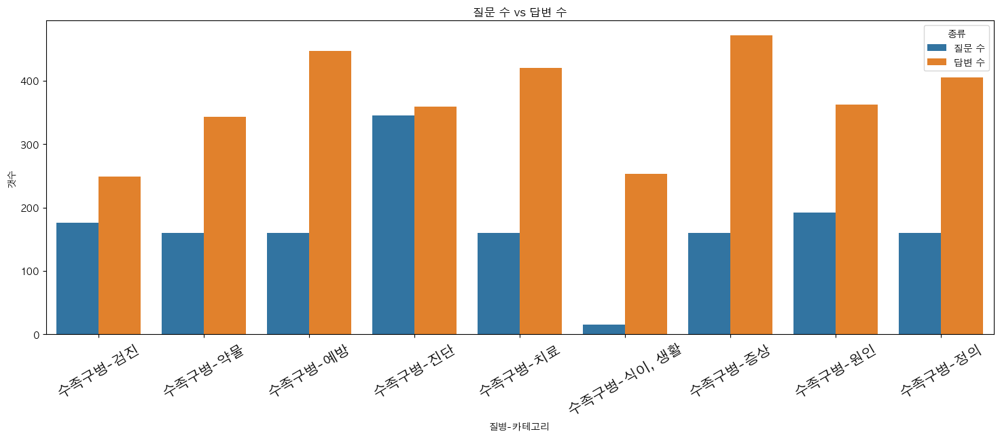

In [467]:
for disease in df_count['질병'].unique():
    df_div = df_count[df_count['질병']==disease]
    df_div['질병-카테고리'] = df_div['질병'] + '-' + df_div['카테고리']    
    df_melt = df_div.melt(
        id_vars = '질병-카테고리',
        value_vars = ['질문 수', '답변 수'],
        var_name = '종류',
        value_name ='갯수'
    )
    plt.figure(figsize=(18,6))
    sns.barplot(data=df_melt, x = '질병-카테고리', y='갯수', hue='종류')
    plt.title("질문 수 vs 답변 수")
    plt.xlabel("질병-카테고리")
    plt.ylabel("갯수")
    plt.xticks(rotation=30, fontsize=15)
    plt.legend(title='종류')
    #plt.tight_layout()
    plt.show()

In [557]:
ques_count_des = df_group['질문 수'].sum().sort_values(ascending=False).head(50)
ques_count_asc = df_group['질문 수'].sum().sort_values(ascending=True).head(50)
ans_count_des = df_group['답변 수'].sum().sort_values(ascending=False).head(50)
ans_count_asc = df_group['답변 수'].sum().sort_values(ascending=True).head(50)

def draw_plt(df,Fontsize,figsize):
    plt.figure(figsize=figsize)
    sns.barplot(y=df.index, x=df.values)
    plt.title('질병별 질문/답변 갯수',fontsize=Fontsize)
    plt.ylabel('질병')
    plt.ylabel('갯수')
    plt.yticks(fontsize=Fontsize)
    plt.xticks(fontsize=Fontsize)
    plt.tight_layout()
    plt.show()

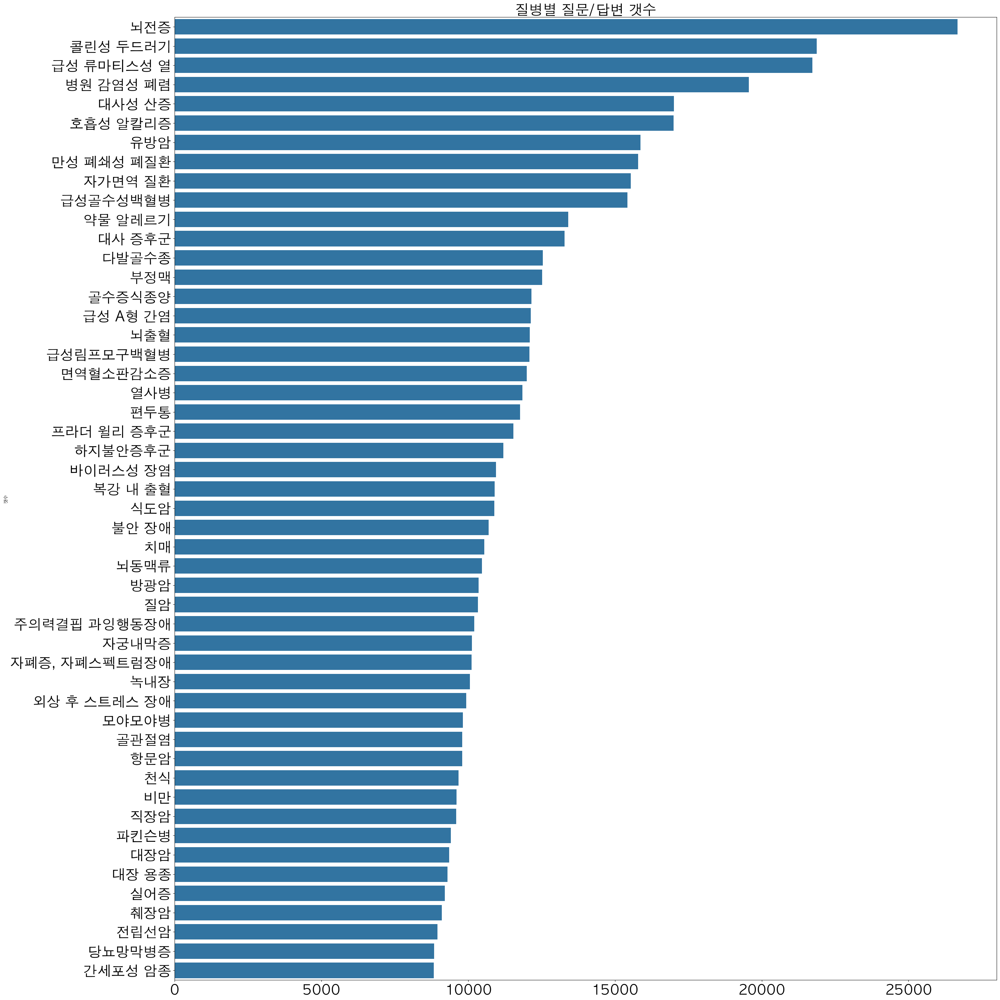

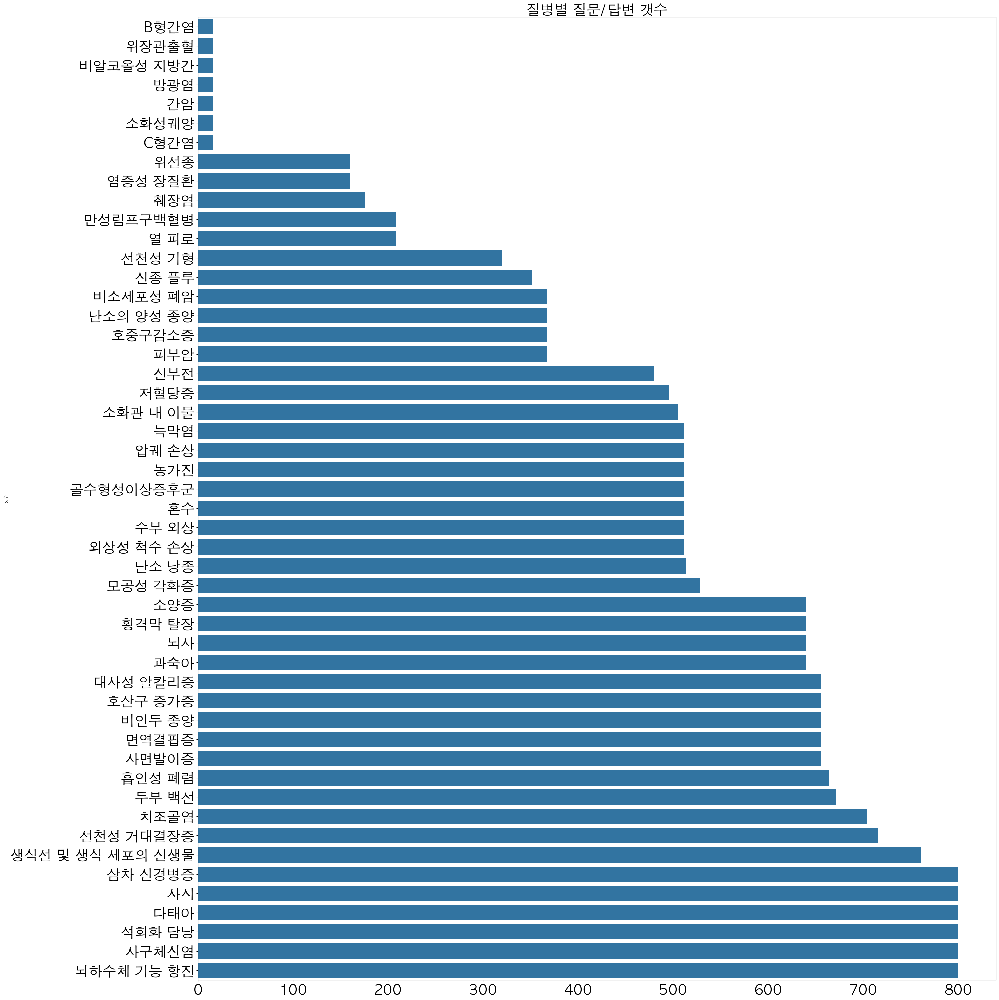

In [563]:
# 질문 내림차 /오름차
draw_plt(ques_count_des,30,(30,30))
draw_plt(ques_count_asc,30,(30,30))

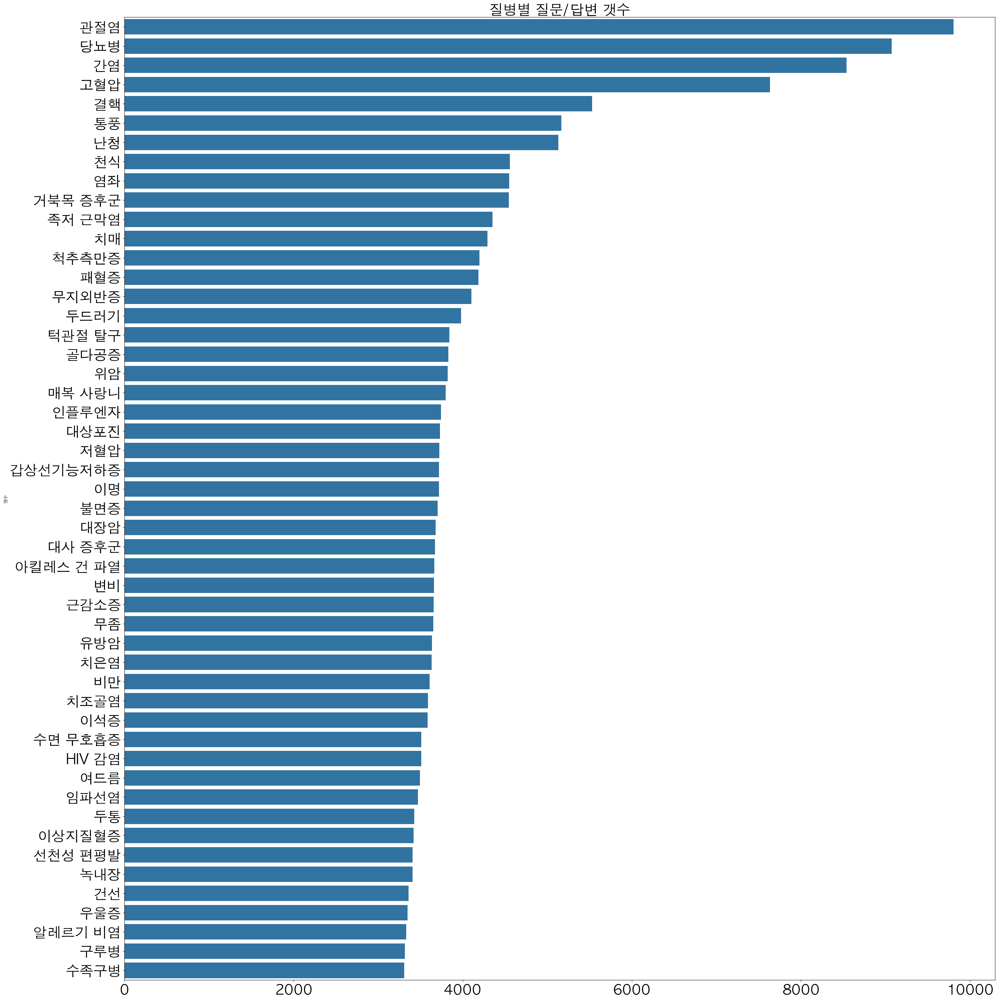

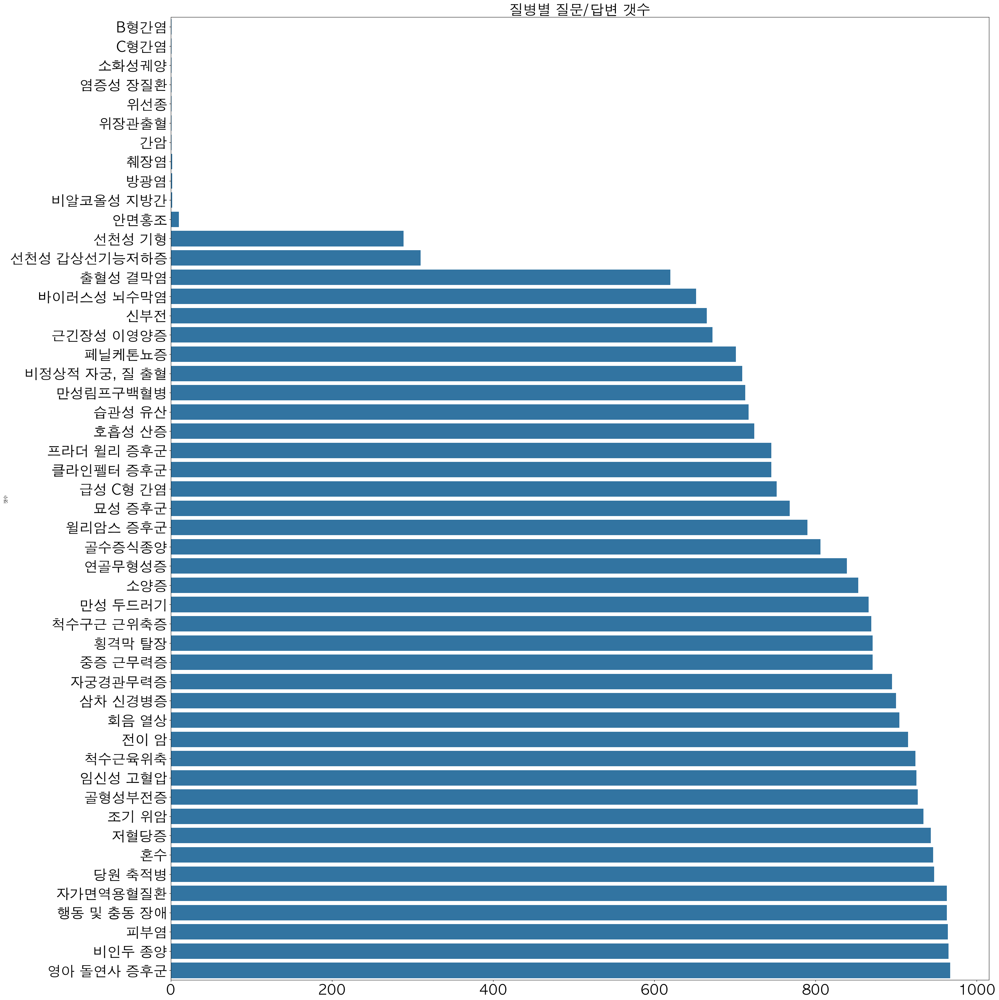

In [565]:
# 답변 내림차 / 오름차
draw_plt(ans_count_des,30,(30,30))
draw_plt(ans_count_asc,30,(30,30))

In [425]:
for i in ans_count_asc[:10].index:
    find_disease = df_count[df_count['질병']==i]
    print(f"{i} 에 대한 ")
    for idx in find_disease.index:
        category = find_disease.loc[idx,'카테고리']
        question = find_disease.loc[idx, '질문 수']
        print(f"                    {category} : {question}")

B형간염 에 대한 
                    정의 : 16
C형간염 에 대한 
                    정의 : 16
소화성궤양 에 대한 
                    정의 : 16
염증성 장질환 에 대한 
                    정의 : 160
위선종 에 대한 
                    정의 : 160
위장관출혈 에 대한 
                    정의 : 16
간암 에 대한 
                    정의 : 16
췌장염 에 대한 
                    원인 : 160
                    정의 : 16
방광염 에 대한 
                    정의 : 16
비알코올성 지방간 에 대한 
                    정의 : 16


In [471]:
for i in ans_count_asc[:10].index:
    find_disease = df_count[df_count['질병'] == i]
    print(f"{i} 에 대한 ")

    for idx in find_disease.index:
        category = find_disease.loc[idx, '카테고리']
        question = find_disease.loc[idx, '답변 수']
        print(f"                      {category} : {question}")

B형간염 에 대한 
                      정의 : 1
C형간염 에 대한 
                      정의 : 1
소화성궤양 에 대한 
                      정의 : 1
염증성 장질환 에 대한 
                      정의 : 1
위선종 에 대한 
                      정의 : 1
위장관출혈 에 대한 
                      정의 : 1
간암 에 대한 
                      정의 : 1
췌장염 에 대한 
                      원인 : 1
                      정의 : 1
방광염 에 대한 
                      정의 : 2
비알코올성 지방간 에 대한 
                      정의 : 2


In [469]:
for i in ques_count_asc[:10].index:
    find_disease = df_count[df_count['질병'] == i]
    print(f"{i} 에 대한 ")

    for idx in find_disease.index:
        category = find_disease.loc[idx, '카테고리']
        question = find_disease.loc[idx, '답변 수']
        print(f"                      {category} : {question}")

B형간염 에 대한 
                      정의 : 1
위장관출혈 에 대한 
                      정의 : 1
비알코올성 지방간 에 대한 
                      정의 : 2
방광염 에 대한 
                      정의 : 2
간암 에 대한 
                      정의 : 1
소화성궤양 에 대한 
                      정의 : 1
C형간염 에 대한 
                      정의 : 1
위선종 에 대한 
                      정의 : 1
염증성 장질환 에 대한 
                      정의 : 1
췌장염 에 대한 
                      원인 : 1
                      정의 : 1


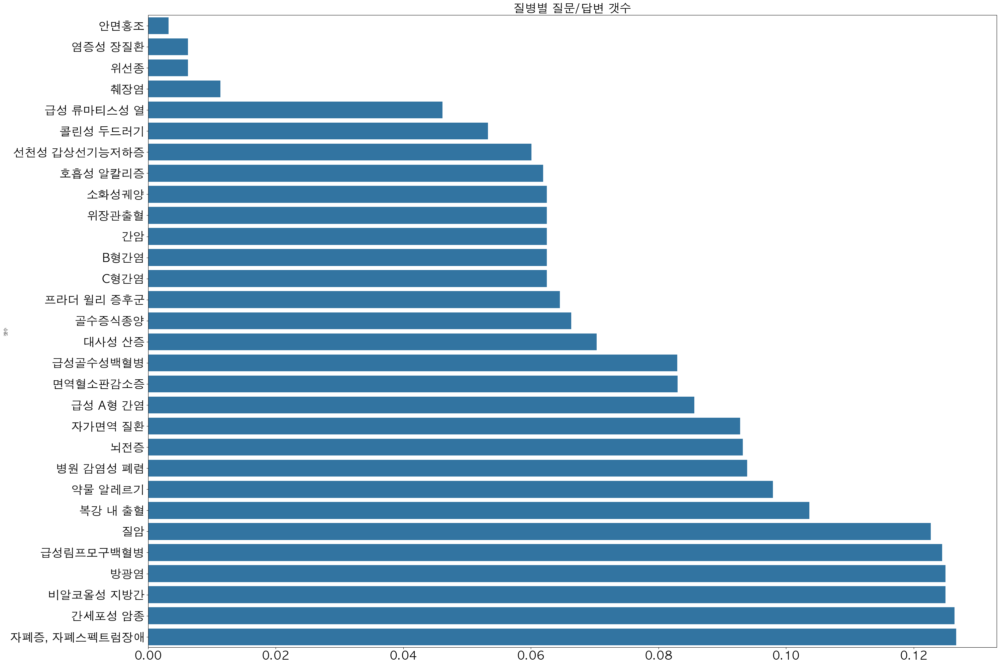

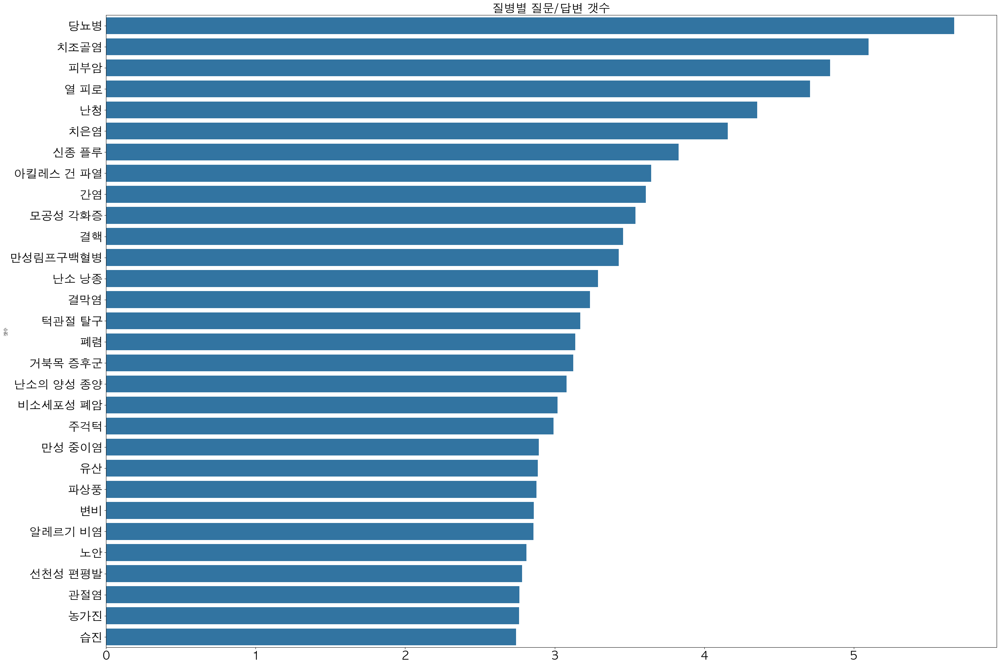

In [677]:
group_df = df_count
group_df = group_df.groupby('질병')
group_df = group_df.sum()
group_df['질문 대비 답변 수'] = group_df['답변 수']/group_df3['질문 수']
group_df_des = group_df['질문 대비 답변 수'].sort_values(ascending=False).head(30)
group_df_asc = group_df['질문 대비 답변 수'].sort_values(ascending=True).head(30)
draw_plt(group_df_asc,25,(30,20))
draw_plt(group_df_des,25,(30,20))

In [577]:
group_df_asc

질병
염증성 장질환         0.006250
위선종             0.006250
B형간염            0.062500
C형간염            0.062500
위장관출혈           0.062500
소화성궤양           0.062500
간암              0.062500
췌장염             0.068750
비알코올성 지방간       0.125000
방광염             0.125000
안면홍조            0.158558
골수증식종양          0.267962
호흡성 알칼리증        0.314807
대사성 산증          0.464941
급성 류마티스성 열      0.552953
병원 감염성 폐렴       0.638588
선천성 갑상선기능저하증    0.711664
면역혈소판감소증        0.737848
간세포성 암종         0.758986
고환 종양           0.878348
파종혈관내응고         0.890894
콜린성 두드러기        1.026323
윌리암스 증후군        1.045150
저나트륨혈증          1.060754
성인 호흡곤란 증후군     1.116200
급성골수성백혈병        1.130138
방광암             1.133776
만성 기침           1.212056
항문암             1.278557
지역사회성 폐렴        1.355940
Name: 질문 대비 답변 수, dtype: float64

In [667]:
df_count[df_count['질병']=='안면홍조']

,질병,카테고리,질문 수,답변 수
214,안면홍조,진단,160,1
215,안면홍조,치료,16,2
216,안면홍조,"식이, 생활",1281,2
217,안면홍조,증상,1340,1
218,안면홍조,원인,160,2
219,안면홍조,정의,160,2


In [669]:
df_count[df_count['질병']=='당뇨병']

,질병,카테고리,질문 수,답변 수
1966,당뇨병,검진,160,941
1967,당뇨병,약물,160,804
1968,당뇨병,예방,160,746
1969,당뇨병,진단,160,879
1970,당뇨병,치료,160,728
1971,당뇨병,운동,160,1112
1972,당뇨병,"식이, 생활",160,1020
1973,당뇨병,증상,160,772
1974,당뇨병,원인,160,1024
1975,당뇨병,정의,160,1049


In [675]:
group_df.loc['당뇨병']

카테고리          검진약물예방진단치료운동식이, 생활증상원인정의
질문 수                              1600
답변 수                              9075
질문 대비 답변 수                    0.176309
Name: 당뇨병, dtype: object

In [679]:
group_df.loc['안면홍조']

카테고리          진단치료식이, 생활증상원인정의
질문 수                      3117
답변 수                        10
질문 대비 답변 수            0.003208
Name: 안면홍조, dtype: object